In [9]:
import os
import json
import re
import math
from datetime import datetime

import numpy as np
import pandas as pd
from matplotlib import pyplot as plt

from skimage.io import imread, imsave
from scipy.optimize import curve_fit
from scipy.signal import savgol_filter
import scipy.stats as stats
from scipy.integrate import odeint, solve_ivp
from numba import njit, prange

In [10]:
def extract_array(s):
    numbers = re.findall(r"[-+]?\d*\.?\d+e[-+]?\d+|[-+]?\d*\.?\d+", s)
    return np.array([float(num) for num in numbers])

In [11]:
def gompertz(t, A, mu, l):
    log_B = A * np.exp(-np.exp(mu * np.exp(1) / A * (l - t) + 1))
    return log_B

In [12]:
def gompertz_growth_rate(t, A, mu, l):
    gr = mu * np.exp(np.exp(1) * mu * (l - t) / A - np.exp(np.exp(1) * mu * (l - t) / A + 1) + 2)
    return gr

In [13]:
def tm_gomp(A, mu, l):
    return A / (mu * np.e) + l

In [14]:
def logistic(t, A, mu, l):
    log_B = A / (1 + np.exp(4 * mu / A * (l - t) + 2))
    return log_B

In [15]:
def logistic_growth_rate(t, A, mu, l):
    gr = 4 * mu * np.exp(4 * mu / A * (l - t) + 2) / (1 + np.exp(4 * mu / A * (l - t) + 2))**2
    return gr

In [16]:
def tm_logistic(A, mu, l):
    return A / (2 * mu) + l

#### Area per dilution

In [21]:
df = pd.read_excel('data_processed.xlsx')

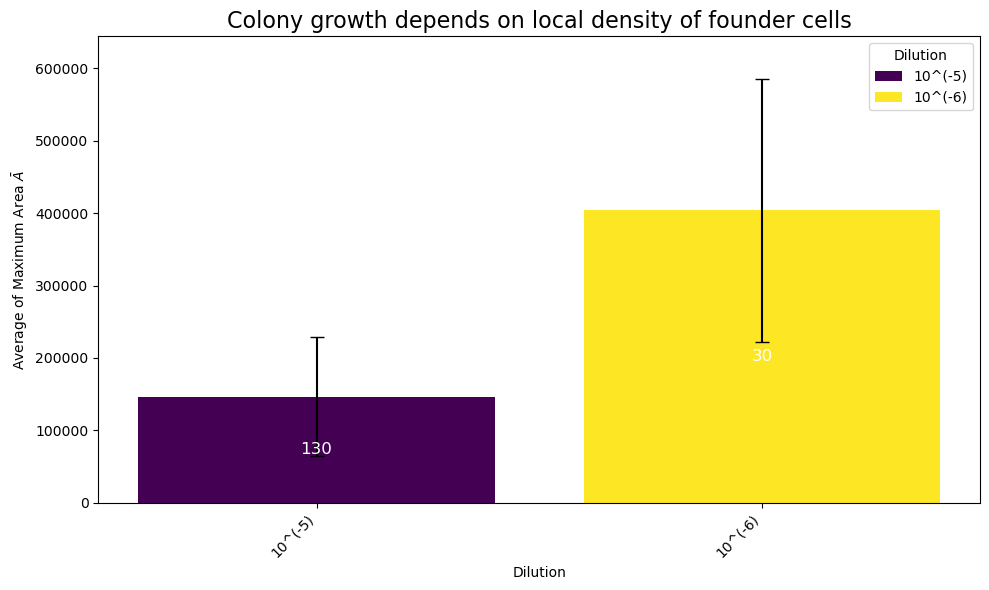

In [47]:
# Group the data by 'Dilution' and calculate mean, standard deviation, and count for 't_m'

plot_data = df.groupby('Pad','Dilution').agg({
    'max_area': ['mean', 'std'],
    'Pad': 'size'  # This counts the number of rows (colonies) per group
}).reset_index()

#plot_data = dilution_stats
# Prepare the data for plotting
plot_data.columns = ['Dilution', 'Area Mean', 'Area Std', 'Colonies Count']

# Find the global maximum for the y-axis to ensure proper scale
max_tm = plot_data['Area Mean'] + plot_data['Area Std']
global_max = max_tm.max()

# Create a single plot for all dilutions
fig, ax = plt.subplots(figsize=(10, 6))

# Generate a color range
area_colors = plt.cm.viridis(np.linspace(0, 1, len(plot_data)))

# Plot each dilution
for idx, row in plot_data.iterrows():
    ax.bar(idx, row['Area Mean'], yerr=row['Area Std'], capsize=5, color=area_colors[idx], label=row['Dilution'])
    # Annotate the number of colonies inside the bar
    ax.text(idx, row['Area Mean']/2, str(row['Colonies Count']), ha='center', va='center', color='white', fontsize=12)

ax.set_title('Colony growth depends on local density of founder cells', fontsize=16)
ax.set_xlabel('Dilution')
ax.set_ylabel(r'Average of Maximum Area $\bar{A}$')
ax.set_xticks(np.arange(len(plot_data)))
ax.set_xticklabels(plot_data['Dilution'], rotation=45, ha="right")
ax.set_ylim(0, global_max * 1.1)  # Set consistent y-axis limits
ax.legend(title="Dilution")

plt.tight_layout()
plt.show()

# Save the figure to a file
#fig.savefig('Tm_by_Dilution_Bar.png', dpi=300)


#### Gompertz fitting

In [11]:
# in theory this positions fir badly for Gompertz 
# df = df[~df.index.isin([17, 18, 20, 21, 22])].copy()

In [12]:
df = pd.read_excel('data_processed.xlsx')

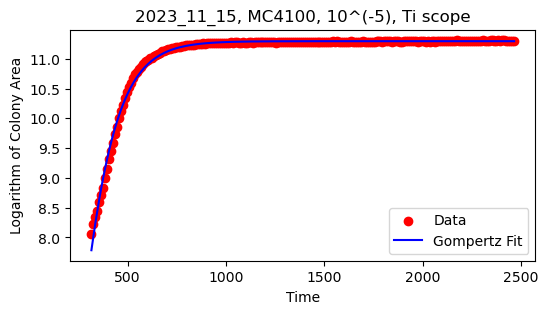

Fitted parameters [A, mu_m, lambda]: [1.12946713e+01 3.42967171e-02 7.50833206e+01], idxdf: 0. Area0: 3139.0


/tmp/ipykernel_1223843/1512405469.py:27: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '{"A": 11.29467129374218, "mu_m": 0.03429671707062678, "lambda": 75.08332064605176}' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  df.at[i, 'gomp_params'] = json.dumps(pars_dict)


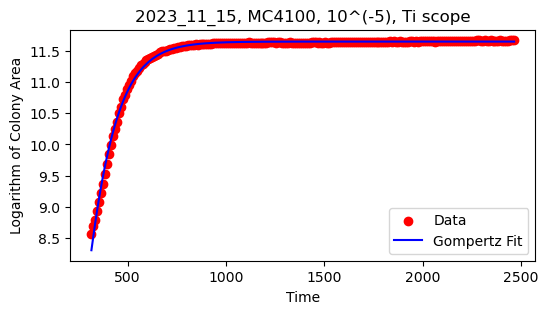

Fitted parameters [A, mu_m, lambda]: [1.16515508e+01 3.65208239e-02 7.17037155e+01], idxdf: 1. Area0: 5192.0


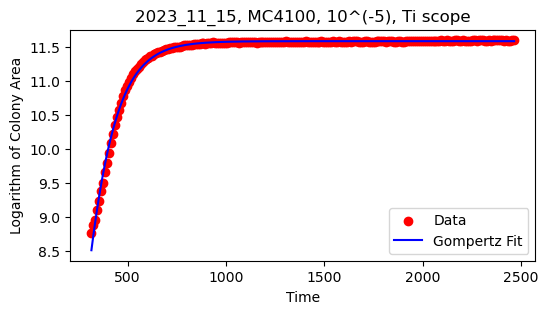

Fitted parameters [A, mu_m, lambda]: [1.15803773e+01 3.69917863e-02 6.54434254e+01], idxdf: 2. Area0: 6366.0


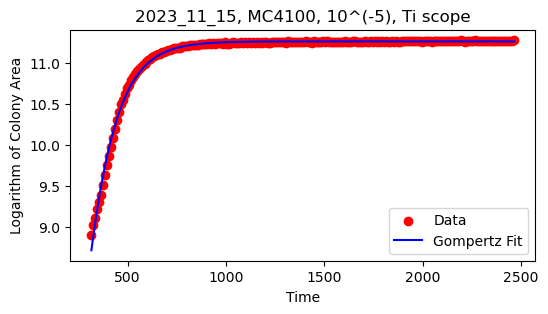

Fitted parameters [A, mu_m, lambda]: [11.26317911  0.03423452 30.40660161], idxdf: 3. Area0: 7293.0


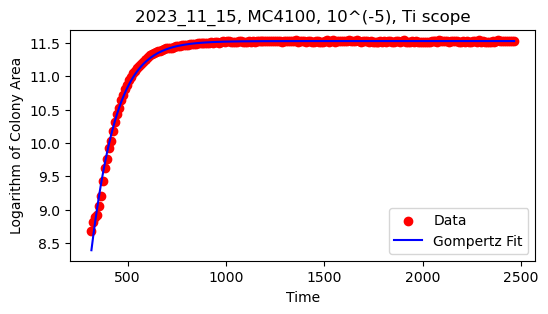

Fitted parameters [A, mu_m, lambda]: [1.15282749e+01 3.76935142e-02 7.44409447e+01], idxdf: 4. Area0: 5875.0


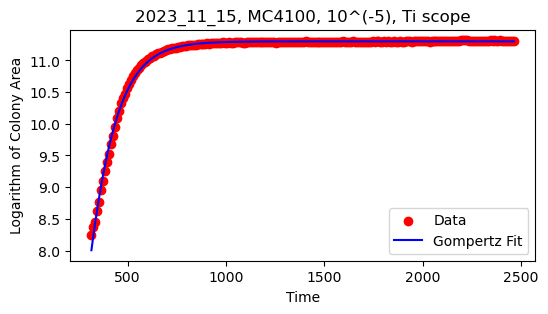

Fitted parameters [A, mu_m, lambda]: [1.13011062e+01 3.59379883e-02 7.71691202e+01], idxdf: 5. Area0: 3798.0


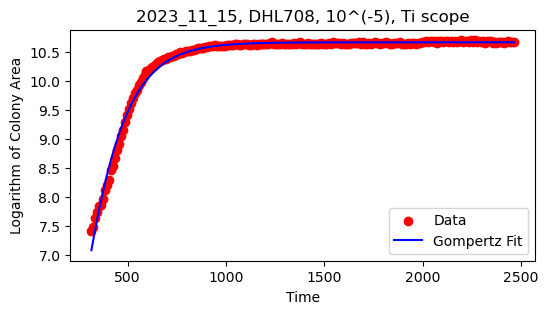

Fitted parameters [A, mu_m, lambda]: [1.06661698e+01 2.62405267e-02 3.32793184e+01], idxdf: 6. Area0: 1643.0


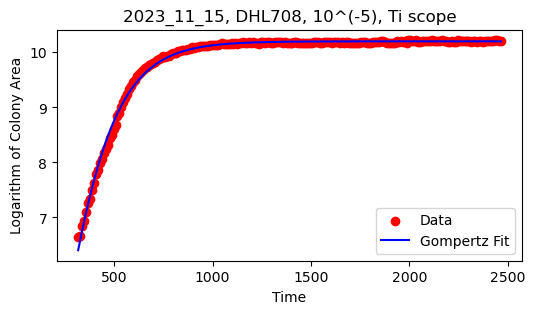

Fitted parameters [A, mu_m, lambda]: [1.02008211e+01 2.29323115e-02 2.71680394e+01], idxdf: 7. Area0: 763.0


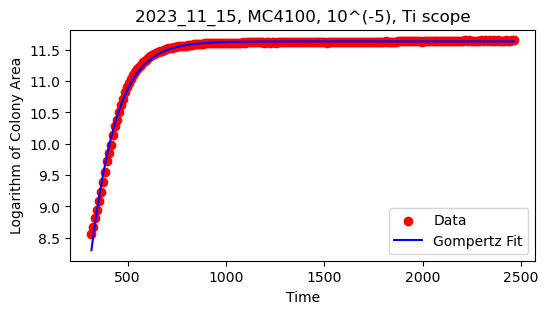

Fitted parameters [A, mu_m, lambda]: [1.16329089e+01 3.71807838e-02 7.58349140e+01], idxdf: 8. Area0: 5201.0


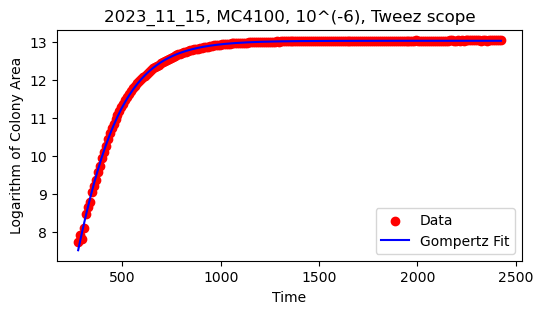

Fitted parameters [A, mu_m, lambda]: [13.02487156  0.02863516  7.48775556], idxdf: 9. Area0: 2275.0


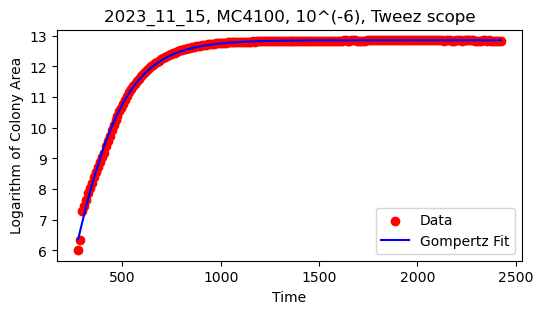

Fitted parameters [A, mu_m, lambda]: [1.28562285e+01 2.89969452e-02 5.45275885e+01], idxdf: 10. Area0: 406.0


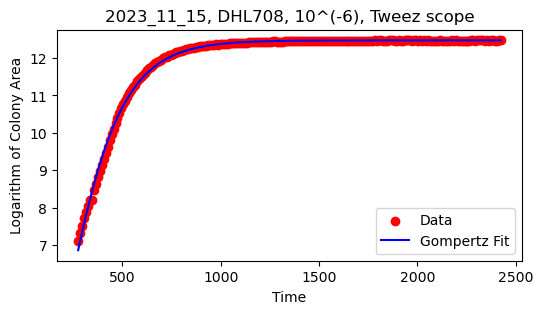

Fitted parameters [A, mu_m, lambda]: [12.46909181  0.02753393 22.29103669], idxdf: 11. Area0: 1241.0


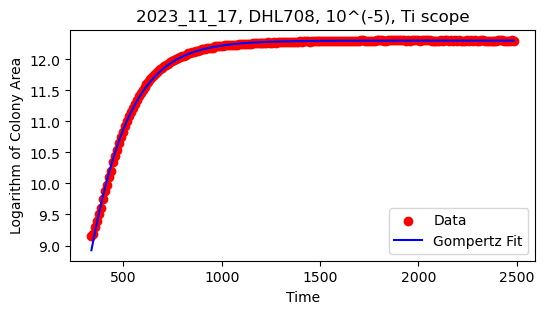

Fitted parameters [A, mu_m, lambda]: [ 12.30306917   0.02660299 -26.3978623 ], idxdf: 12. Area0: 9398.0


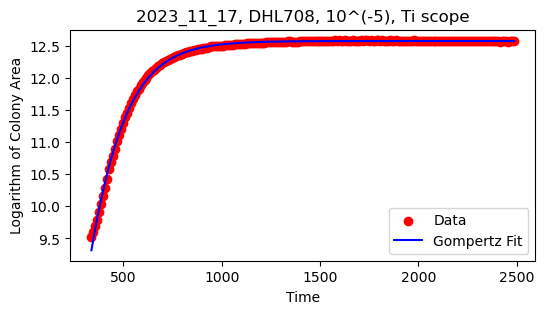

Fitted parameters [A, mu_m, lambda]: [12.57323725  0.02973034 -5.98317817], idxdf: 13. Area0: 13623.0


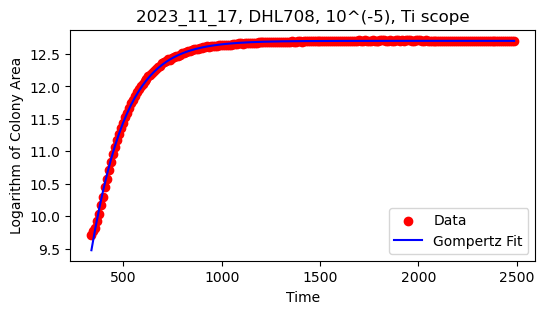

Fitted parameters [A, mu_m, lambda]: [ 12.70406978   0.02984589 -11.61811298], idxdf: 14. Area0: 16357.0


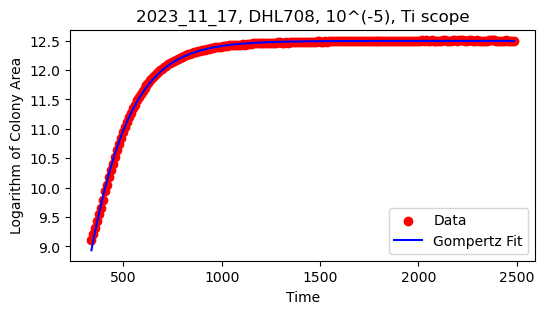

Fitted parameters [A, mu_m, lambda]: [ 12.4965535    0.02689684 -20.58924739], idxdf: 15. Area0: 9106.0


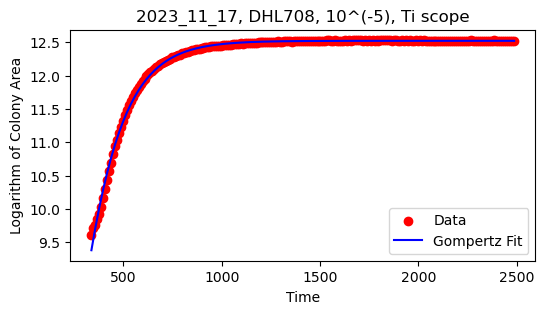

Fitted parameters [A, mu_m, lambda]: [12.5216872   0.02982641 -9.1385929 ], idxdf: 16. Area0: 14765.0


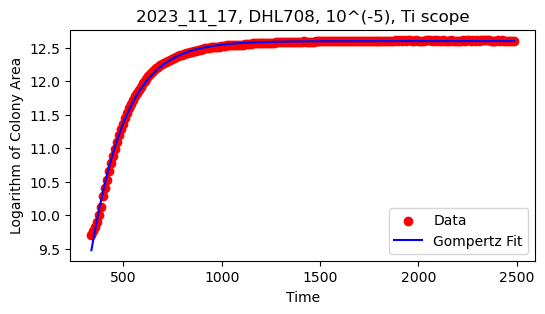

Fitted parameters [A, mu_m, lambda]: [ 12.59903426   0.02926918 -20.2731494 ], idxdf: 17. Area0: 16398.0


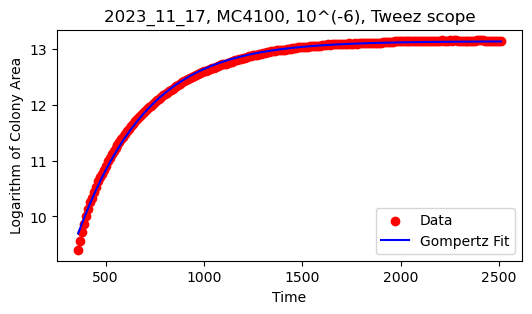

Fitted parameters [A, mu_m, lambda]: [ 1.31337386e+01  1.55802921e-02 -3.19835580e+02], idxdf: 18. Area0: 12036.0


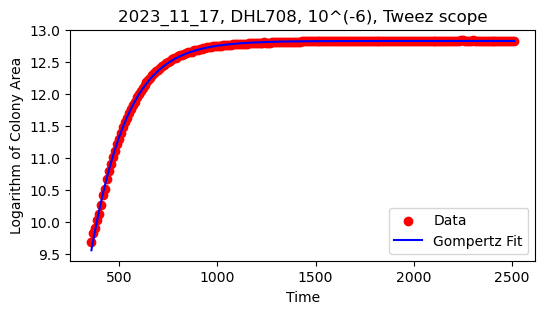

Fitted parameters [A, mu_m, lambda]: [12.83021064  0.02883615 -4.07439594], idxdf: 19. Area0: 16291.0


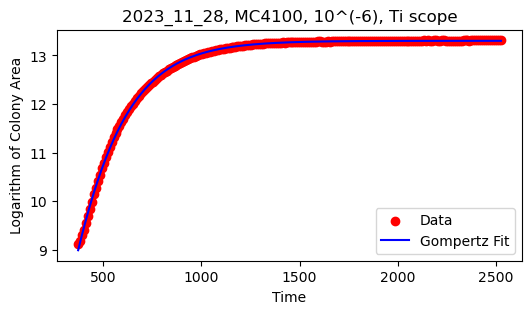

Fitted parameters [A, mu_m, lambda]: [ 1.33001838e+01  2.32901721e-02 -3.33715720e+01], idxdf: 20. Area0: 9248.0


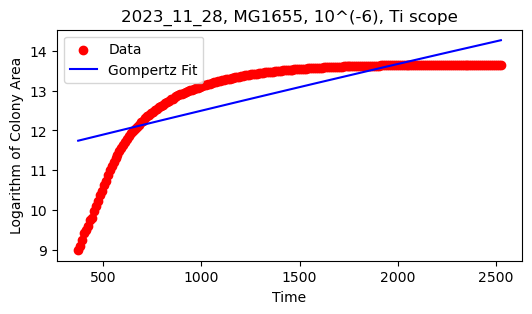

Fitted parameters [A, mu_m, lambda]: [ 2.65913330e+01  1.23963824e-03 -9.10834901e+03], idxdf: 21. Area0: 8001.0


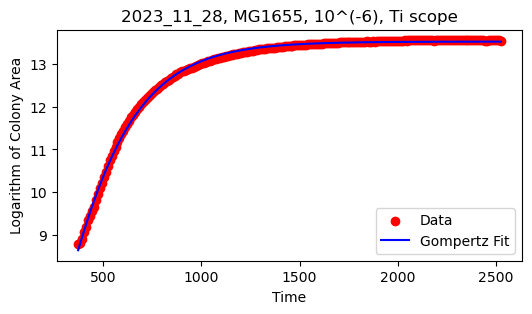

Fitted parameters [A, mu_m, lambda]: [ 1.35330453e+01  2.03665544e-02 -6.60226470e+01], idxdf: 22. Area0: 6485.0


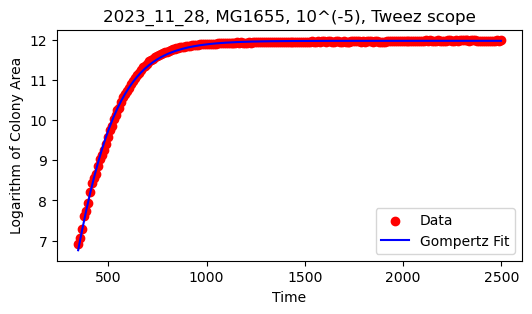

Fitted parameters [A, mu_m, lambda]: [1.19788976e+01 2.93284429e-02 1.12902897e+02], idxdf: 23. Area0: 1000.0


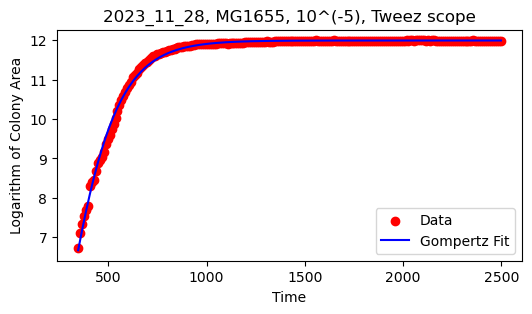

Fitted parameters [A, mu_m, lambda]: [1.19899099e+01 2.96429684e-02 1.18683234e+02], idxdf: 24. Area0: 826.0


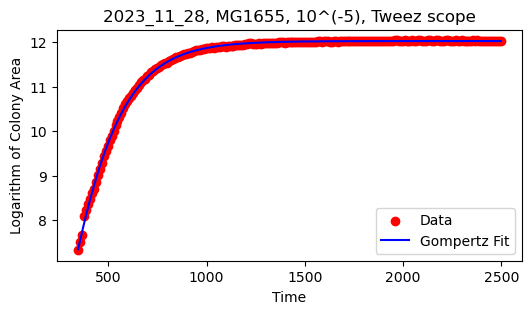

Fitted parameters [A, mu_m, lambda]: [1.20284973e+01 2.46074005e-02 3.99305465e+01], idxdf: 25. Area0: 1514.0


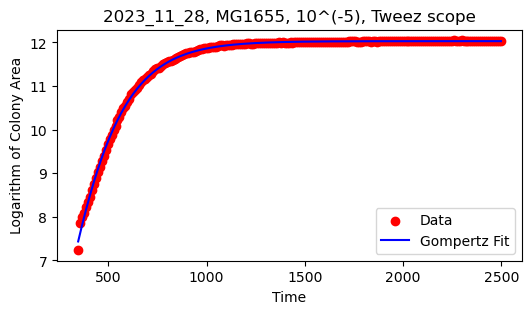

Fitted parameters [A, mu_m, lambda]: [1.20307572e+01 2.39244184e-02 2.67042602e+01], idxdf: 26. Area0: 1386.0


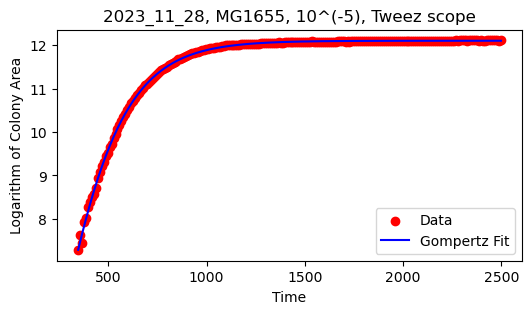

Fitted parameters [A, mu_m, lambda]: [12.10685514  0.02275994 18.66163255], idxdf: 27. Area0: 1447.0


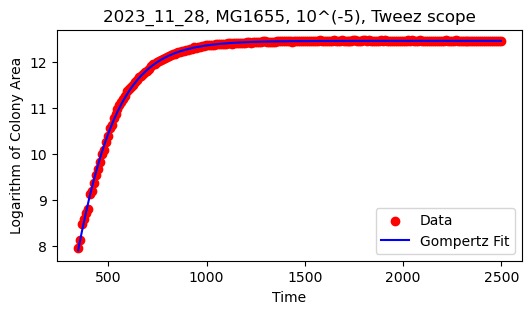

Fitted parameters [A, mu_m, lambda]: [1.24662021e+01 2.83662839e-02 5.81634388e+01], idxdf: 28. Area0: 2868.0


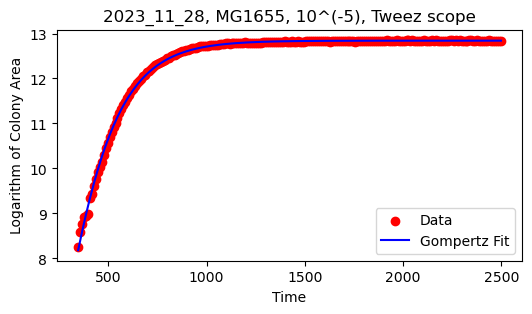

Fitted parameters [A, mu_m, lambda]: [1.28410440e+01 2.73487359e-02 3.66251354e+01], idxdf: 29. Area0: 3865.0


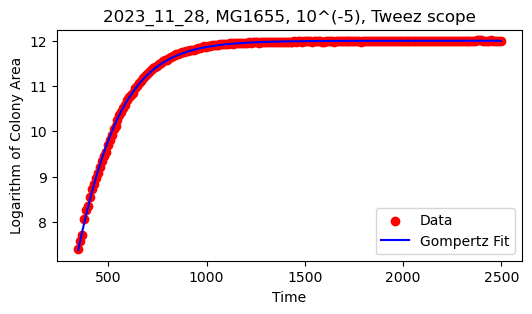

Fitted parameters [A, mu_m, lambda]: [1.19946318e+01 2.52726448e-02 4.63212636e+01], idxdf: 30. Area0: 1631.0


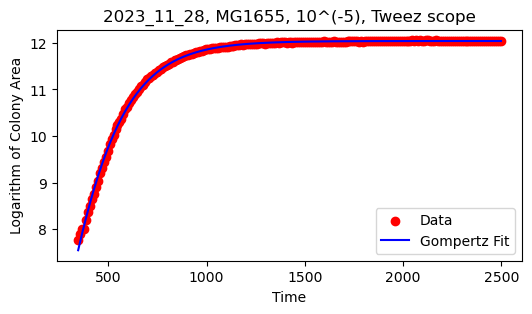

Fitted parameters [A, mu_m, lambda]: [12.0381379   0.02313197  9.42073144], idxdf: 31. Area0: 2377.0


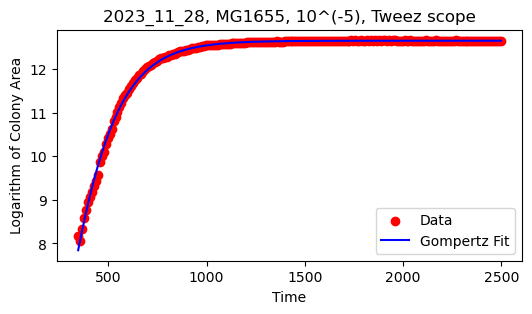

Fitted parameters [A, mu_m, lambda]: [1.26450250e+01 2.87108164e-02 6.52140569e+01], idxdf: 32. Area0: 3522.0


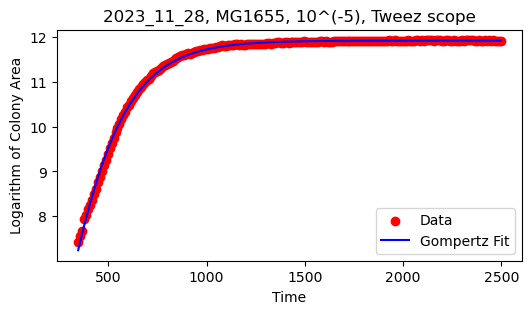

Fitted parameters [A, mu_m, lambda]: [11.91586811  0.02283315 21.09930858], idxdf: 33. Area0: 1665.0


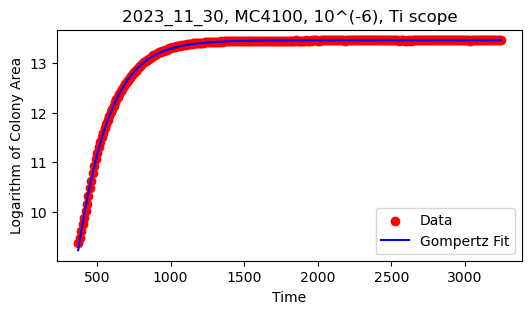

Fitted parameters [A, mu_m, lambda]: [13.45711054  0.02677444  8.20226277], idxdf: 34. Area0: 11610.0


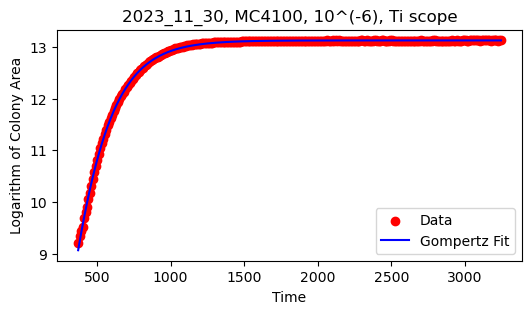

Fitted parameters [A, mu_m, lambda]: [ 13.12725547   0.02425708 -24.08327043], idxdf: 35. Area0: 9997.0


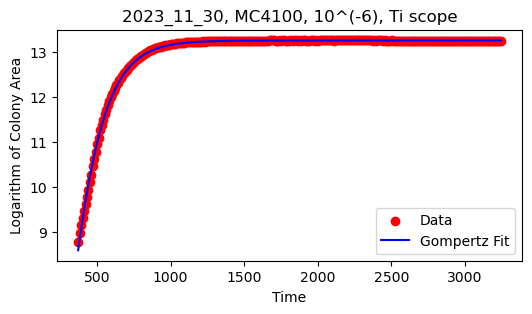

Fitted parameters [A, mu_m, lambda]: [1.32597022e+01 3.16084131e-02 8.96922467e+01], idxdf: 36. Area0: 6538.0


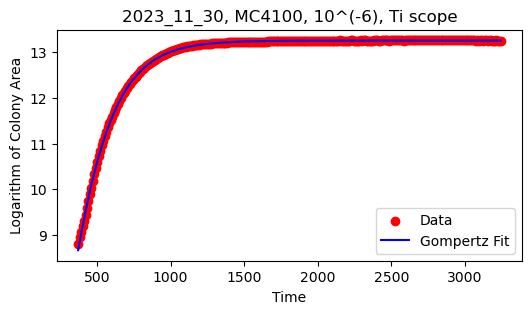

Fitted parameters [A, mu_m, lambda]: [13.25696767  0.02423344 -0.27177866], idxdf: 37. Area0: 6603.0


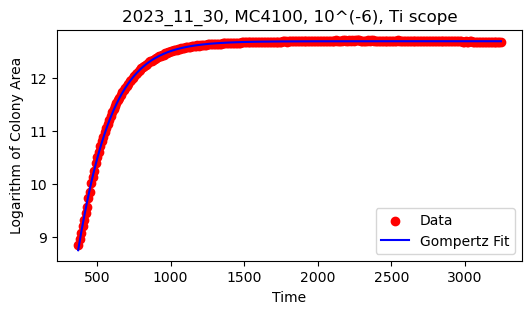

Fitted parameters [A, mu_m, lambda]: [ 12.69820663   0.0239952  -13.50832246], idxdf: 38. Area0: 6955.0


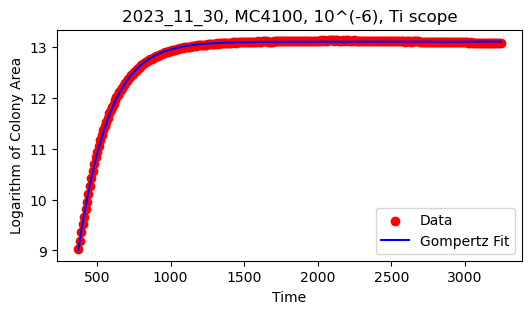

Fitted parameters [A, mu_m, lambda]: [13.11148837  0.02664665 14.79986879], idxdf: 39. Area0: 8312.0


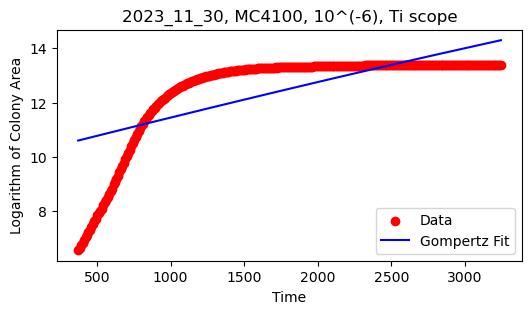

Fitted parameters [A, mu_m, lambda]: [ 2.49577380e+01  1.37408400e-03 -7.34468983e+03], idxdf: 40. Area0: 706.0


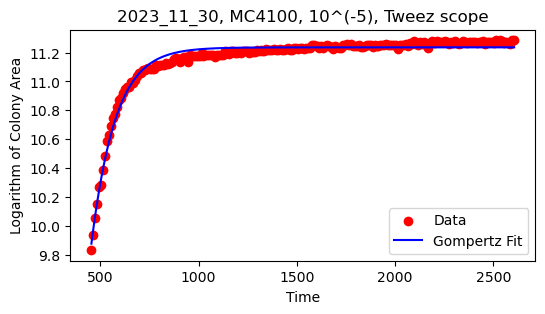

Fitted parameters [A, mu_m, lambda]: [1.12361349e+01 3.53656560e-02 9.86763941e+01], idxdf: 41. Area0: 18610.0


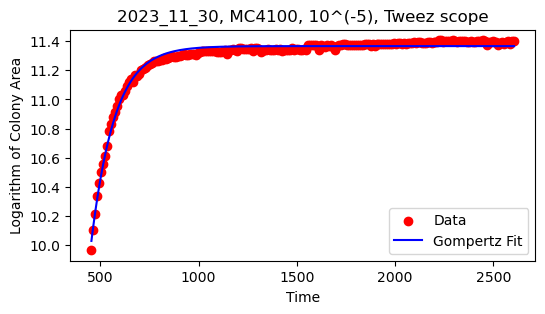

Fitted parameters [A, mu_m, lambda]: [1.13653823e+01 3.67026154e-02 1.04209029e+02], idxdf: 42. Area0: 21289.0


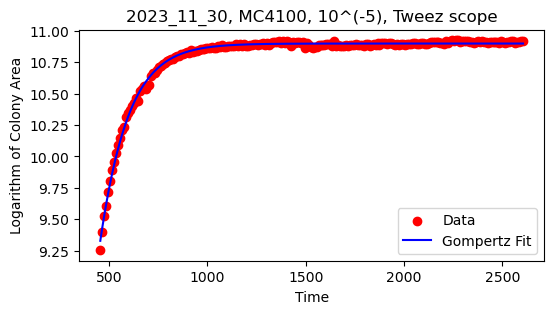

Fitted parameters [A, mu_m, lambda]: [1.08976628e+01 2.95084058e-02 6.62523081e+01], idxdf: 43. Area0: 10445.0


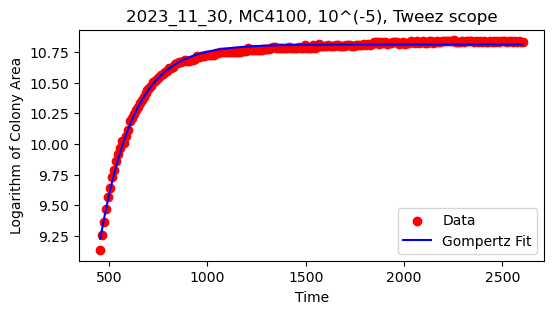

Fitted parameters [A, mu_m, lambda]: [10.80962236  0.02455402 -5.59672907], idxdf: 44. Area0: 9270.0


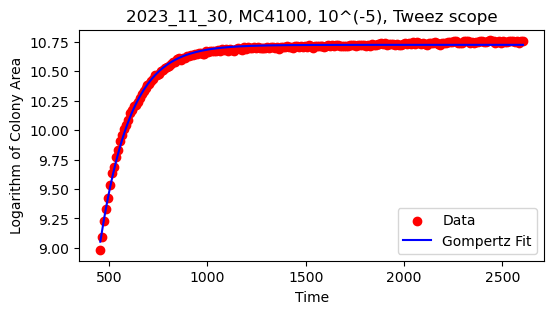

Fitted parameters [A, mu_m, lambda]: [1.07242948e+01 2.74997730e-02 5.68415029e+01], idxdf: 45. Area0: 7945.0


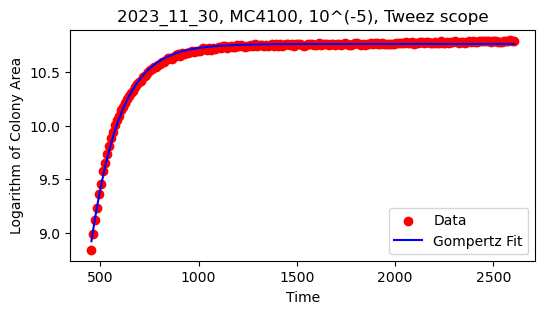

Fitted parameters [A, mu_m, lambda]: [1.07626795e+01 2.89312990e-02 8.91627390e+01], idxdf: 46. Area0: 6888.0


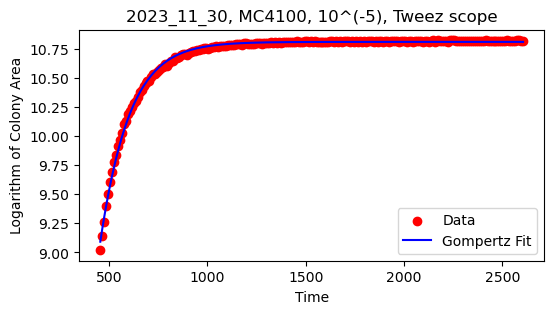

Fitted parameters [A, mu_m, lambda]: [1.08127042e+01 2.85011635e-02 7.08351711e+01], idxdf: 47. Area0: 8256.0


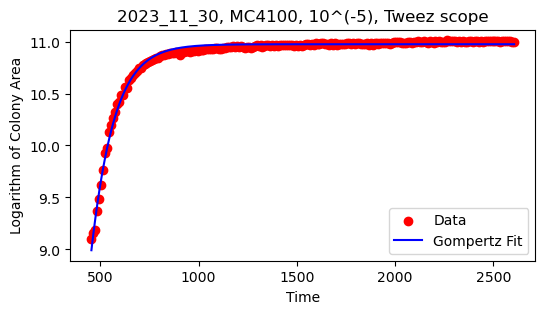

Fitted parameters [A, mu_m, lambda]: [1.09739160e+01 3.72235726e-02 1.71532733e+02], idxdf: 48. Area0: 8915.0


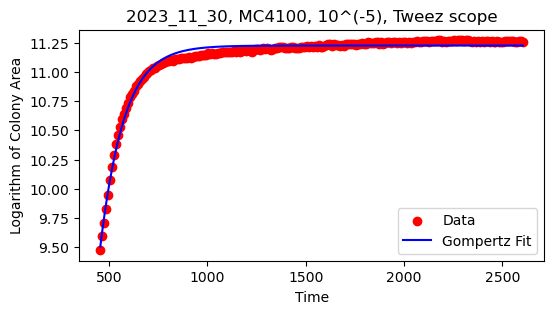

Fitted parameters [A, mu_m, lambda]: [1.12243104e+01 3.60392443e-02 1.34796702e+02], idxdf: 49. Area0: 13035.0


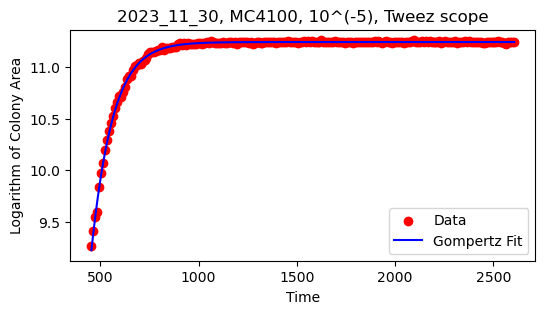

Fitted parameters [A, mu_m, lambda]: [1.12413921e+01 4.06846016e-02 1.88669726e+02], idxdf: 50. Area0: 10518.0


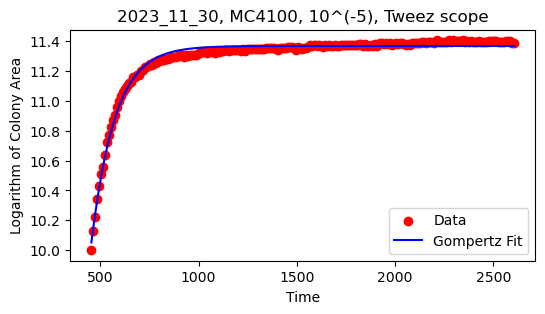

Fitted parameters [A, mu_m, lambda]: [1.13691485e+01 3.62858434e-02 9.83602909e+01], idxdf: 51. Area0: 22015.0


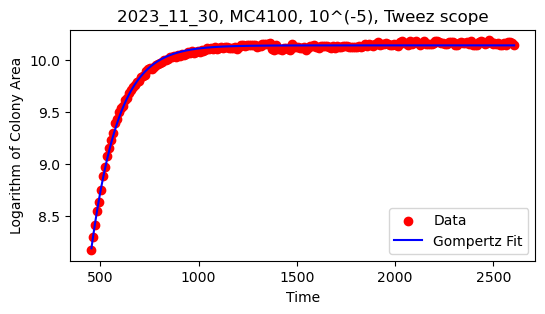

Fitted parameters [A, mu_m, lambda]: [1.01357948e+01 2.92558155e-02 1.30630241e+02], idxdf: 52. Area0: 3535.0


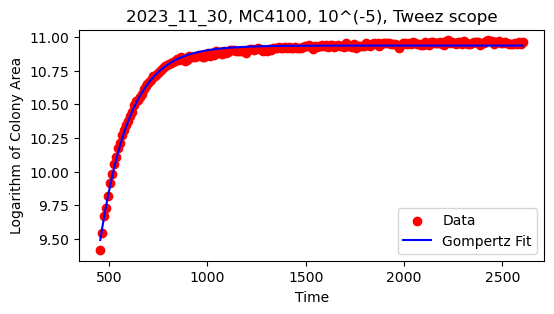

Fitted parameters [A, mu_m, lambda]: [1.09365945e+01 2.80056845e-02 3.05974185e+01], idxdf: 53. Area0: 12280.0


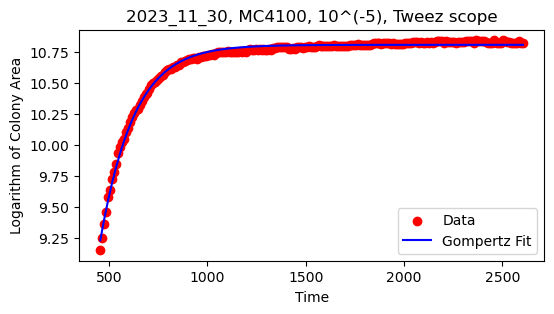

Fitted parameters [A, mu_m, lambda]: [10.81089531  0.02469054 -3.48557831], idxdf: 54. Area0: 9445.0


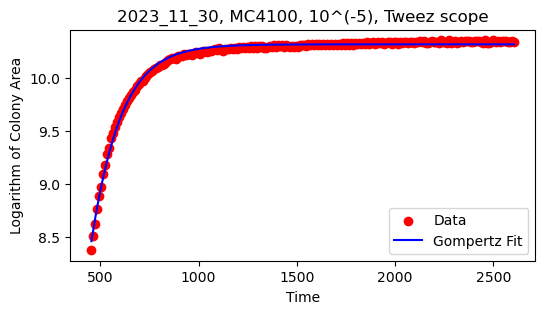

Fitted parameters [A, mu_m, lambda]: [1.03171020e+01 2.69293545e-02 8.60727351e+01], idxdf: 55. Area0: 4340.0


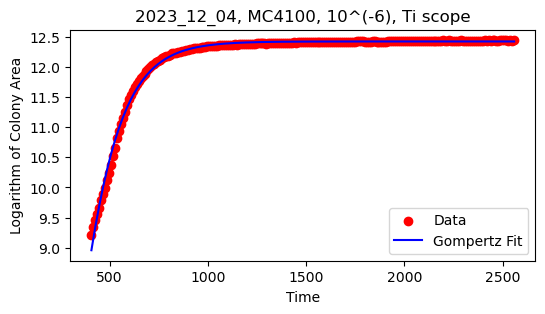

Fitted parameters [A, mu_m, lambda]: [1.24256451e+01 3.18914430e-02 1.04551379e+02], idxdf: 56. Area0: 10074.0


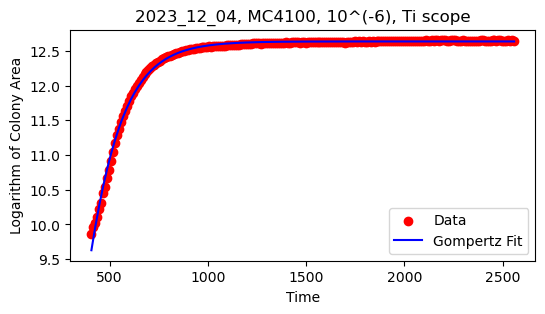

Fitted parameters [A, mu_m, lambda]: [1.26368208e+01 3.19230803e-02 7.26956695e+01], idxdf: 57. Area0: 19130.0


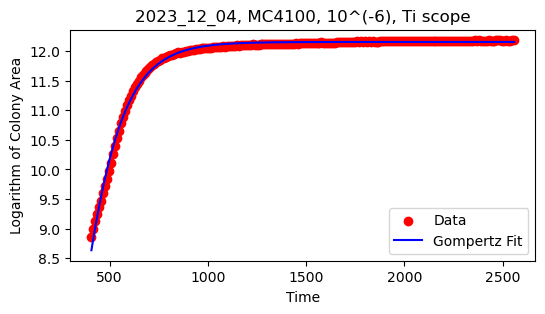

Fitted parameters [A, mu_m, lambda]: [1.21569777e+01 3.15847330e-02 1.14632973e+02], idxdf: 58. Area0: 7071.0


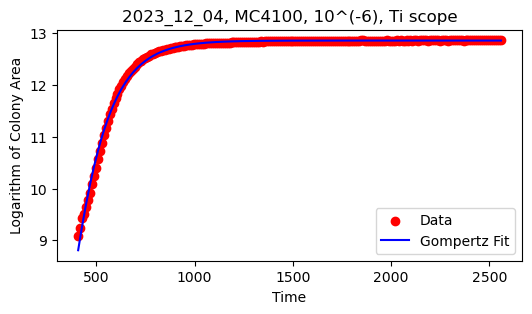

Fitted parameters [A, mu_m, lambda]: [1.28598508e+01 3.46026881e-02 1.38422233e+02], idxdf: 59. Area0: 8794.0


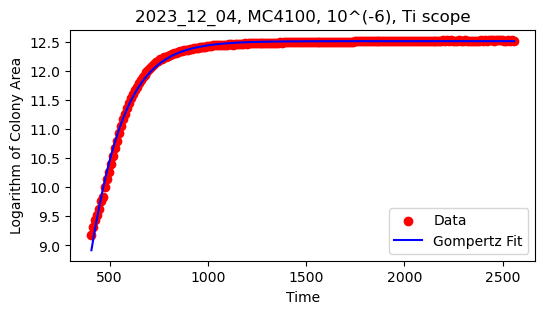

Fitted parameters [A, mu_m, lambda]: [1.25132004e+01 3.16027342e-02 1.04636208e+02], idxdf: 60. Area0: 9662.0


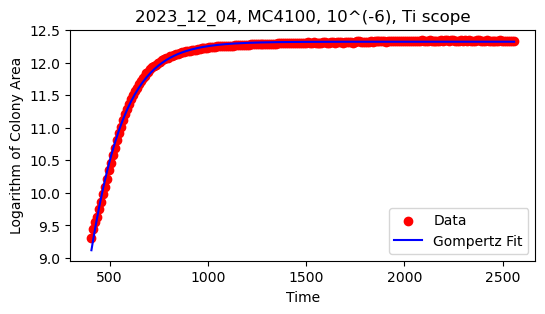

Fitted parameters [A, mu_m, lambda]: [1.23214182e+01 3.05614276e-02 8.15766221e+01], idxdf: 61. Area0: 11019.0


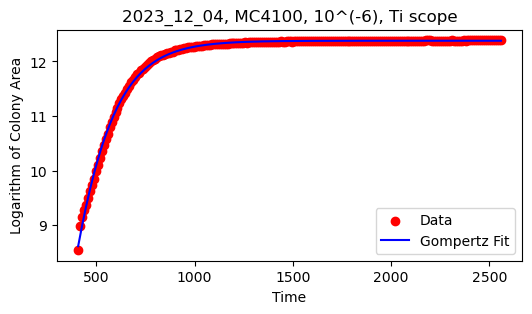

Fitted parameters [A, mu_m, lambda]: [1.23784548e+01 2.85915970e-02 8.68944386e+01], idxdf: 62. Area0: 5140.0


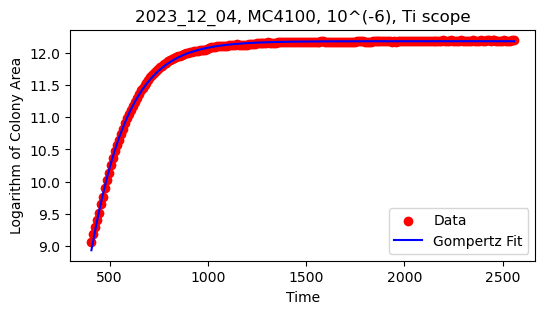

Fitted parameters [A, mu_m, lambda]: [1.21800516e+01 2.73764193e-02 5.24488728e+01], idxdf: 63. Area0: 8692.0


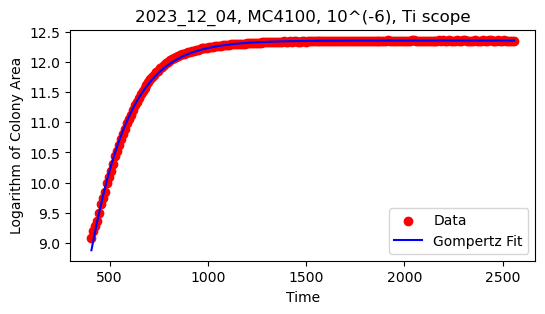

Fitted parameters [A, mu_m, lambda]: [1.23550996e+01 2.67326391e-02 4.96937515e+01], idxdf: 64. Area0: 8762.0


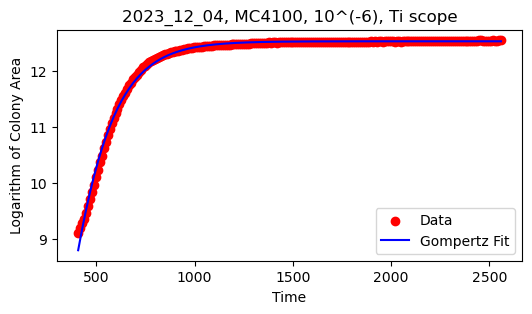

Fitted parameters [A, mu_m, lambda]: [1.25236477e+01 2.88687400e-02 8.22241530e+01], idxdf: 65. Area0: 9019.0


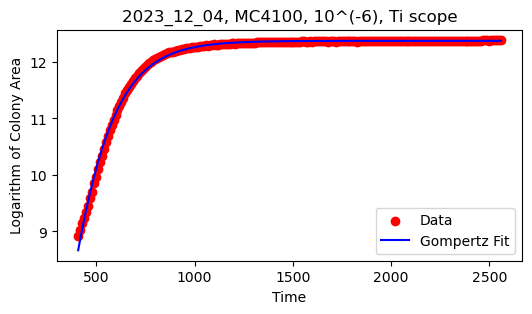

Fitted parameters [A, mu_m, lambda]: [1.23743298e+01 2.81643244e-02 7.94759745e+01], idxdf: 66. Area0: 7521.0


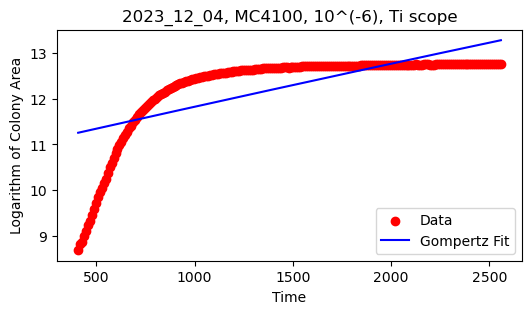

Fitted parameters [A, mu_m, lambda]: [ 2.57100804e+01  9.82827901e-04 -1.10548131e+04], idxdf: 67. Area0: 5917.0


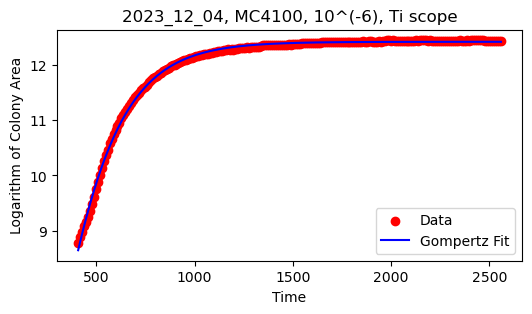

Fitted parameters [A, mu_m, lambda]: [12.41669933  0.02234794 -4.17179308], idxdf: 68. Area0: 6484.0


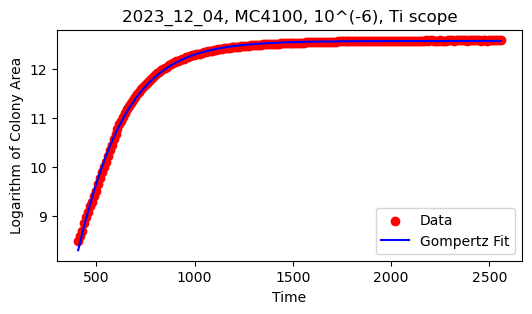

Fitted parameters [A, mu_m, lambda]: [1.25694857e+01 2.27948144e-02 2.69624445e+01], idxdf: 69. Area0: 4818.0


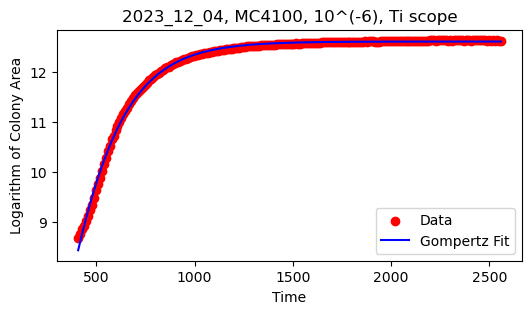

Fitted parameters [A, mu_m, lambda]: [1.26028055e+01 2.30853604e-02 2.35891856e+01], idxdf: 70. Area0: 5935.0


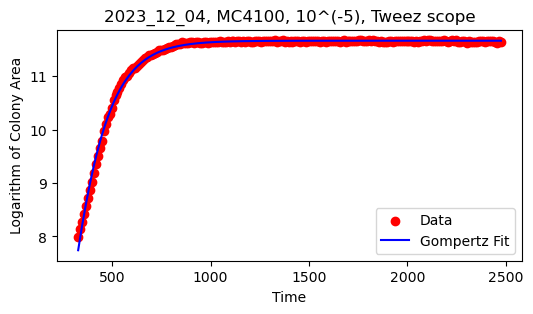

Fitted parameters [A, mu_m, lambda]: [1.16628413e+01 3.25151916e-02 7.62917574e+01], idxdf: 71. Area0: 2977.0


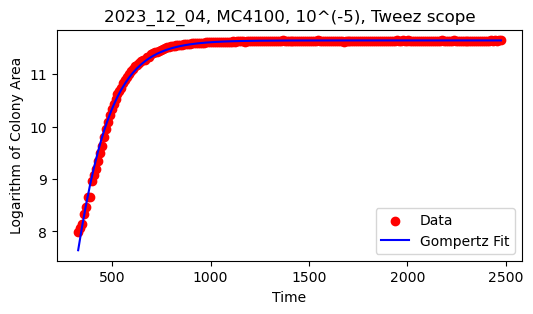

Fitted parameters [A, mu_m, lambda]: [1.16475630e+01 3.14563152e-02 7.20555738e+01], idxdf: 72. Area0: 2929.0


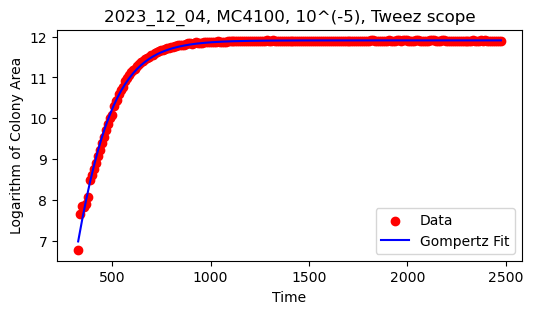

Fitted parameters [A, mu_m, lambda]: [1.19072918e+01 3.18011693e-02 1.01891609e+02], idxdf: 73. Area0: 866.0


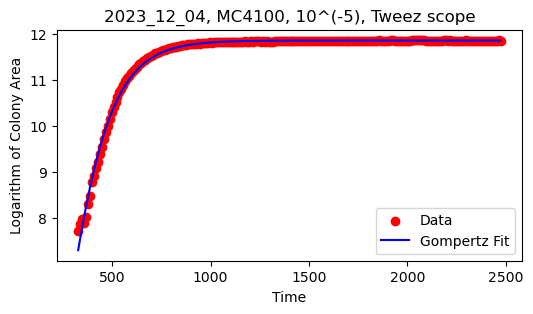

Fitted parameters [A, mu_m, lambda]: [1.18563239e+01 3.16467433e-02 8.87312426e+01], idxdf: 74. Area0: 2219.0


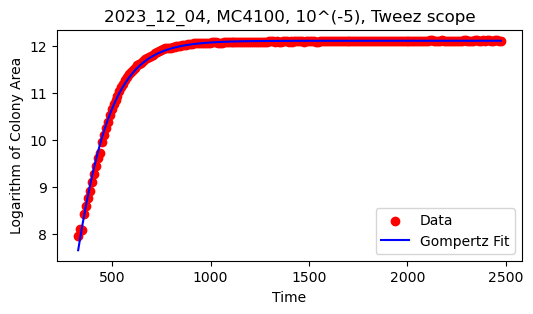

Fitted parameters [A, mu_m, lambda]: [1.21161271e+01 3.31755353e-02 8.71180761e+01], idxdf: 75. Area0: 2838.0


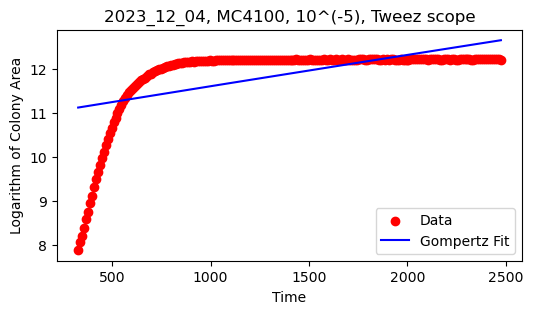

Fitted parameters [A, mu_m, lambda]: [ 2.61260776e+01  7.33347094e-04 -1.48538042e+04], idxdf: 76. Area0: 2632.0


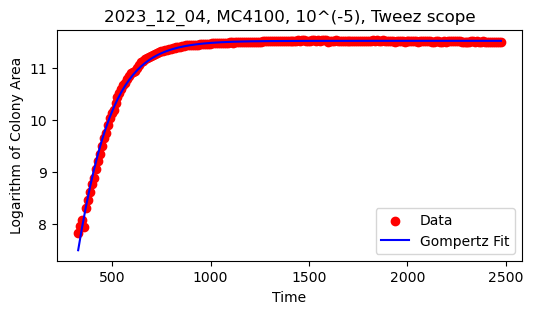

Fitted parameters [A, mu_m, lambda]: [1.15203965e+01 3.02934824e-02 6.78028044e+01], idxdf: 77. Area0: 2510.0


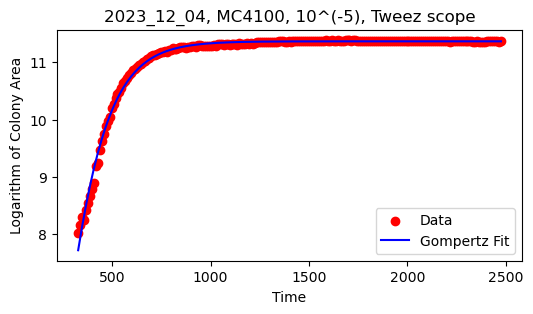

Fitted parameters [A, mu_m, lambda]: [1.13675329e+01 3.01338436e-02 5.54141399e+01], idxdf: 78. Area0: 3022.0


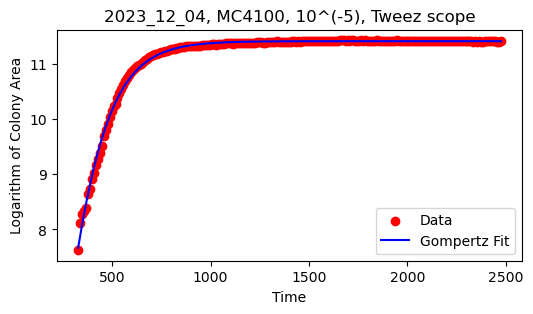

Fitted parameters [A, mu_m, lambda]: [1.14062184e+01 3.00083245e-02 5.69101120e+01], idxdf: 79. Area0: 2049.0


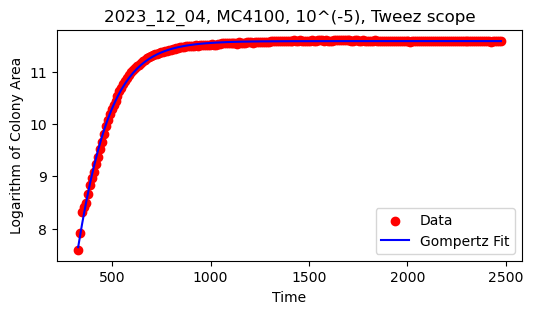

Fitted parameters [A, mu_m, lambda]: [1.15914122e+01 3.11670596e-02 6.92813253e+01], idxdf: 80. Area0: 1970.0


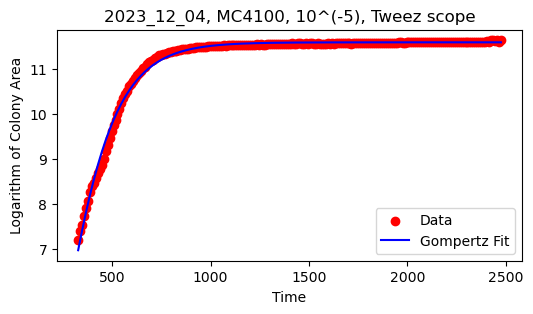

Fitted parameters [A, mu_m, lambda]: [1.15968717e+01 2.72664439e-02 6.40430546e+01], idxdf: 81. Area0: 1345.0


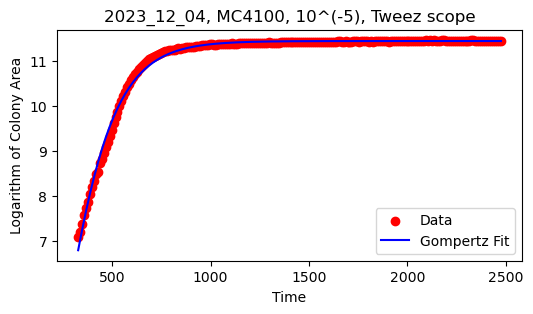

Fitted parameters [A, mu_m, lambda]: [1.14500520e+01 2.76867618e-02 7.53620474e+01], idxdf: 82. Area0: 1174.0


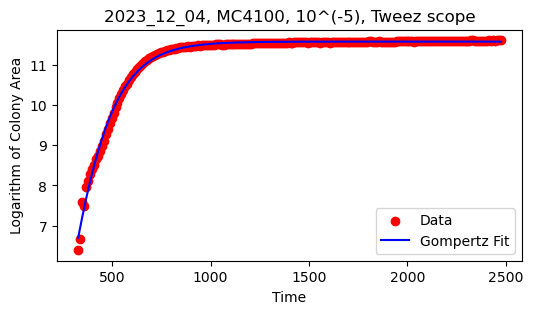

Fitted parameters [A, mu_m, lambda]: [1.15714083e+01 2.98229459e-02 9.69156374e+01], idxdf: 83. Area0: 597.0


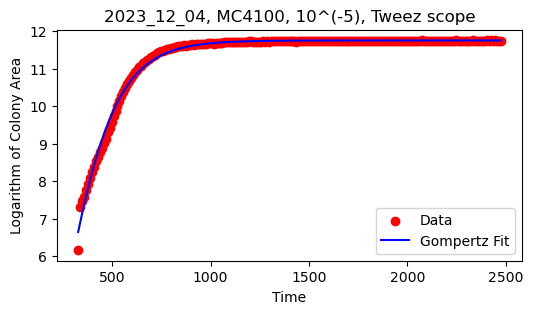

Fitted parameters [A, mu_m, lambda]: [1.17470006e+01 2.87169213e-02 9.07361000e+01], idxdf: 84. Area0: 475.0


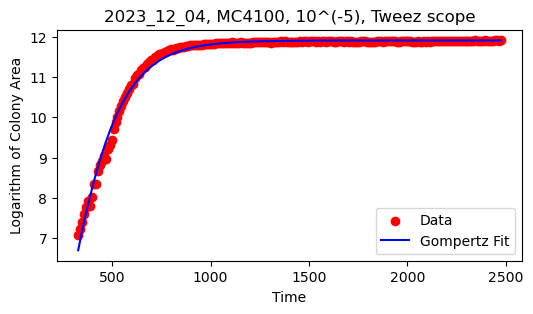

Fitted parameters [A, mu_m, lambda]: [1.19135772e+01 2.75258001e-02 7.91521637e+01], idxdf: 85. Area0: 1176.0


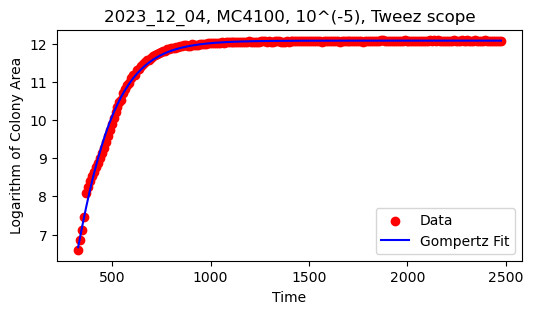

Fitted parameters [A, mu_m, lambda]: [1.20761151e+01 3.08541239e-02 1.06977600e+02], idxdf: 86. Area0: 728.0


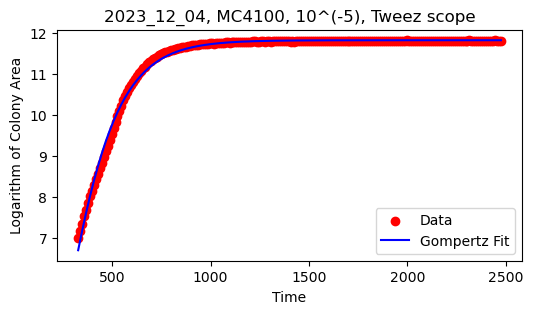

Fitted parameters [A, mu_m, lambda]: [1.18257514e+01 2.74636699e-02 7.83745565e+01], idxdf: 87. Area0: 1085.0


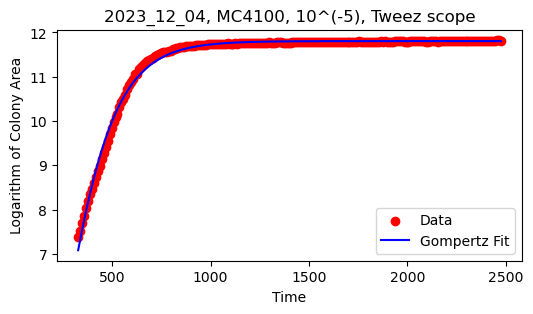

Fitted parameters [A, mu_m, lambda]: [1.18045622e+01 2.82846774e-02 6.94342722e+01], idxdf: 88. Area0: 1593.0


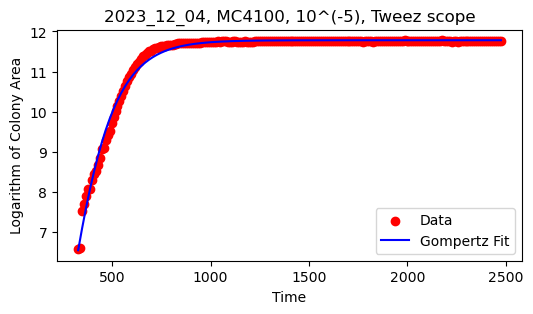

Fitted parameters [A, mu_m, lambda]: [1.17825179e+01 3.17195942e-02 1.16536365e+02], idxdf: 89. Area0: 714.0


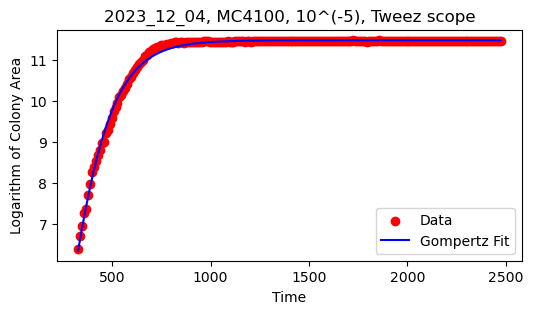

Fitted parameters [A, mu_m, lambda]: [1.14766672e+01 3.17341988e-02 1.22788432e+02], idxdf: 90. Area0: 596.0


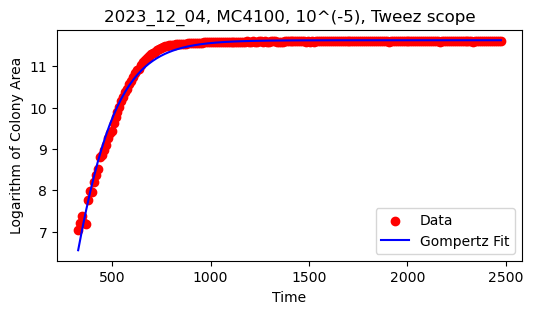

Fitted parameters [A, mu_m, lambda]: [1.16321163e+01 2.90234532e-02 9.69011755e+01], idxdf: 91. Area0: 1136.0


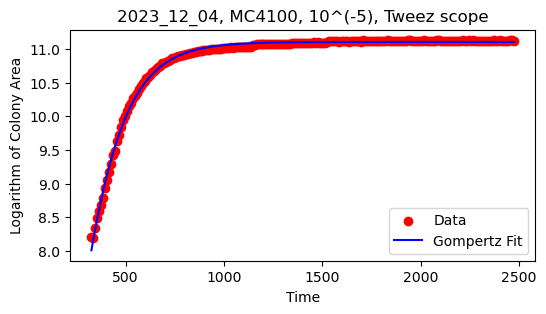

Fitted parameters [A, mu_m, lambda]: [11.10507075  0.0263737  -2.25654284], idxdf: 92. Area0: 3675.0


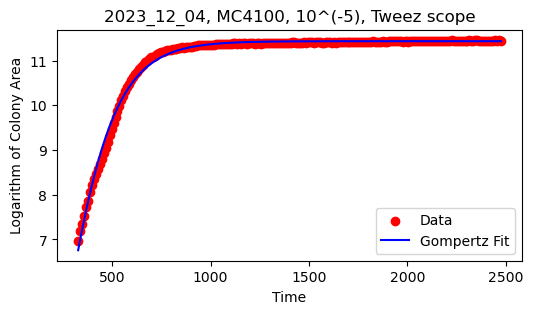

Fitted parameters [A, mu_m, lambda]: [1.14365146e+01 2.79159782e-02 7.85016364e+01], idxdf: 93. Area0: 1067.0


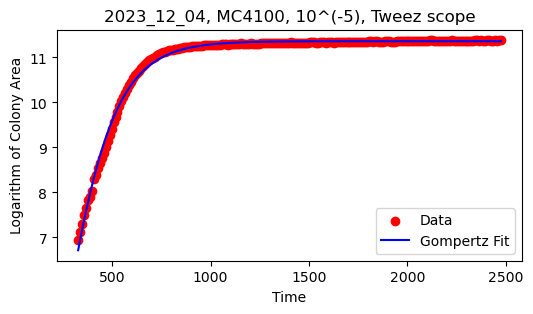

Fitted parameters [A, mu_m, lambda]: [1.13616370e+01 2.74450119e-02 7.57622368e+01], idxdf: 94. Area0: 1029.0


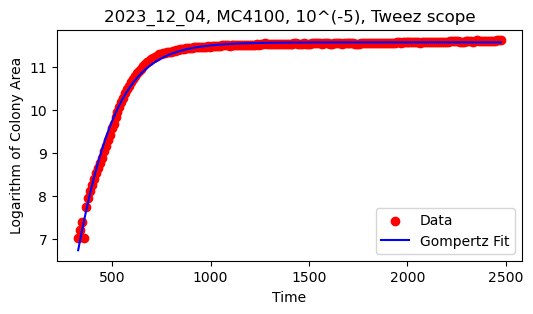

Fitted parameters [A, mu_m, lambda]: [1.15832140e+01 2.83010324e-02 8.35733045e+01], idxdf: 95. Area0: 1112.0


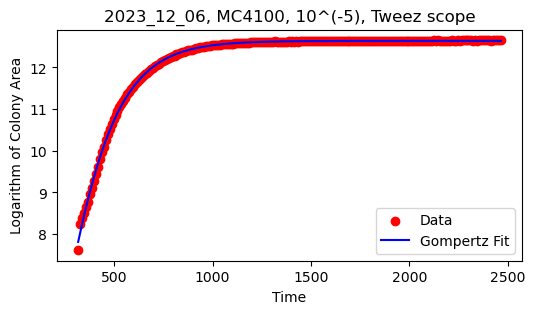

Fitted parameters [A, mu_m, lambda]: [12.63653509  0.02746463 22.78045846], idxdf: 96. Area0: 2027.0


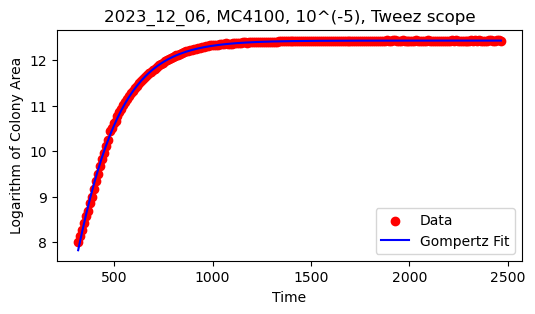

Fitted parameters [A, mu_m, lambda]: [12.42546858  0.02621889  7.235483  ], idxdf: 97. Area0: 2993.0


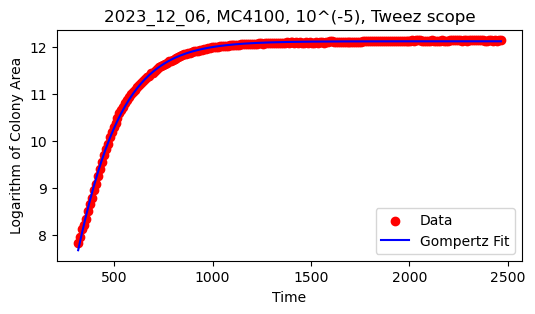

Fitted parameters [A, mu_m, lambda]: [12.12480878  0.02483998 -3.86245807], idxdf: 98. Area0: 2512.0


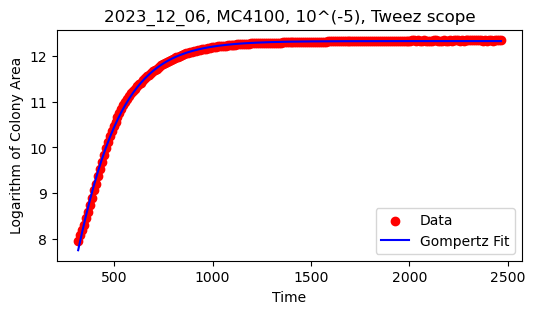

Fitted parameters [A, mu_m, lambda]: [12.3193579   0.02549625  1.09310075], idxdf: 99. Area0: 2896.0


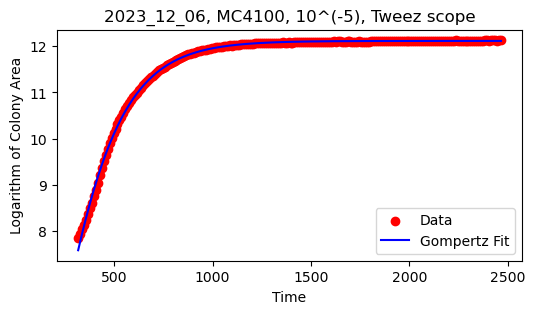

Fitted parameters [A, mu_m, lambda]: [ 12.11897627   0.02324427 -20.62922509], idxdf: 100. Area0: 2519.0


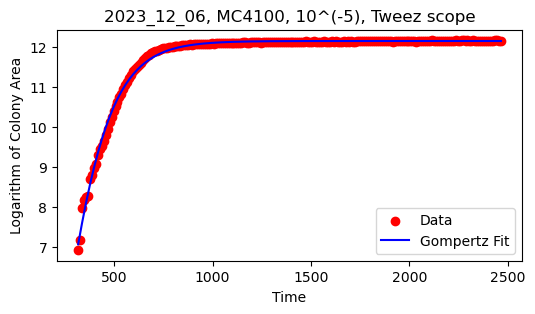

Fitted parameters [A, mu_m, lambda]: [1.21602798e+01 3.25187546e-02 9.45708984e+01], idxdf: 101. Area0: 1005.0


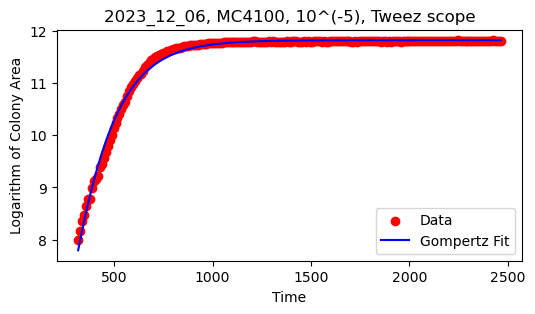

Fitted parameters [A, mu_m, lambda]: [11.82281429  0.02609521  3.34555885], idxdf: 102. Area0: 2952.0


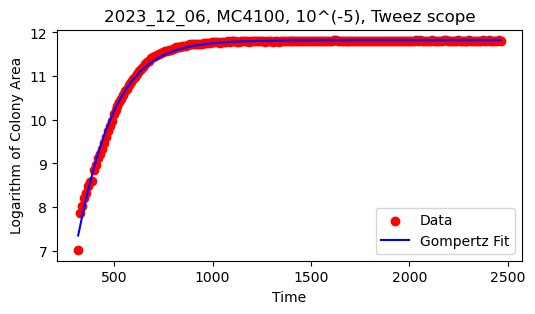

Fitted parameters [A, mu_m, lambda]: [1.18209956e+01 2.78473460e-02 4.36980117e+01], idxdf: 103. Area0: 1110.0


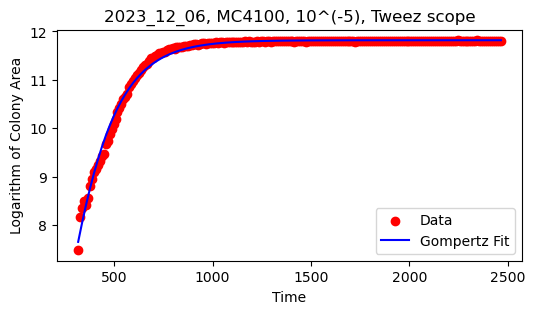

Fitted parameters [A, mu_m, lambda]: [11.81844619  0.02679924 18.39840392], idxdf: 104. Area0: 1779.0


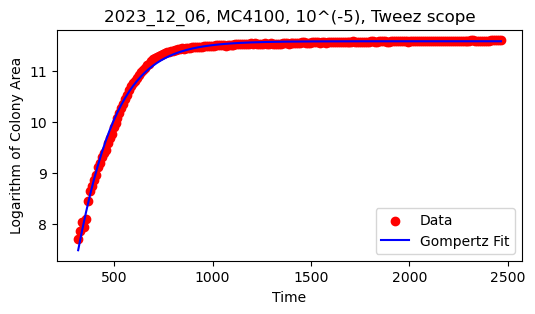

Fitted parameters [A, mu_m, lambda]: [11.57370705  0.0261202  17.92798999], idxdf: 105. Area0: 2205.0


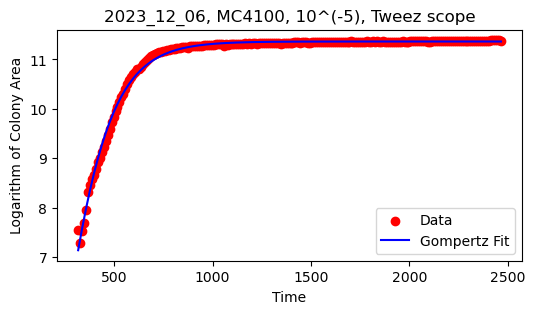

Fitted parameters [A, mu_m, lambda]: [1.13640571e+01 2.86741936e-02 5.85948052e+01], idxdf: 106. Area0: 1902.0


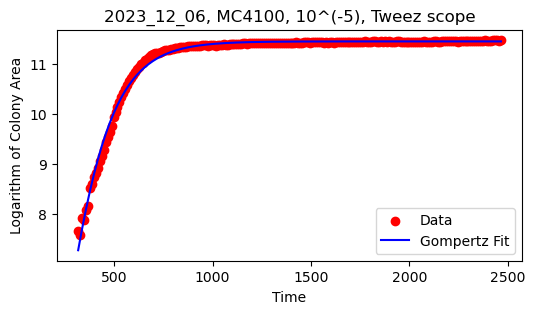

Fitted parameters [A, mu_m, lambda]: [1.14516241e+01 2.84166881e-02 5.07793699e+01], idxdf: 107. Area0: 2121.0


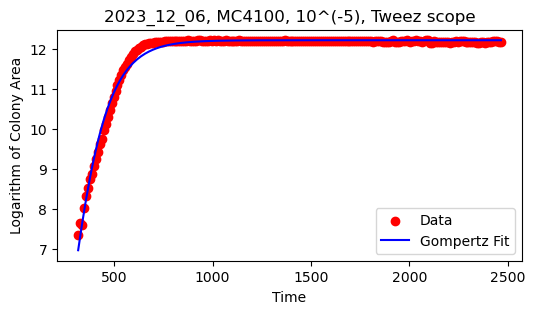

Fitted parameters [A, mu_m, lambda]: [1.22118279e+01 3.96282778e-02 1.37349422e+02], idxdf: 108. Area0: 1542.0


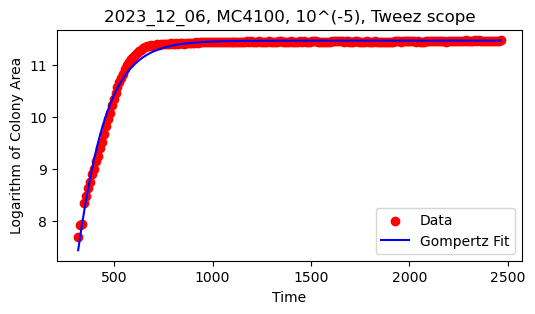

Fitted parameters [A, mu_m, lambda]: [1.14764971e+01 3.49095414e-02 9.41026980e+01], idxdf: 109. Area0: 2188.0


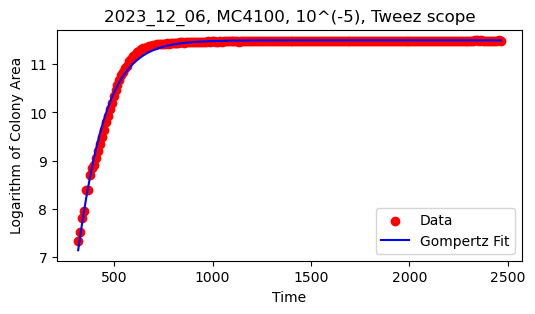

Fitted parameters [A, mu_m, lambda]: [1.14966824e+01 3.63630997e-02 1.13542975e+02], idxdf: 110. Area0: 1527.0


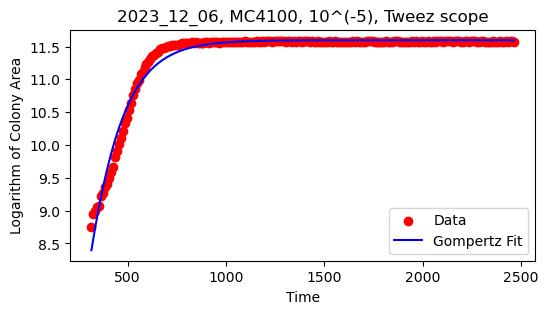

Fitted parameters [A, mu_m, lambda]: [11.59623451  0.02954913  8.39543198], idxdf: 111. Area0: 6332.0


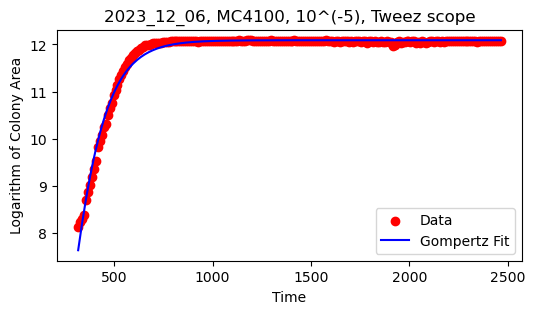

Fitted parameters [A, mu_m, lambda]: [1.20903215e+01 3.81370727e-02 1.09011377e+02], idxdf: 112. Area0: 3370.0


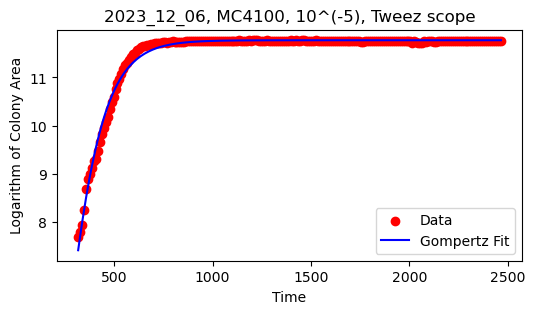

Fitted parameters [A, mu_m, lambda]: [1.17745497e+01 3.79392018e-02 1.14015316e+02], idxdf: 113. Area0: 2157.0


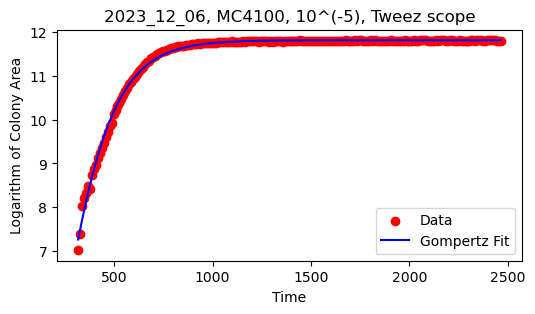

Fitted parameters [A, mu_m, lambda]: [1.18198216e+01 2.84977965e-02 5.37297524e+01], idxdf: 114. Area0: 1114.0


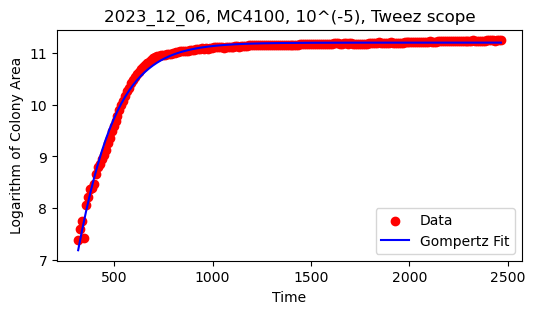

Fitted parameters [A, mu_m, lambda]: [1.11998889e+01 2.60184411e-02 2.89970379e+01], idxdf: 115. Area0: 1605.0


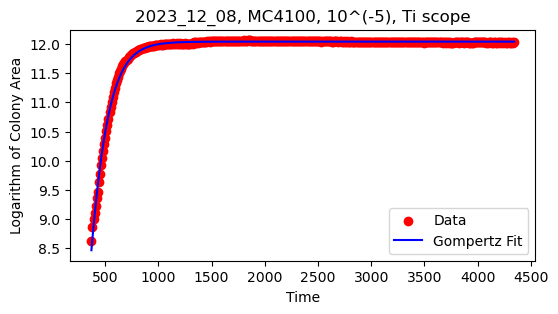

Fitted parameters [A, mu_m, lambda]: [1.20396490e+01 3.20848700e-02 8.98080278e+01], idxdf: 116. Area0: 5578.0


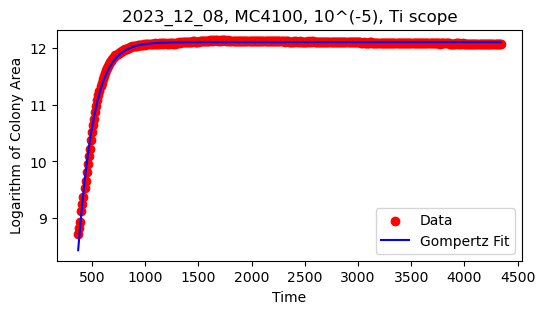

Fitted parameters [A, mu_m, lambda]: [1.21061043e+01 3.42348353e-02 1.09641940e+02], idxdf: 117. Area0: 6123.0


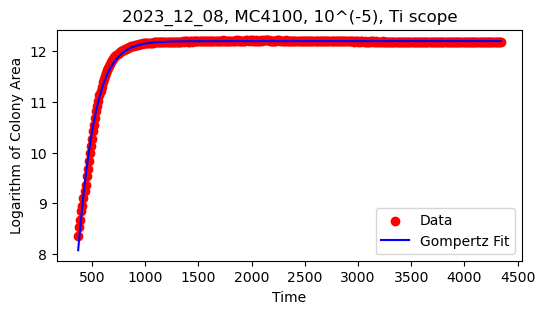

Fitted parameters [A, mu_m, lambda]: [1.21994328e+01 3.30292166e-02 1.15874172e+02], idxdf: 118. Area0: 4235.0


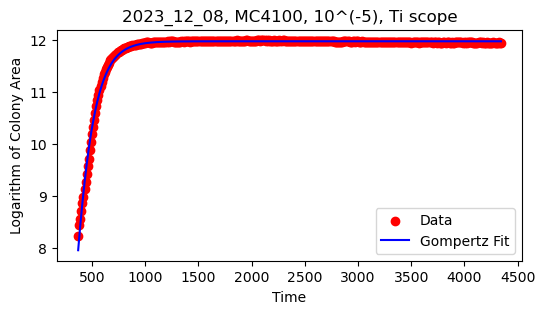

Fitted parameters [A, mu_m, lambda]: [1.19698473e+01 3.40897308e-02 1.27444034e+02], idxdf: 119. Area0: 3724.0


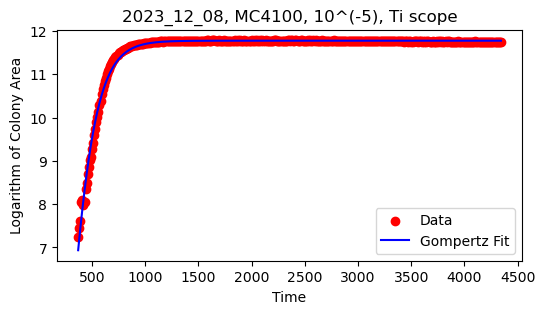

Fitted parameters [A, mu_m, lambda]: [1.17734581e+01 3.03465074e-02 1.38406656e+02], idxdf: 120. Area0: 1409.0


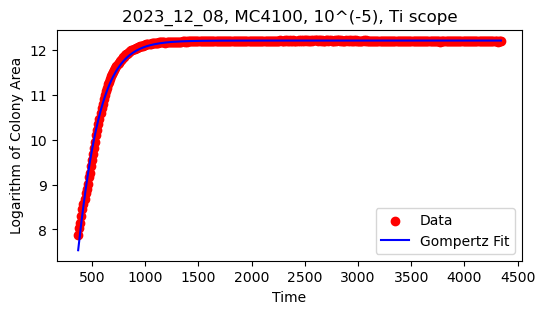

Fitted parameters [A, mu_m, lambda]: [1.22136646e+01 2.67812080e-02 8.20599976e+01], idxdf: 121. Area0: 2625.0


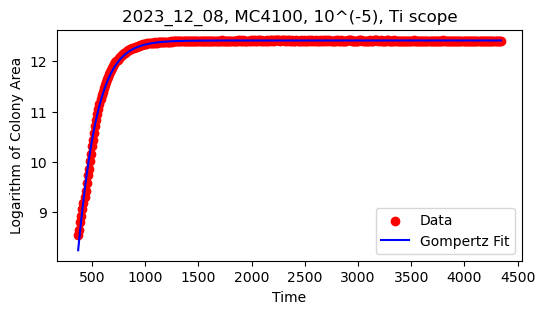

Fitted parameters [A, mu_m, lambda]: [1.24136751e+01 3.00251241e-02 8.40266082e+01], idxdf: 122. Area0: 5138.0


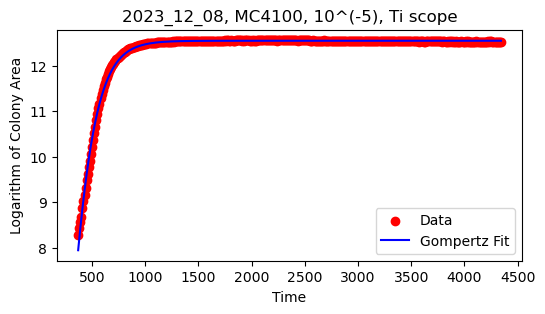

Fitted parameters [A, mu_m, lambda]: [1.25456546e+01 3.14058160e-02 1.09681438e+02], idxdf: 123. Area0: 3973.0


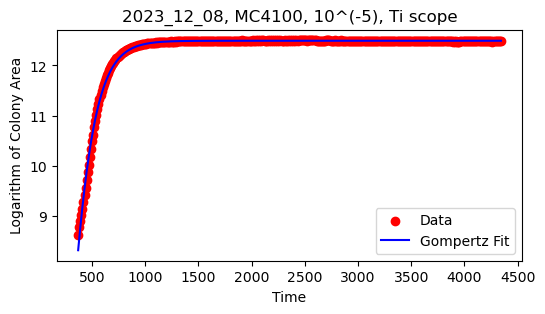

Fitted parameters [A, mu_m, lambda]: [1.24913531e+01 3.18802027e-02 9.80428071e+01], idxdf: 124. Area0: 5582.0


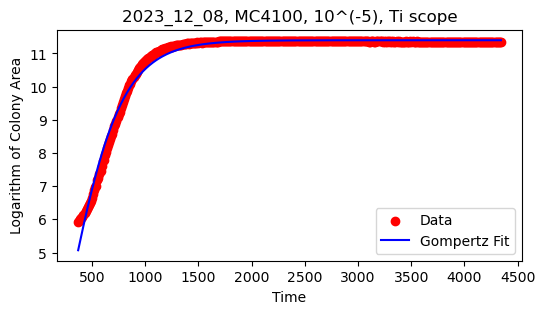

Fitted parameters [A, mu_m, lambda]: [1.13969804e+01 1.54691780e-02 4.38302059e+01], idxdf: 125. Area0: 377.0


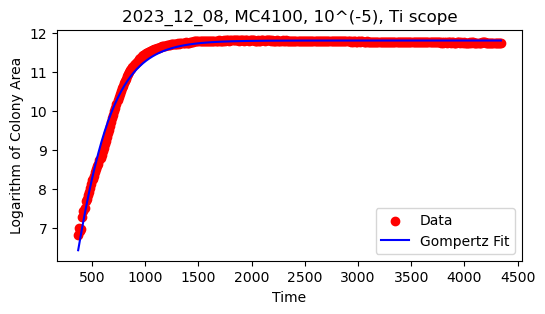

Fitted parameters [A, mu_m, lambda]: [11.80091119  0.01773372  5.24848165], idxdf: 126. Area0: 909.0


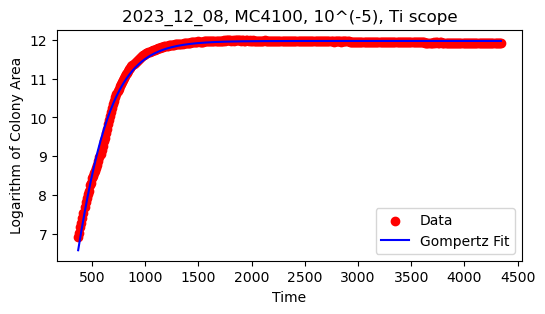

Fitted parameters [A, mu_m, lambda]: [1.19717975e+01 1.90095185e-02 2.17348221e+01], idxdf: 127. Area0: 999.0


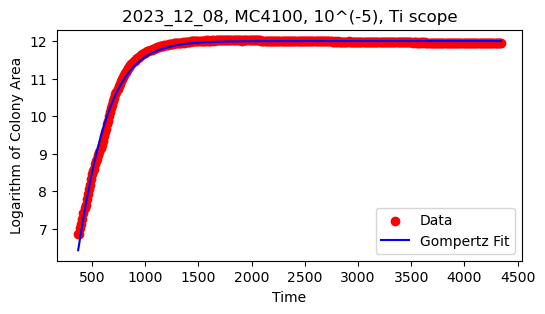

Fitted parameters [A, mu_m, lambda]: [1.20054330e+01 2.00180316e-02 4.77178706e+01], idxdf: 128. Area0: 944.0


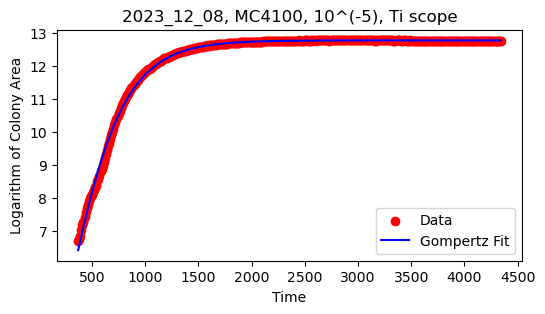

Fitted parameters [A, mu_m, lambda]: [ 1.27722834e+01  1.56246159e-02 -4.07256798e+01], idxdf: 129. Area0: 796.0


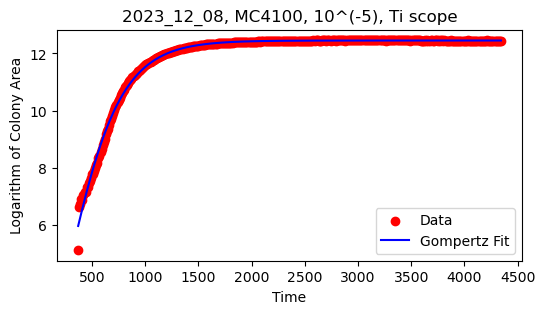

Fitted parameters [A, mu_m, lambda]: [12.45394661  0.0163985   7.58760751], idxdf: 130. Area0: 165.0


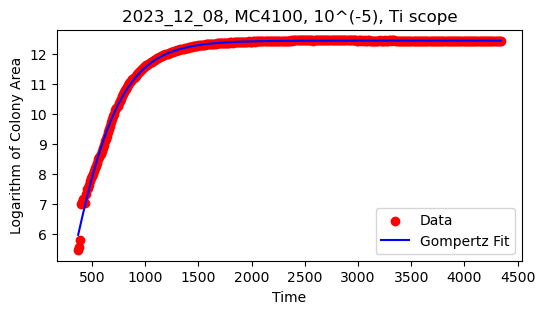

Fitted parameters [A, mu_m, lambda]: [12.44843652  0.01663107 12.62200798], idxdf: 131. Area0: 231.0


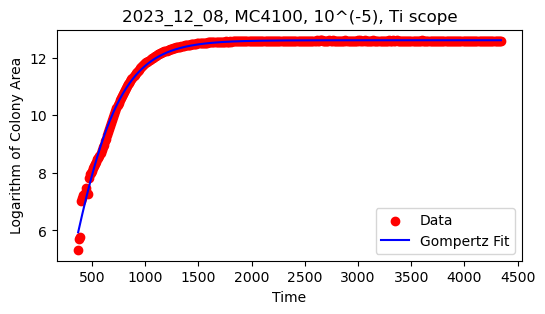

Fitted parameters [A, mu_m, lambda]: [1.26092984e+01 1.71773098e-02 2.53523904e+01], idxdf: 132. Area0: 203.0


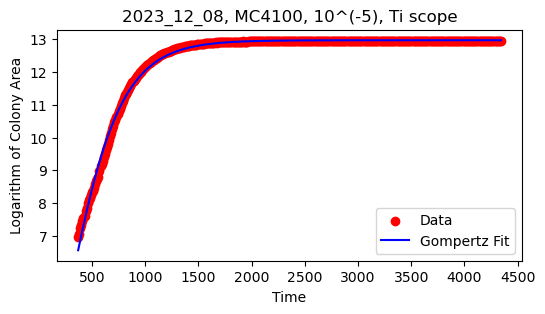

Fitted parameters [A, mu_m, lambda]: [ 1.29682777e+01  1.67740439e-02 -2.17521864e+01], idxdf: 133. Area0: 1074.0


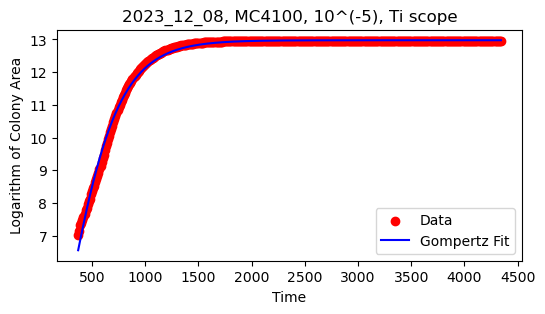

Fitted parameters [A, mu_m, lambda]: [12.97594457  0.01750909 -4.90610803], idxdf: 134. Area0: 1137.0


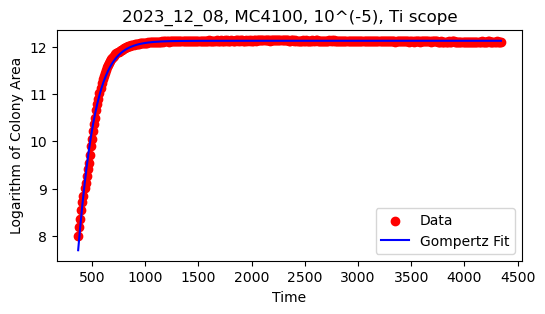

Fitted parameters [A, mu_m, lambda]: [1.21322246e+01 3.38770157e-02 1.36662085e+02], idxdf: 135. Area0: 2952.0


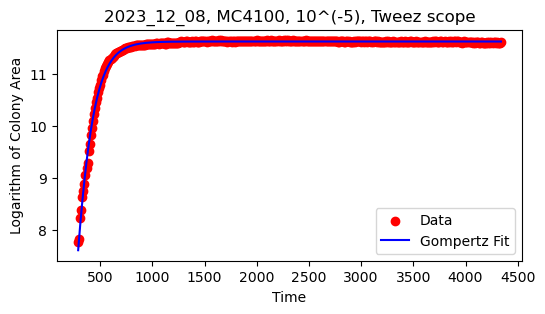

Fitted parameters [A, mu_m, lambda]: [1.16161176e+01 3.45319667e-02 5.88050287e+01], idxdf: 136. Area0: 2346.0


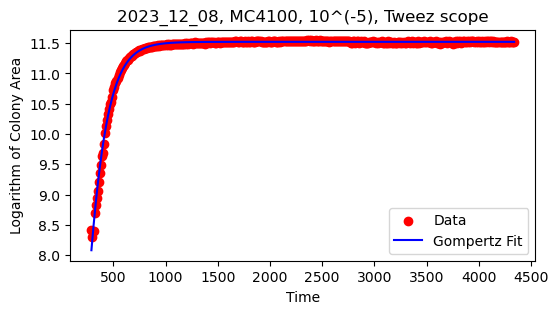

Fitted parameters [A, mu_m, lambda]: [11.52194567  0.03073889  8.18100713], idxdf: 137. Area0: 4505.0


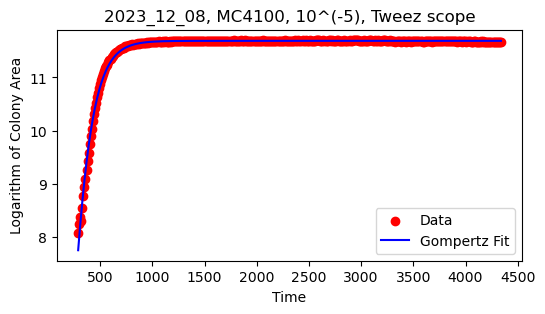

Fitted parameters [A, mu_m, lambda]: [1.16877470e+01 3.42447909e-02 5.14391964e+01], idxdf: 138. Area0: 3222.0


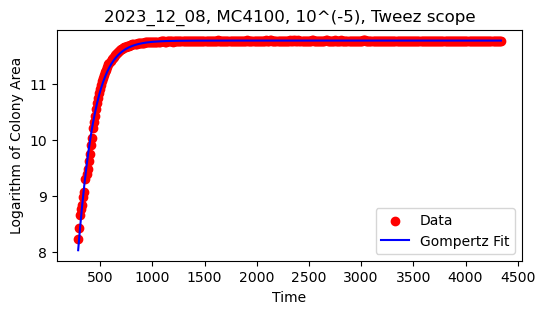

Fitted parameters [A, mu_m, lambda]: [11.78482248  0.03219941 25.6189707 ], idxdf: 139. Area0: 3737.0


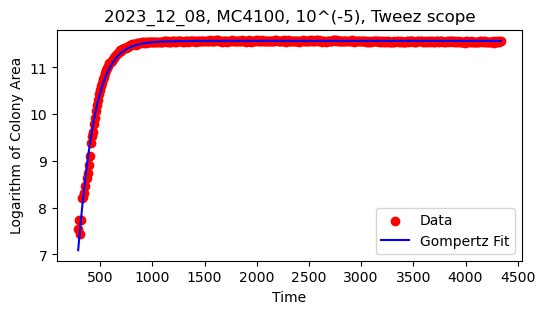

Fitted parameters [A, mu_m, lambda]: [1.15663669e+01 3.18559239e-02 5.99867943e+01], idxdf: 140. Area0: 1897.0


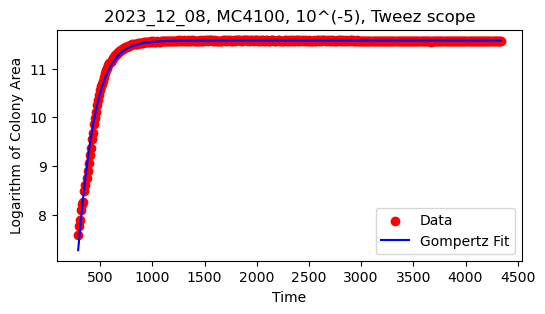

Fitted parameters [A, mu_m, lambda]: [1.15756612e+01 3.15141756e-02 5.02625368e+01], idxdf: 141. Area0: 1978.0


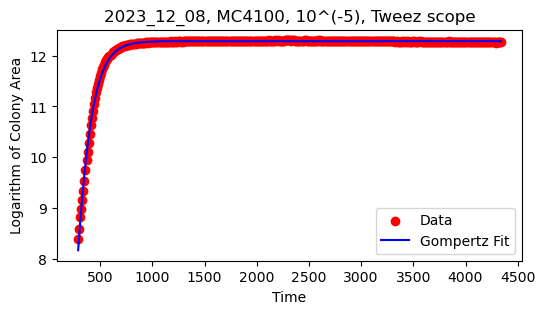

Fitted parameters [A, mu_m, lambda]: [1.22828785e+01 4.02737810e-02 7.59247906e+01], idxdf: 142. Area0: 4465.0


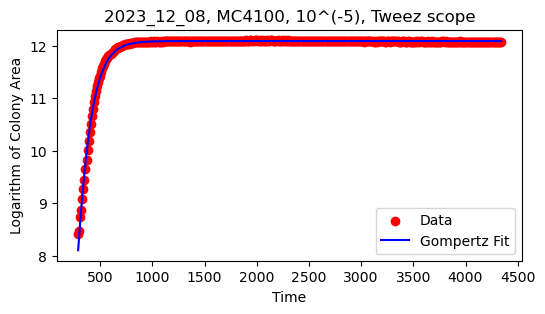

Fitted parameters [A, mu_m, lambda]: [1.20895504e+01 4.02486853e-02 7.72255713e+01], idxdf: 143. Area0: 4480.0


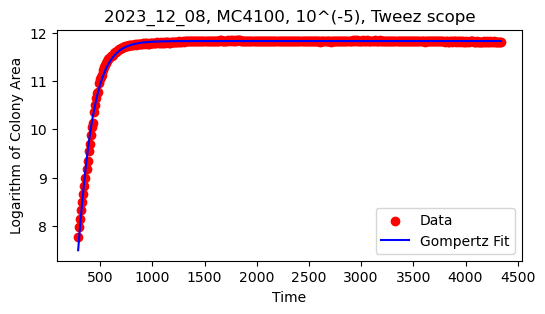

Fitted parameters [A, mu_m, lambda]: [1.18240562e+01 3.61726019e-02 7.40247108e+01], idxdf: 144. Area0: 2401.0


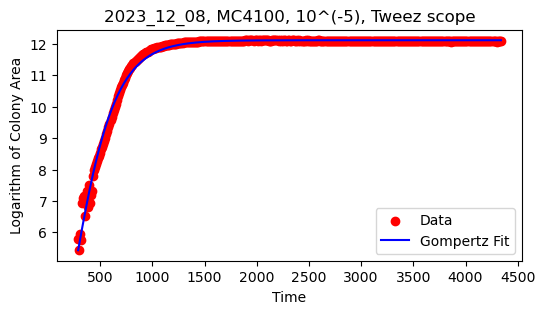

Fitted parameters [A, mu_m, lambda]: [12.11627027  0.01929524  7.17205713], idxdf: 145. Area0: 322.0
En except


/tmp/ipykernel_1223843/1512405469.py:12: RuntimeWarning: divide by zero encountered in log
  params, cov = curve_fit(gompertz, time_points, np.log(area), p0, maxfev = 10000)#, bounds=([1, 0, 0], [np.inf, np.inf, np.inf]), max_nfev=10000)
/tmp/ipykernel_1223843/1512405469.py:15: RuntimeWarning: divide by zero encountered in log
  idx = np.where(np.isfinite(np.log(area)))[0]
/tmp/ipykernel_1223843/1512405469.py:16: RuntimeWarning: divide by zero encountered in log
  params, cov = curve_fit(gompertz, time_points[idx], np.log(area)[idx], p0, maxfev = 10000)#, bounds=([1, 0, 0], [np.inf, np.inf, np.inf]), max_nfev=10000)
/tmp/ipykernel_1223843/1512405469.py:19: RuntimeWarning: divide by zero encountered in log
  plt.scatter(time_points, np.log(area), color='red', label='Data')


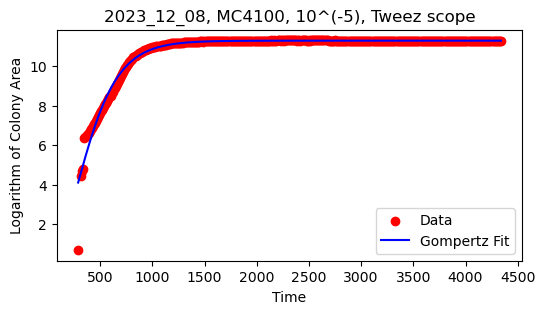

Fitted parameters [A, mu_m, lambda]: [1.12839069e+01 1.90749223e-02 7.33629190e+01], idxdf: 146. Area0: 2.0
En except


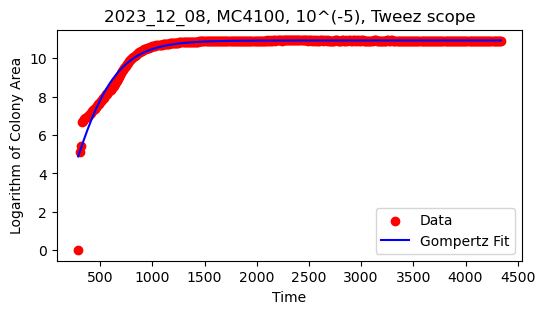

Fitted parameters [A, mu_m, lambda]: [10.92749155  0.0167003  -4.05497209], idxdf: 147. Area0: 1.0


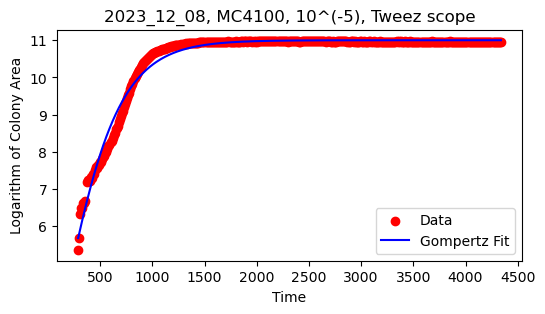

Fitted parameters [A, mu_m, lambda]: [ 1.10003962e+01  1.34715020e-02 -1.35719729e+02], idxdf: 148. Area0: 211.0
En except


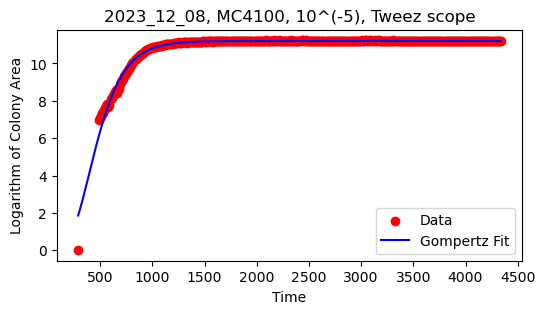

Fitted parameters [A, mu_m, lambda]: [1.12063797e+01 2.26650160e-02 2.13681863e+02], idxdf: 149. Area0: 1.0


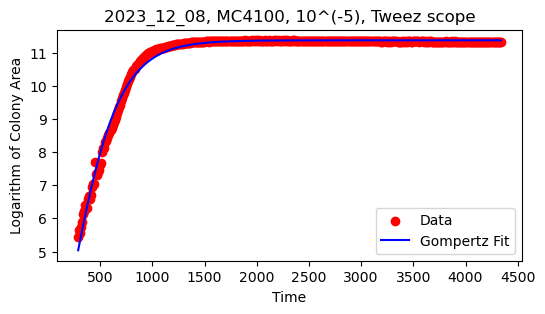

Fitted parameters [A, mu_m, lambda]: [ 1.13753744e+01  1.64544174e-02 -1.75671261e+01], idxdf: 150. Area0: 232.0


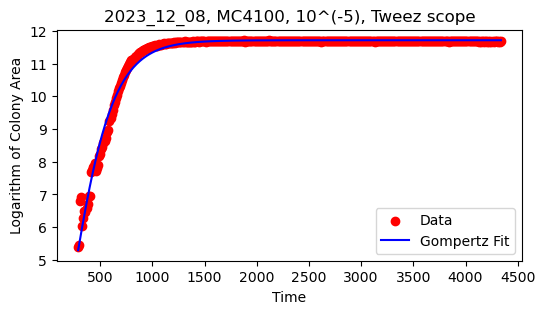

Fitted parameters [A, mu_m, lambda]: [11.71494885  0.01935465 15.0545546 ], idxdf: 151. Area0: 221.0
En except


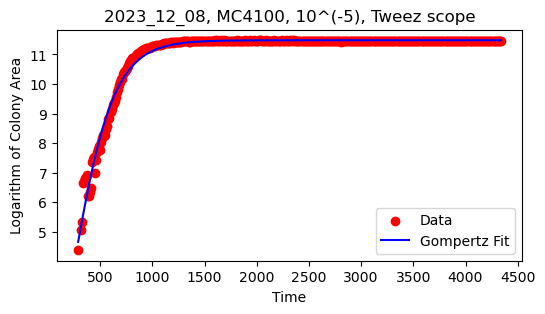

Fitted parameters [A, mu_m, lambda]: [1.14821247e+01 1.97981601e-02 5.33359247e+01], idxdf: 152. Area0: 80.0
En except


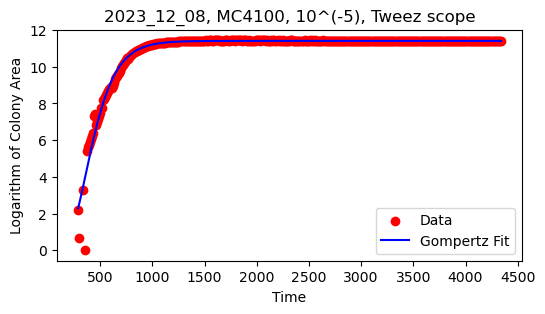

Fitted parameters [A, mu_m, lambda]: [1.14108149e+01 2.66127181e-02 2.06033655e+02], idxdf: 153. Area0: 9.0


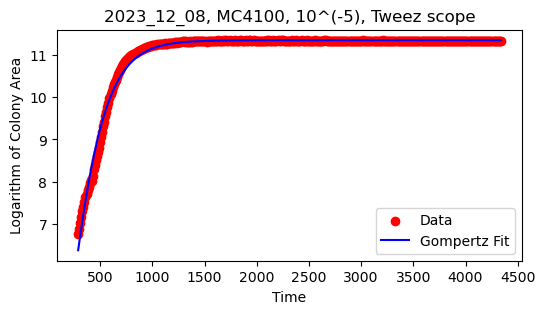

Fitted parameters [A, mu_m, lambda]: [ 1.13520190e+01  2.05559004e-02 -2.59567315e+01], idxdf: 154. Area0: 863.0


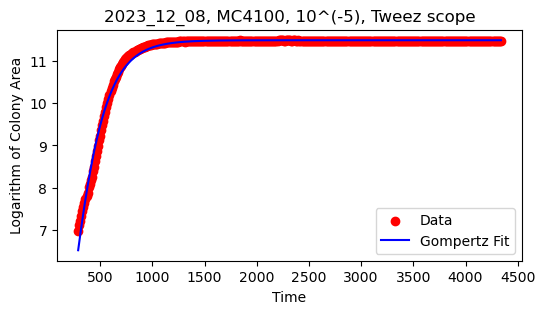

Fitted parameters [A, mu_m, lambda]: [ 11.49858793   0.02160819 -17.34769853], idxdf: 155. Area0: 1061.0


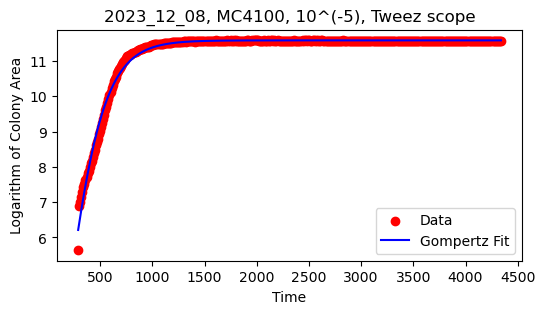

Fitted parameters [A, mu_m, lambda]: [11.58133458  0.0213759  -4.69087843], idxdf: 156. Area0: 281.0


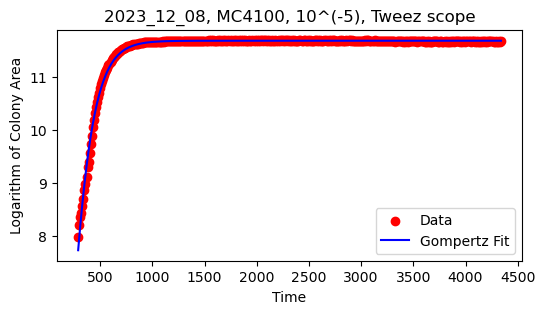

Fitted parameters [A, mu_m, lambda]: [1.16760438e+01 3.22175271e-02 3.77211132e+01], idxdf: 157. Area0: 2907.0


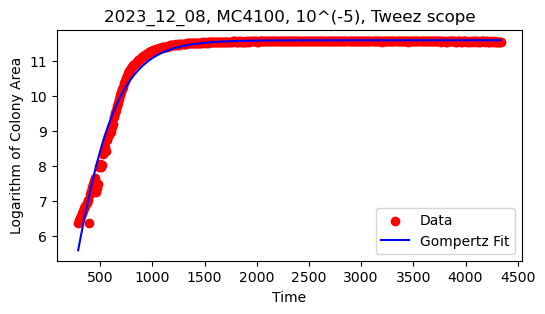

Fitted parameters [A, mu_m, lambda]: [ 1.15951804e+01  1.66987453e-02 -4.66007363e+01], idxdf: 158. Area0: 587.0


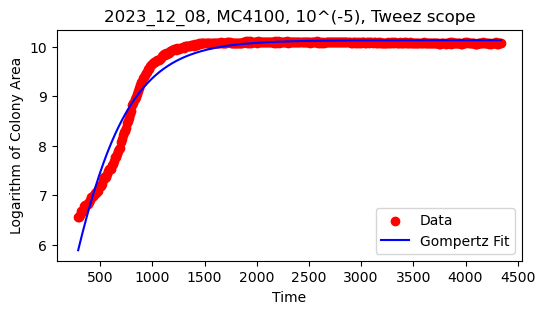

Fitted parameters [A, mu_m, lambda]: [ 1.01309096e+01  1.01227887e-02 -3.04164553e+02], idxdf: 159. Area0: 699.0


In [13]:
for i in df.index.values:
    # Fit the model
    incub_time_s = datetime.strptime(df.loc[i,'t_im'], '%H:%M:%S') - datetime.strptime(df.loc[i,'t_incub'], '%H:%M:%S')
    incub_time_n = incub_time_s.seconds / 60
    area = extract_array(df.loc[i,'area'])
    if area[0] <= 0:
        area[0] = 1
    time_points = np.arange(0, df.loc[i, 'exp length'])*10 + incub_time_n
    
    p0=[area[-1], 200, incub_time_n]
    try:
        params, cov = curve_fit(gompertz, time_points, np.log(area), p0, maxfev = 10000)#, bounds=([1, 0, 0], [np.inf, np.inf, np.inf]), max_nfev=10000)
    except:
        print("En except")
        idx = np.where(np.isfinite(np.log(area)))[0]
        params, cov = curve_fit(gompertz, time_points[idx], np.log(area)[idx], p0, maxfev = 10000)#, bounds=([1, 0, 0], [np.inf, np.inf, np.inf]), max_nfev=10000)
    # Plotting the data and the model to see the fit
    plt.figure(figsize=(6, 3))
    plt.scatter(time_points, np.log(area), color='red', label='Data')
    plt.plot(time_points, gompertz(time_points, *params), label='Gompertz Fit', color='blue')
    plt.title(f"{datetime.strftime(df.loc[i,'Date'],'%Y_%m_%d')}, {df.loc[i,'Strain']}, {df.loc[i,'Dilution']}, {df.loc[i, 'Machine']}")
    plt.xlabel('Time')
    plt.ylabel('Logarithm of Colony Area')
    plt.legend()
    plt.show()
    pars_dict = {'A': params[0], 'mu_m': params[1], 'lambda': params[2]}
    df.at[i, 'gomp_params'] = json.dumps(pars_dict)
    # Print the fitted parameters
    print(f"Fitted parameters [A, mu_m, lambda]: {params}, idxdf: {i}. Area0: {area[0]}")

#### Bad fit

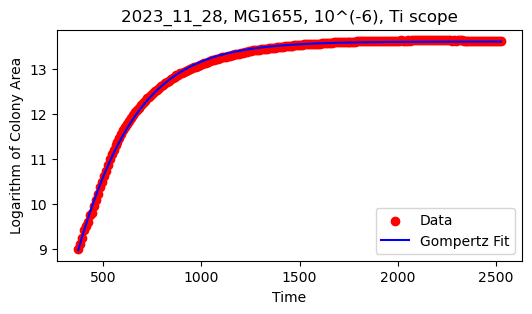

Fitted parameters [A, mu_m, lambda]: [ 1.36197896e+01  2.01930489e-02 -9.07720047e+01], idxdf: 21. Area0: 8001.0


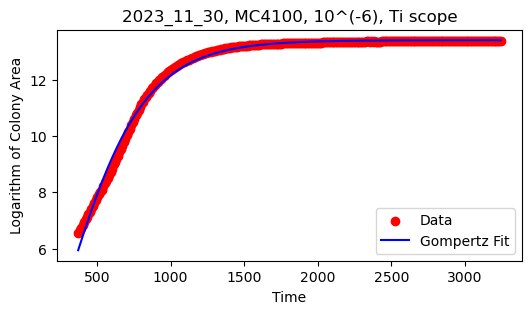

Fitted parameters [A, mu_m, lambda]: [13.41295219  0.01668067 16.57074784], idxdf: 40. Area0: 706.0


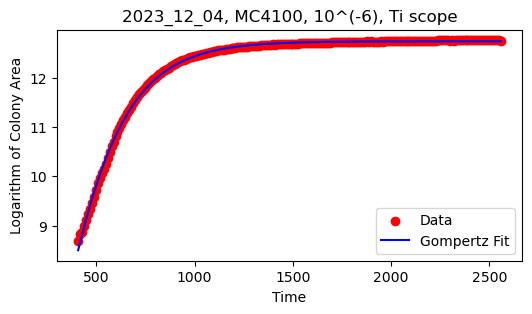

Fitted parameters [A, mu_m, lambda]: [12.73841646  0.02234901  8.58063727], idxdf: 67. Area0: 5917.0


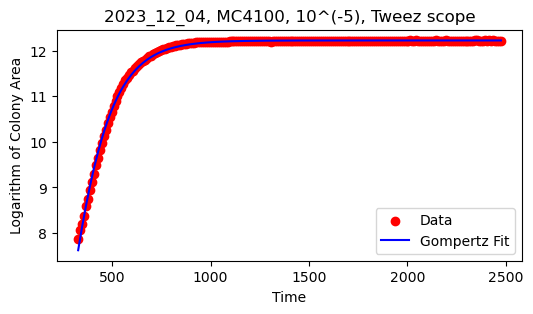

Fitted parameters [A, mu_m, lambda]: [1.22288894e+01 3.33470741e-02 9.01075020e+01], idxdf: 76. Area0: 2632.0


In [14]:
for i in [21,40,67,76]:
    # Fit the model
    incub_time_s = datetime.strptime(df.loc[i,'t_im'], '%H:%M:%S') - datetime.strptime(df.loc[i,'t_incub'], '%H:%M:%S')
    incub_time_n = incub_time_s.seconds / 60
    area = extract_array(df.loc[i,'area'])
    if area[0] <= 0:
        area[0] = 1
    time_points = np.arange(0, df.loc[i, 'exp length'])*10 + incub_time_n
    
    p0=[area[-1], 300, incub_time_n]
    try:
        params, cov = curve_fit(gompertz, time_points, np.log(area), p0, maxfev = 10000)#, bounds=([1, 0, 0], [np.inf, np.inf, np.inf]), max_nfev=10000)
    except:
        print("En except")
        idx = np.where(np.isfinite(np.log(area)))[0]
        params, cov = curve_fit(gompertz, time_points[idx], np.log(area)[idx], p0, maxfev = 10000)#, bounds=([1, 0, 0], [np.inf, np.inf, np.inf]), max_nfev=10000)
    # Plotting the data and the model to see the fit
    plt.figure(figsize=(6, 3))
    plt.scatter(time_points, np.log(area), color='red', label='Data')
    plt.plot(time_points, gompertz(time_points, *params), label='Gompertz Fit', color='blue')
    plt.title(f"{datetime.strftime(df.loc[i,'Date'],'%Y_%m_%d')}, {df.loc[i,'Strain']}, {df.loc[i,'Dilution']}, {df.loc[i, 'Machine']}")
    plt.xlabel('Time')
    plt.ylabel('Logarithm of Colony Area')
    plt.legend()
    plt.show()
    pars_dict = {'A': params[0], 'mu_m': params[1], 'lambda': params[2]}
    df.at[i, 'gomp_params'] = json.dumps(pars_dict)
    # Print the fitted parameters
    print(f"Fitted parameters [A, mu_m, lambda]: {params}, idxdf: {i}. Area0: {area[0]}")

#### Inspect Gompertz fitting

0 params: [11.29467129374218, 0.03429671707062678, 75.08332064605176]


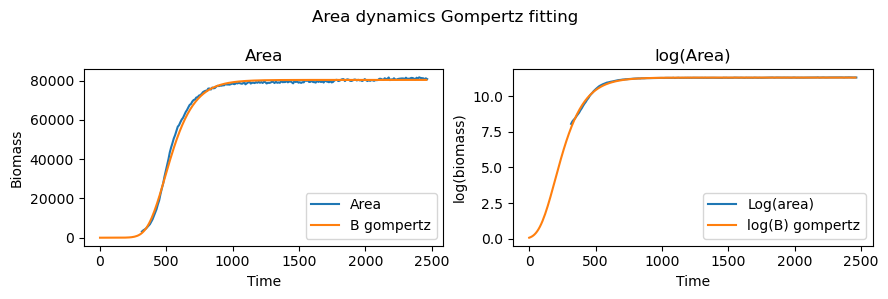

1 params: [11.651550757675393, 0.036520823864092666, 71.70371546988213]


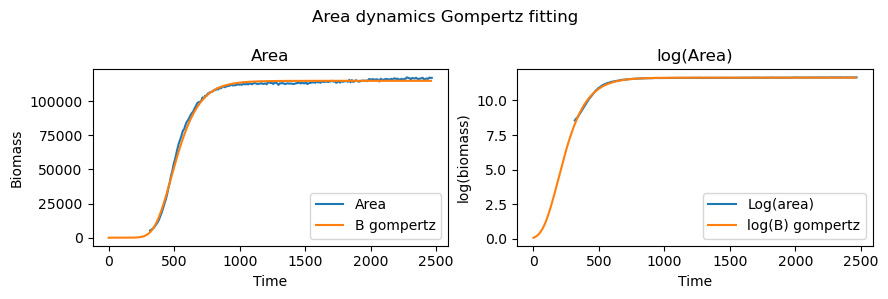

2 params: [11.58037729284504, 0.03699178625322099, 65.44342540576251]


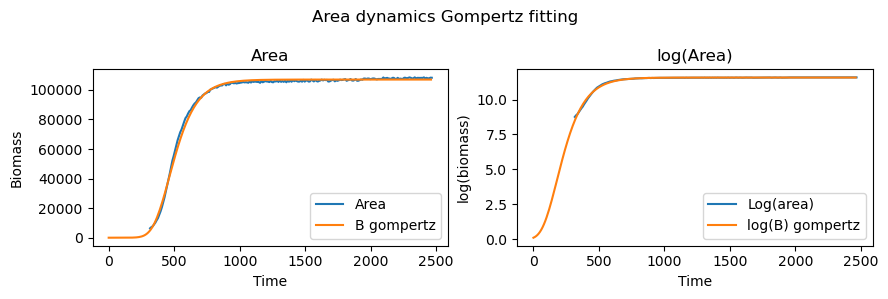

3 params: [11.263179105925273, 0.034234518259769434, 30.406601609022136]


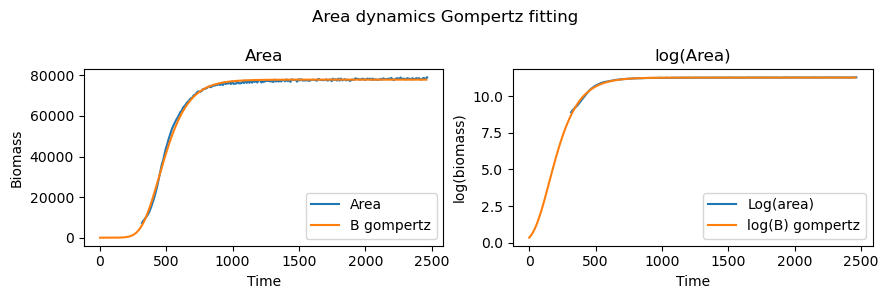

4 params: [11.528274906804539, 0.03769351424461715, 74.44094471540511]


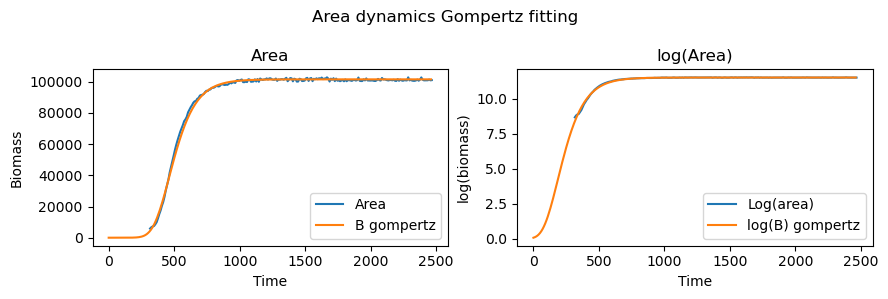

5 params: [11.30110618977755, 0.0359379882914601, 77.16912021243982]


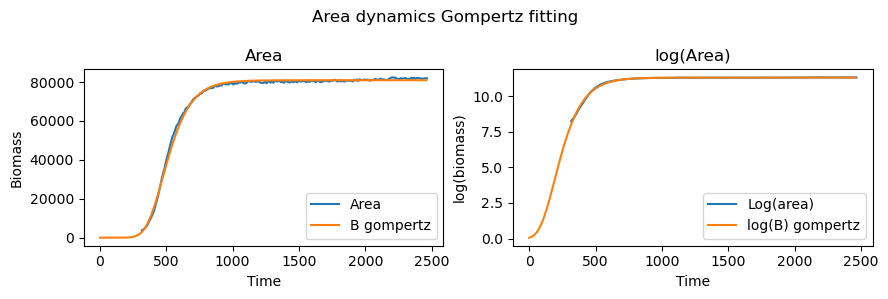

6 params: [10.666169807989318, 0.026240526742285525, 33.27931842372796]


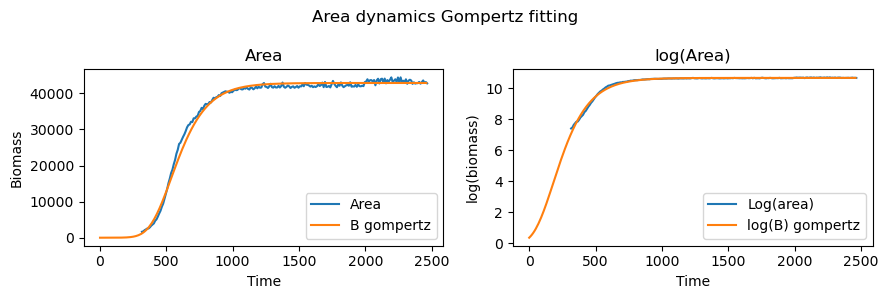

7 params: [10.200821135019638, 0.02293231153515807, 27.168039382306322]


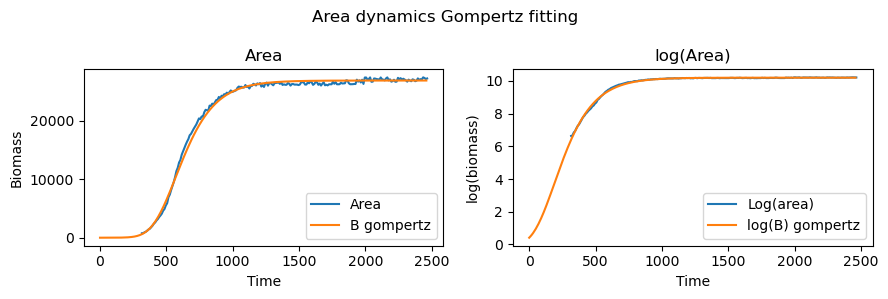

8 params: [11.632908948993883, 0.037180783750933984, 75.83491403788902]


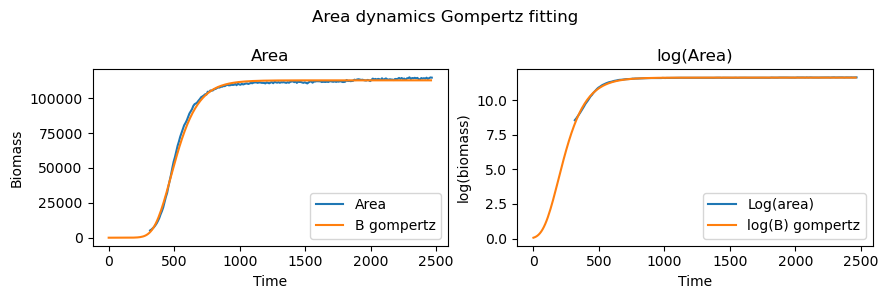

9 params: [13.02487155714516, 0.02863515995894774, 7.487755558557492]


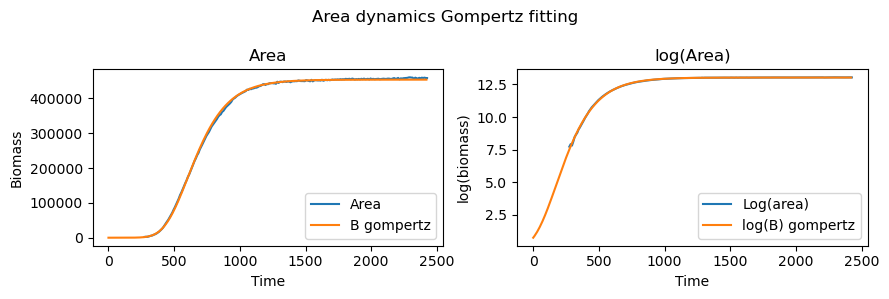

10 params: [12.856228464892602, 0.028996945193228537, 54.52758853861273]


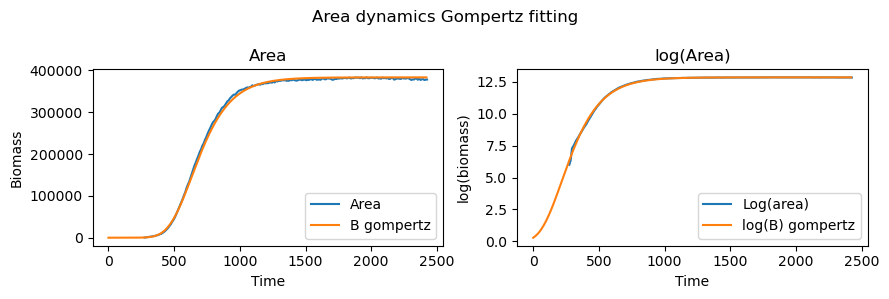

11 params: [12.469091808104203, 0.027533926856544492, 22.291036688151497]


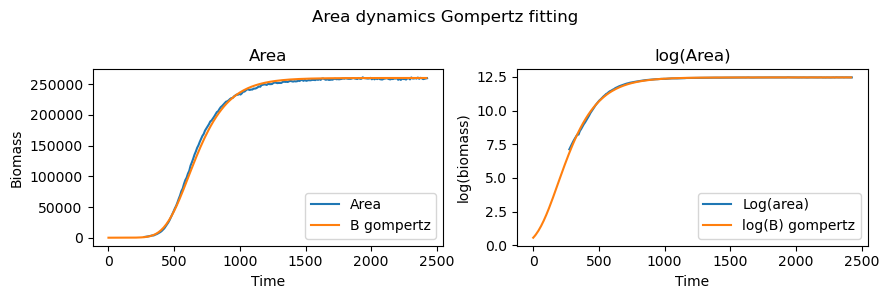

12 params: [12.303069174029957, 0.02660298895151055, -26.397862296032798]


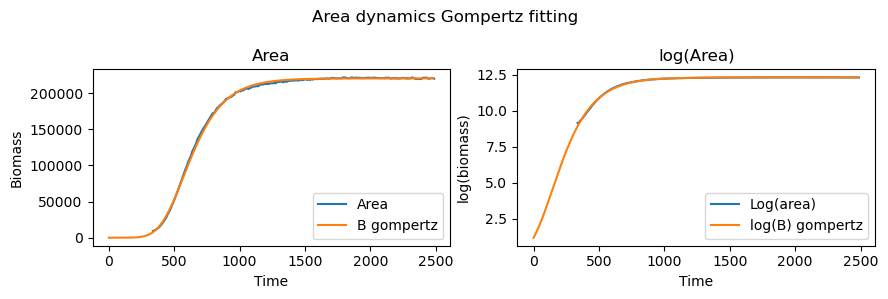

13 params: [12.573237246331013, 0.029730338870795042, -5.983178174823221]


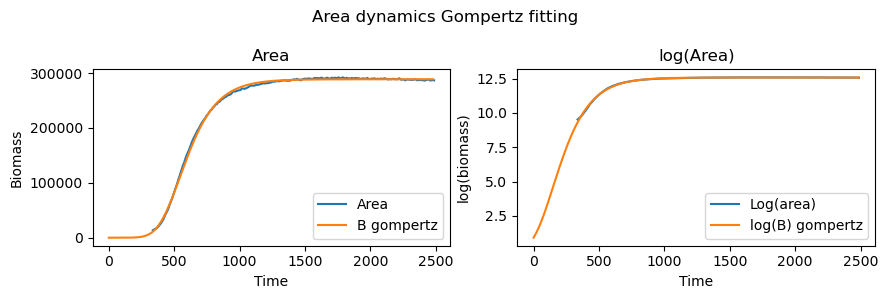

14 params: [12.704069777029353, 0.029845888621874442, -11.61811298385268]


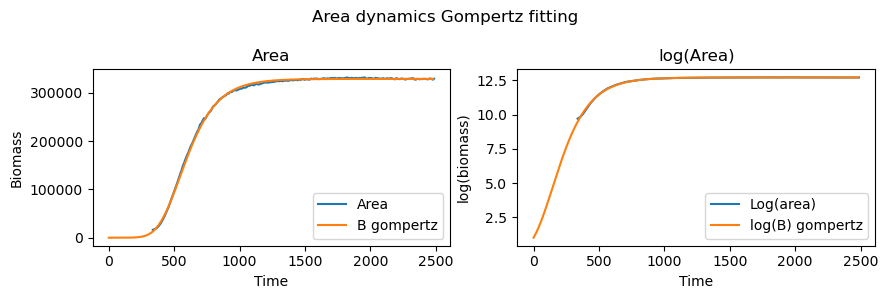

15 params: [12.496553495472456, 0.026896840605686798, -20.589247387209326]


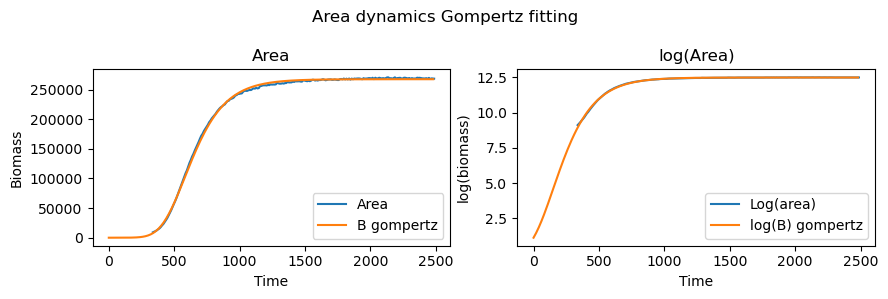

16 params: [12.52168719540932, 0.02982641047277411, -9.138592895456105]


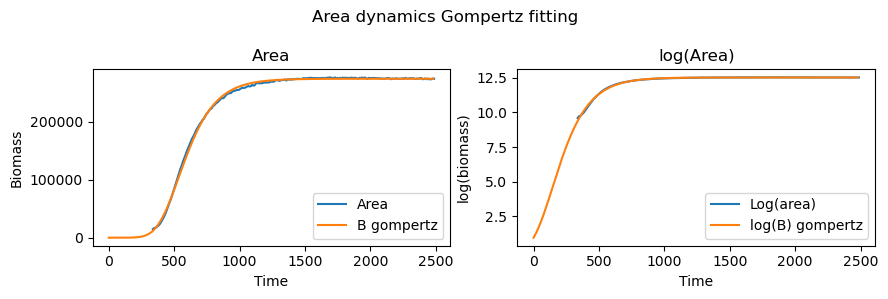

17 params: [12.599034259653054, 0.029269176132028795, -20.273149396086197]


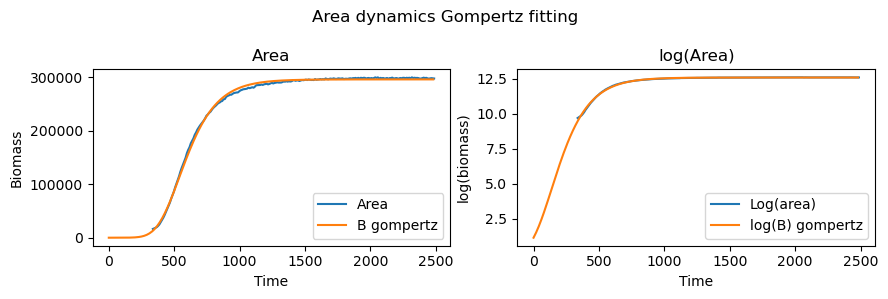

18 params: [13.133738630676234, 0.015580292124816309, -319.83558022142665]


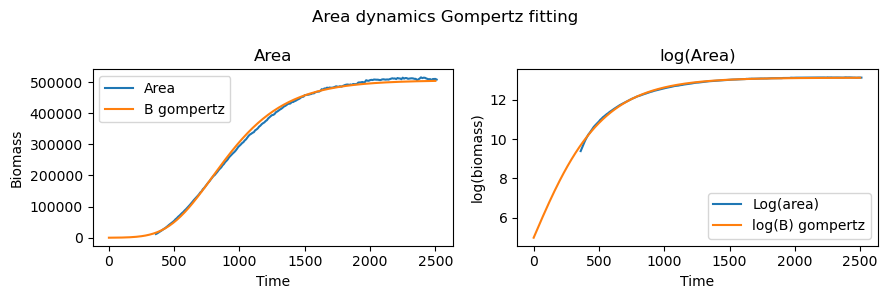

19 params: [12.830210642231108, 0.028836150954304144, -4.074395941938754]


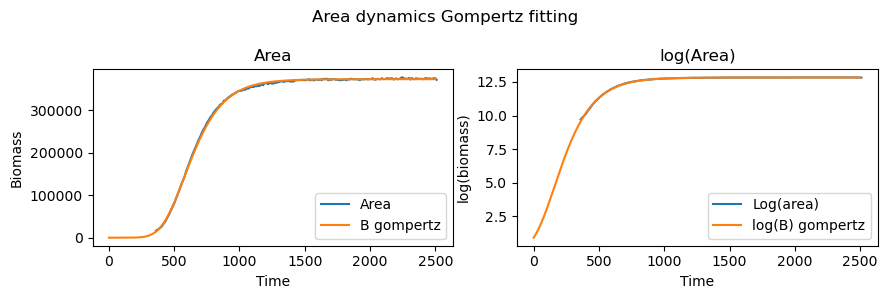

20 params: [13.300183838155878, 0.023290172092893663, -33.37157202248805]


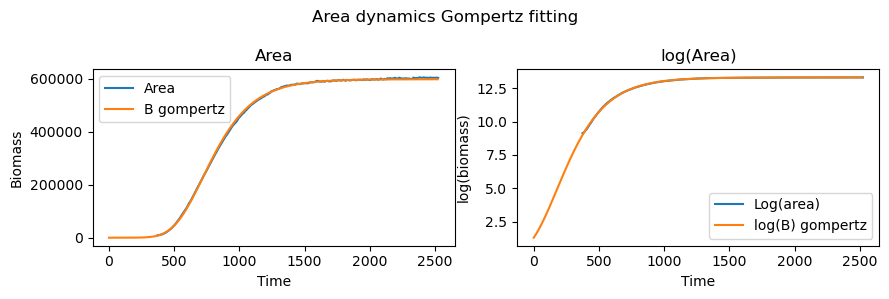

21 params: [13.619789554751197, 0.02019304885164376, -90.7720046844077]


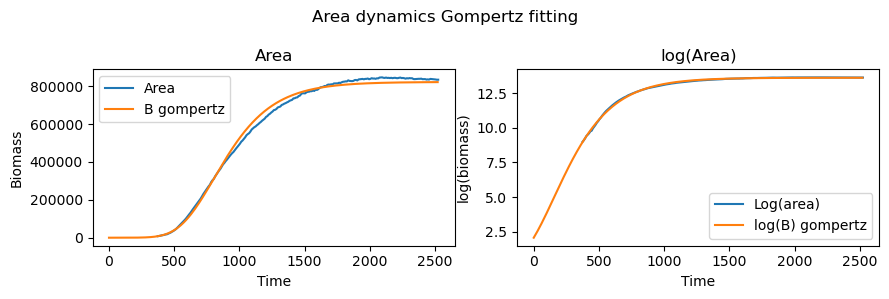

22 params: [13.533045272595148, 0.020366554385120795, -66.02264695606722]


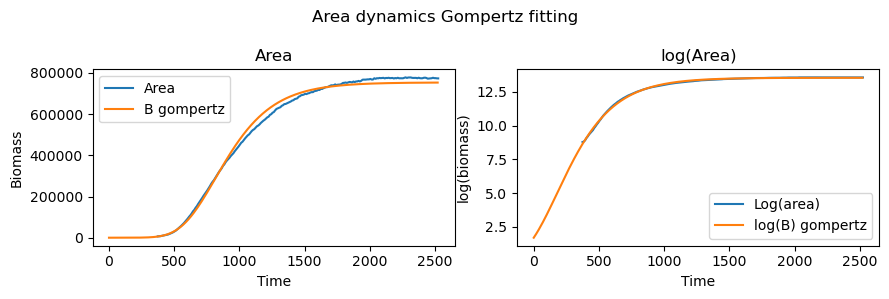

23 params: [11.978897606787504, 0.02932844290063559, 112.90289737361027]


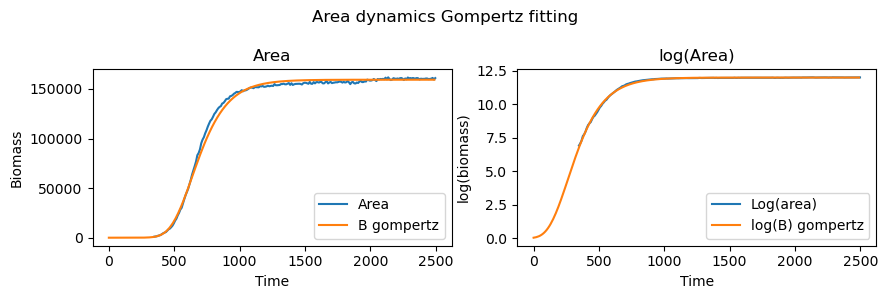

24 params: [11.989909928221625, 0.029642968407544393, 118.68323432788647]


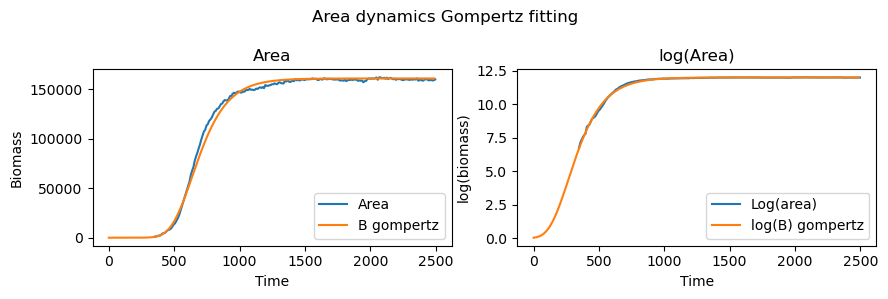

25 params: [12.028497347965269, 0.024607400471944218, 39.93054649774566]


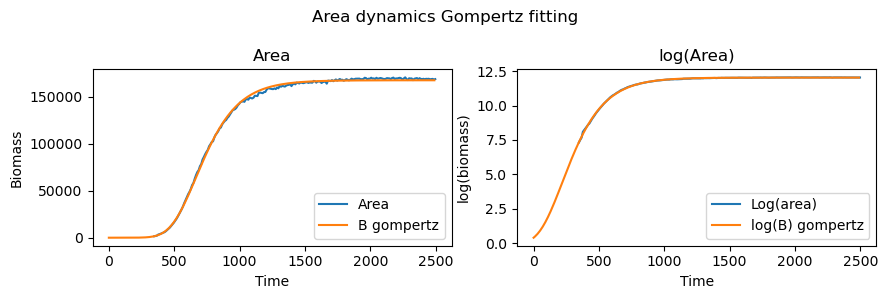

26 params: [12.030757247679198, 0.02392441837461235, 26.7042601983228]


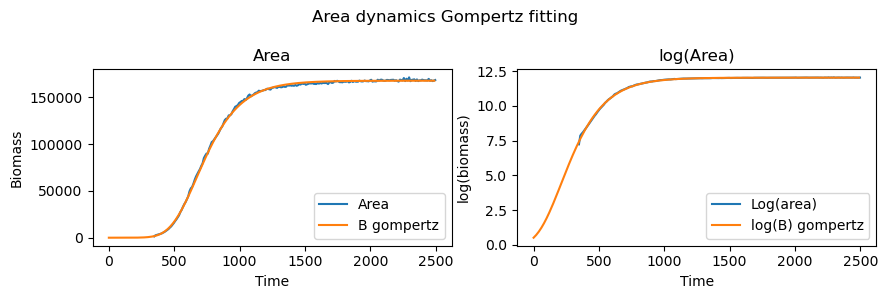

27 params: [12.106855141636474, 0.022759942159269506, 18.66163255127938]


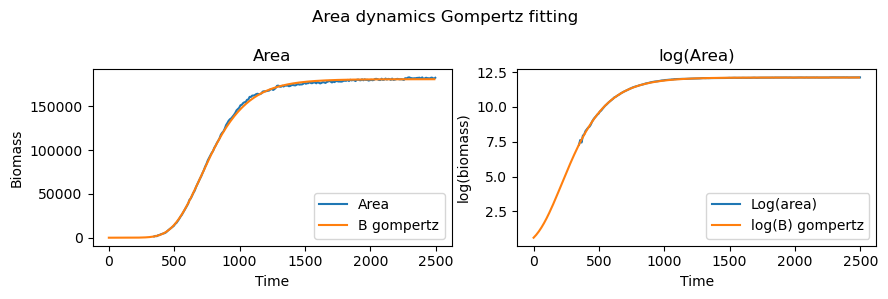

28 params: [12.46620213314426, 0.028366283914301016, 58.16343883213016]


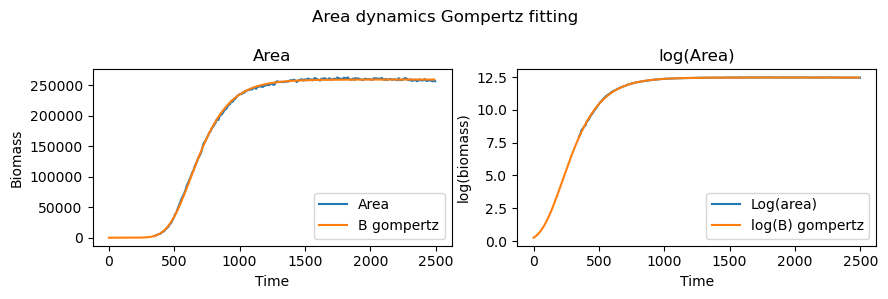

29 params: [12.84104403279139, 0.027348735910421626, 36.625135442862195]


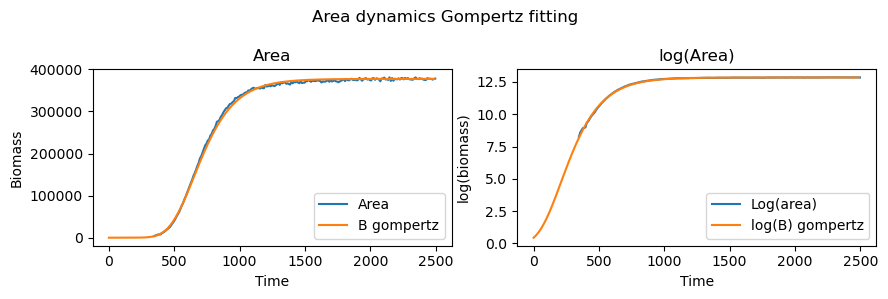

30 params: [11.994631762514928, 0.025272644779989844, 46.321263612232904]


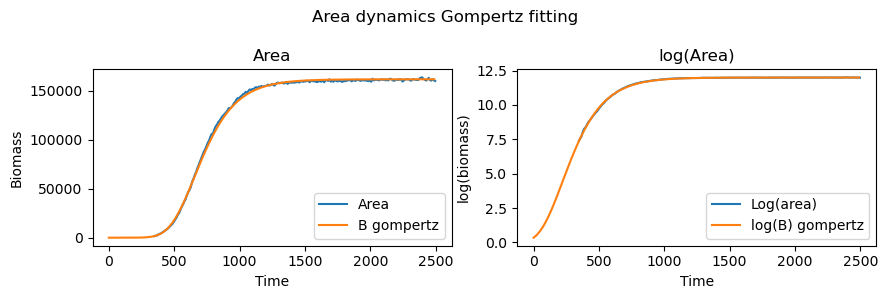

31 params: [12.038137899935421, 0.023131969445490973, 9.420731442733421]


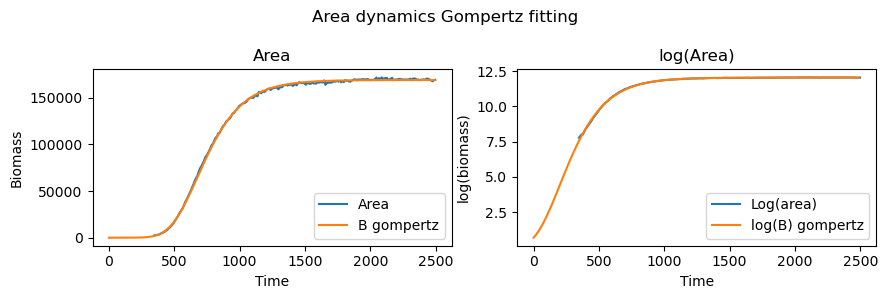

32 params: [12.645025021242649, 0.028710816366417417, 65.21405688183123]


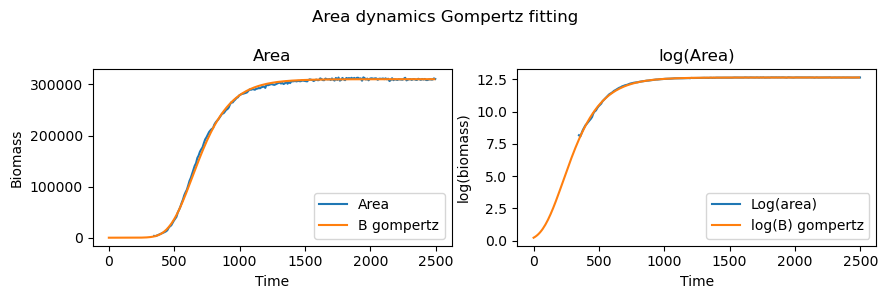

33 params: [11.915868105029803, 0.022833146300947186, 21.099308575010173]


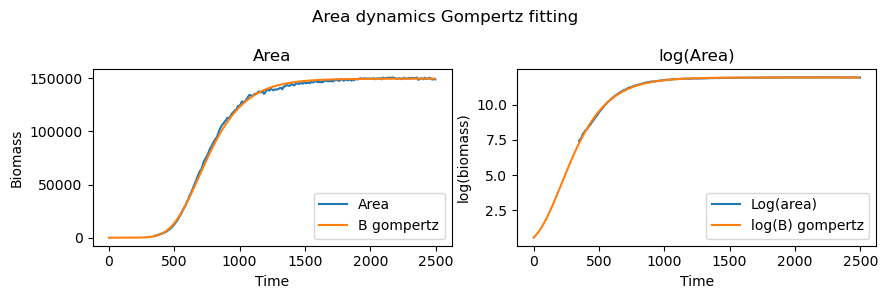

34 params: [13.457110537674671, 0.026774436724221272, 8.202262773258495]


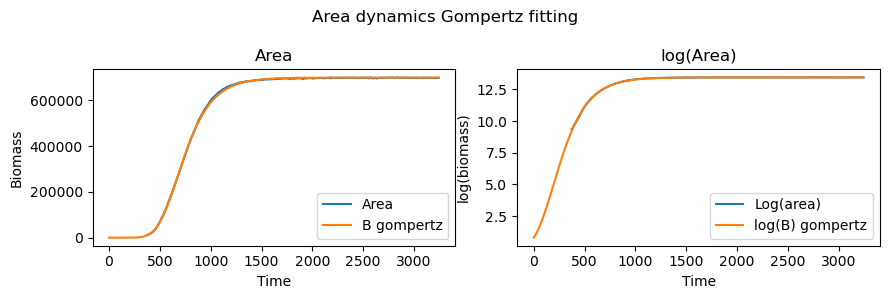

35 params: [13.1272554679921, 0.024257082127789403, -24.08327042540111]


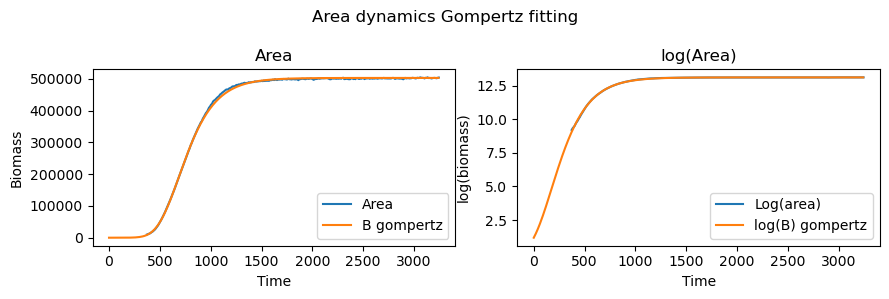

36 params: [13.259702243709217, 0.031608413104423756, 89.69224672380047]


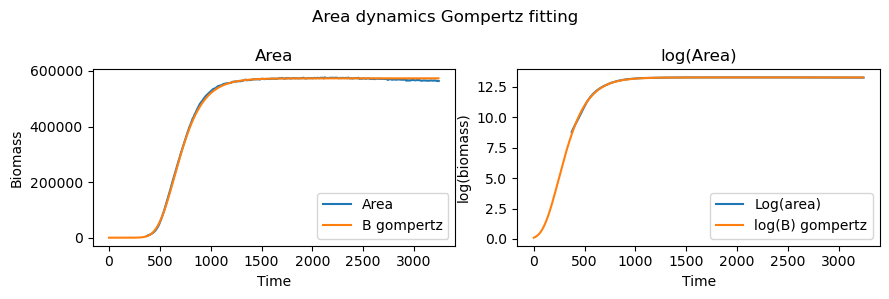

37 params: [13.256967665692725, 0.024233441572430337, -0.27177866034172365]


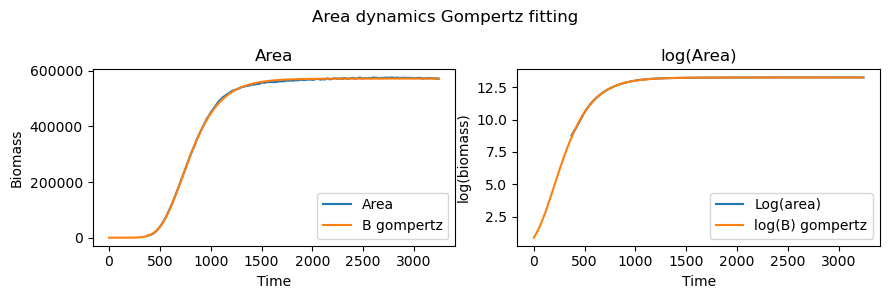

38 params: [12.69820662623833, 0.023995200993675997, -13.50832245581686]


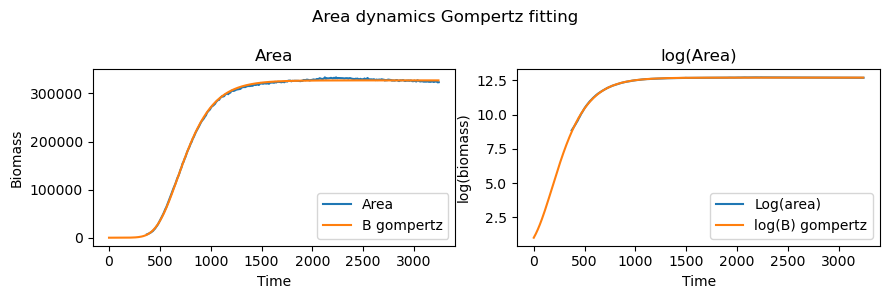

39 params: [13.111488371095218, 0.02664664602435152, 14.799868793389821]


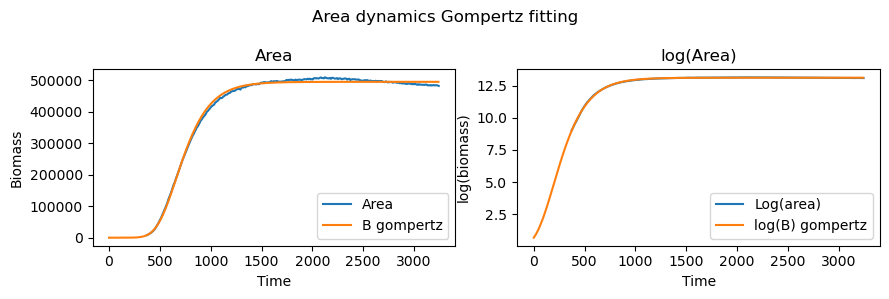

40 params: [13.412952192862344, 0.016680671031339758, 16.570747844555914]


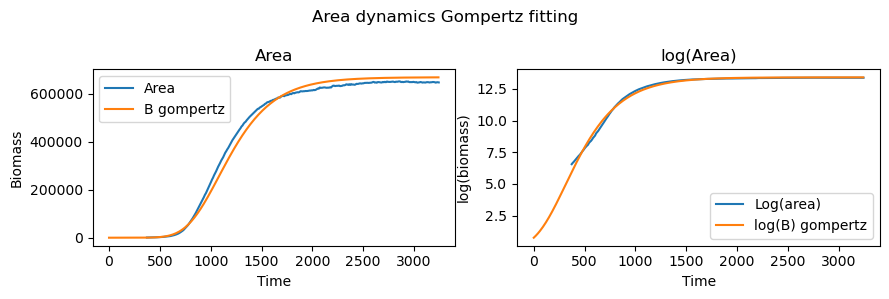

41 params: [11.236134872733215, 0.03536565600120006, 98.6763940744886]


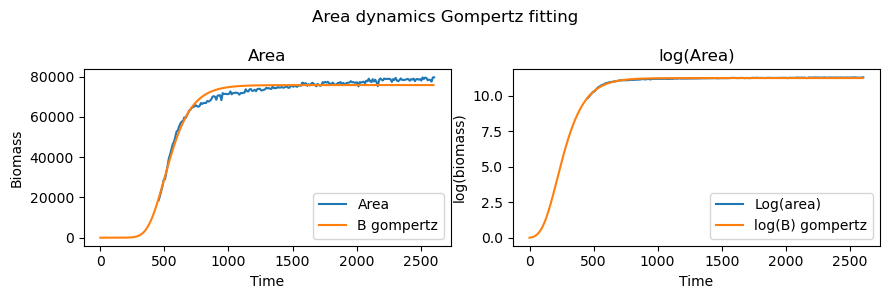

42 params: [11.365382348698173, 0.03670261541121345, 104.20902916183938]


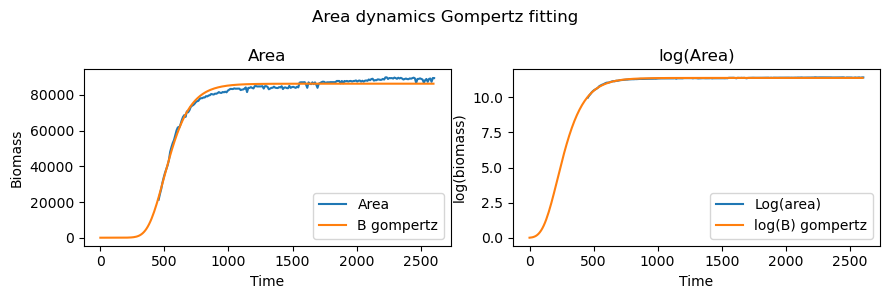

43 params: [10.897662805262609, 0.02950840583984139, 66.25230806680537]


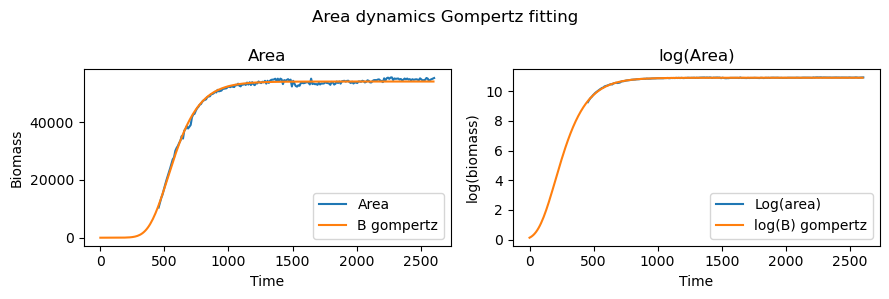

44 params: [10.80962236374317, 0.024554016225379574, -5.596729069366059]


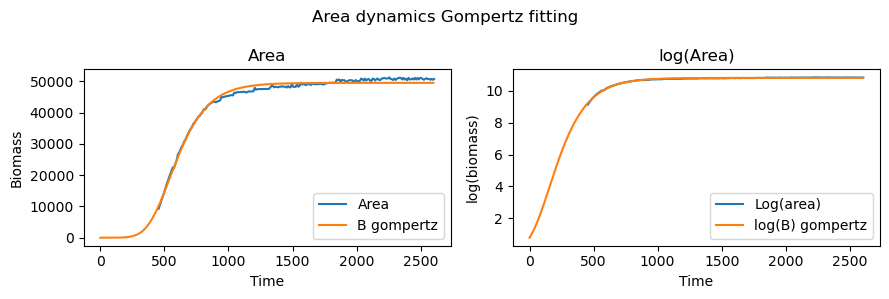

45 params: [10.72429476068697, 0.027499773043402304, 56.84150293087228]


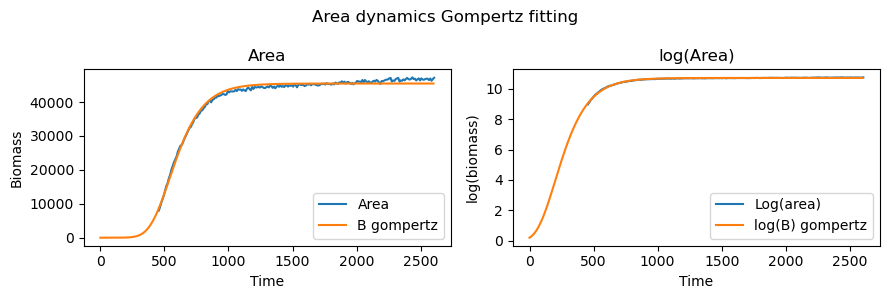

46 params: [10.762679475034794, 0.02893129902953986, 89.16273896222084]


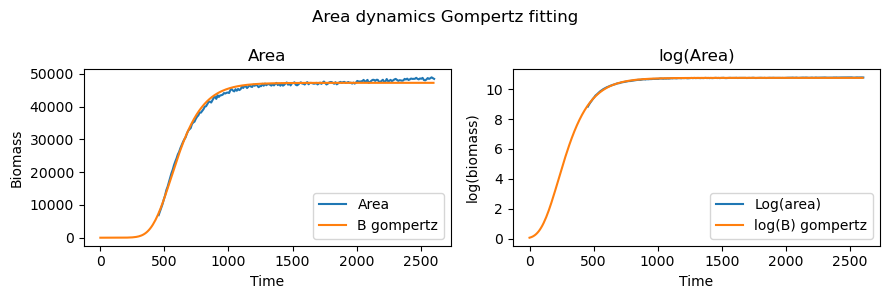

47 params: [10.8127041668161, 0.028501163522321574, 70.83517111965388]


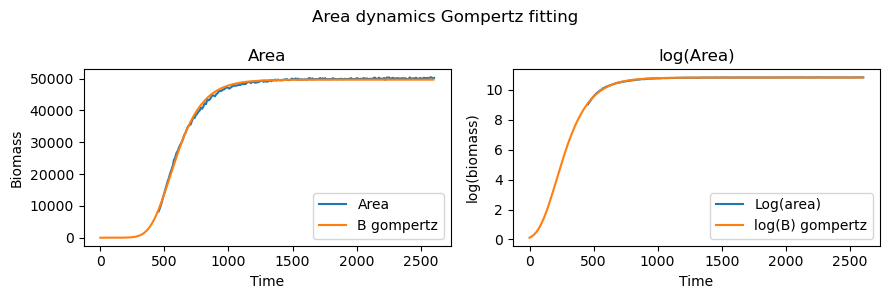

48 params: [10.973915997123616, 0.037223572572462955, 171.53273261017856]


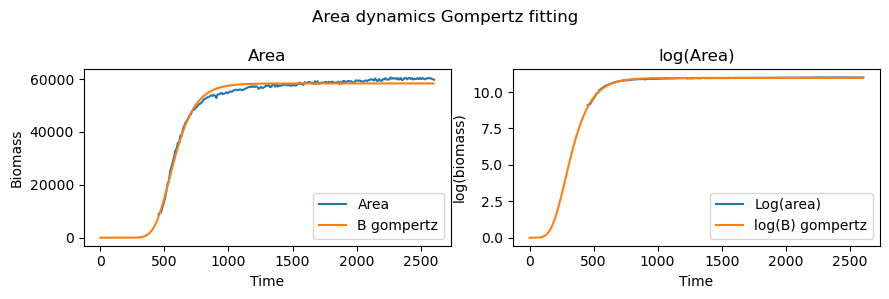

49 params: [11.224310414360763, 0.036039244274724457, 134.79670151263005]


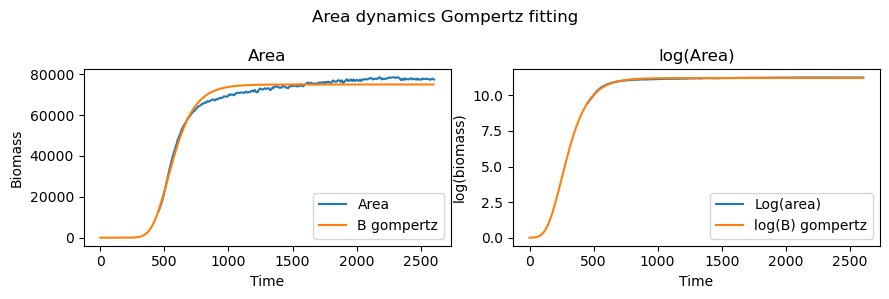

50 params: [11.241392099305006, 0.04068460158314661, 188.66972557375055]


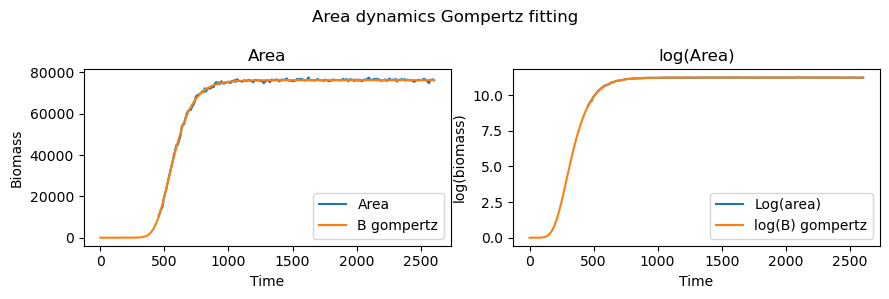

51 params: [11.369148505095614, 0.0362858434352504, 98.36029089484958]


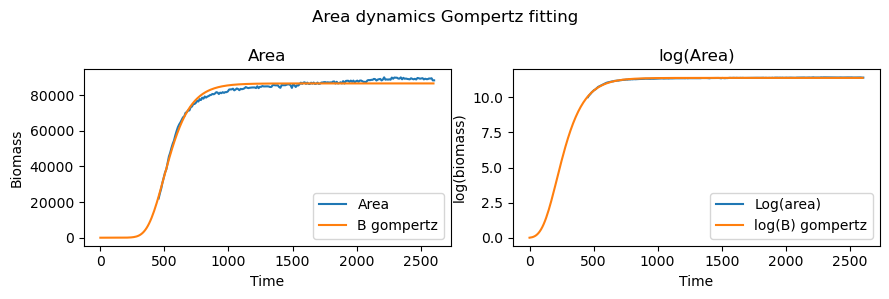

52 params: [10.135794829239451, 0.02925581553375047, 130.63024077096054]


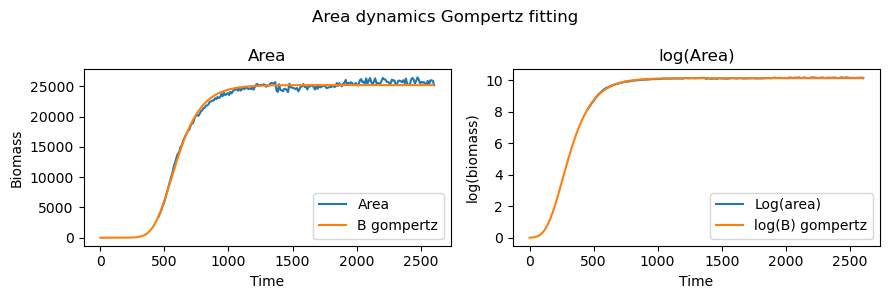

53 params: [10.936594508257604, 0.028005684462953526, 30.597418518819563]


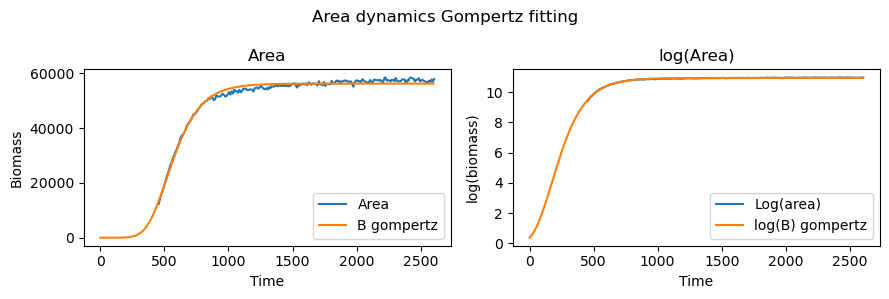

54 params: [10.810895314685856, 0.024690543431827396, -3.4855783082005063]


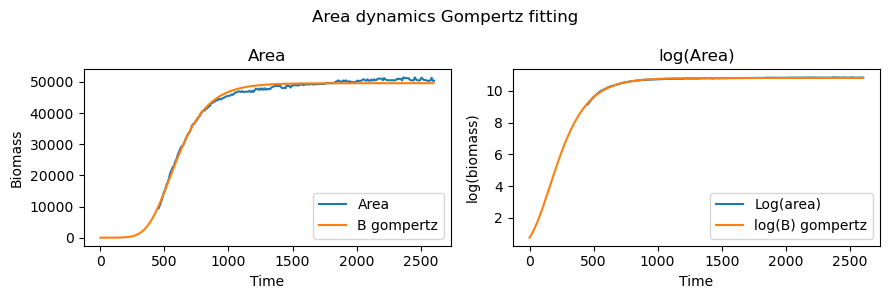

55 params: [10.31710202207436, 0.026929354505582998, 86.07273507212345]


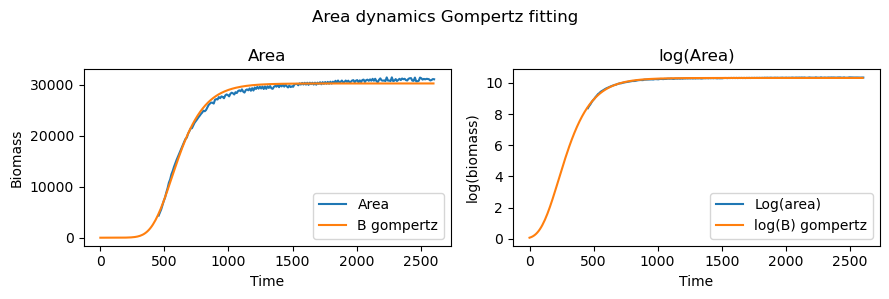

56 params: [12.425645063485224, 0.03189144295109654, 104.55137903295376]


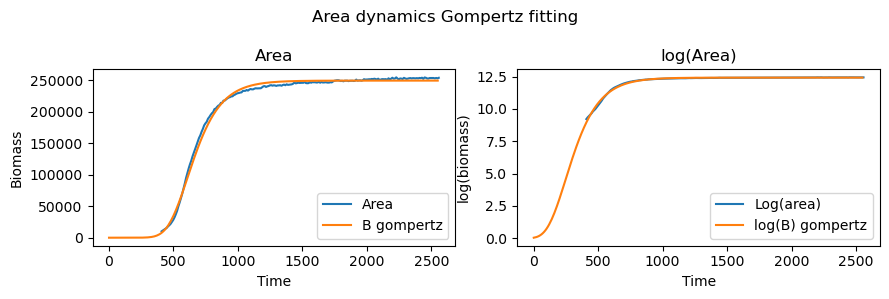

57 params: [12.636820783407806, 0.03192308026292765, 72.6956694629711]


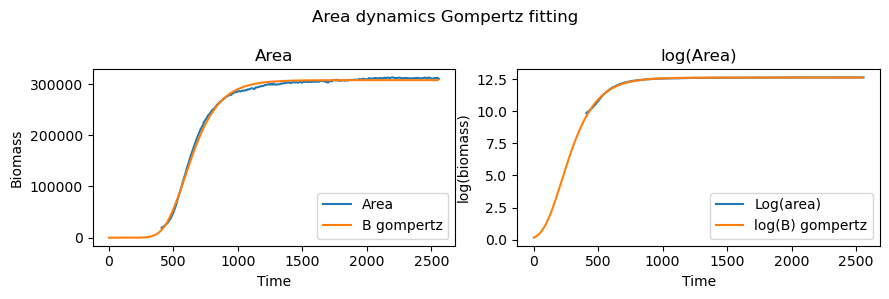

58 params: [12.156977727575963, 0.03158473302904196, 114.63297338021626]


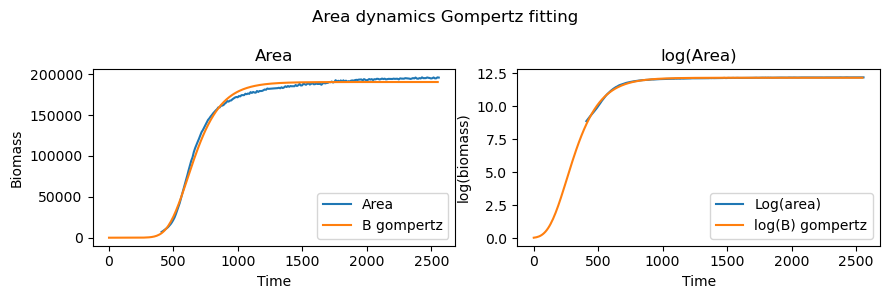

59 params: [12.859850785582912, 0.034602688053341824, 138.42223282044978]


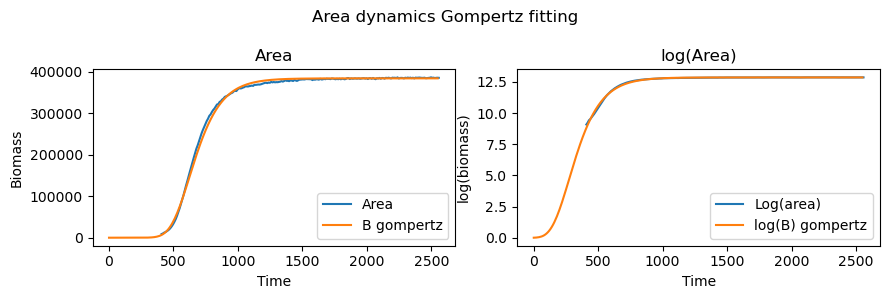

60 params: [12.513200404182783, 0.03160273417932951, 104.63620784103067]


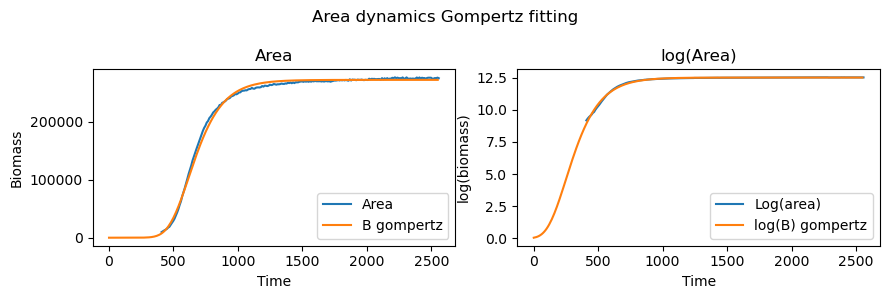

61 params: [12.321418188124778, 0.030561427613027443, 81.57662207066161]


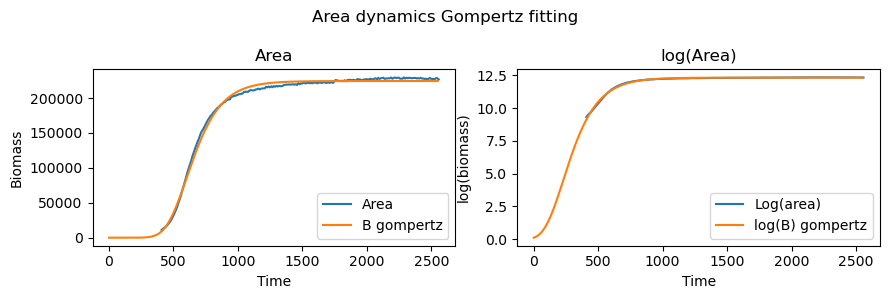

62 params: [12.378454765892169, 0.02859159703757948, 86.89443861257163]


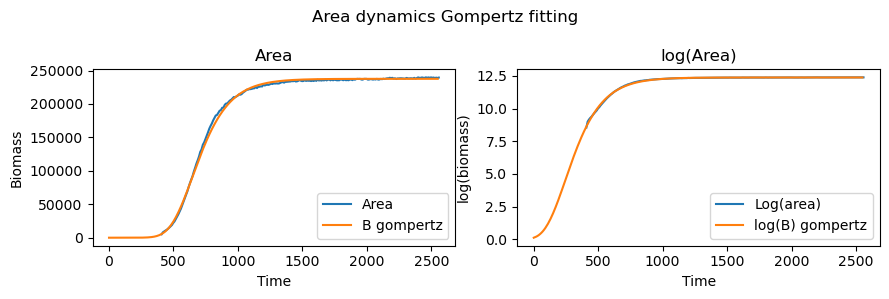

63 params: [12.18005163889536, 0.027376419251892714, 52.44887278593859]


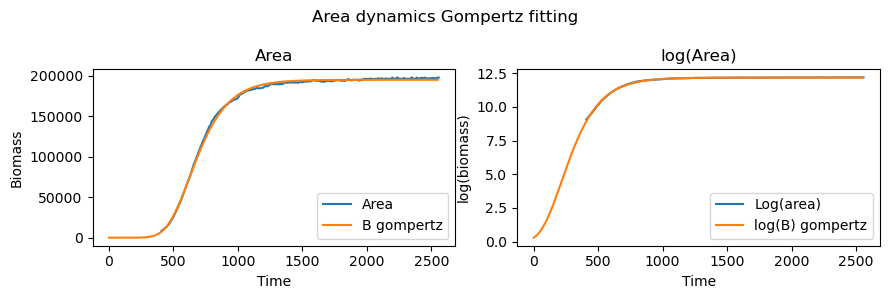

64 params: [12.355099616901999, 0.02673263907758055, 49.69375152400491]


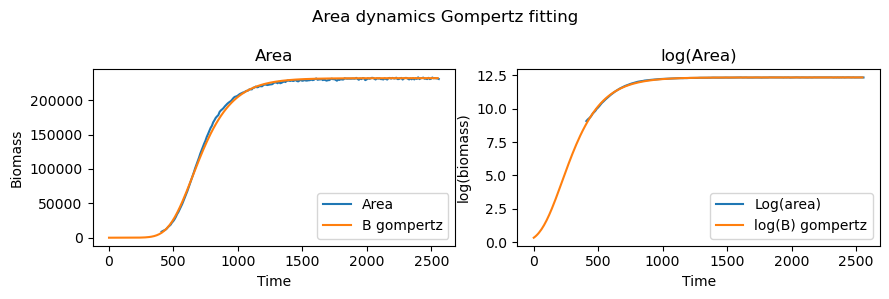

65 params: [12.523647708914012, 0.028868740017440192, 82.22415301212804]


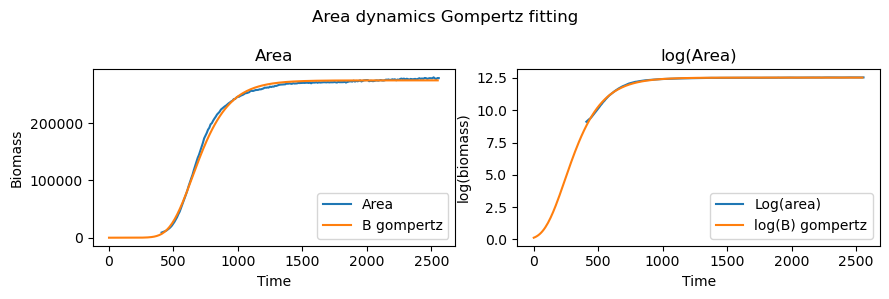

66 params: [12.374329833105772, 0.028164324422156408, 79.47597452739542]


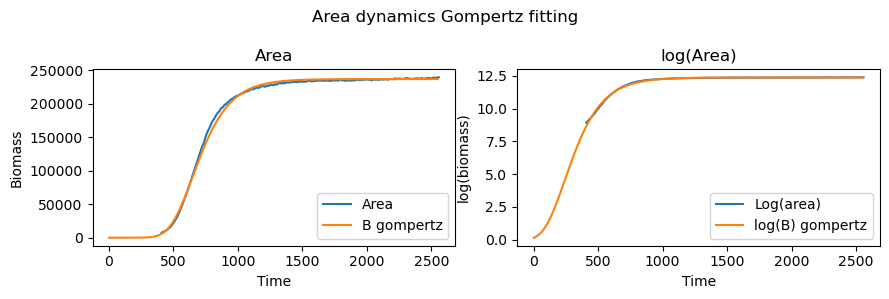

67 params: [12.738416463839519, 0.022349005205237474, 8.580637267874698]


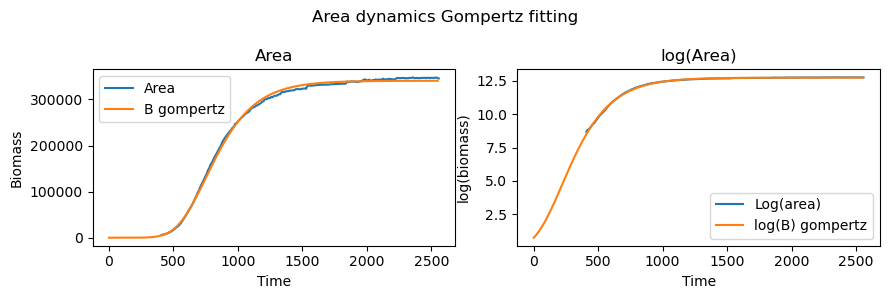

68 params: [12.416699325864695, 0.022347942310735548, -4.17179308162292]


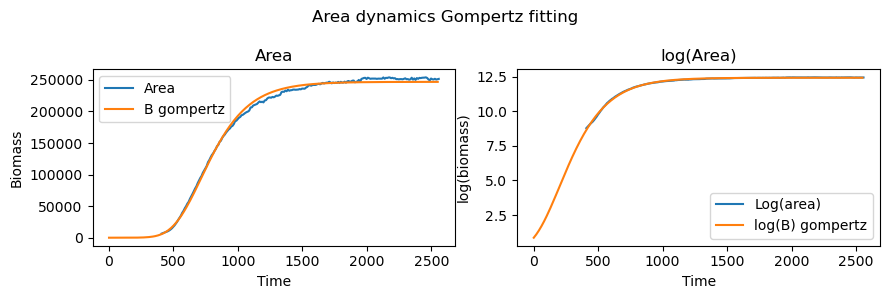

69 params: [12.569485689067069, 0.022794814415473076, 26.96244450371288]


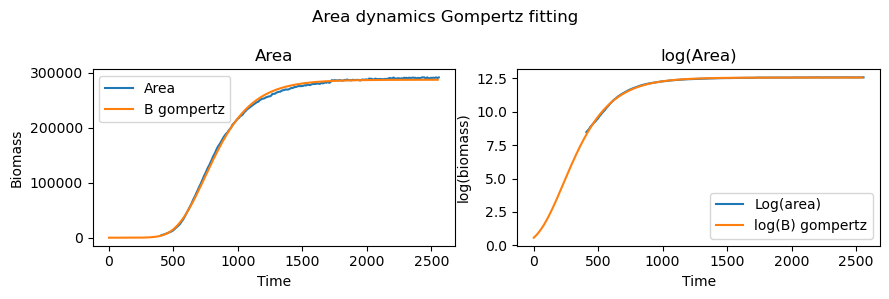

70 params: [12.602805507516168, 0.023085360355298495, 23.589185579864036]


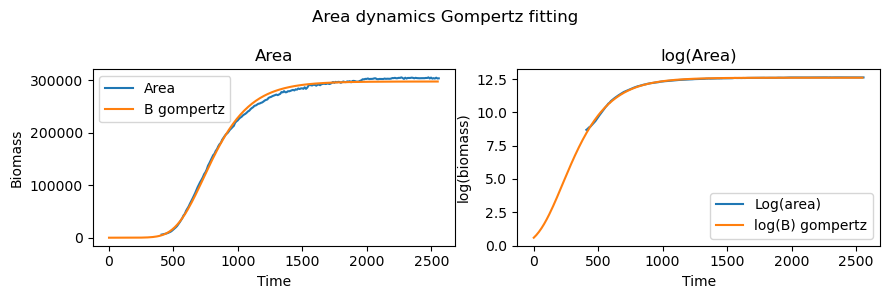

71 params: [11.66284125599434, 0.03251519156392241, 76.29175737145849]


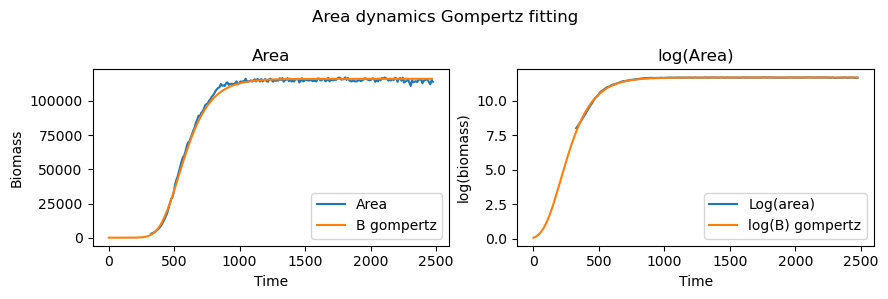

72 params: [11.647563043574483, 0.03145631520719152, 72.0555737752142]


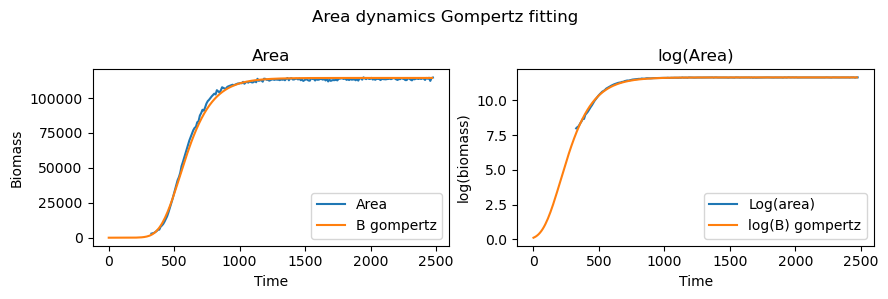

73 params: [11.907291788148791, 0.031801169334368336, 101.89160894788202]


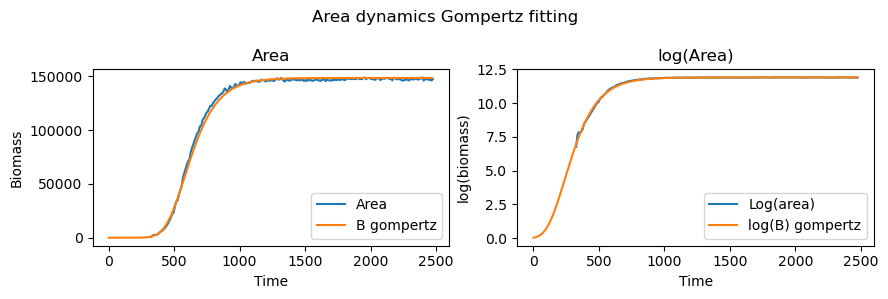

74 params: [11.856323898589203, 0.03164674332899001, 88.73124256296165]


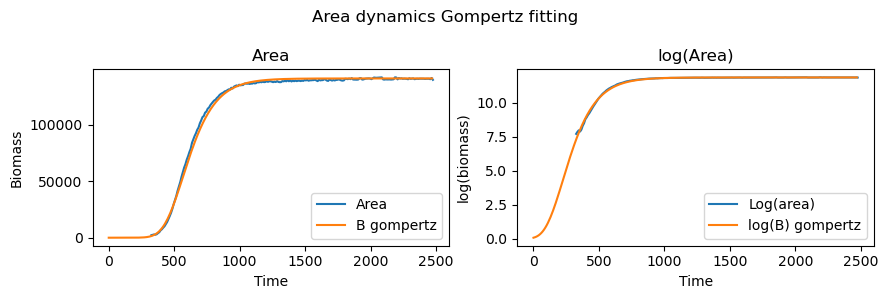

75 params: [12.116127113960612, 0.033175535335370036, 87.11807614624685]


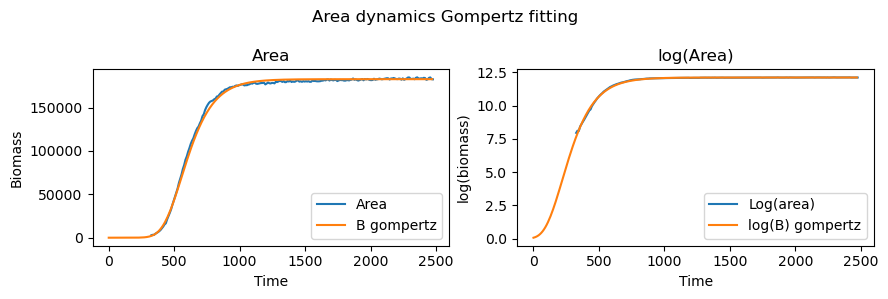

76 params: [12.228889350036308, 0.033347074133483603, 90.10750199339296]


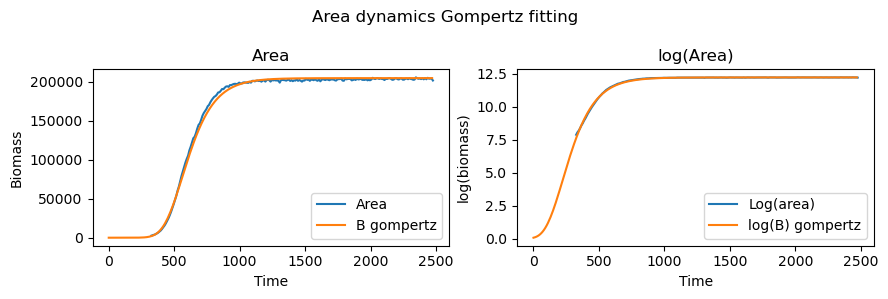

77 params: [11.520396534224217, 0.030293482371174952, 67.80280444921785]


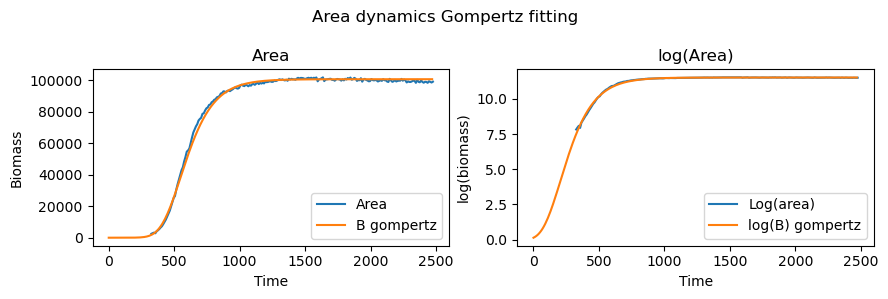

78 params: [11.367532858278931, 0.030133843617110977, 55.41413992597612]


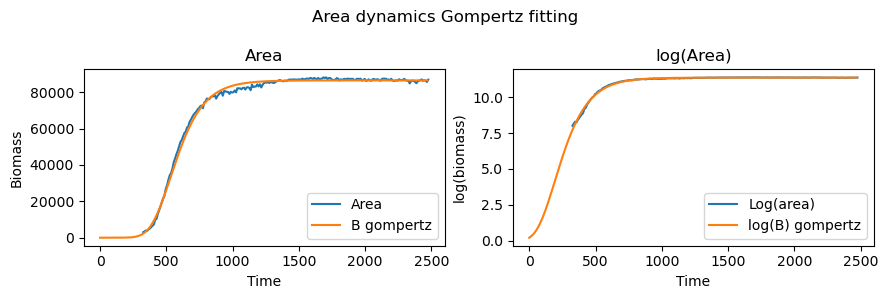

79 params: [11.406218361394215, 0.030008324545848817, 56.91011196433864]


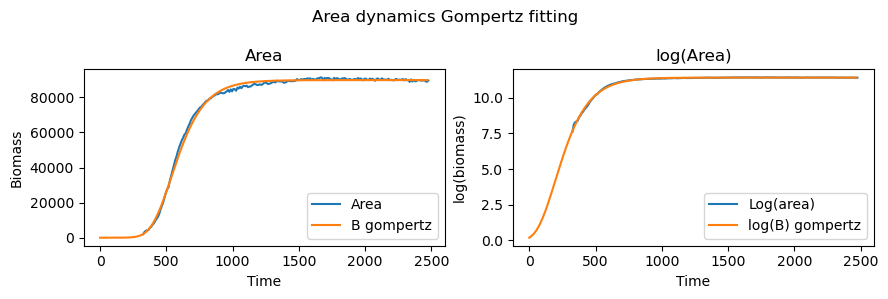

80 params: [11.591412164218276, 0.03116705956187873, 69.28132534978265]


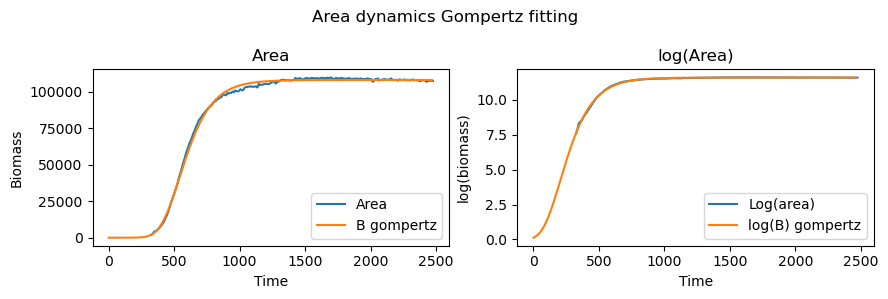

81 params: [11.596871661933363, 0.027266443913631, 64.04305458175462]


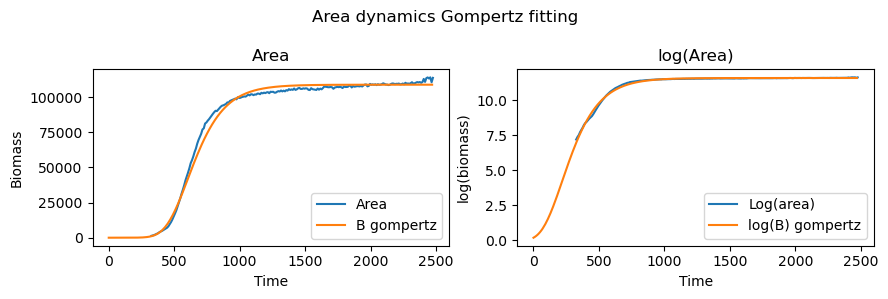

82 params: [11.450052032103542, 0.027686761755705128, 75.36204741053031]


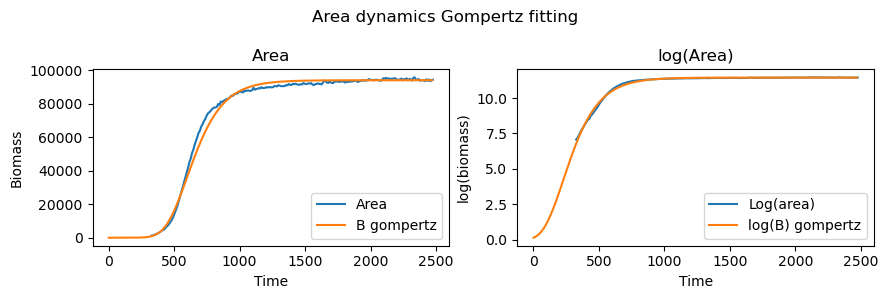

83 params: [11.571408322794538, 0.029822945858487573, 96.91563741148416]


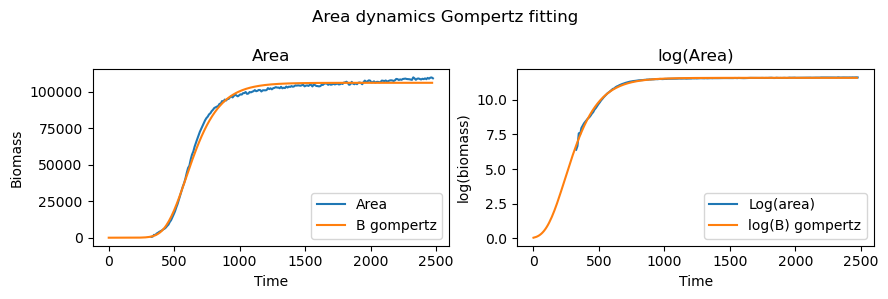

84 params: [11.747000610726129, 0.028716921283798148, 90.73609996161733]


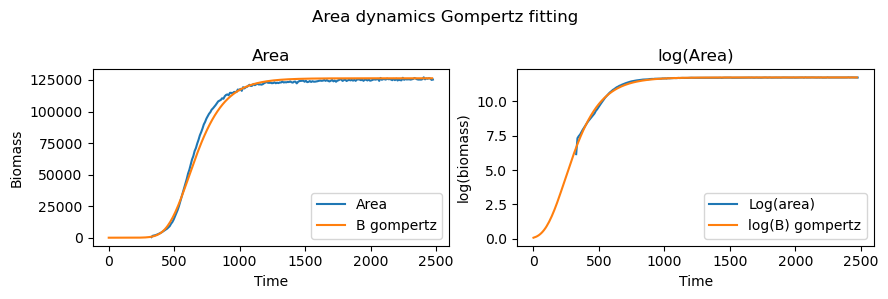

85 params: [11.913577209760614, 0.027525800110246273, 79.15216369553526]


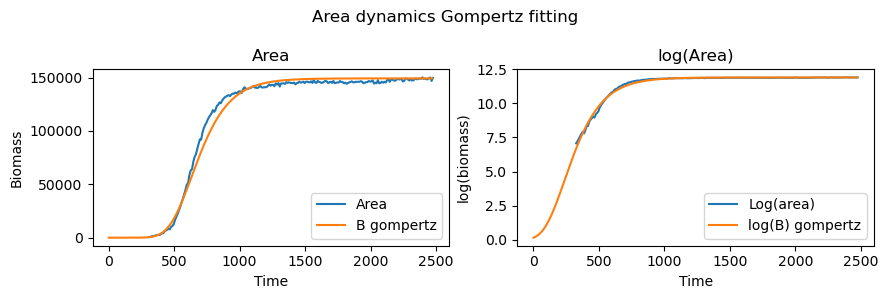

86 params: [12.076115084291358, 0.030854123890228916, 106.977599749127]


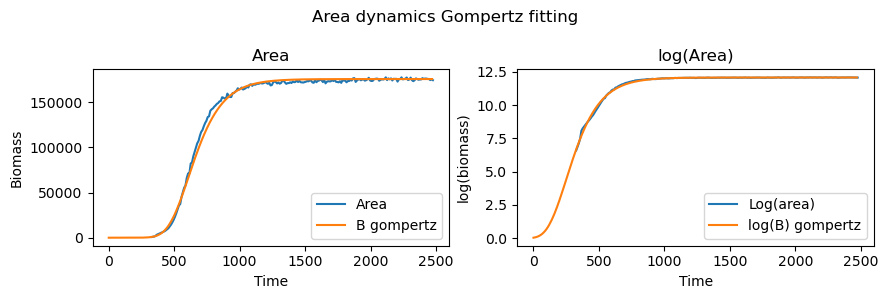

87 params: [11.82575136757774, 0.027463669885002425, 78.37455654982894]


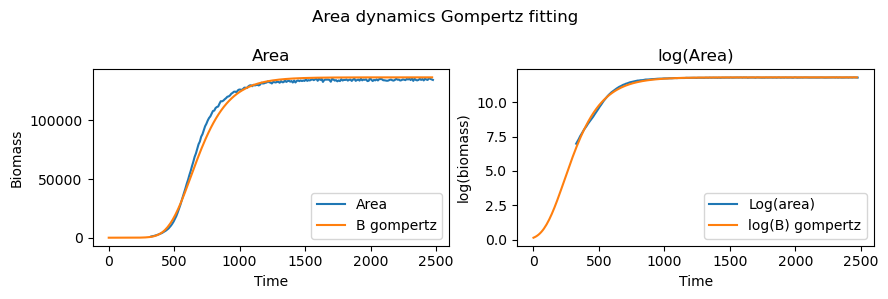

88 params: [11.804562228819963, 0.02828467739730937, 69.43427224379342]


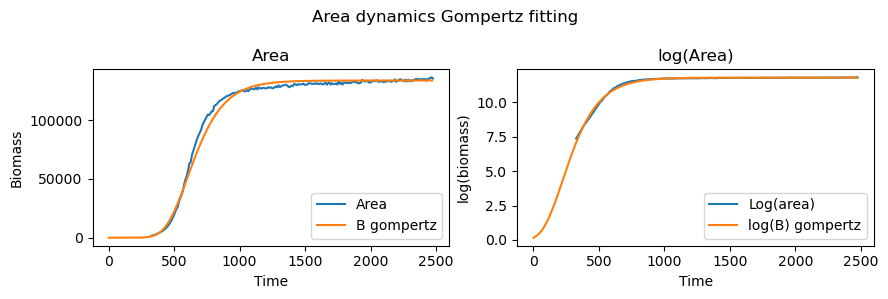

89 params: [11.78251794554919, 0.03171959418352401, 116.53636483410573]


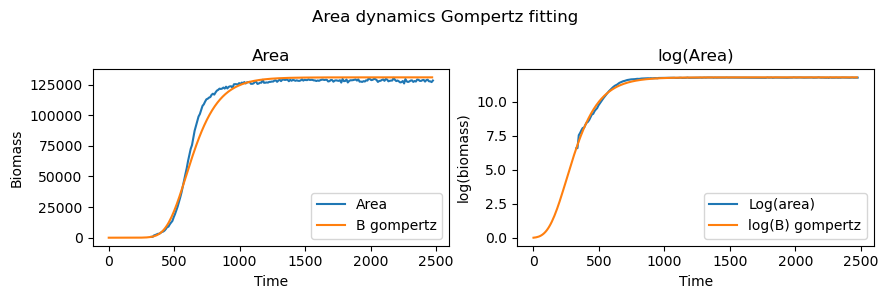

90 params: [11.476667182102496, 0.03173419881754228, 122.78843239730658]


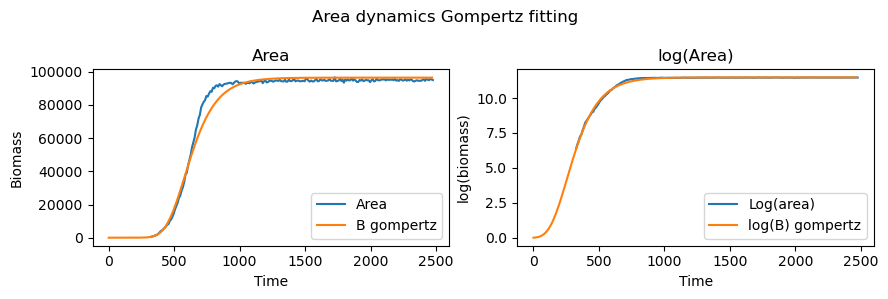

91 params: [11.63211625189279, 0.029023453249500984, 96.90117549291263]


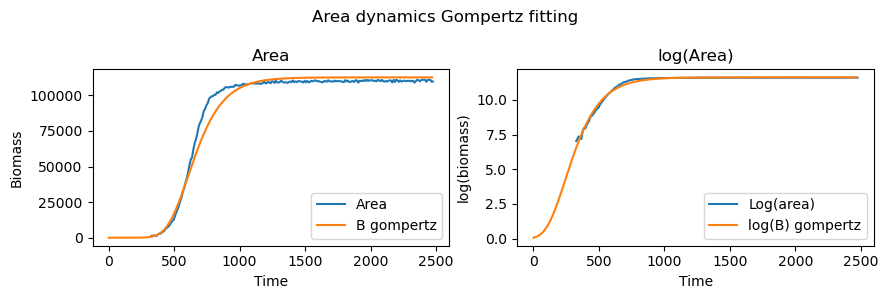

92 params: [11.105070750020145, 0.02637369880856147, -2.2565428378464376]


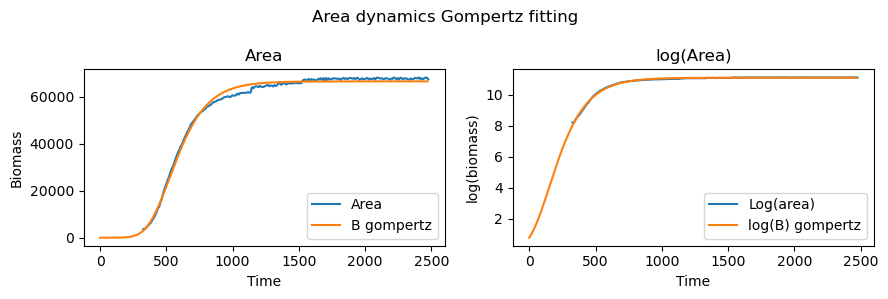

93 params: [11.436514625327375, 0.027915978242774777, 78.50163638830443]


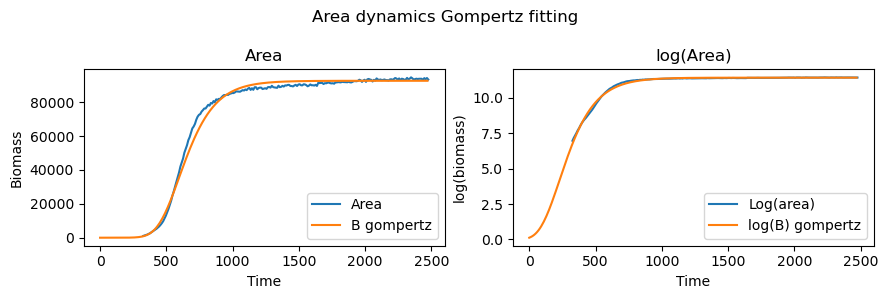

94 params: [11.361636953736737, 0.027445011899481665, 75.76223682162689]


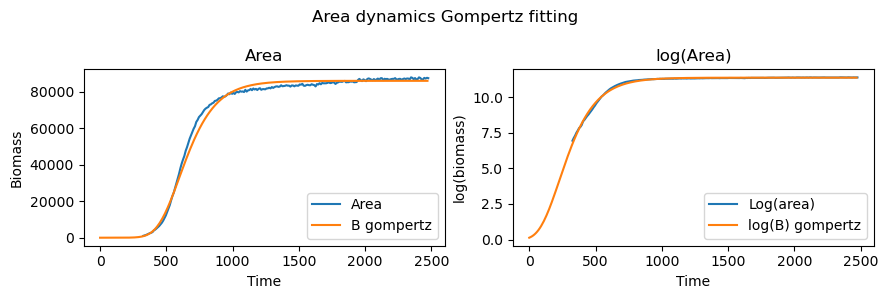

95 params: [11.583213975929771, 0.028301032406349454, 83.57330446239436]


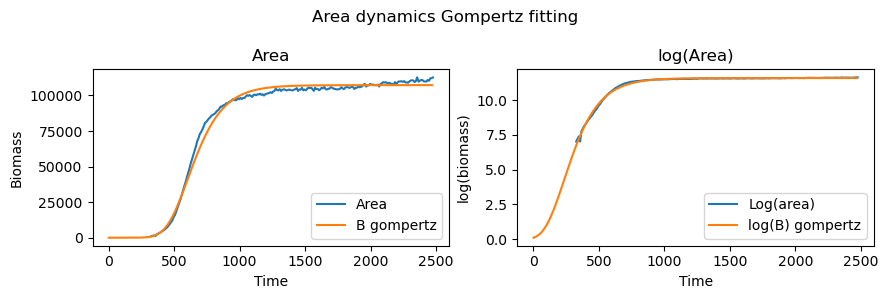

96 params: [12.636535091129529, 0.027464633379299972, 22.780458459315195]


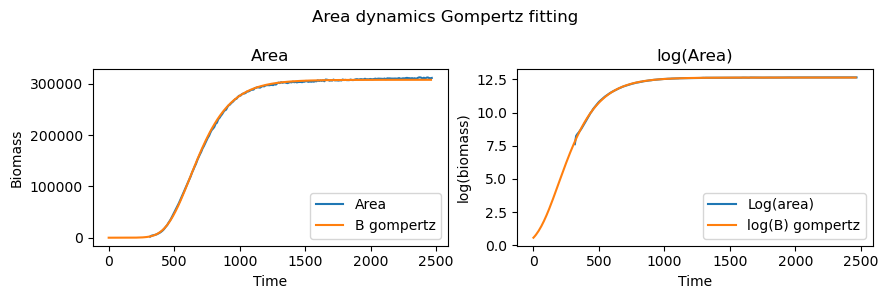

97 params: [12.425468577127504, 0.026218889168481824, 7.235483002487678]


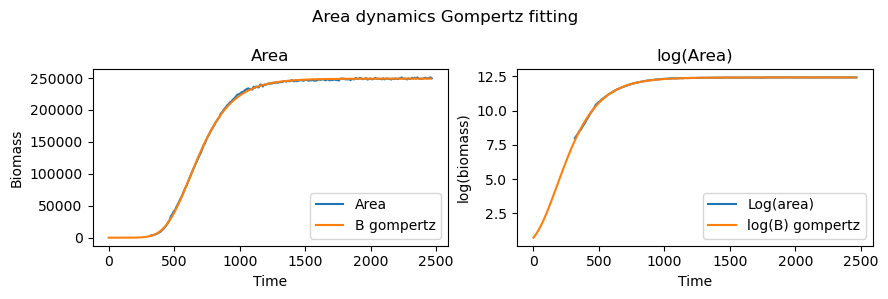

98 params: [12.12480878104506, 0.02483997982827098, -3.862458066160605]


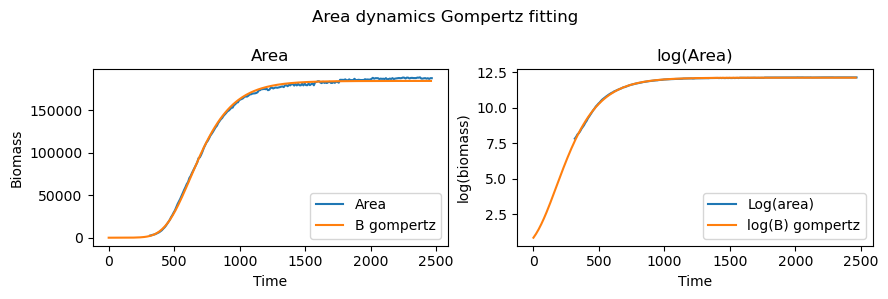

99 params: [12.319357899338831, 0.02549625070035083, 1.0931007516120224]


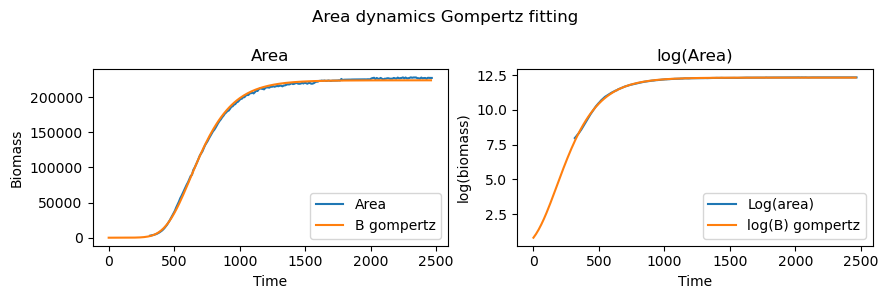

100 params: [12.118976272300126, 0.023244273232356998, -20.629225093684678]


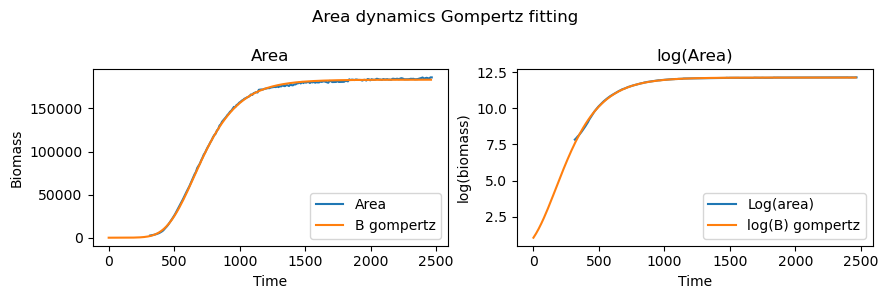

101 params: [12.16027984154024, 0.03251875458449747, 94.57089844197608]


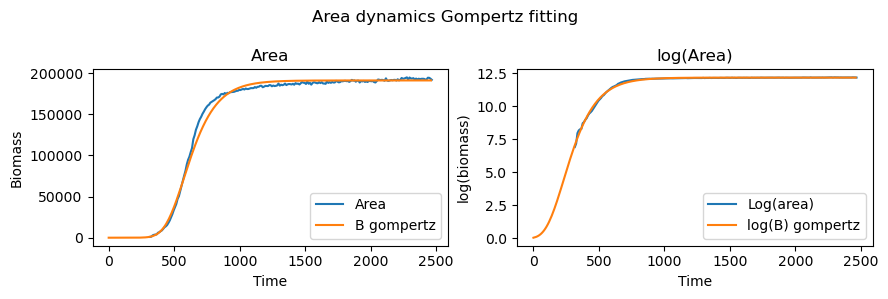

102 params: [11.822814289656135, 0.02609520624988674, 3.345558847902333]


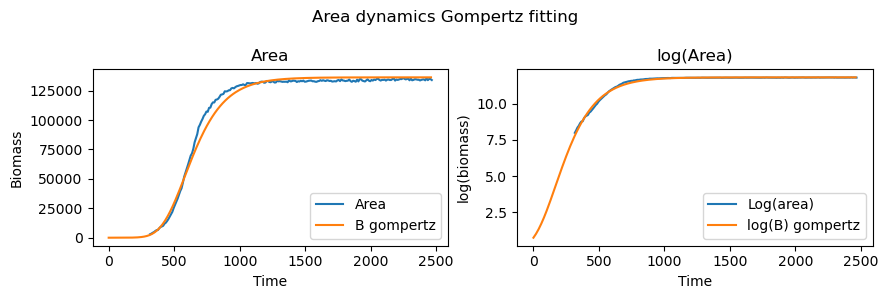

103 params: [11.820995590567158, 0.027847345955423475, 43.69801174680542]


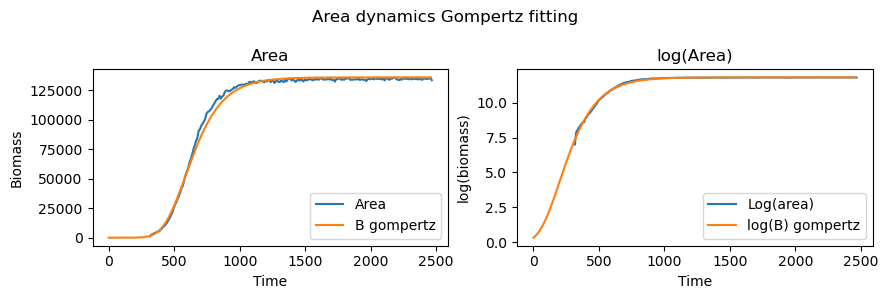

104 params: [11.818446190732434, 0.026799242055303294, 18.398403915266016]


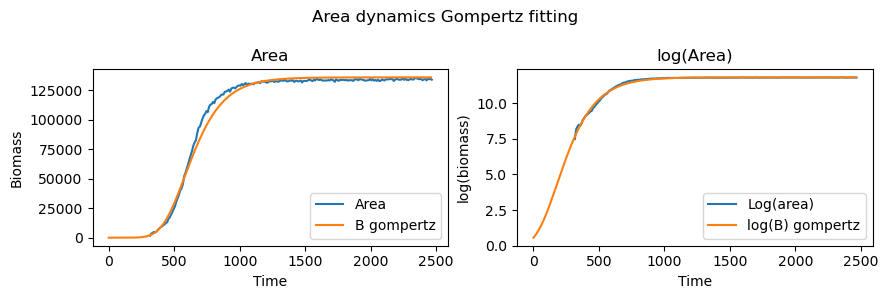

105 params: [11.573707052092322, 0.026120198911895876, 17.927989985033037]


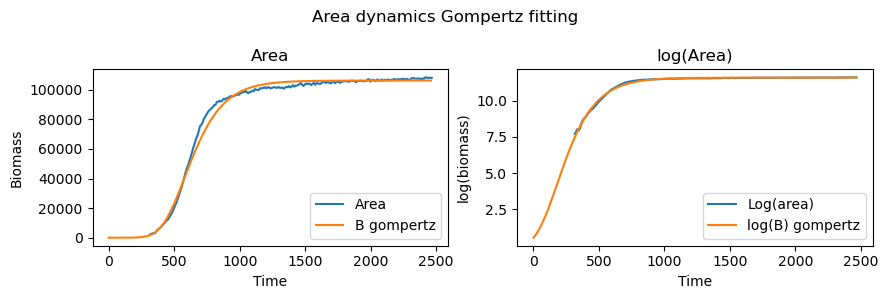

106 params: [11.364057119017543, 0.02867419361623029, 58.594805245024695]


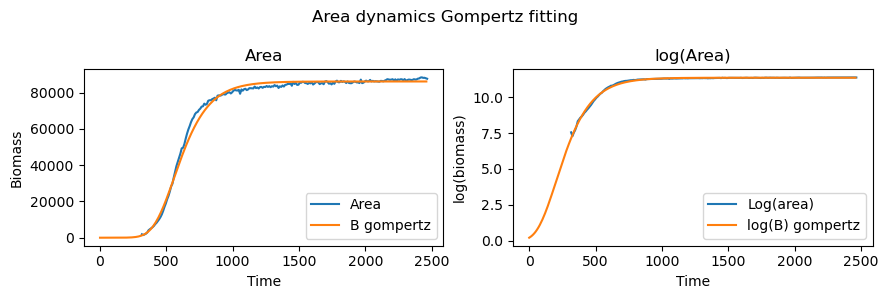

107 params: [11.451624128130675, 0.028416688072369287, 50.77936987648409]


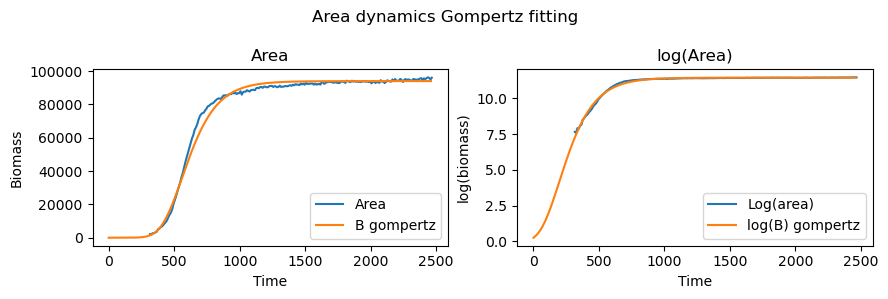

108 params: [12.211827929689788, 0.039628277815289464, 137.3494222161226]


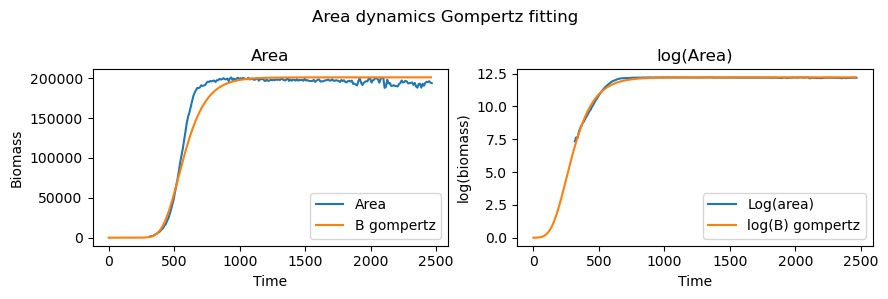

109 params: [11.476497143819804, 0.0349095413958397, 94.10269797872384]


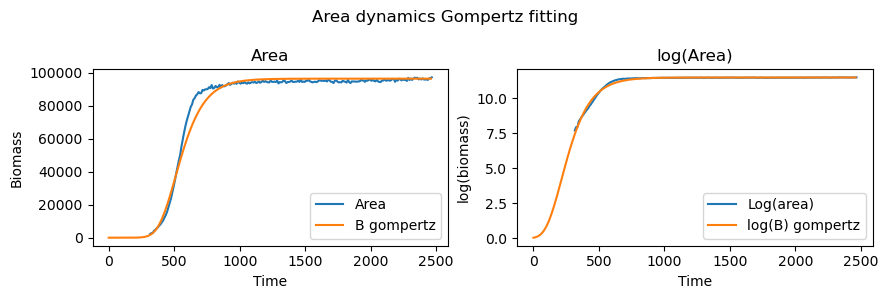

110 params: [11.496682426673168, 0.03636309972846109, 113.54297534711459]


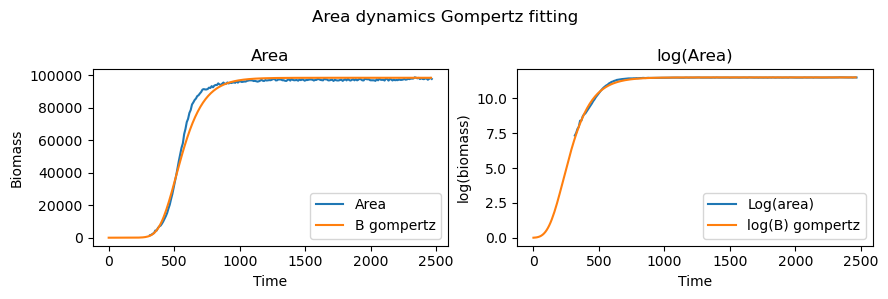

111 params: [11.596234511982386, 0.029549129261304753, 8.395431977001506]


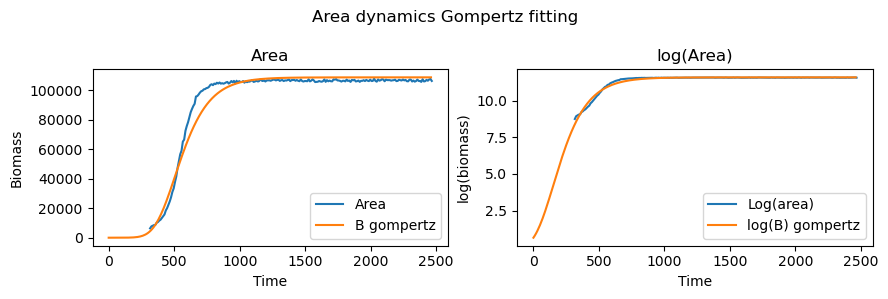

112 params: [12.090321489374137, 0.03813707271002638, 109.01137723142331]


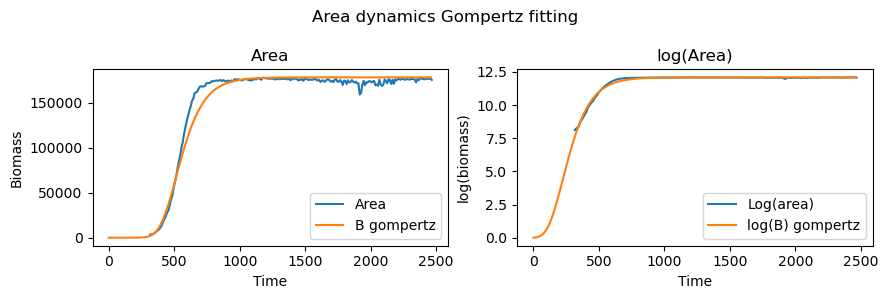

113 params: [11.774549670056258, 0.037939201752461744, 114.01531649199532]


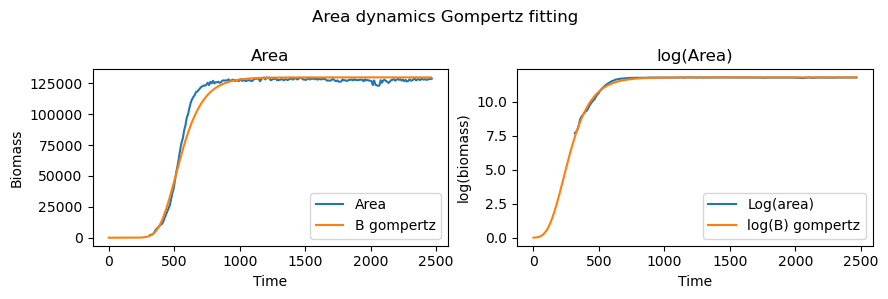

114 params: [11.819821565784752, 0.028497796481453685, 53.72975238944917]


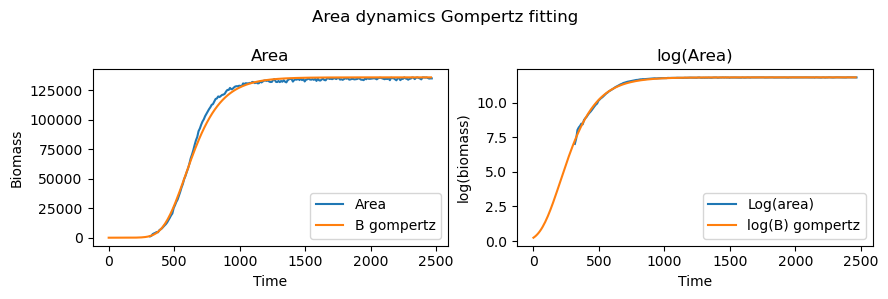

115 params: [11.199888857559081, 0.026018441061354612, 28.99703794209208]


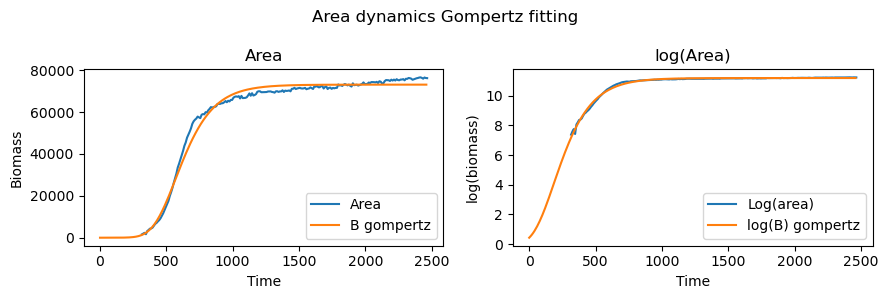

116 params: [12.039649018324774, 0.0320848700270027, 89.80802777778003]


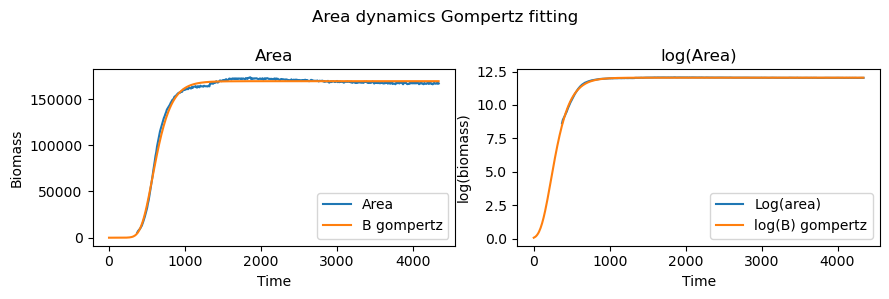

117 params: [12.106104336315065, 0.03423483525116059, 109.64194047866145]


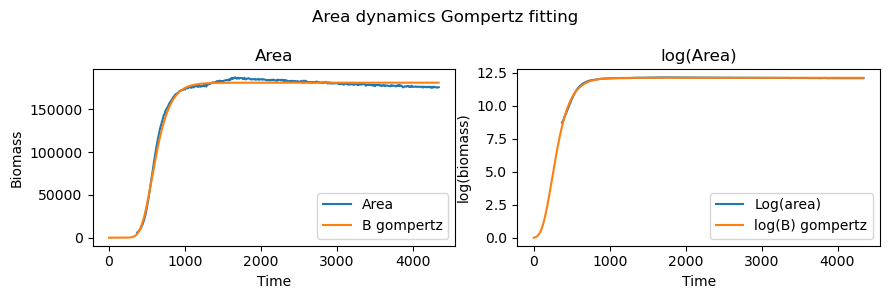

118 params: [12.1994328106851, 0.03302921656104902, 115.87417210718532]


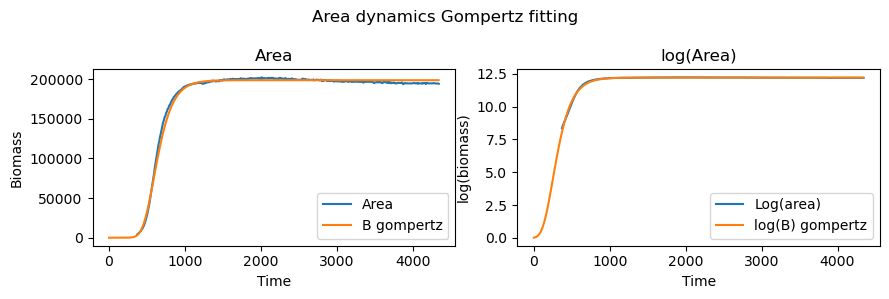

119 params: [11.969847311426154, 0.034089730839461714, 127.44403363884368]


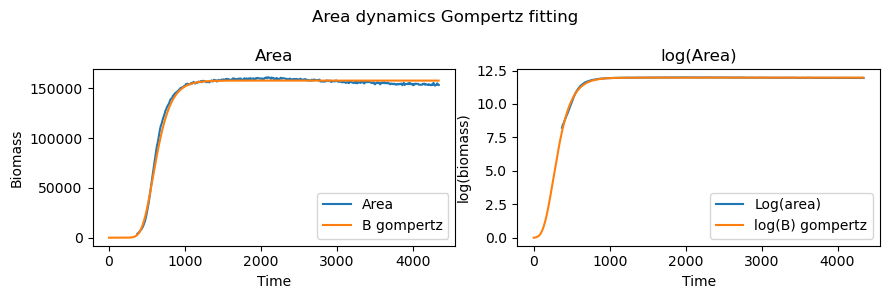

120 params: [11.773458134947832, 0.030346507434323038, 138.4066558931593]


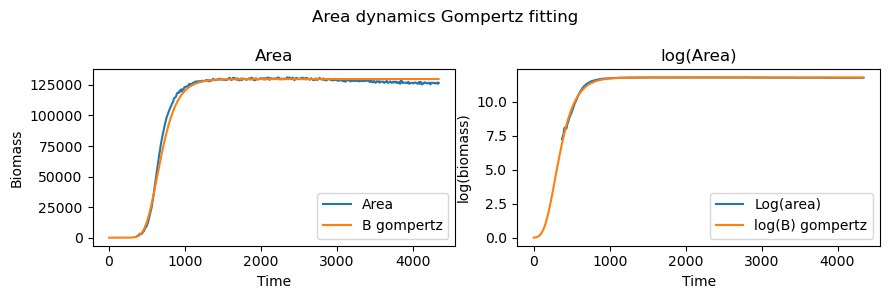

121 params: [12.213664611022688, 0.02678120799465841, 82.05999764576174]


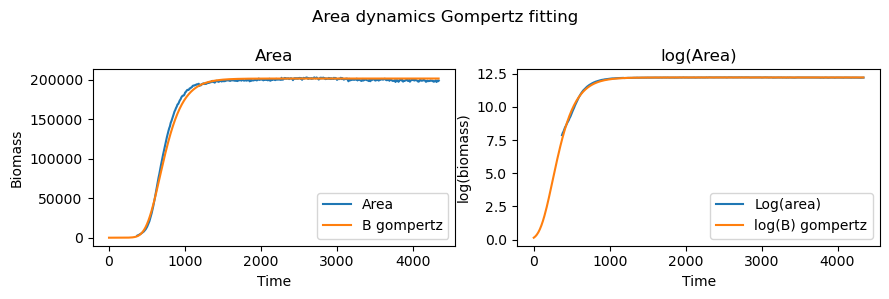

122 params: [12.413675149394994, 0.030025124088749244, 84.02660823821871]


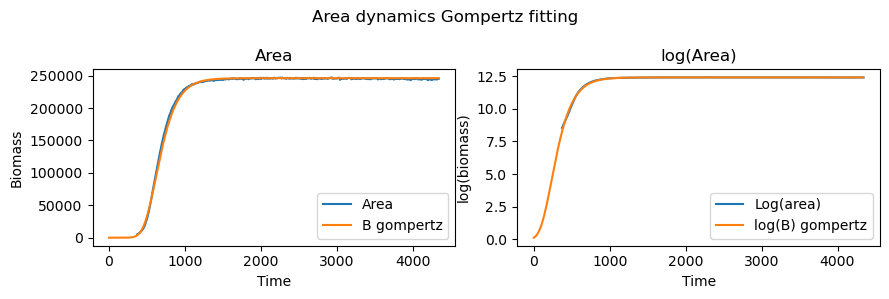

123 params: [12.545654603584333, 0.03140581600308772, 109.68143798732326]


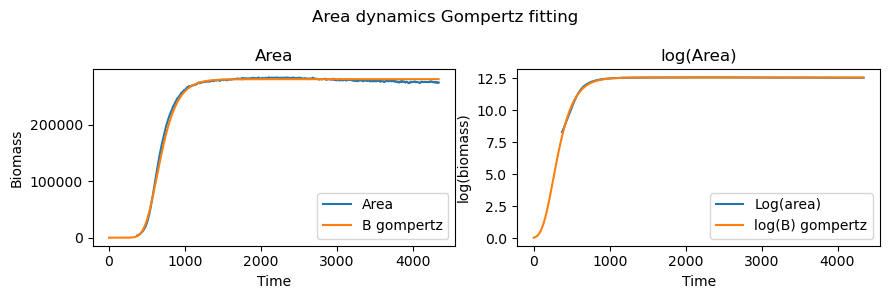

124 params: [12.49135306763936, 0.03188020268313091, 98.04280712021966]


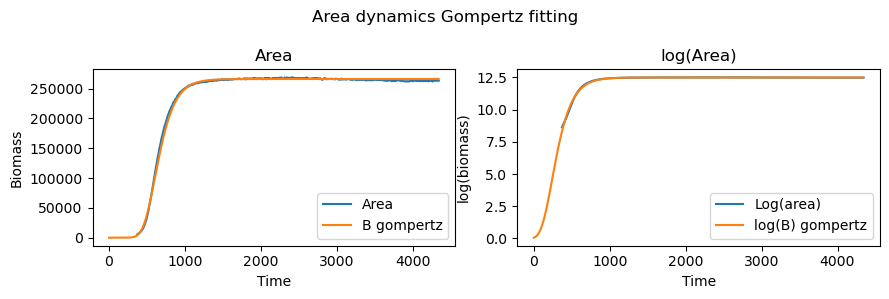

125 params: [11.396980394635138, 0.015469178014513928, 43.83020589022762]


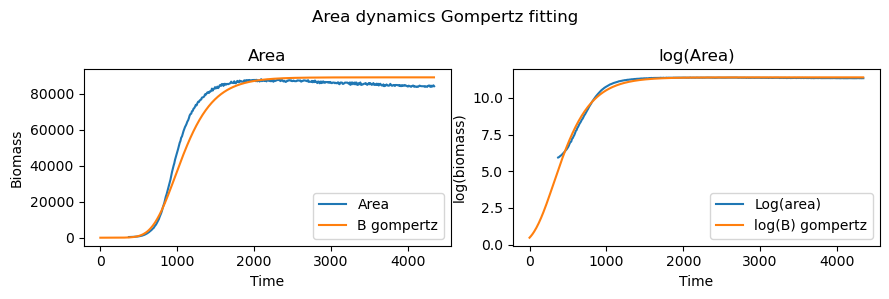

126 params: [11.80091118632363, 0.01773371863471868, 5.248481652626617]


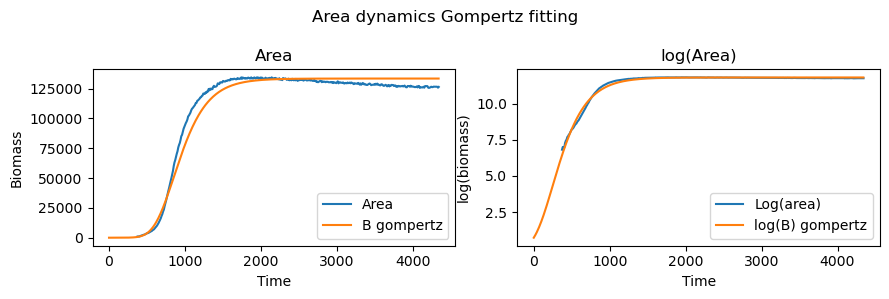

127 params: [11.97179754801391, 0.019009518455540473, 21.73482208038625]


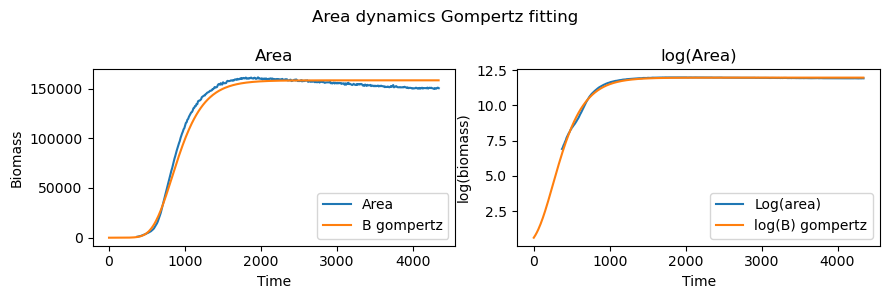

128 params: [12.005432953552079, 0.02001803161844604, 47.71787055357805]


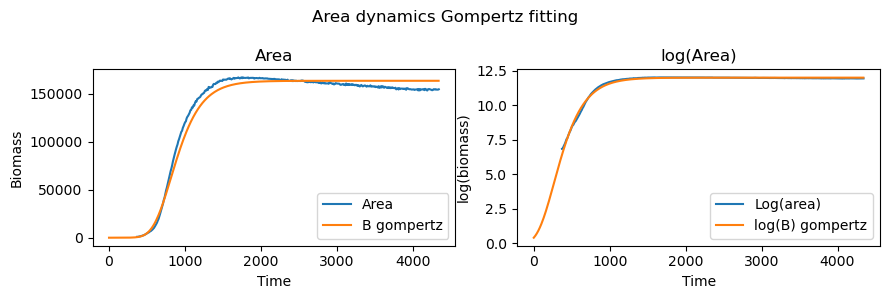

129 params: [12.77228340307289, 0.015624615940282218, -40.72567975360307]


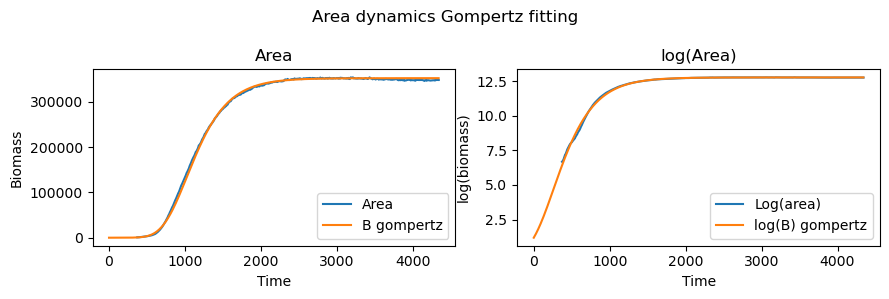

130 params: [12.453946611802959, 0.016398504572146665, 7.587607509115141]


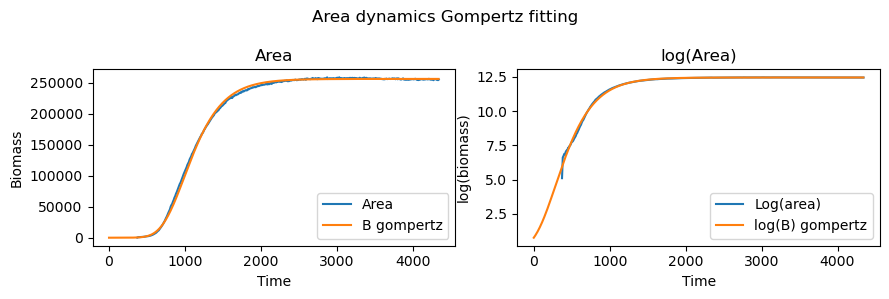

131 params: [12.448436520888125, 0.01663107004948136, 12.6220079809278]


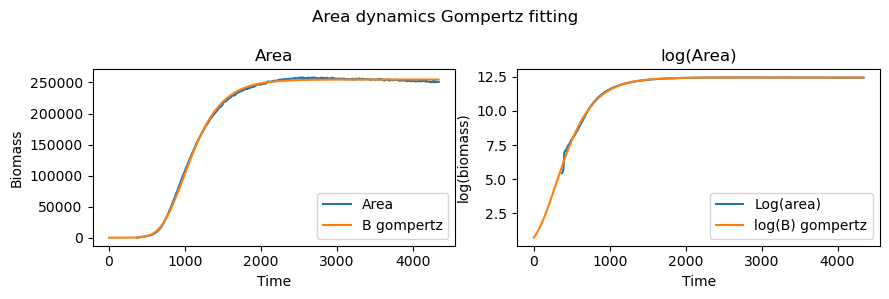

132 params: [12.609298393802952, 0.017177309807512847, 25.352390371871557]


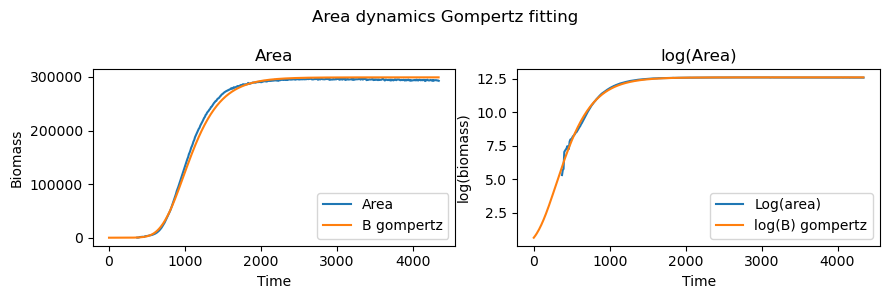

133 params: [12.968277652502303, 0.016774043857890227, -21.752186356461245]


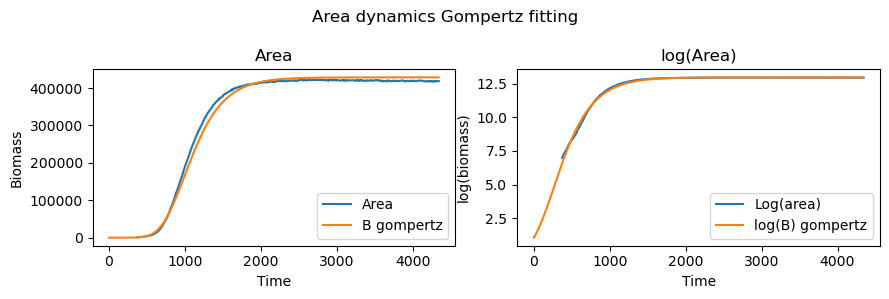

134 params: [12.975944574451436, 0.01750909143626283, -4.906108028034968]


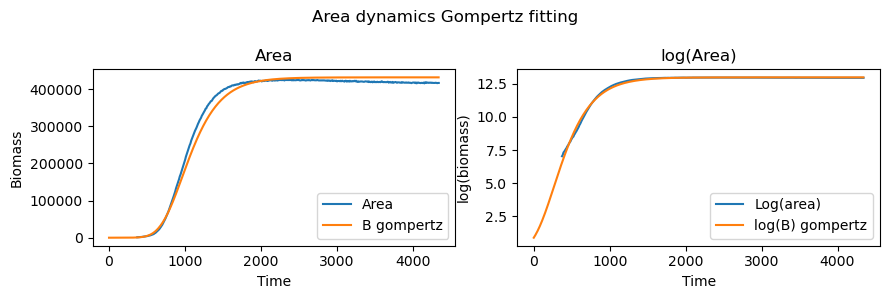

135 params: [12.132224609569088, 0.033877015669065924, 136.66208535403948]


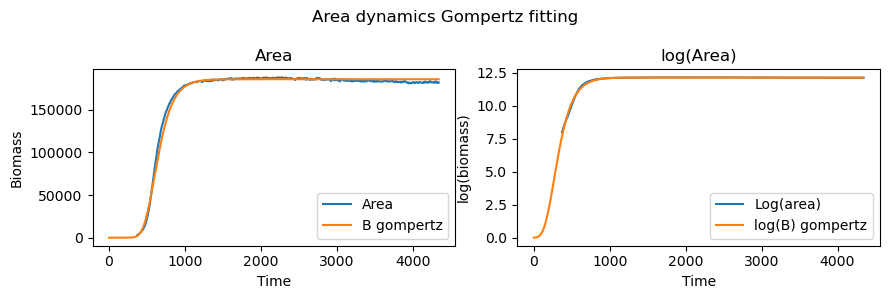

136 params: [11.616117579202873, 0.034531966679619816, 58.80502870023866]


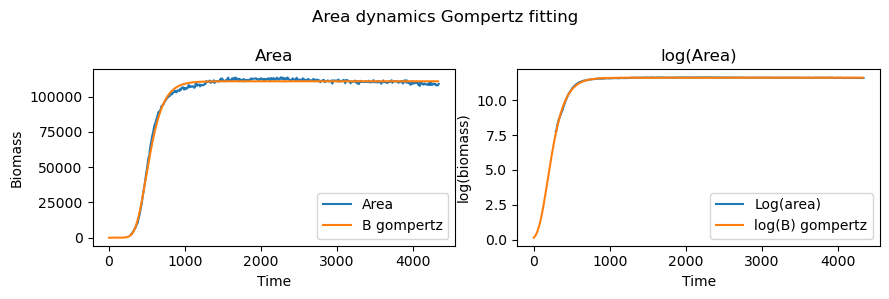

137 params: [11.521945669044106, 0.030738889892072137, 8.181007125750503]


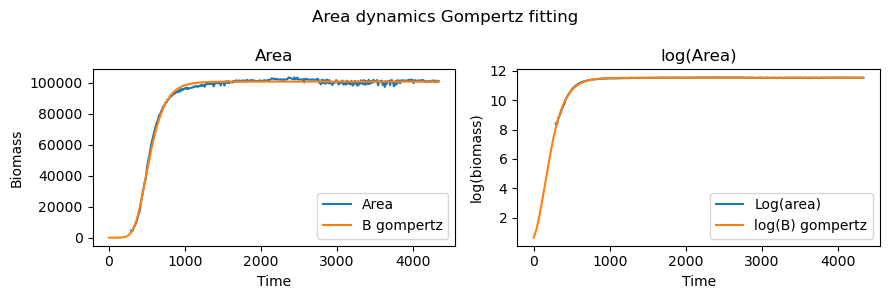

138 params: [11.687747010569144, 0.03424479094898435, 51.4391964149791]


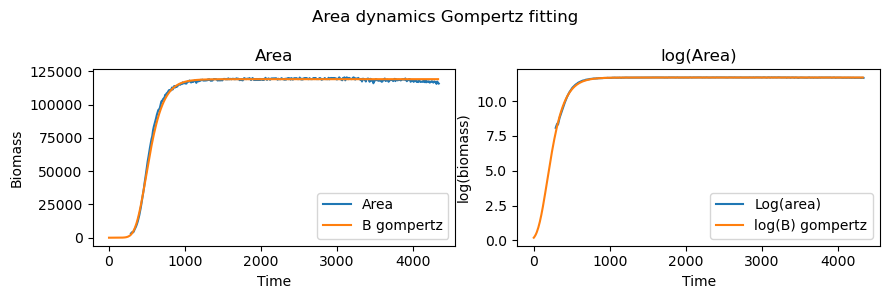

139 params: [11.784822478531227, 0.03219940761397415, 25.618970700988715]


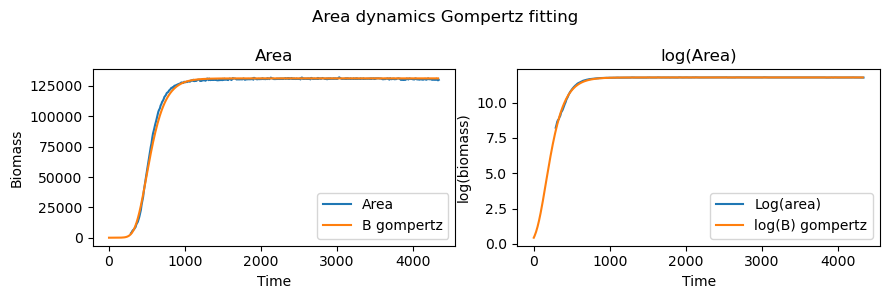

140 params: [11.566366935069514, 0.03185592390992961, 59.98679425173914]


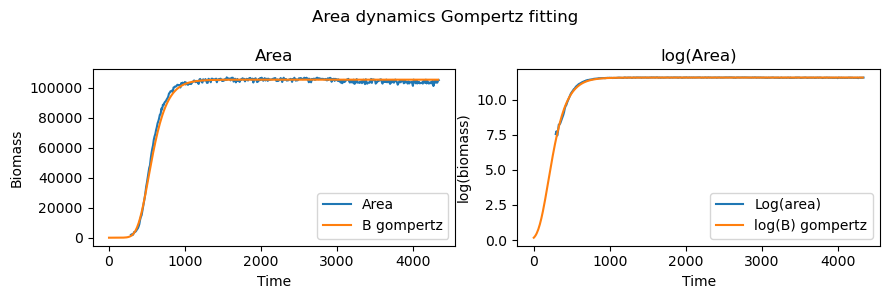

141 params: [11.57566117680854, 0.03151417563297042, 50.262536778182096]


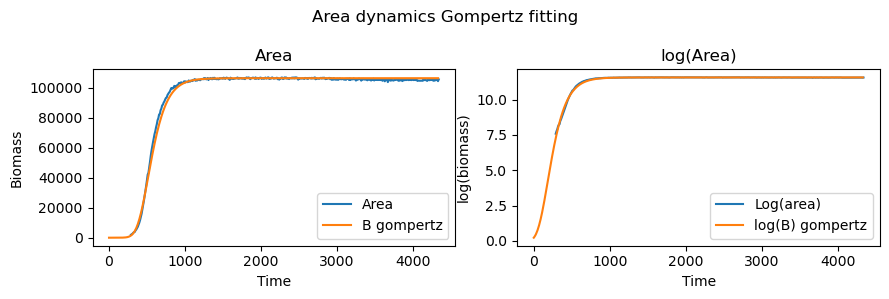

142 params: [12.282878490231008, 0.04027378097727202, 75.9247905591367]


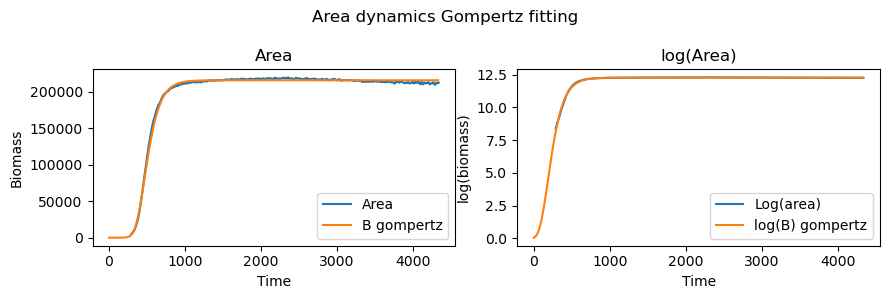

143 params: [12.089550448660628, 0.040248685309174755, 77.22557127614719]


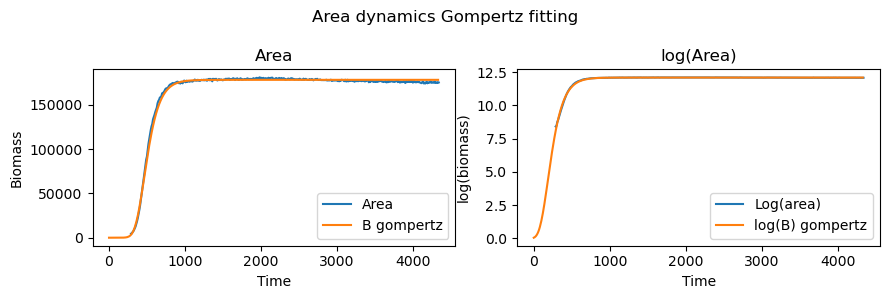

144 params: [11.824056199298356, 0.036172601912554704, 74.02471079551745]


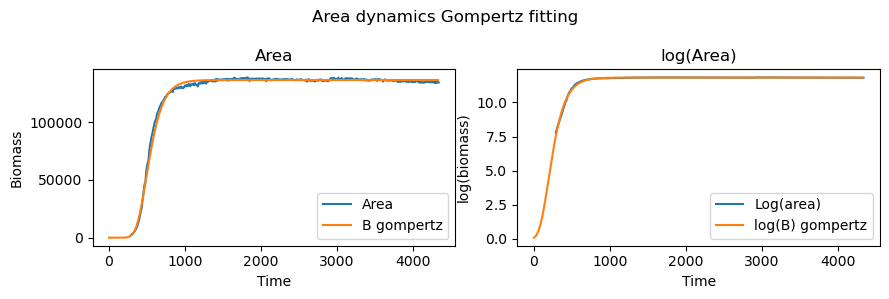

145 params: [12.11627026832213, 0.019295238216657715, 7.172057133141325]


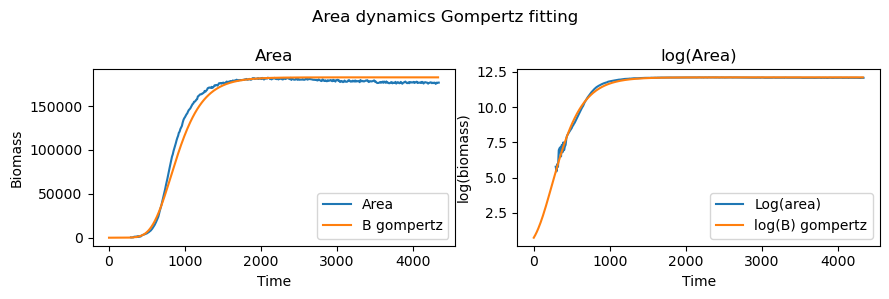

146 params: [11.28390693857042, 0.019074922314674943, 73.36291899186472]


/tmp/ipykernel_1223843/2271092873.py:25: RuntimeWarning: divide by zero encountered in log
  axes[1].plot(time_points, np.log(area), label='Log(area)')


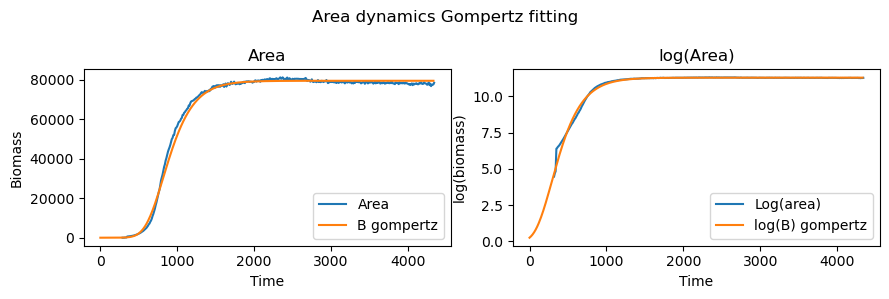

147 params: [10.927491551170665, 0.01670029834808019, -4.054972088303527]


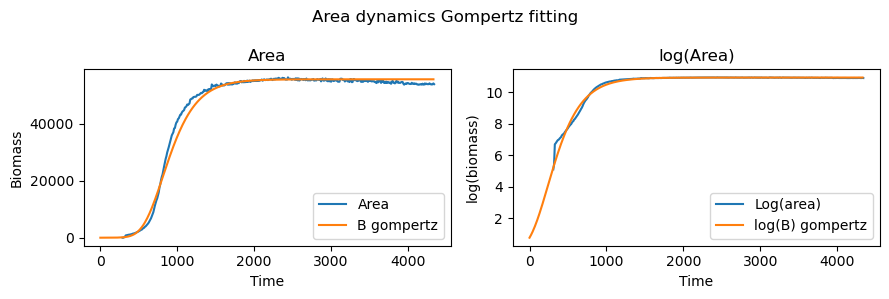

148 params: [11.00039622535197, 0.013471501968883283, -135.7197285977192]


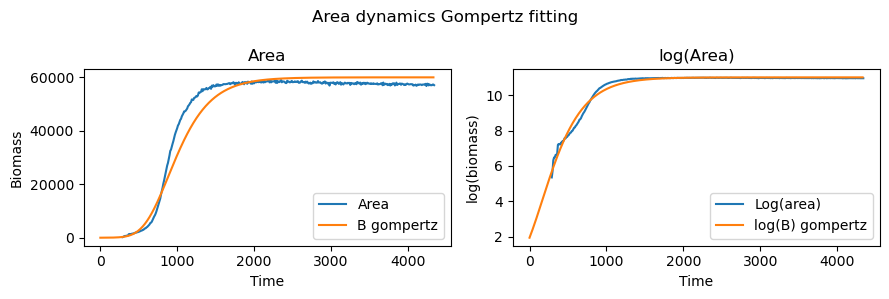

149 params: [11.206379710493884, 0.022665015972120083, 213.68186347945442]


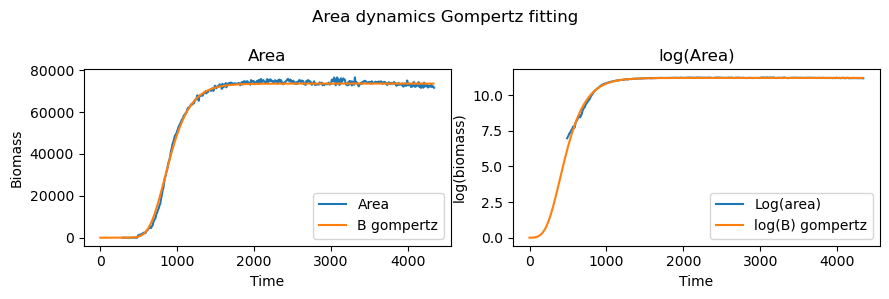

150 params: [11.37537437845027, 0.016454417374213073, -17.567126139780324]


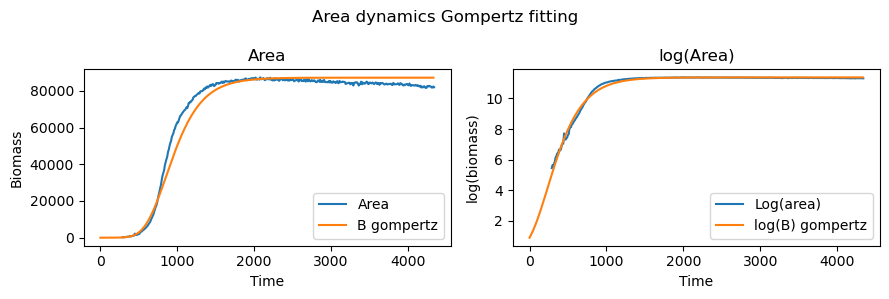

151 params: [11.714948846017265, 0.01935464647009746, 15.054554602087464]


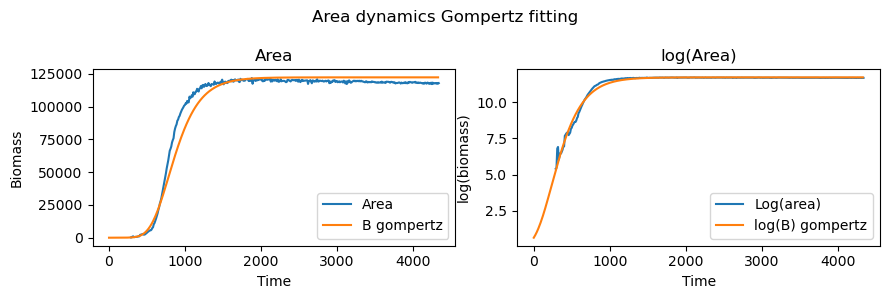

152 params: [11.482124680431301, 0.01979816008459517, 53.335924718948505]


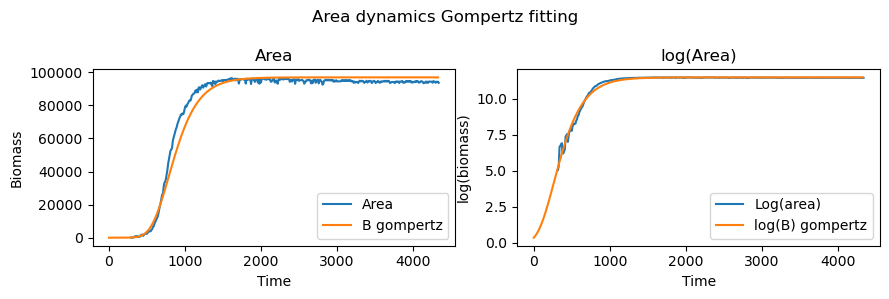

153 params: [11.410814853394154, 0.026612718099183683, 206.0336546147862]


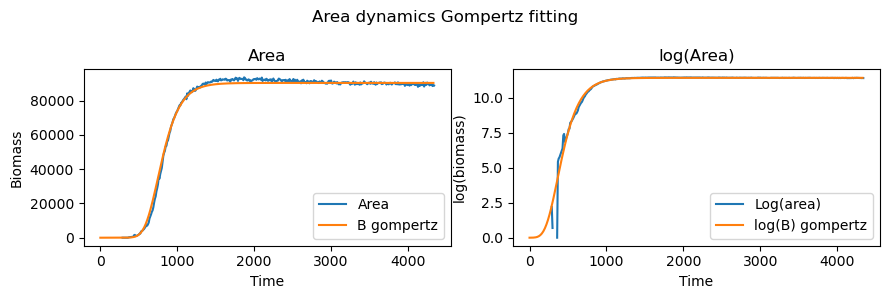

154 params: [11.352018975489505, 0.020555900389320057, -25.956731479119185]


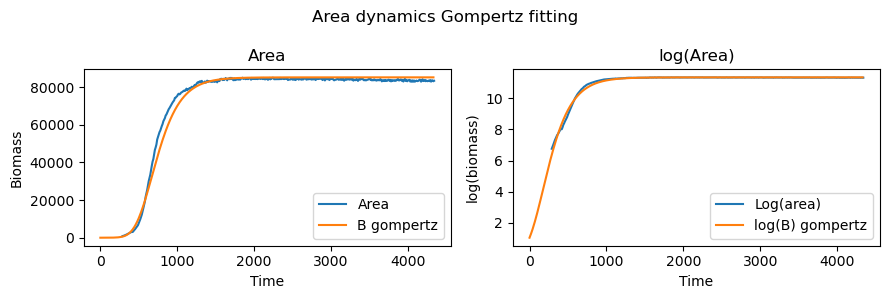

155 params: [11.498587926731926, 0.02160819128861098, -17.3476985338562]


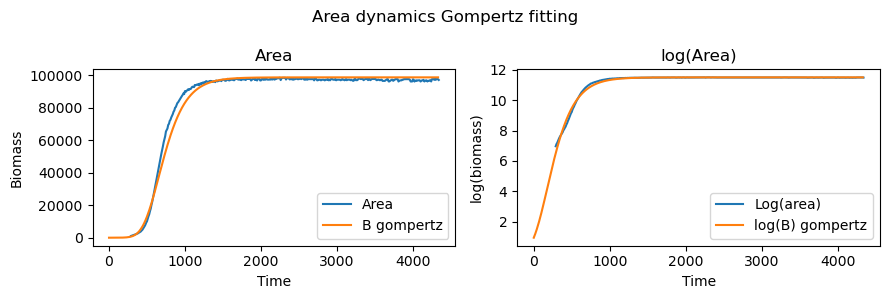

156 params: [11.581334583433026, 0.021375898793771678, -4.690878426562695]


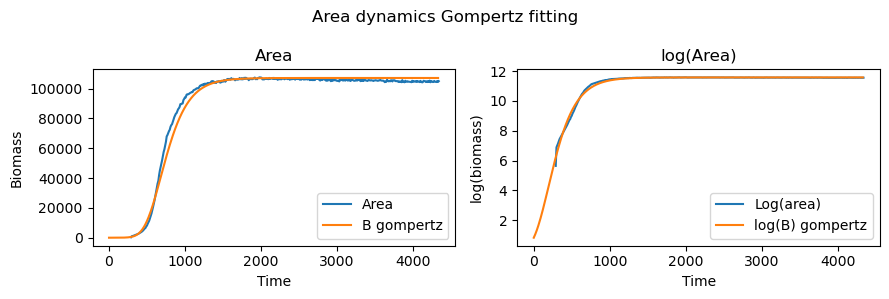

157 params: [11.676043818463635, 0.032217527143167286, 37.721113220699756]


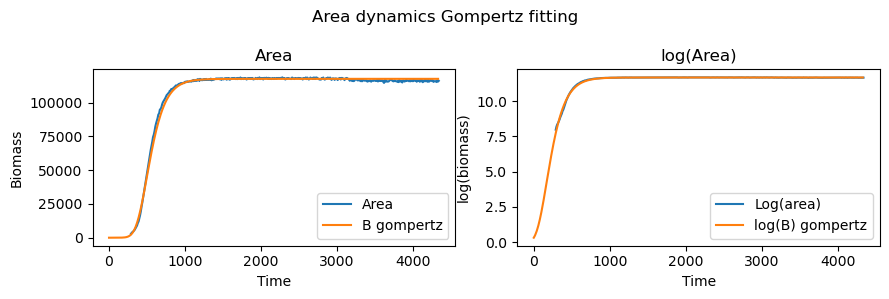

158 params: [11.59518040084648, 0.01669874531903686, -46.60073625115498]


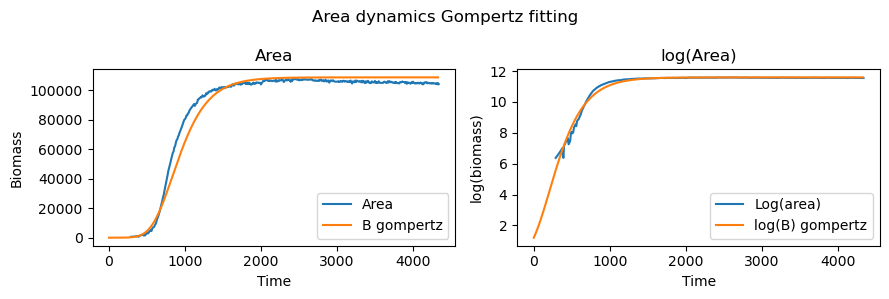

159 params: [10.130909580228547, 0.010122788656359176, -304.1645532813451]


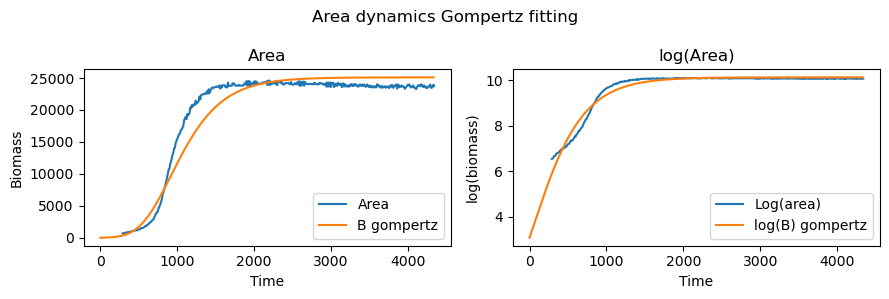

In [15]:
for i in df.index.values:
    incub_time_s = datetime.strptime(df.loc[i,'t_im'], '%H:%M:%S') - datetime.strptime(df.loc[i,'t_incub'], '%H:%M:%S')
    incub_time_n = incub_time_s.seconds / 60
    
    area = extract_array(df.loc[i,'area'])
    time_points = np.arange(0, df.loc[i, 'exp length'])*10 + incub_time_n
    time = np.arange(0, time_points[-1], 10, like=time_points)
    params = list(json.loads(df.loc[i,'gomp_params']).values())
    gomp = gompertz(time, *params)

    print(f"{i} params: {params}")
    # create subplots
    fig, axes = plt.subplots(1, 2, figsize=(9,3))

    # plot data
    axes[0].plot(time_points, area, label='Area')
    #axes[0].plot(time_points, savgol_filter(area, 21, 3), label='Filtered area')
    axes[0].plot(time, np.exp(gomp), label='B gompertz')
    axes[0].set_xlabel('Time')
    axes[0].set_ylabel('Biomass')
    axes[0].set_title('Area')
    axes[0].legend()

    # log area
    axes[1].plot(time_points, np.log(area), label='Log(area)')
    axes[1].plot(time, gomp, label='log(B) gompertz')
    axes[1].set_xlabel('Time')
    axes[1].set_ylabel('log(biomass)')
    axes[1].set_title('log(Area)')
    axes[1].legend()

    # growth rate
    """
    #axes[1].plot(time_points, np.log(area), label='Log(area)')
    axes[1].plot(time_points, savgol_filter(np.log(area), 21, 3, deriv=1), label='Growth rate area')
    axes[1].plot(time, savgol_filter(gomp, 21, 3, deriv=1), label='Growth rate B gompertz')
    axes[1].plot(time, gompertz_growth_rate(time, *params), label='Growth rate deriv')
    
    axes[1].set_xlabel('Time')
    axes[1].set_ylabel('Growth rate')
    axes[1].set_title('Growth rate')
    axes[1].legend()
    """
    
    plt.suptitle('Area dynamics Gompertz fitting')
    plt.tight_layout()
    plt.show()

#### Logistic fitting

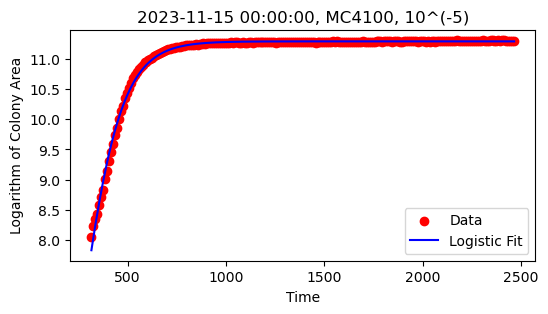

Fitted parameters [A, mu_m, lambda]: [11.29185481  0.02538485  2.80628613], idxdf: 0. Area0: 3139.0


/tmp/ipykernel_1223843/2084141370.py:35: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '{"A": 11.291854811467543, "mu_m": 0.025384848369673158, "lambda": 2.806286128000874}' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  df.at[i, 'logistic_params'] = json.dumps(pars_dict)


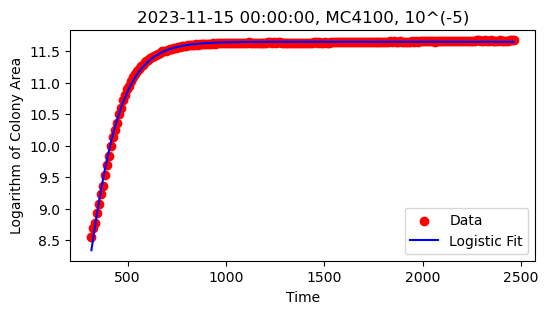

Fitted parameters [A, mu_m, lambda]: [11.64913926  0.02683691 -1.40658724], idxdf: 1. Area0: 5192.0


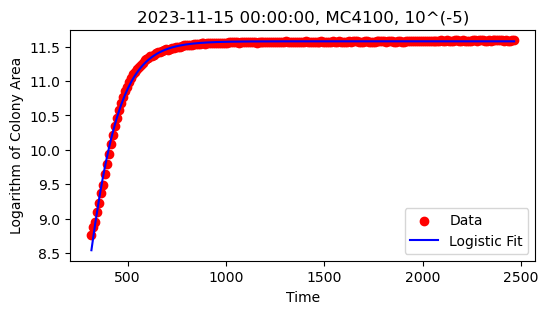

Fitted parameters [A, mu_m, lambda]: [11.57837849  0.02701794 -8.91537453], idxdf: 2. Area0: 6366.0


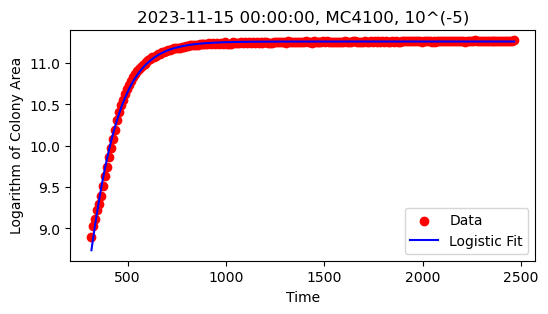

Fitted parameters [A, mu_m, lambda]: [ 1.12616908e+01  2.47235366e-02 -5.30598294e+01], idxdf: 3. Area0: 7293.0


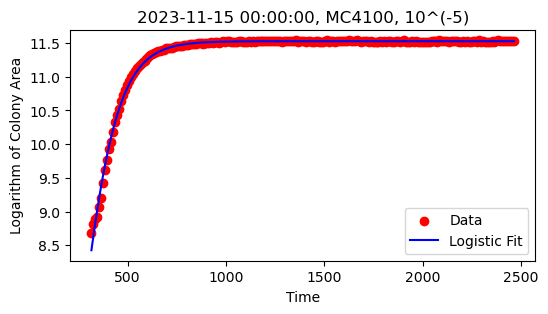

Fitted parameters [A, mu_m, lambda]: [11.52623607  0.02758673  2.66481889], idxdf: 4. Area0: 5875.0


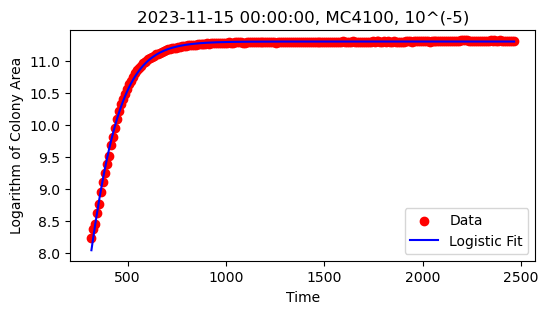

Fitted parameters [A, mu_m, lambda]: [11.29871968  0.02643601  5.53796569], idxdf: 5. Area0: 3798.0


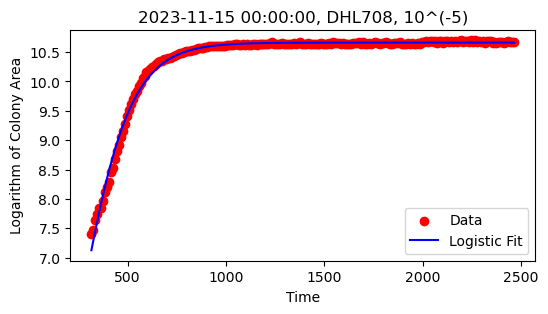

Fitted parameters [A, mu_m, lambda]: [ 1.06619439e+01  1.96021823e-02 -5.12137322e+01], idxdf: 6. Area0: 1643.0


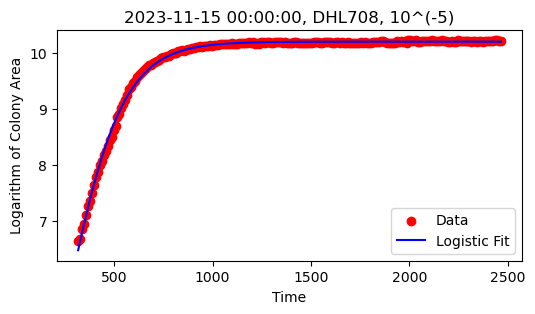

Fitted parameters [A, mu_m, lambda]: [ 1.01954889e+01  1.72623925e-02 -6.10163267e+01], idxdf: 7. Area0: 763.0


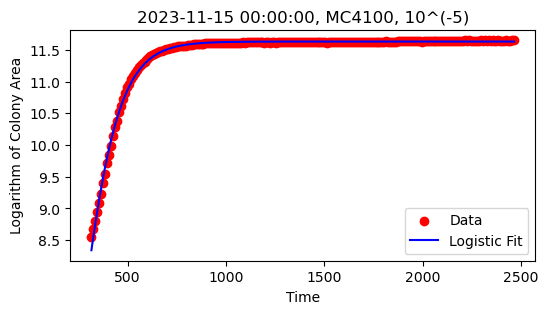

Fitted parameters [A, mu_m, lambda]: [11.63060675  0.02730827  3.94668673], idxdf: 8. Area0: 5201.0


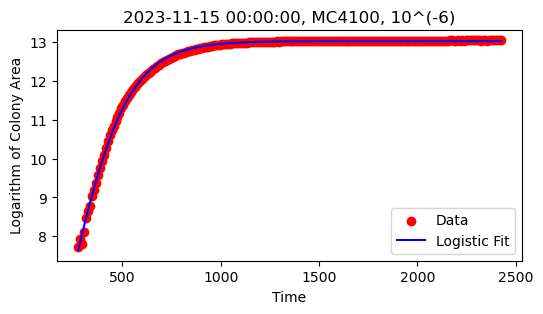

Fitted parameters [A, mu_m, lambda]: [ 1.30151731e+01  2.18601142e-02 -7.52377209e+01], idxdf: 9. Area0: 2275.0


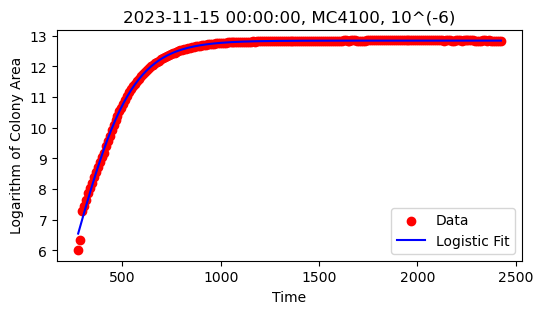

Fitted parameters [A, mu_m, lambda]: [ 12.84370591   0.02267168 -13.87880435], idxdf: 10. Area0: 406.0


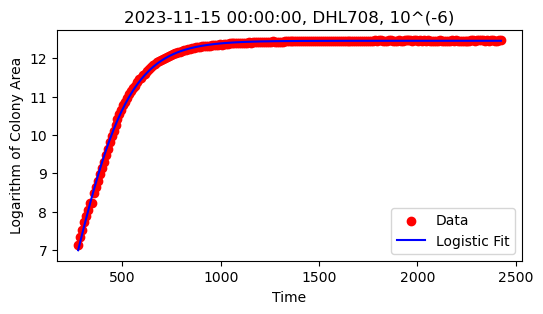

Fitted parameters [A, mu_m, lambda]: [ 1.24586337e+01  2.12579889e-02 -5.41315076e+01], idxdf: 11. Area0: 1241.0


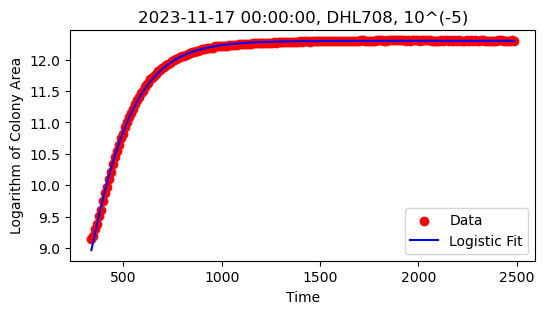

Fitted parameters [A, mu_m, lambda]: [ 1.22993284e+01  1.94631801e-02 -1.35353969e+02], idxdf: 12. Area0: 9398.0


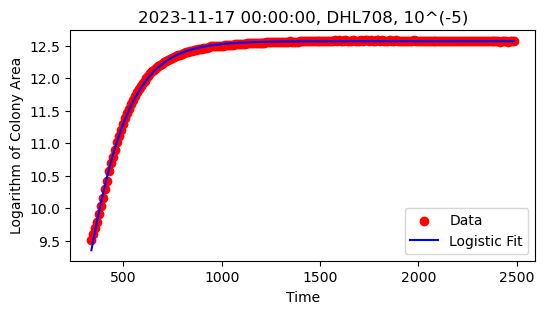

Fitted parameters [A, mu_m, lambda]: [ 1.25701765e+01  2.16547970e-02 -1.08224300e+02], idxdf: 13. Area0: 13623.0


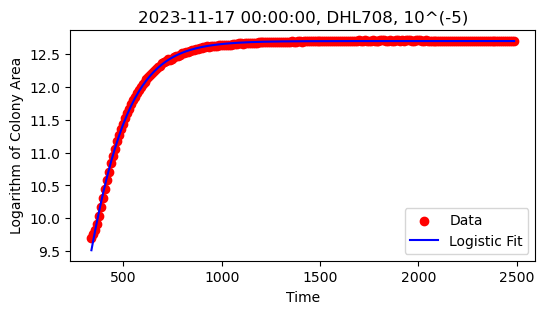

Fitted parameters [A, mu_m, lambda]: [ 1.27011043e+01  2.17038363e-02 -1.15479688e+02], idxdf: 14. Area0: 16357.0


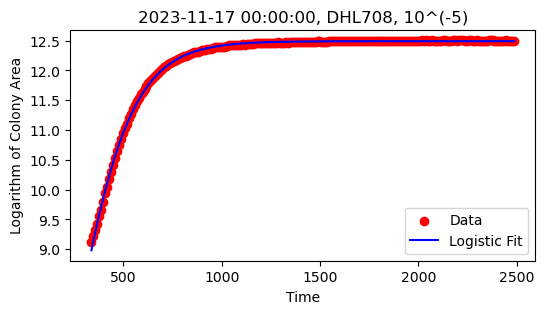

Fitted parameters [A, mu_m, lambda]: [ 1.24923961e+01  1.97348540e-02 -1.28241146e+02], idxdf: 15. Area0: 9106.0


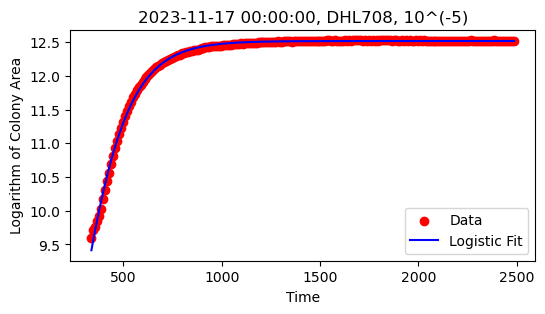

Fitted parameters [A, mu_m, lambda]: [ 1.25187919e+01  2.16887594e-02 -1.11642827e+02], idxdf: 16. Area0: 14765.0


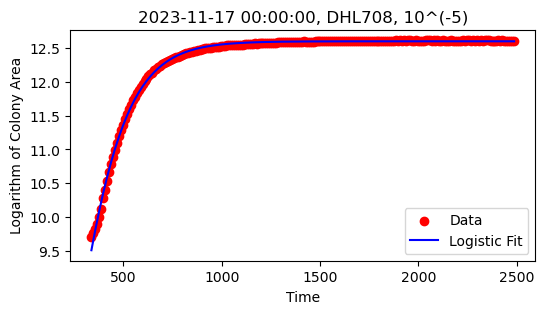

Fitted parameters [A, mu_m, lambda]: [ 1.25960970e+01  2.12607427e-02 -1.26047850e+02], idxdf: 17. Area0: 16398.0


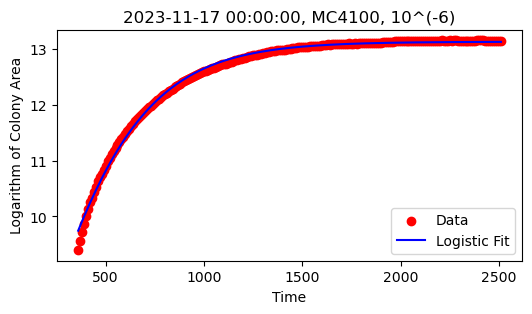

Fitted parameters [A, mu_m, lambda]: [ 1.31250413e+01  1.13530433e-02 -5.24098534e+02], idxdf: 18. Area0: 12036.0


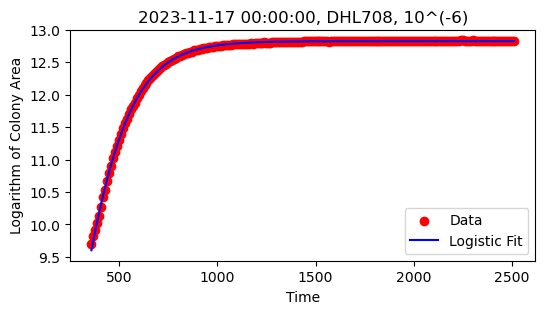

Fitted parameters [A, mu_m, lambda]: [ 1.28271348e+01  2.09559150e-02 -1.13017978e+02], idxdf: 19. Area0: 16291.0


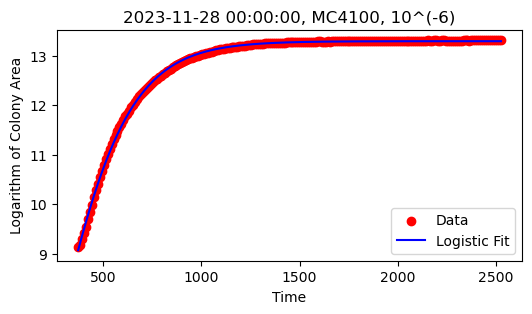

Fitted parameters [A, mu_m, lambda]: [ 1.32926218e+01  1.72596742e-02 -1.58274251e+02], idxdf: 20. Area0: 9248.0


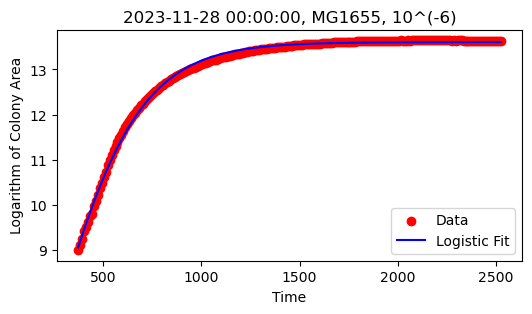

Fitted parameters [A, mu_m, lambda]: [ 1.36077467e+01  1.50754859e-02 -2.32458024e+02], idxdf: 21. Area0: 8001.0


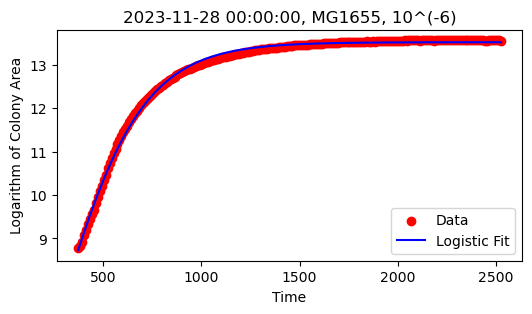

Fitted parameters [A, mu_m, lambda]: [ 1.35195413e+01  1.53131212e-02 -1.99806387e+02], idxdf: 22. Area0: 6485.0


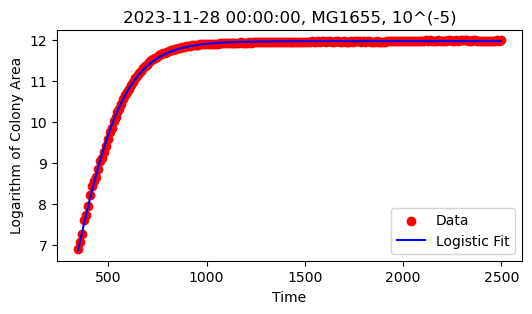

Fitted parameters [A, mu_m, lambda]: [1.19713467e+01 2.24634238e-02 4.05304332e+01], idxdf: 23. Area0: 1000.0


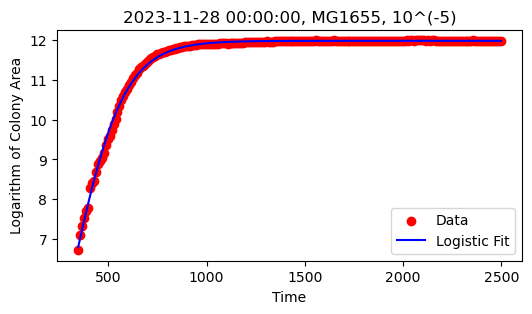

Fitted parameters [A, mu_m, lambda]: [1.19821223e+01 2.27798548e-02 4.85666023e+01], idxdf: 24. Area0: 826.0


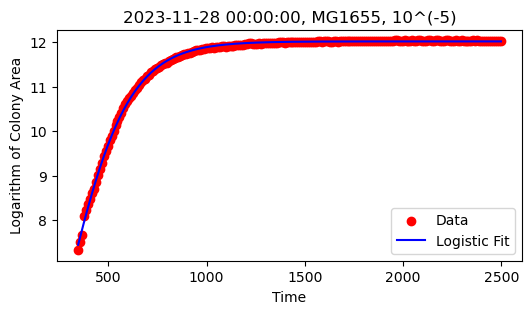

Fitted parameters [A, mu_m, lambda]: [ 1.20203279e+01  1.85935470e-02 -5.49459251e+01], idxdf: 25. Area0: 1514.0


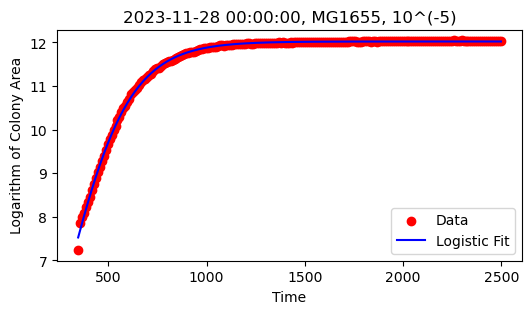

Fitted parameters [A, mu_m, lambda]: [ 1.20227683e+01  1.80418939e-02 -7.20440946e+01], idxdf: 26. Area0: 1386.0


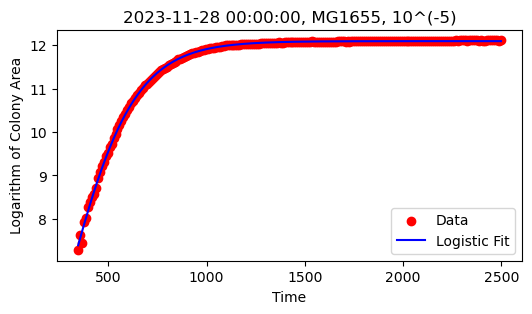

Fitted parameters [A, mu_m, lambda]: [ 1.20975232e+01  1.72325252e-02 -8.32181364e+01], idxdf: 27. Area0: 1447.0


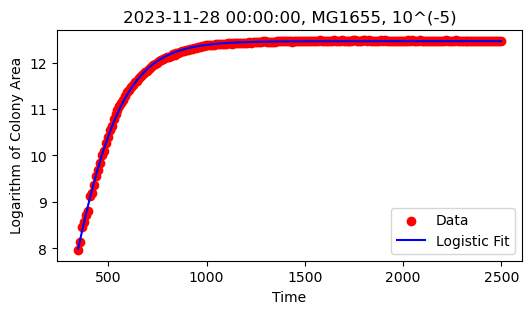

Fitted parameters [A, mu_m, lambda]: [ 1.24598103e+01  2.12800231e-02 -3.09340897e+01], idxdf: 28. Area0: 2868.0


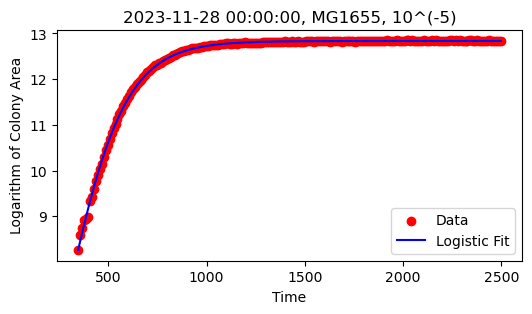

Fitted parameters [A, mu_m, lambda]: [ 1.28341453e+01  2.05138227e-02 -5.86020064e+01], idxdf: 29. Area0: 3865.0


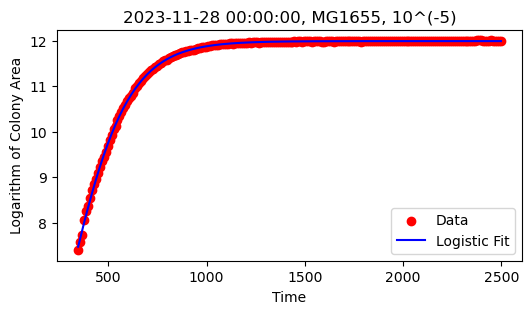

Fitted parameters [A, mu_m, lambda]: [ 1.19874906e+01  1.90465313e-02 -4.70812050e+01], idxdf: 30. Area0: 1631.0


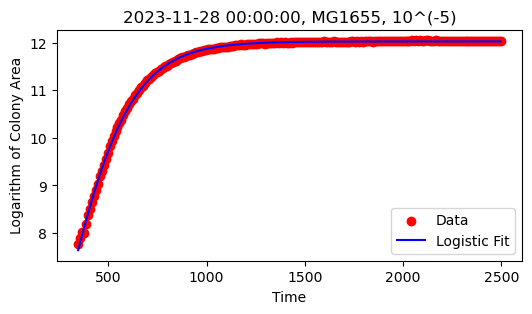

Fitted parameters [A, mu_m, lambda]: [ 1.20298629e+01  1.74208438e-02 -9.37734125e+01], idxdf: 31. Area0: 2377.0


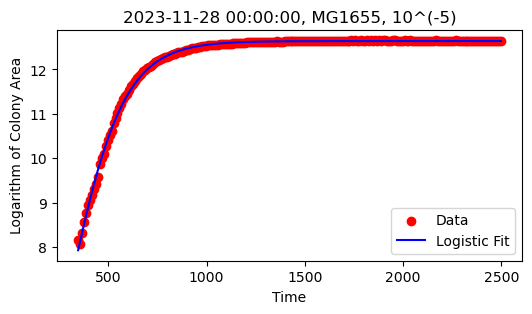

Fitted parameters [A, mu_m, lambda]: [ 12.63785488   0.02167076 -20.78057008], idxdf: 32. Area0: 3522.0


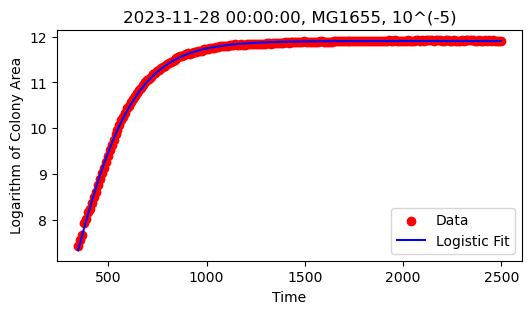

Fitted parameters [A, mu_m, lambda]: [ 1.19068089e+01  1.73061206e-02 -7.82876478e+01], idxdf: 33. Area0: 1665.0


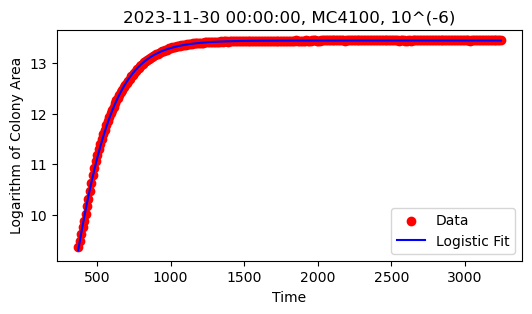

Fitted parameters [A, mu_m, lambda]: [ 1.34532637e+01  1.97479170e-02 -1.04465192e+02], idxdf: 34. Area0: 11610.0


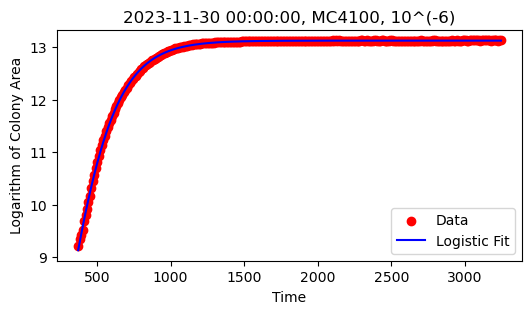

Fitted parameters [A, mu_m, lambda]: [ 1.31232836e+01  1.78692318e-02 -1.46318146e+02], idxdf: 35. Area0: 9997.0


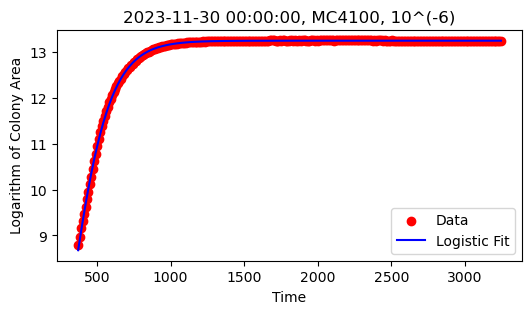

Fitted parameters [A, mu_m, lambda]: [13.25576286  0.0235969   2.29029276], idxdf: 36. Area0: 6538.0


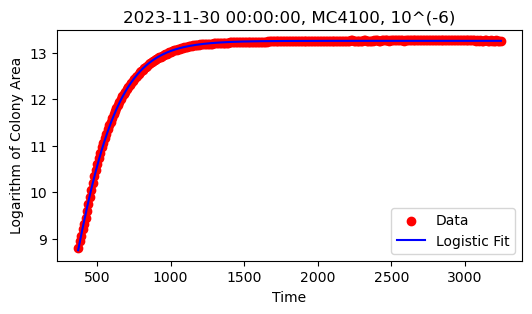

Fitted parameters [A, mu_m, lambda]: [ 1.32516488e+01  1.80501120e-02 -1.15995450e+02], idxdf: 37. Area0: 6603.0


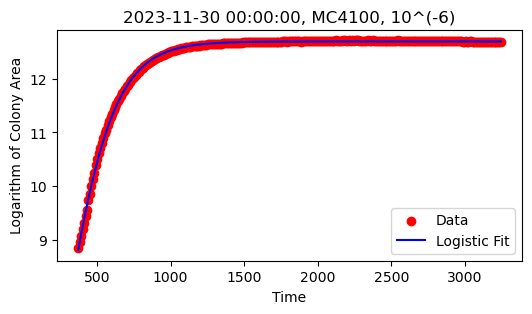

Fitted parameters [A, mu_m, lambda]: [ 1.26942513e+01  1.76928160e-02 -1.32475495e+02], idxdf: 38. Area0: 6955.0


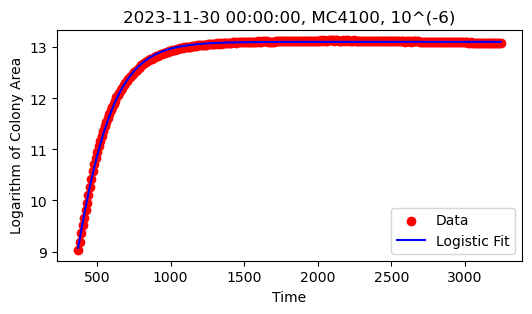

Fitted parameters [A, mu_m, lambda]: [ 1.31076891e+01  1.96461652e-02 -9.58692431e+01], idxdf: 39. Area0: 8312.0


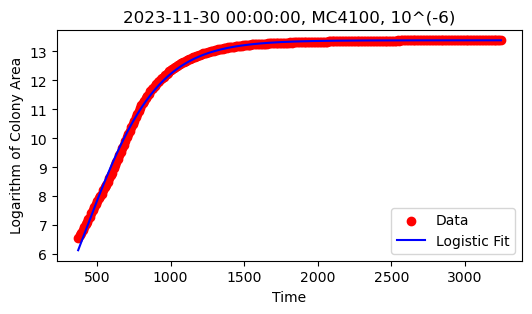

Fitted parameters [A, mu_m, lambda]: [ 1.33848914e+01  1.34286281e-02 -8.43660436e+01], idxdf: 40. Area0: 706.0


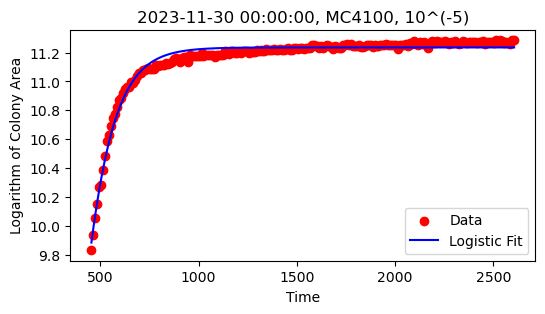

Fitted parameters [A, mu_m, lambda]: [11.23559766  0.02482535  3.53873116], idxdf: 41. Area0: 18610.0


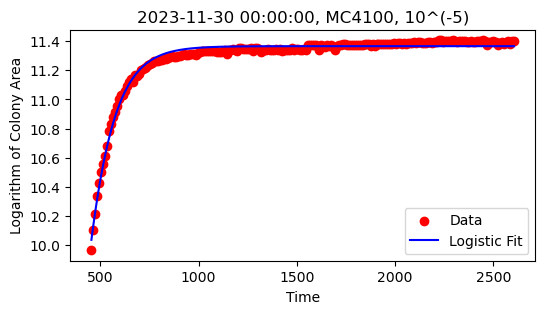

Fitted parameters [A, mu_m, lambda]: [11.36494914  0.02570911 10.42070585], idxdf: 42. Area0: 21289.0


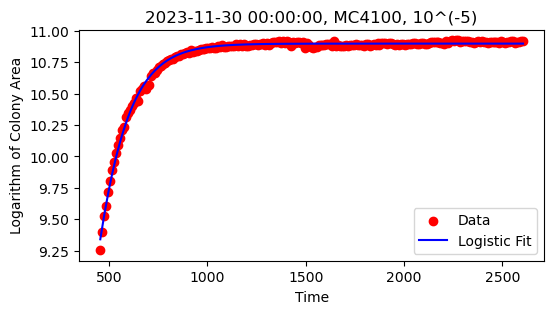

Fitted parameters [A, mu_m, lambda]: [ 1.08970673e+01  2.07672106e-02 -4.24452138e+01], idxdf: 43. Area0: 10445.0


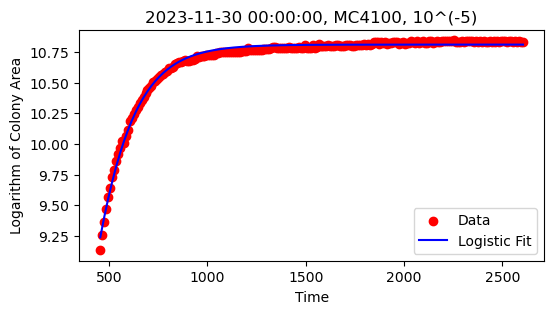

Fitted parameters [A, mu_m, lambda]: [ 1.08087249e+01  1.73179445e-02 -1.33753440e+02], idxdf: 44. Area0: 9270.0


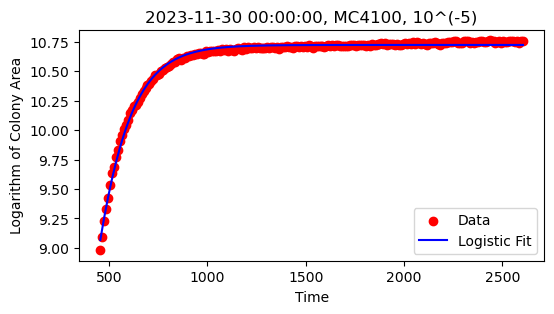

Fitted parameters [A, mu_m, lambda]: [ 1.07234754e+01  1.94290623e-02 -5.54888944e+01], idxdf: 45. Area0: 7945.0


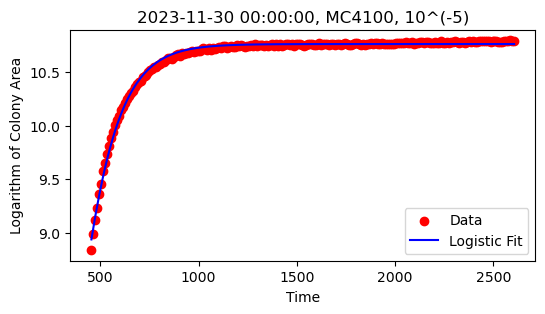

Fitted parameters [A, mu_m, lambda]: [ 10.76174644   0.02051704 -15.70210746], idxdf: 46. Area0: 6888.0


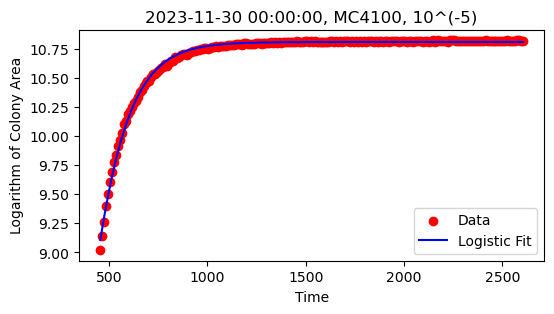

Fitted parameters [A, mu_m, lambda]: [ 1.08119075e+01  2.01423540e-02 -3.82185639e+01], idxdf: 47. Area0: 8256.0


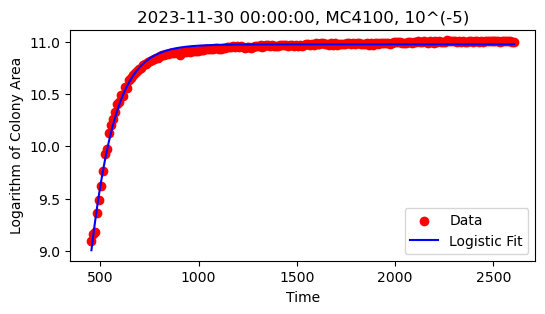

Fitted parameters [A, mu_m, lambda]: [1.09729644e+01 2.65511468e-02 9.10685606e+01], idxdf: 48. Area0: 8915.0


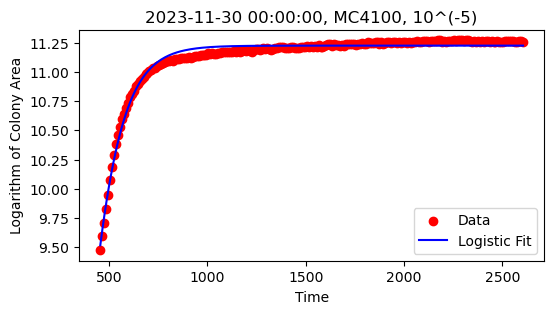

Fitted parameters [A, mu_m, lambda]: [1.12234934e+01 2.55187160e-02 4.60687112e+01], idxdf: 49. Area0: 13035.0


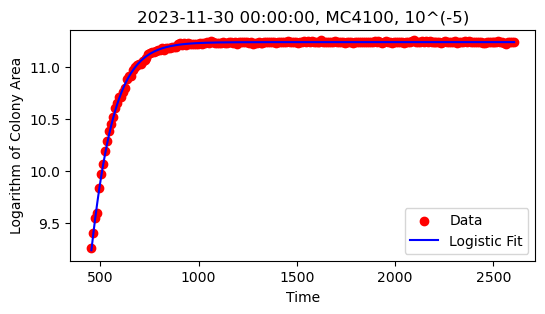

Fitted parameters [A, mu_m, lambda]: [1.12406870e+01 2.89307272e-02 1.12088723e+02], idxdf: 50. Area0: 10518.0


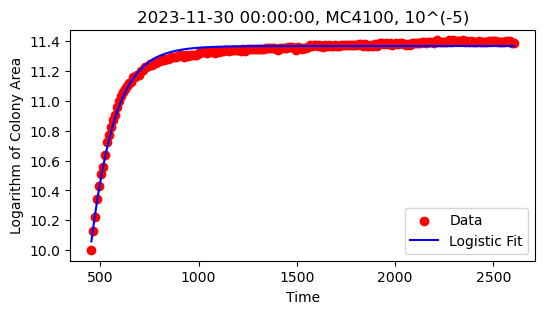

Fitted parameters [A, mu_m, lambda]: [11.36871049  0.02541272  3.35276025], idxdf: 51. Area0: 22015.0


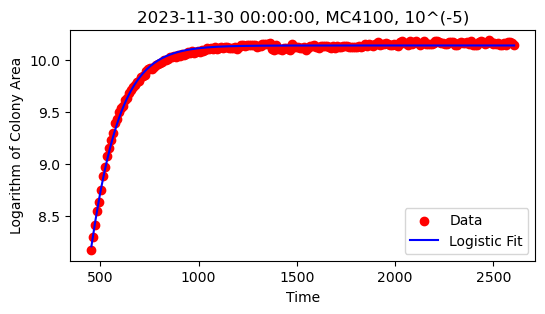

Fitted parameters [A, mu_m, lambda]: [1.01347304e+01 2.08828046e-02 3.65310024e+01], idxdf: 52. Area0: 3535.0


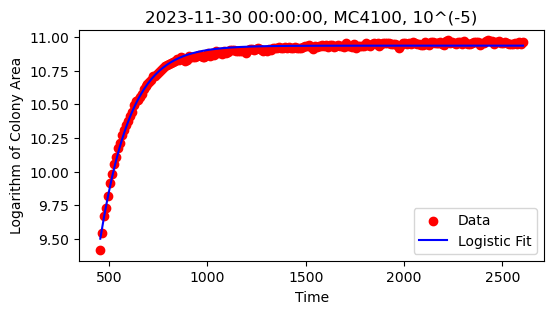

Fitted parameters [A, mu_m, lambda]: [ 1.09359567e+01  1.96798940e-02 -8.54907939e+01], idxdf: 53. Area0: 12280.0


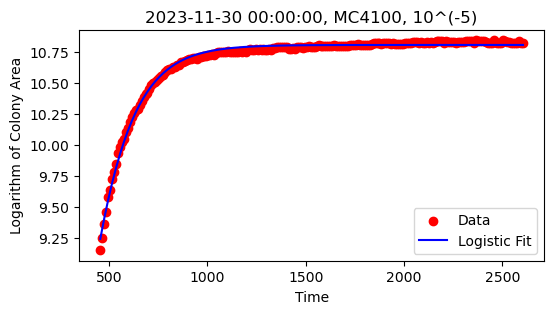

Fitted parameters [A, mu_m, lambda]: [ 1.08100178e+01  1.74094518e-02 -1.31139284e+02], idxdf: 54. Area0: 9445.0


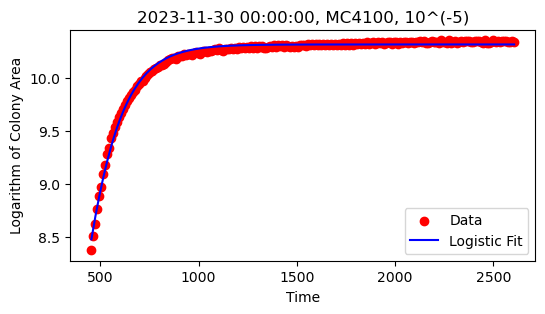

Fitted parameters [A, mu_m, lambda]: [ 1.03160144e+01  1.91514799e-02 -2.02507653e+01], idxdf: 55. Area0: 4340.0


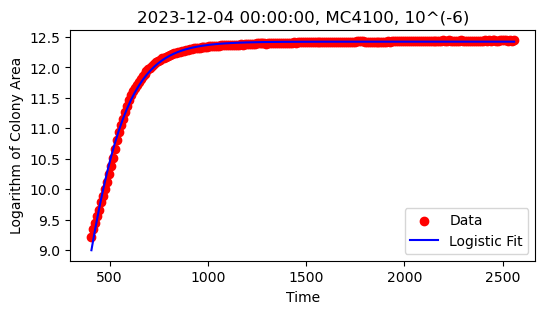

Fitted parameters [A, mu_m, lambda]: [12.42239809  0.02340344 14.4137657 ], idxdf: 56. Area0: 10074.0


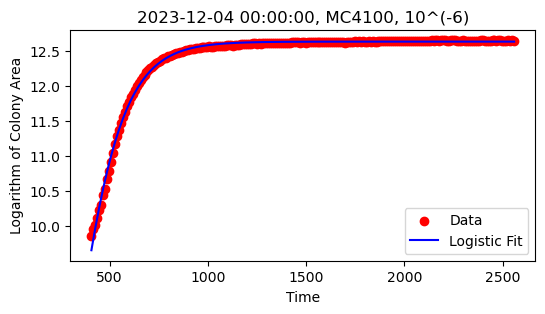

Fitted parameters [A, mu_m, lambda]: [ 1.26343917e+01  2.31384034e-02 -2.57519658e+01], idxdf: 57. Area0: 19130.0


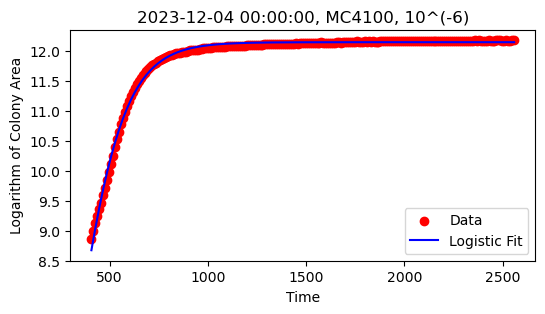

Fitted parameters [A, mu_m, lambda]: [1.21534687e+01 2.32605784e-02 2.73660818e+01], idxdf: 58. Area0: 7071.0


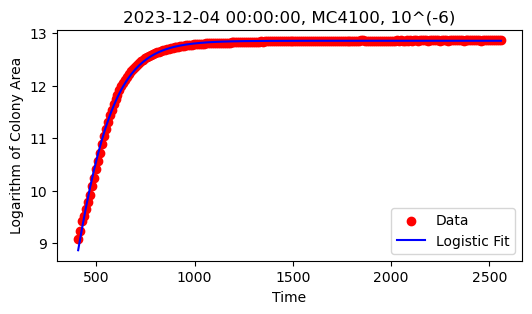

Fitted parameters [A, mu_m, lambda]: [1.28559459e+01 2.56359209e-02 5.72428905e+01], idxdf: 59. Area0: 8794.0


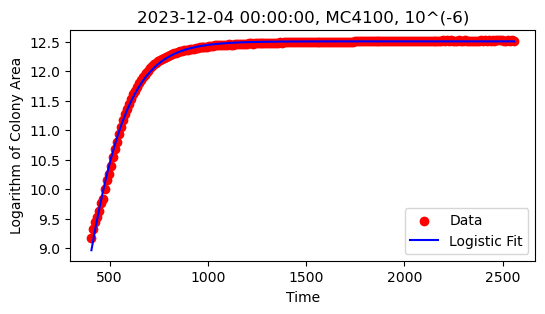

Fitted parameters [A, mu_m, lambda]: [12.50970538  0.02323784 14.11611238], idxdf: 60. Area0: 9662.0


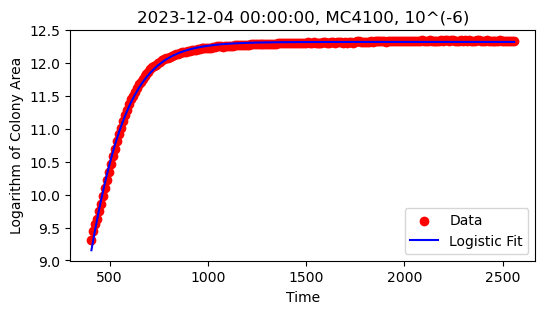

Fitted parameters [A, mu_m, lambda]: [ 12.31849647   0.02229102 -15.12051423], idxdf: 61. Area0: 11019.0


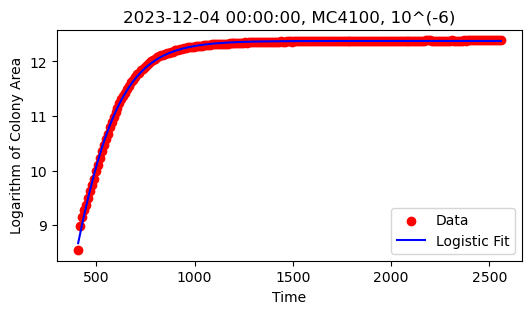

Fitted parameters [A, mu_m, lambda]: [ 12.37441137   0.0210694  -10.74425862], idxdf: 62. Area0: 5140.0


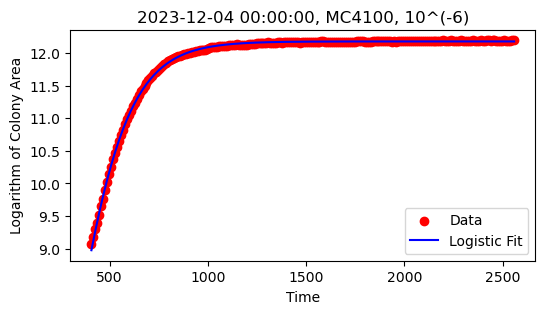

Fitted parameters [A, mu_m, lambda]: [ 1.21767861e+01  1.99690814e-02 -5.41917701e+01], idxdf: 63. Area0: 8692.0


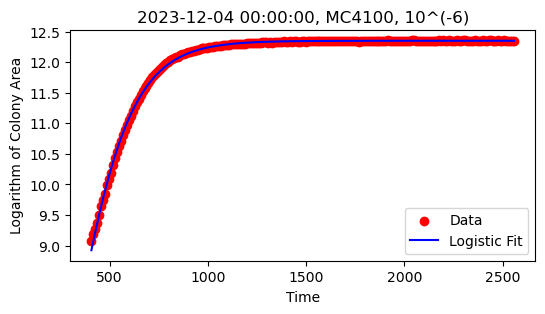

Fitted parameters [A, mu_m, lambda]: [ 1.23513130e+01  1.95883376e-02 -5.81235187e+01], idxdf: 64. Area0: 8762.0


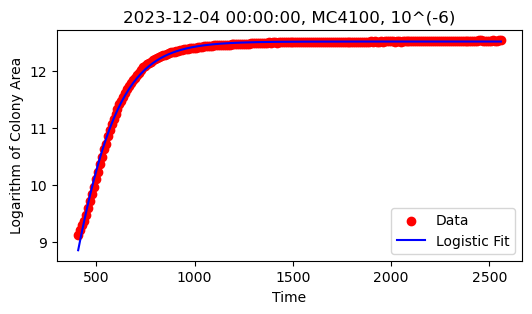

Fitted parameters [A, mu_m, lambda]: [ 12.51948153   0.02128684 -15.3401136 ], idxdf: 65. Area0: 9019.0


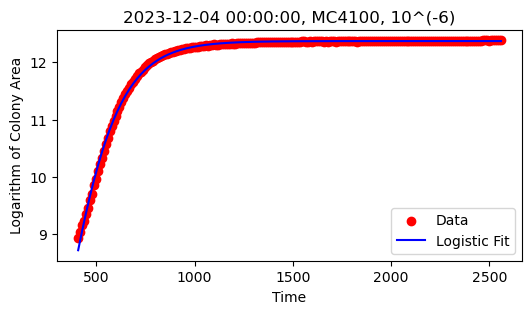

Fitted parameters [A, mu_m, lambda]: [ 12.37020008   0.02076375 -19.39729514], idxdf: 66. Area0: 7521.0


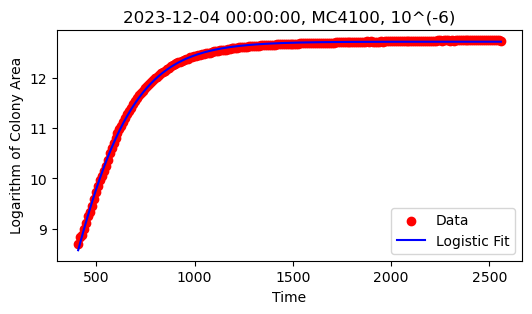

Fitted parameters [A, mu_m, lambda]: [ 1.27303376e+01  1.66519744e-02 -1.12230096e+02], idxdf: 67. Area0: 5917.0


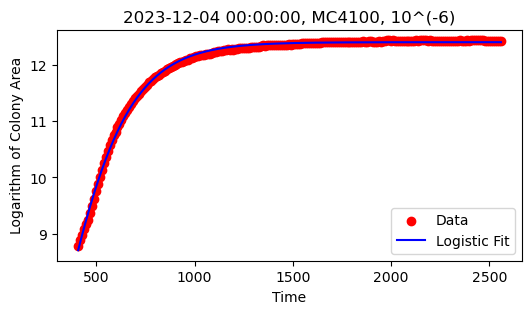

Fitted parameters [A, mu_m, lambda]: [ 1.24102756e+01  1.64976637e-02 -1.28687233e+02], idxdf: 68. Area0: 6484.0


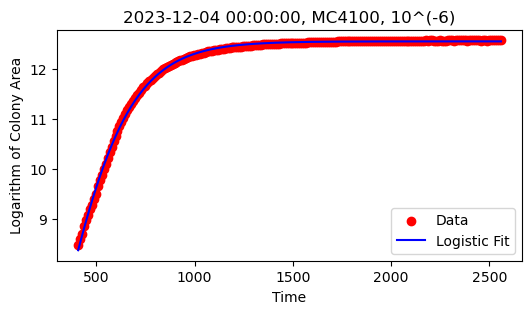

Fitted parameters [A, mu_m, lambda]: [ 1.25615237e+01  1.70208096e-02 -8.83769137e+01], idxdf: 69. Area0: 4818.0


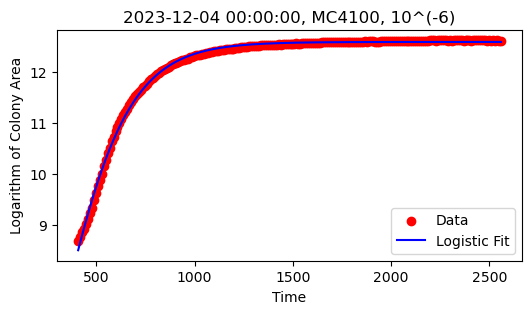

Fitted parameters [A, mu_m, lambda]: [ 1.25950962e+01  1.71970224e-02 -9.23583027e+01], idxdf: 70. Area0: 5935.0


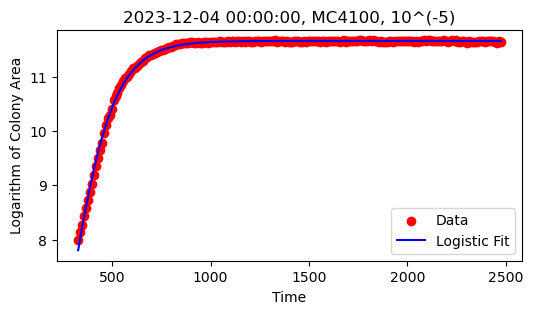

Fitted parameters [A, mu_m, lambda]: [11.65914385  0.02420293  0.21741999], idxdf: 71. Area0: 2977.0


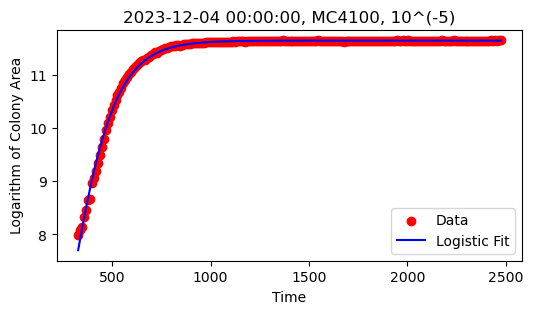

Fitted parameters [A, mu_m, lambda]: [11.64348263  0.02349327 -4.91383495], idxdf: 72. Area0: 2929.0


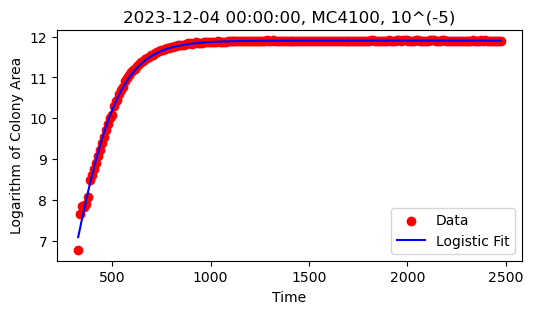

Fitted parameters [A, mu_m, lambda]: [1.19012917e+01 2.41960568e-02 3.26687228e+01], idxdf: 73. Area0: 866.0


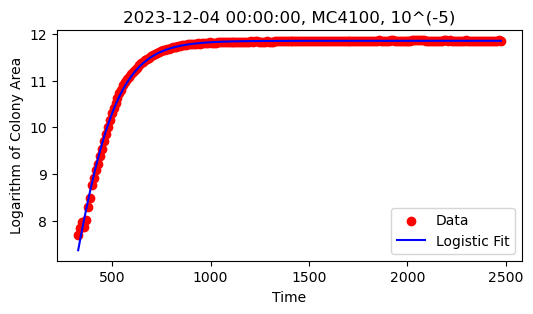

Fitted parameters [A, mu_m, lambda]: [11.85079496  0.02394942 16.90440643], idxdf: 74. Area0: 2219.0


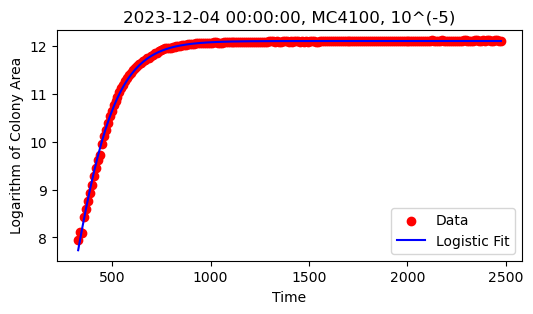

Fitted parameters [A, mu_m, lambda]: [12.11125528  0.0249416  14.20129528], idxdf: 75. Area0: 2838.0


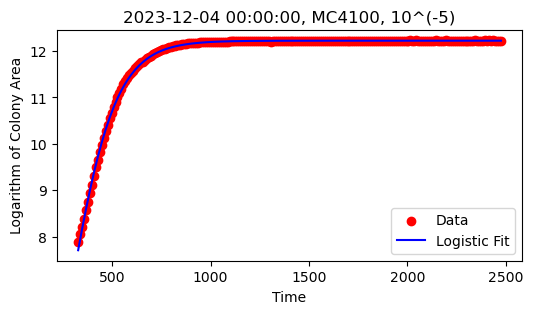

Fitted parameters [A, mu_m, lambda]: [12.22385725  0.02511548 17.76097742], idxdf: 76. Area0: 2632.0


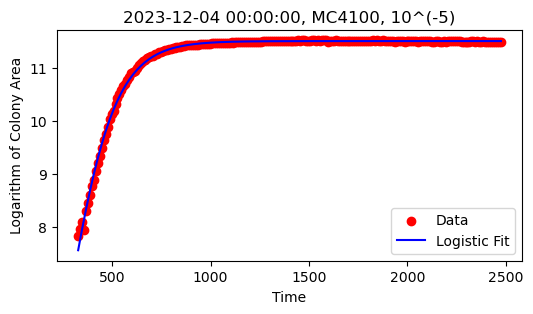

Fitted parameters [A, mu_m, lambda]: [ 11.51598684   0.02266677 -10.41542958], idxdf: 77. Area0: 2510.0


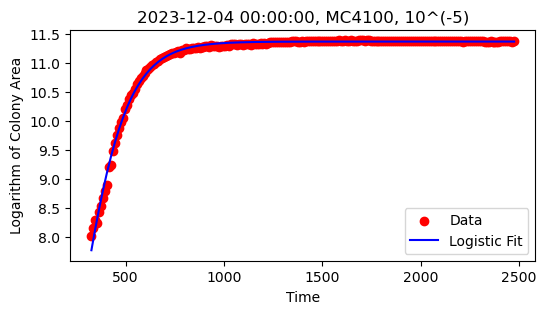

Fitted parameters [A, mu_m, lambda]: [ 1.13636402e+01  2.23933978e-02 -2.56068402e+01], idxdf: 78. Area0: 3022.0


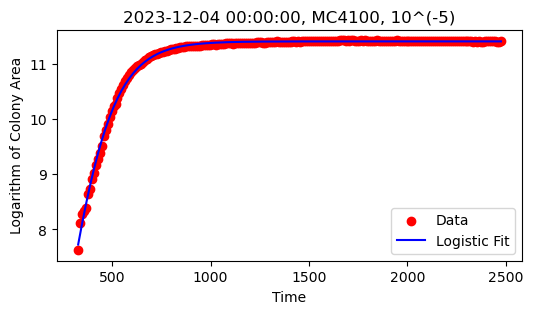

Fitted parameters [A, mu_m, lambda]: [ 1.14023921e+01  2.22865338e-02 -2.49137173e+01], idxdf: 79. Area0: 2049.0


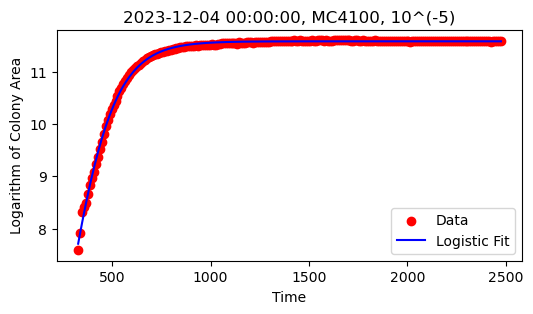

Fitted parameters [A, mu_m, lambda]: [11.58731348  0.02321648 -9.34488859], idxdf: 80. Area0: 1970.0


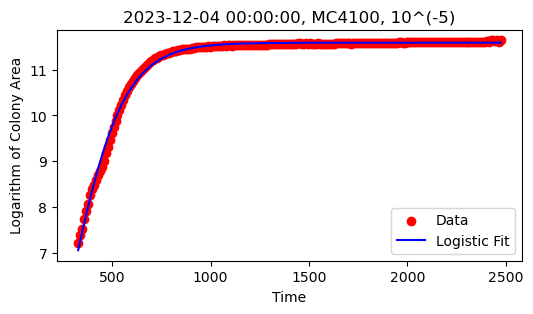

Fitted parameters [A, mu_m, lambda]: [ 11.59019405   0.02072479 -15.25085327], idxdf: 81. Area0: 1345.0


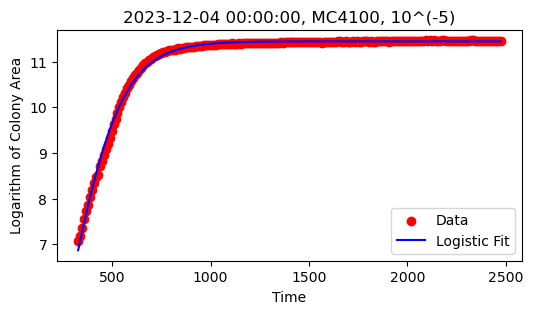

Fitted parameters [A, mu_m, lambda]: [11.44343934  0.0210952  -0.52971459], idxdf: 82. Area0: 1174.0


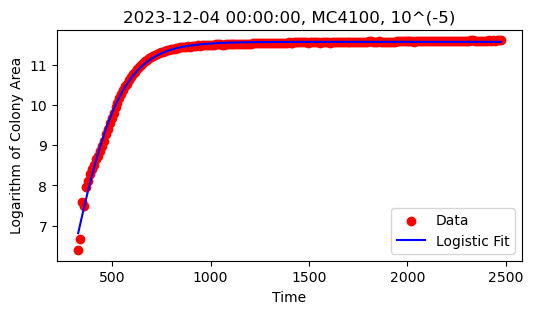

Fitted parameters [A, mu_m, lambda]: [1.15652729e+01 2.26830012e-02 2.50639276e+01], idxdf: 83. Area0: 597.0


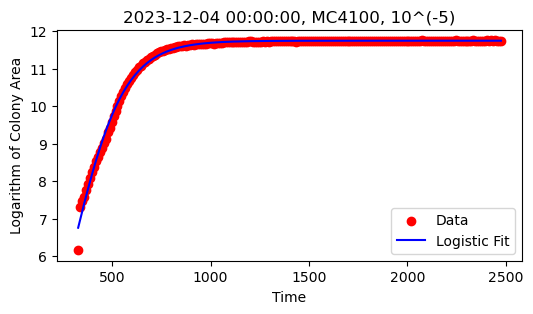

Fitted parameters [A, mu_m, lambda]: [11.73992005  0.02197974 18.03552028], idxdf: 84. Area0: 475.0


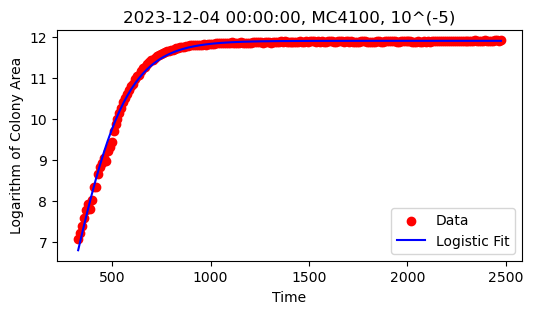

Fitted parameters [A, mu_m, lambda]: [11.90523939  0.02119059  4.98188446], idxdf: 85. Area0: 1176.0


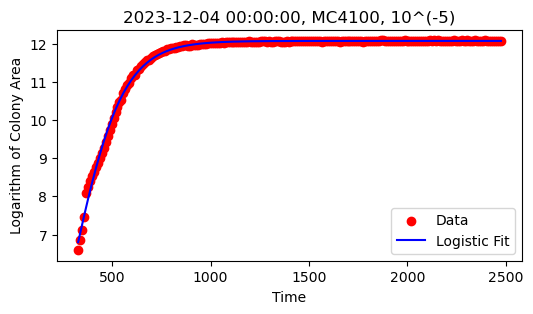

Fitted parameters [A, mu_m, lambda]: [1.20688020e+01 2.36741626e-02 3.85652905e+01], idxdf: 86. Area0: 728.0


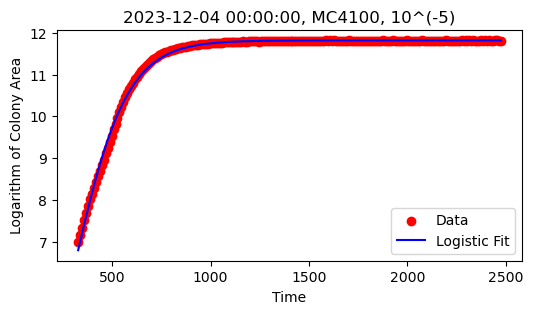

Fitted parameters [A, mu_m, lambda]: [11.8177085   0.02109076  3.35707162], idxdf: 87. Area0: 1085.0


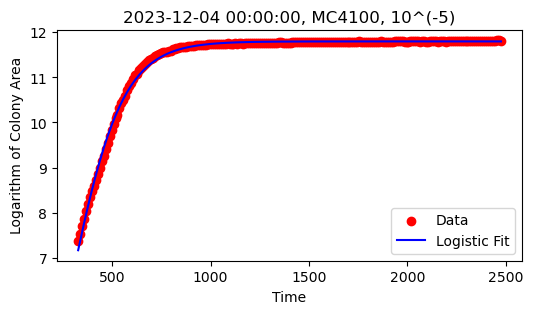

Fitted parameters [A, mu_m, lambda]: [11.7980654   0.02149366 -8.41591952], idxdf: 88. Area0: 1593.0


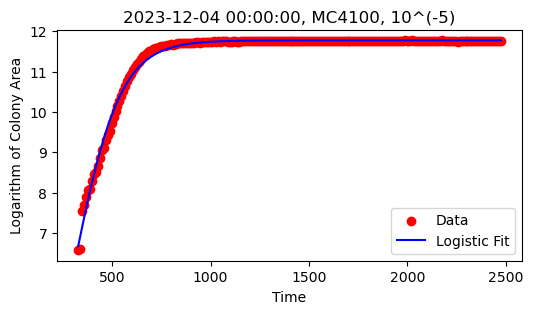

Fitted parameters [A, mu_m, lambda]: [1.17764894e+01 2.43263129e-02 5.16427439e+01], idxdf: 89. Area0: 714.0


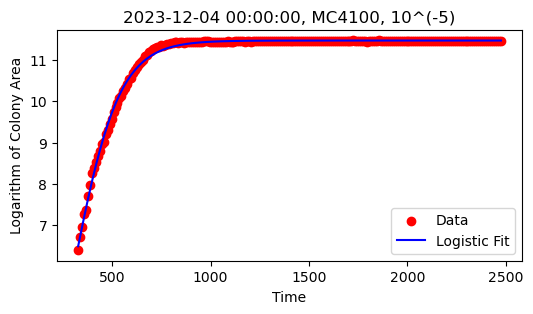

Fitted parameters [A, mu_m, lambda]: [1.14710314e+01 2.42825944e-02 5.86862227e+01], idxdf: 90. Area0: 596.0


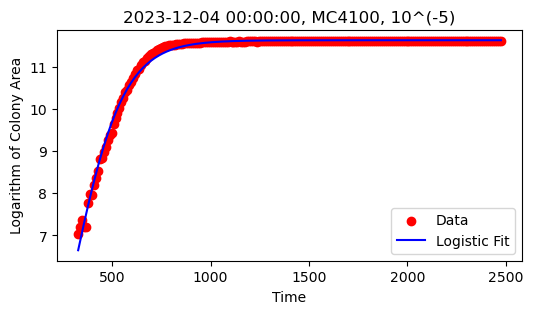

Fitted parameters [A, mu_m, lambda]: [1.16252639e+01 2.22992297e-02 2.75198983e+01], idxdf: 91. Area0: 1136.0


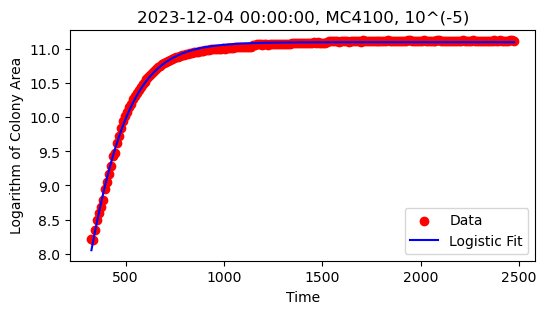

Fitted parameters [A, mu_m, lambda]: [ 1.11016876e+01  1.93422188e-02 -1.00195424e+02], idxdf: 92. Area0: 3675.0


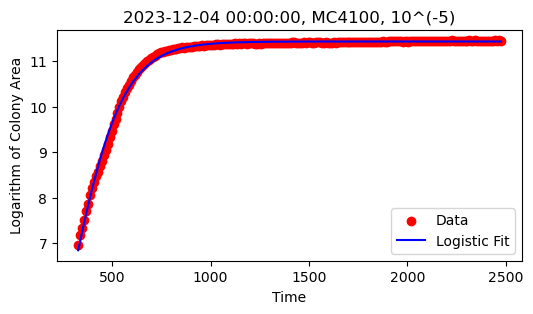

Fitted parameters [A, mu_m, lambda]: [11.43003293  0.02126791  3.31741372], idxdf: 93. Area0: 1067.0


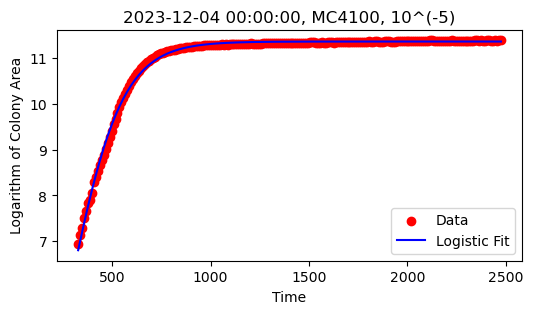

Fitted parameters [A, mu_m, lambda]: [11.3550236   0.02091105 -0.21215334], idxdf: 94. Area0: 1029.0


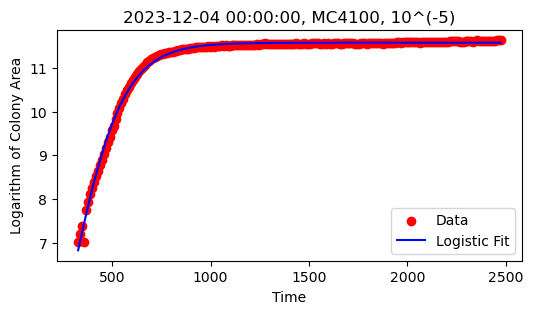

Fitted parameters [A, mu_m, lambda]: [11.57617242  0.02162623  9.84774214], idxdf: 95. Area0: 1112.0


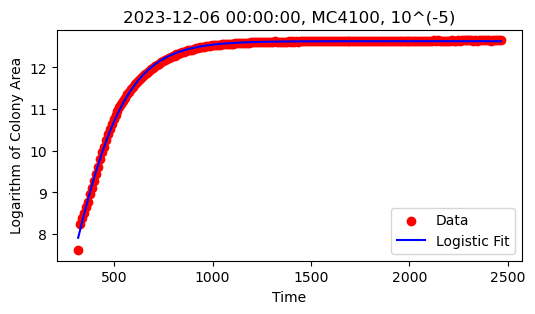

Fitted parameters [A, mu_m, lambda]: [ 1.26290432e+01  2.06887336e-02 -6.81777124e+01], idxdf: 96. Area0: 2027.0


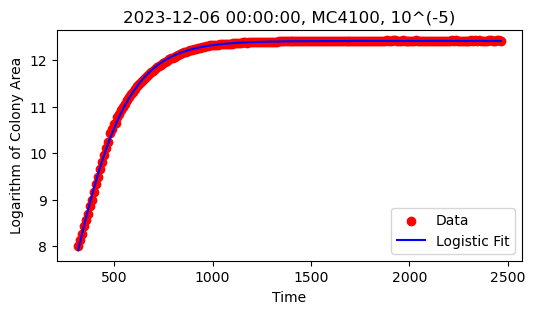

Fitted parameters [A, mu_m, lambda]: [ 1.24182932e+01  1.96972982e-02 -8.80255722e+01], idxdf: 97. Area0: 2993.0


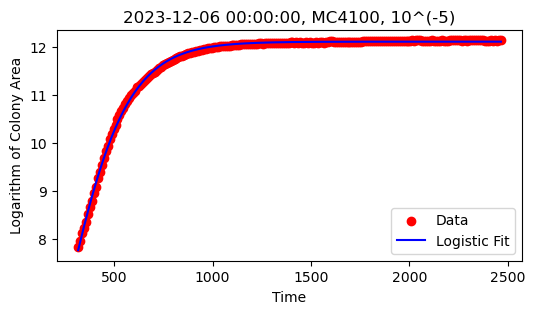

Fitted parameters [A, mu_m, lambda]: [ 1.21172883e+01  1.86681901e-02 -1.01917431e+02], idxdf: 98. Area0: 2512.0


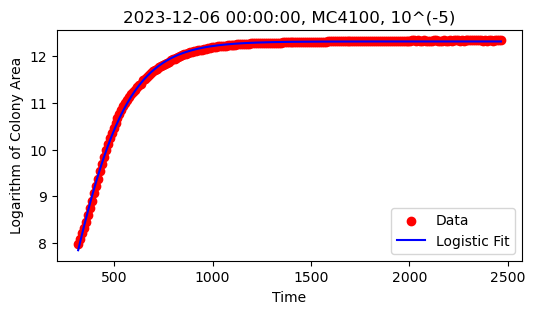

Fitted parameters [A, mu_m, lambda]: [ 1.23116520e+01  1.91830410e-02 -9.53064718e+01], idxdf: 99. Area0: 2896.0


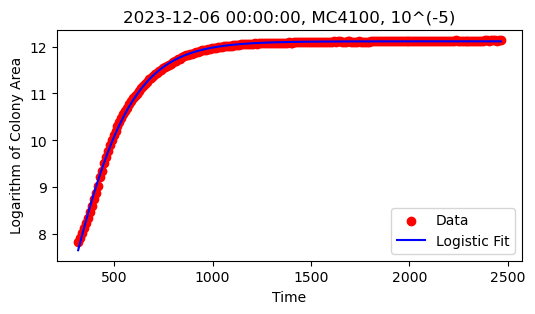

Fitted parameters [A, mu_m, lambda]: [ 1.21105018e+01  1.75182183e-02 -1.23553800e+02], idxdf: 100. Area0: 2519.0


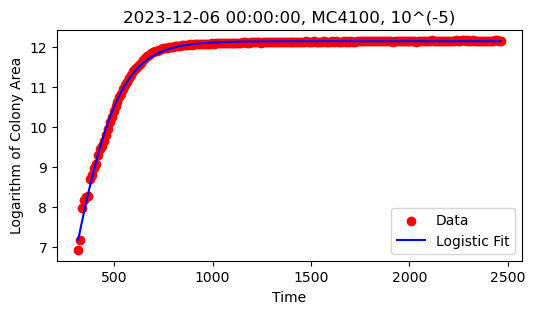

Fitted parameters [A, mu_m, lambda]: [1.21543313e+01 2.47372210e-02 2.54774309e+01], idxdf: 101. Area0: 1005.0


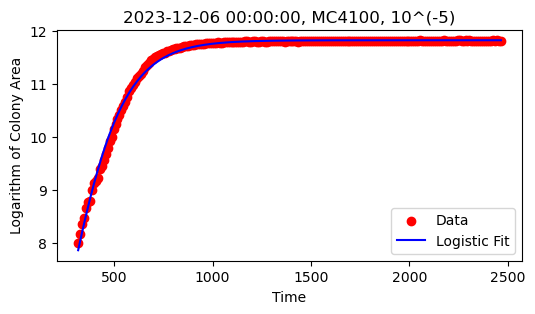

Fitted parameters [A, mu_m, lambda]: [ 1.18179844e+01  1.94516847e-02 -9.18450244e+01], idxdf: 102. Area0: 2952.0


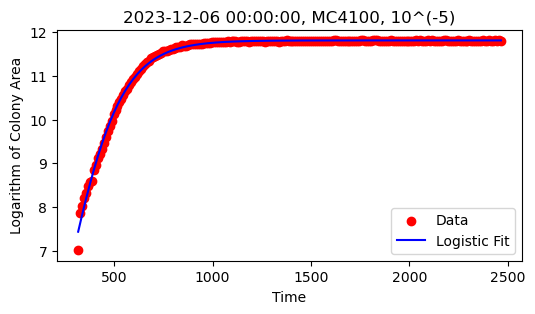

Fitted parameters [A, mu_m, lambda]: [ 1.18154835e+01  2.09397799e-02 -4.07984143e+01], idxdf: 103. Area0: 1110.0


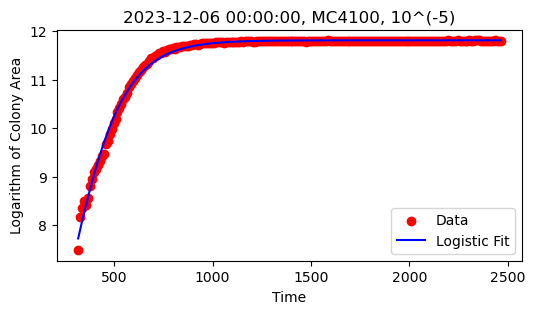

Fitted parameters [A, mu_m, lambda]: [ 1.18135392e+01  2.00191912e-02 -7.30121606e+01], idxdf: 104. Area0: 1779.0


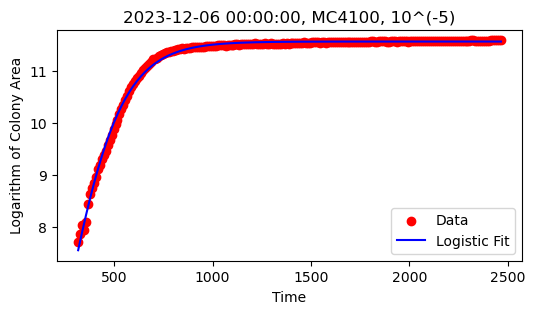

Fitted parameters [A, mu_m, lambda]: [ 1.15684005e+01  1.95530519e-02 -7.29268448e+01], idxdf: 105. Area0: 2205.0


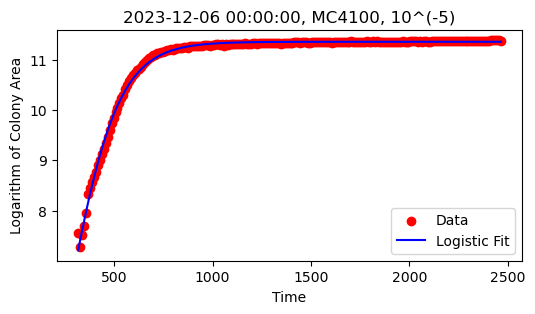

Fitted parameters [A, mu_m, lambda]: [ 11.35903252   0.02157032 -20.20862275], idxdf: 106. Area0: 1902.0


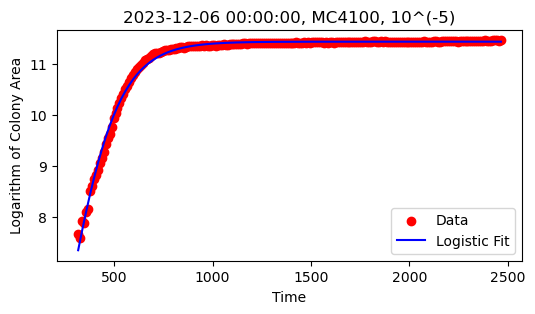

Fitted parameters [A, mu_m, lambda]: [ 1.14465851e+01  2.13727659e-02 -2.94510944e+01], idxdf: 107. Area0: 2121.0


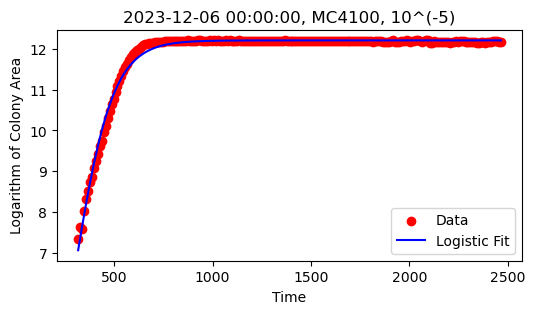

Fitted parameters [A, mu_m, lambda]: [1.22073799e+01 3.02982673e-02 8.25426515e+01], idxdf: 108. Area0: 1542.0


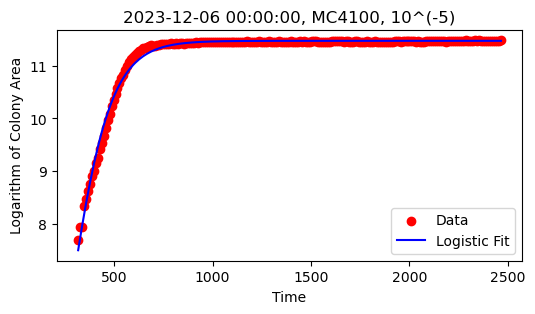

Fitted parameters [A, mu_m, lambda]: [1.14733397e+01 2.60975580e-02 2.64479748e+01], idxdf: 109. Area0: 2188.0


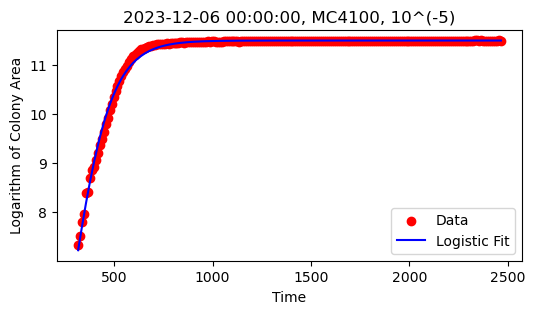

Fitted parameters [A, mu_m, lambda]: [1.14931609e+01 2.73641046e-02 5.11087685e+01], idxdf: 110. Area0: 1527.0


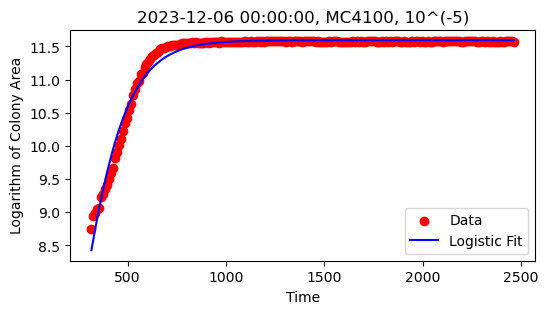

Fitted parameters [A, mu_m, lambda]: [ 1.15938601e+01  2.16558118e-02 -8.27172148e+01], idxdf: 111. Area0: 6332.0


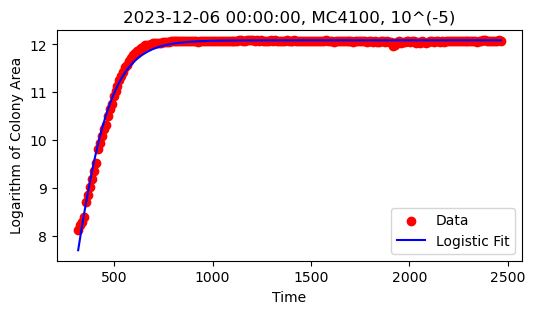

Fitted parameters [A, mu_m, lambda]: [1.20868308e+01 2.86766167e-02 4.61220834e+01], idxdf: 112. Area0: 3370.0


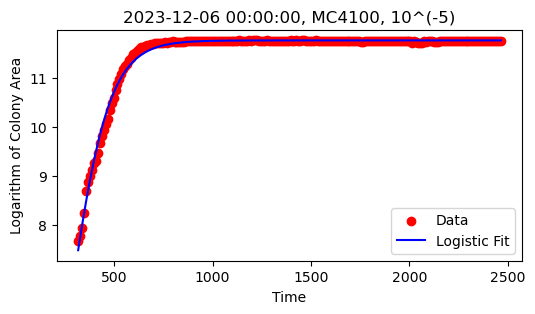

Fitted parameters [A, mu_m, lambda]: [1.17713802e+01 2.84533134e-02 5.15038674e+01], idxdf: 113. Area0: 2157.0


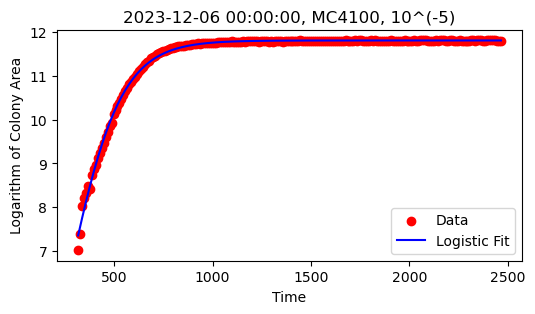

Fitted parameters [A, mu_m, lambda]: [ 1.18143591e+01  2.14497999e-02 -2.82778293e+01], idxdf: 114. Area0: 1114.0


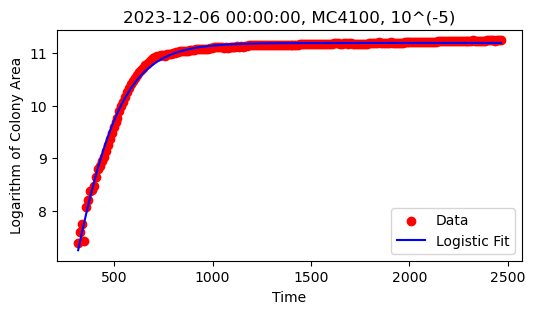

Fitted parameters [A, mu_m, lambda]: [ 1.11945120e+01  1.95333029e-02 -5.78179933e+01], idxdf: 115. Area0: 1605.0


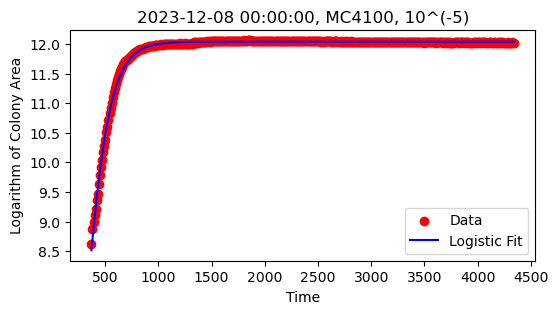

Fitted parameters [A, mu_m, lambda]: [12.03816148  0.02359093  4.24725009], idxdf: 116. Area0: 5578.0


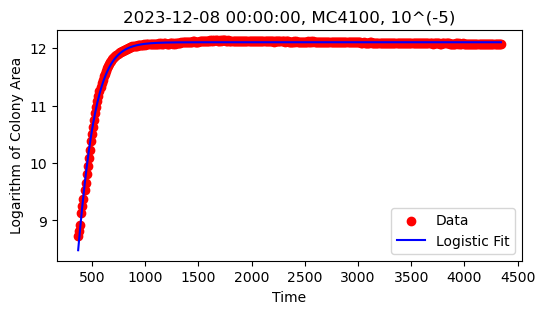

Fitted parameters [A, mu_m, lambda]: [1.21046352e+01 2.52322336e-02 3.01711403e+01], idxdf: 117. Area0: 6123.0


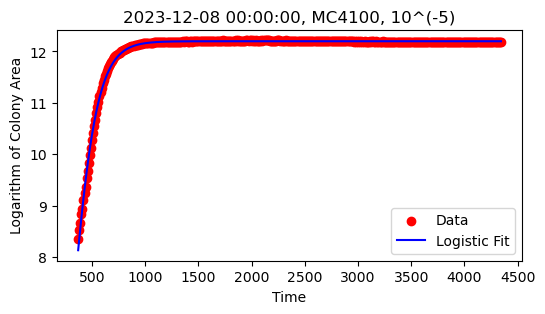

Fitted parameters [A, mu_m, lambda]: [1.21975306e+01 2.45857002e-02 3.77117167e+01], idxdf: 118. Area0: 4235.0


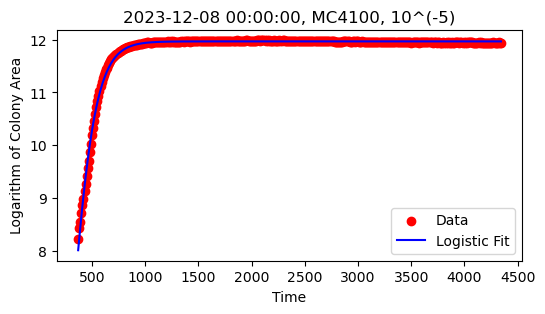

Fitted parameters [A, mu_m, lambda]: [1.19681006e+01 2.53675060e-02 5.30078721e+01], idxdf: 119. Area0: 3724.0


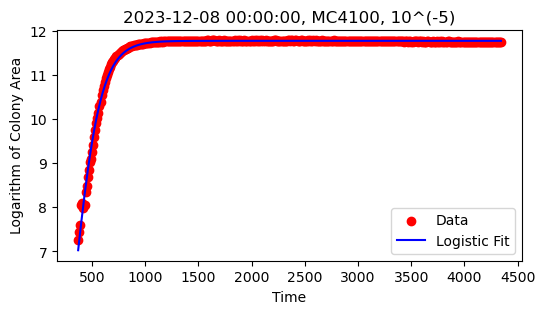

Fitted parameters [A, mu_m, lambda]: [1.17706279e+01 2.30979752e-02 6.70965455e+01], idxdf: 120. Area0: 1409.0


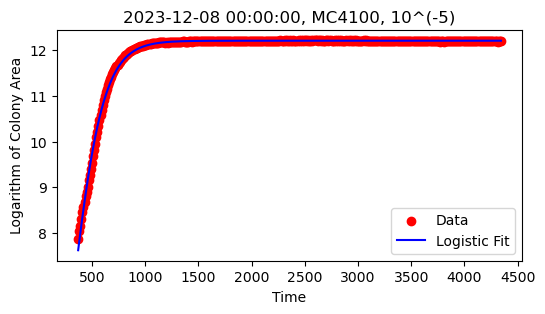

Fitted parameters [A, mu_m, lambda]: [12.21054034  0.02020691 -6.70708837], idxdf: 121. Area0: 2625.0


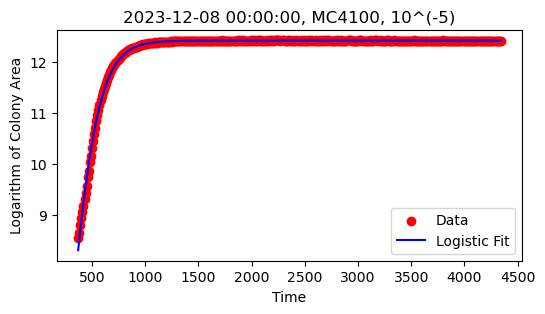

Fitted parameters [A, mu_m, lambda]: [12.41144454  0.02233122 -3.99408898], idxdf: 122. Area0: 5138.0


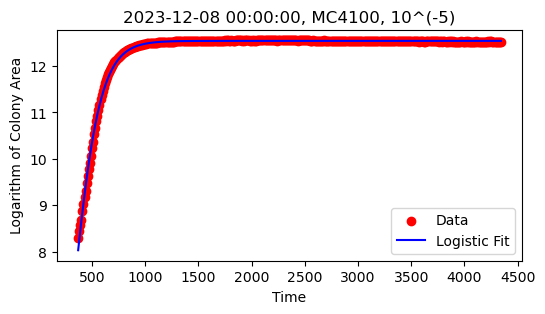

Fitted parameters [A, mu_m, lambda]: [1.25430771e+01 2.35750265e-02 2.93601717e+01], idxdf: 123. Area0: 3973.0


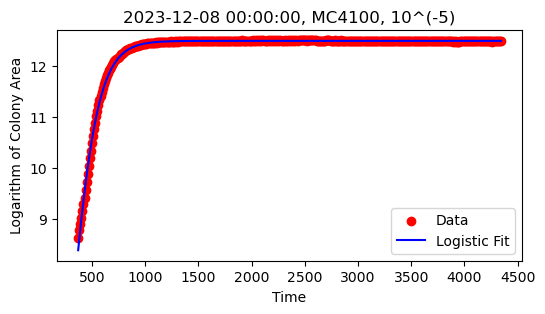

Fitted parameters [A, mu_m, lambda]: [12.48925211  0.02370582 14.51768539], idxdf: 124. Area0: 5582.0


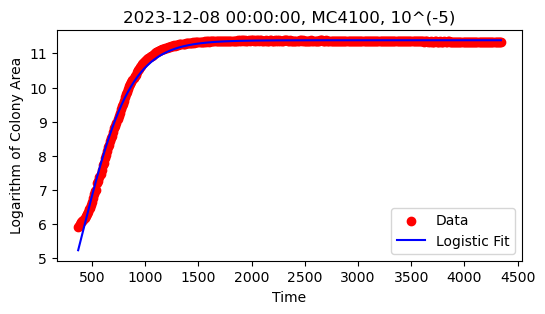

Fitted parameters [A, mu_m, lambda]: [ 1.13853879e+01  1.23952951e-02 -5.05139887e+01], idxdf: 125. Area0: 377.0


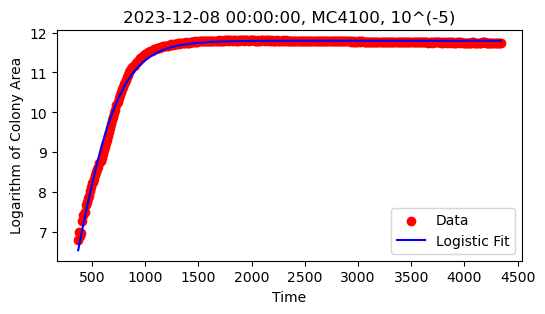

Fitted parameters [A, mu_m, lambda]: [ 1.17947157e+01  1.36680081e-02 -1.07274603e+02], idxdf: 126. Area0: 909.0


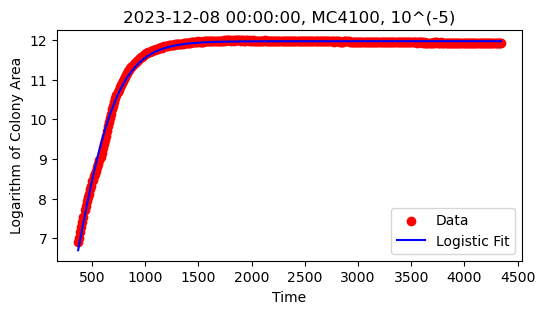

Fitted parameters [A, mu_m, lambda]: [ 1.19657538e+01  1.46341316e-02 -8.57936126e+01], idxdf: 127. Area0: 999.0


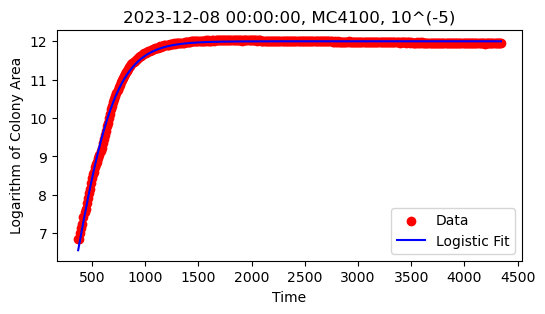

Fitted parameters [A, mu_m, lambda]: [ 1.19994657e+01  1.54598554e-02 -5.23944212e+01], idxdf: 128. Area0: 944.0


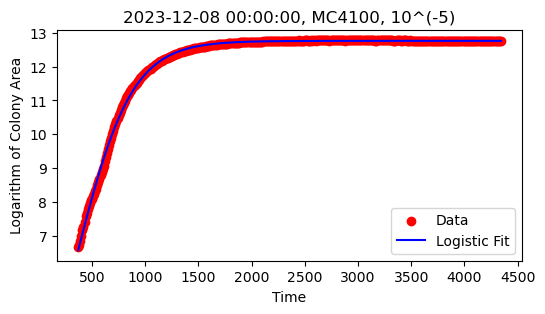

Fitted parameters [A, mu_m, lambda]: [ 1.27591147e+01  1.22432299e-02 -1.65574725e+02], idxdf: 129. Area0: 796.0


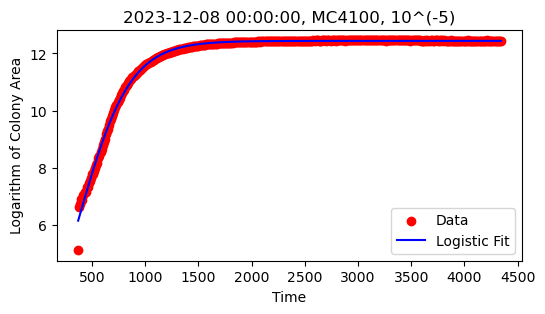

Fitted parameters [A, mu_m, lambda]: [ 1.24410190e+01  1.29417370e-02 -1.02607985e+02], idxdf: 130. Area0: 165.0


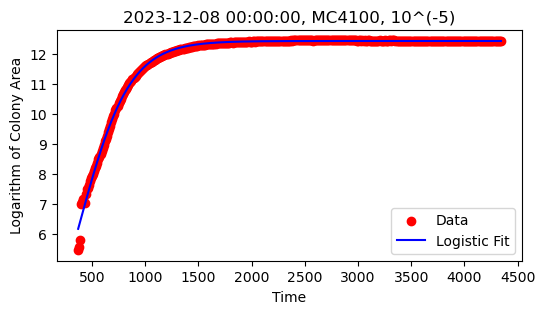

Fitted parameters [A, mu_m, lambda]: [ 1.24365741e+01  1.30633616e-02 -9.93448601e+01], idxdf: 131. Area0: 231.0


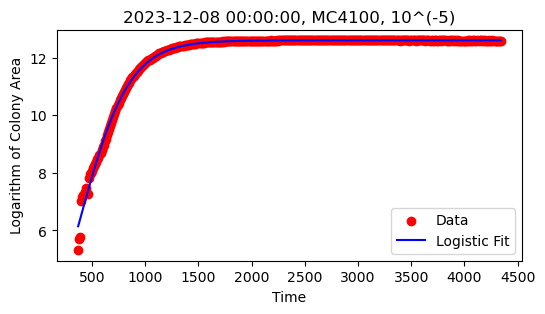

Fitted parameters [A, mu_m, lambda]: [ 1.25981442e+01  1.35094797e-02 -8.29045562e+01], idxdf: 132. Area0: 203.0


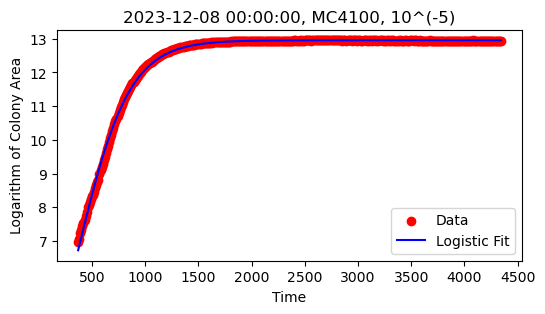

Fitted parameters [A, mu_m, lambda]: [ 1.29569260e+01  1.31212080e-02 -1.40690817e+02], idxdf: 133. Area0: 1074.0


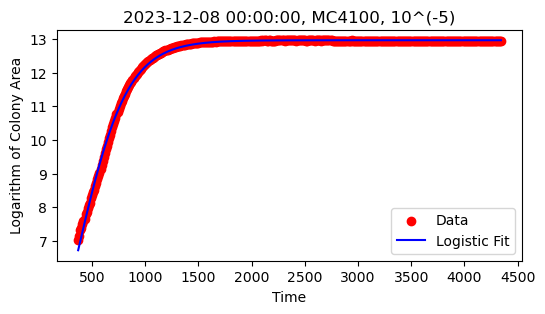

Fitted parameters [A, mu_m, lambda]: [ 1.29654417e+01  1.36965645e-02 -1.18688222e+02], idxdf: 134. Area0: 1137.0


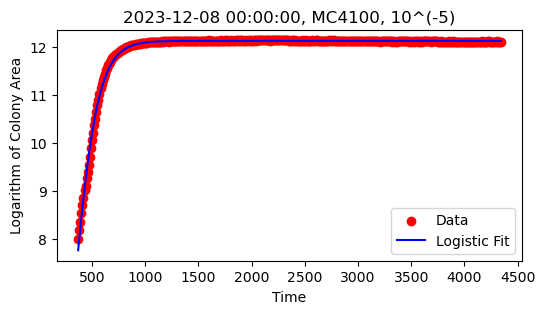

Fitted parameters [A, mu_m, lambda]: [1.21300790e+01 2.54357889e-02 6.48312581e+01], idxdf: 135. Area0: 2952.0


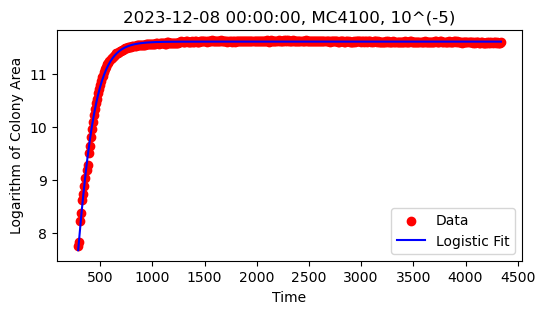

Fitted parameters [A, mu_m, lambda]: [ 11.61436843   0.02573711 -11.90465057], idxdf: 136. Area0: 2346.0


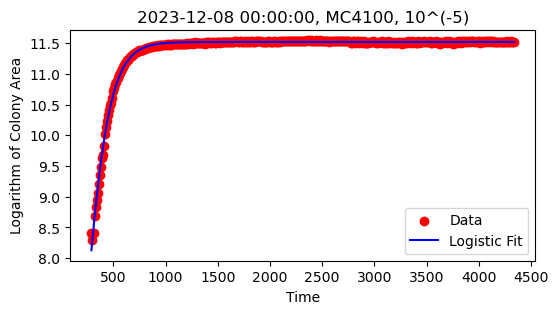

Fitted parameters [A, mu_m, lambda]: [ 1.15204512e+01  2.26231744e-02 -7.68896014e+01], idxdf: 137. Area0: 4505.0


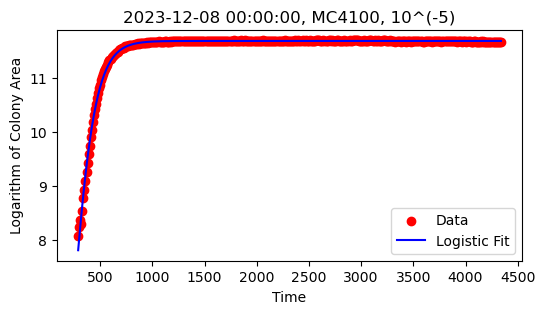

Fitted parameters [A, mu_m, lambda]: [ 11.68607446   0.02548887 -20.85817457], idxdf: 138. Area0: 3222.0


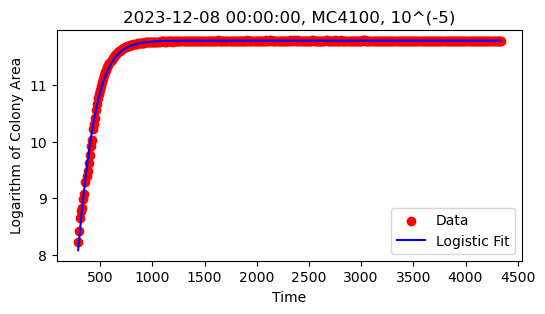

Fitted parameters [A, mu_m, lambda]: [ 1.17832726e+01  2.38263574e-02 -5.46399695e+01], idxdf: 139. Area0: 3737.0


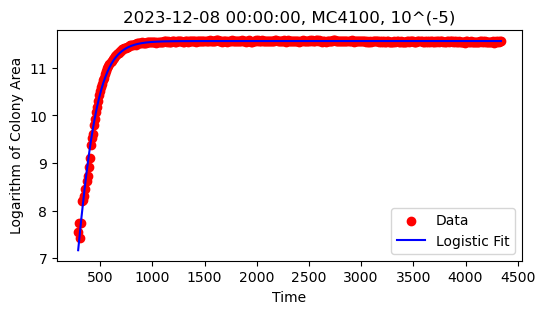

Fitted parameters [A, mu_m, lambda]: [11.56402309  0.02408229 -9.82529181], idxdf: 140. Area0: 1897.0


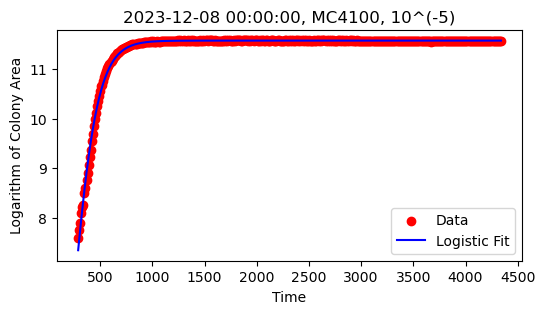

Fitted parameters [A, mu_m, lambda]: [ 11.57352927   0.02369793 -22.7204509 ], idxdf: 141. Area0: 1978.0


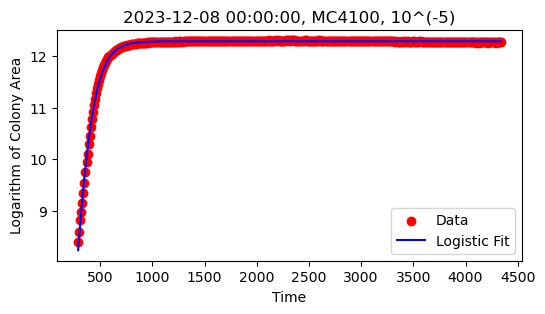

Fitted parameters [A, mu_m, lambda]: [12.28134485  0.02994087 10.86579052], idxdf: 142. Area0: 4465.0


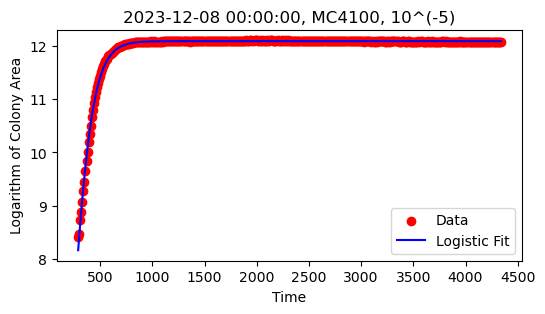

Fitted parameters [A, mu_m, lambda]: [12.08814624  0.02987344 12.55200528], idxdf: 143. Area0: 4480.0


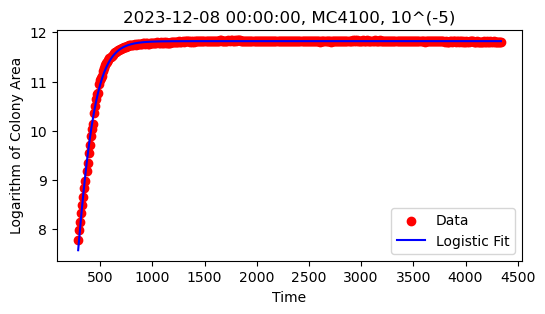

Fitted parameters [A, mu_m, lambda]: [11.82210247  0.02717232  8.57235549], idxdf: 144. Area0: 2401.0


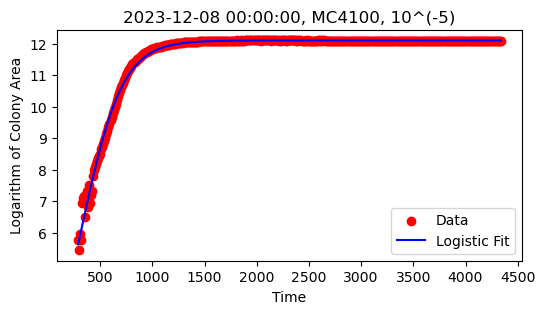

Fitted parameters [A, mu_m, lambda]: [ 1.21070320e+01  1.53352644e-02 -7.82149968e+01], idxdf: 145. Area0: 322.0


/tmp/ipykernel_1223843/2084141370.py:17: RuntimeWarning: divide by zero encountered in log
  params, cov = curve_fit(logistic, time_points, np.log(area), p0, maxfev=10000)#, bounds=([1, 0, 0], [np.inf, np.inf, np.inf]), max_nfev=10000)
/tmp/ipykernel_1223843/2084141370.py:20: RuntimeWarning: divide by zero encountered in log
  idx = np.where(np.isfinite(np.log(area)))[0]
/tmp/ipykernel_1223843/2084141370.py:22: RuntimeWarning: divide by zero encountered in log
  params, cov = curve_fit(logistic, time_points[idx], np.log(area)[idx], p0, maxfev=10000)#, bounds=([1, 0, 0], [np.inf, np.inf, np.inf]), max_nfev=10000)
/tmp/ipykernel_1223843/2084141370.py:25: RuntimeWarning: divide by zero encountered in log
  plt.scatter(time_points, np.log(area), color='red', label='Data')


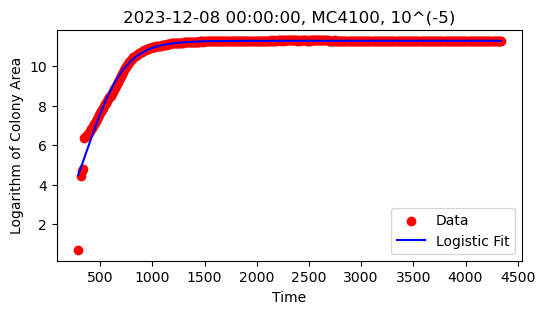

Fitted parameters [A, mu_m, lambda]: [11.27602709  0.0151615  -5.7449445 ], idxdf: 146. Area0: 2.0


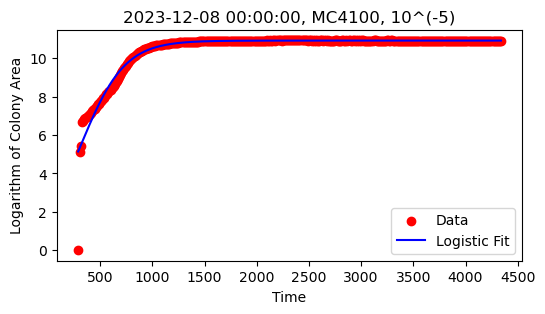

Fitted parameters [A, mu_m, lambda]: [ 1.09216084e+01  1.29707706e-02 -1.07522749e+02], idxdf: 147. Area0: 1.0


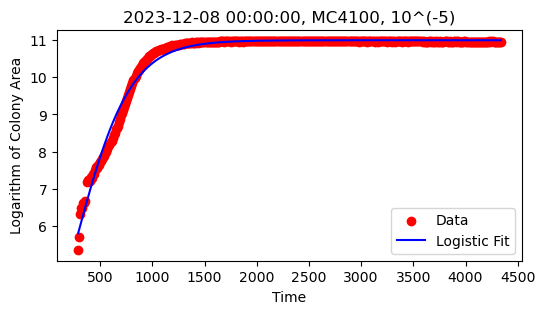

Fitted parameters [A, mu_m, lambda]: [ 1.09925155e+01  1.04716866e-02 -2.65766703e+02], idxdf: 148. Area0: 211.0


/tmp/ipykernel_1223843/2898689656.py:2: RuntimeWarning: overflow encountered in exp
  log_B = A / (1 + np.exp(4 * mu / A * (l - t) + 2))


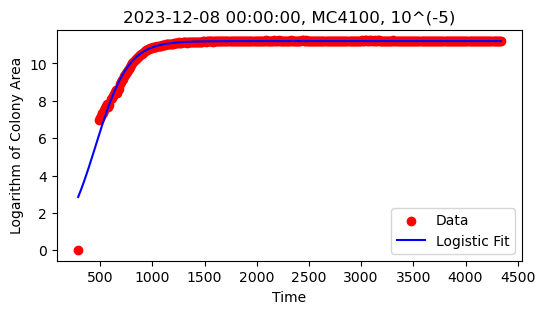

Fitted parameters [A, mu_m, lambda]: [1.11993450e+01 1.79446660e-02 1.44566204e+02], idxdf: 149. Area0: 1.0


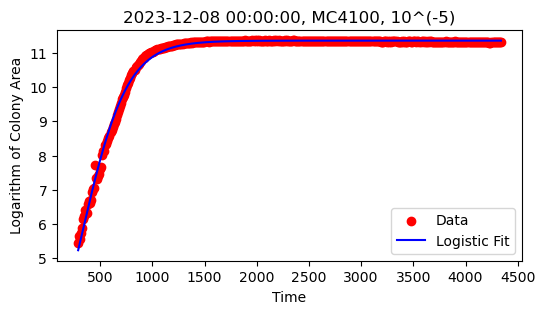

Fitted parameters [A, mu_m, lambda]: [ 1.13654929e+01  1.31202649e-02 -1.09216369e+02], idxdf: 150. Area0: 232.0


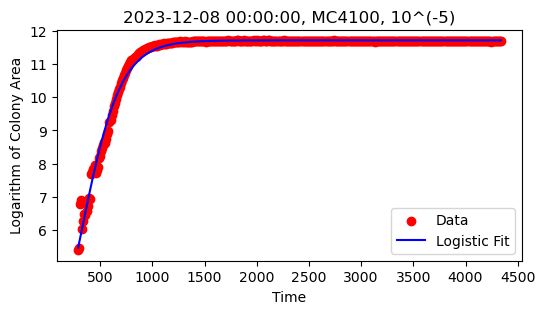

Fitted parameters [A, mu_m, lambda]: [ 1.17068322e+01  1.53886927e-02 -6.67530638e+01], idxdf: 151. Area0: 221.0


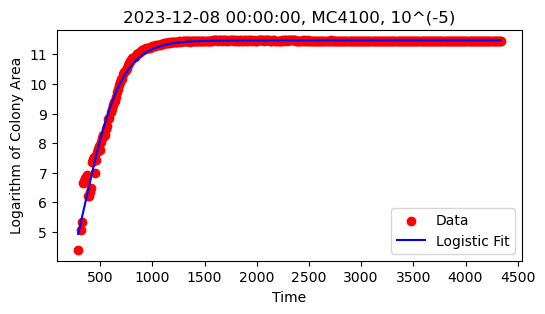

Fitted parameters [A, mu_m, lambda]: [ 1.14740630e+01  1.57981001e-02 -2.28504243e+01], idxdf: 152. Area0: 80.0


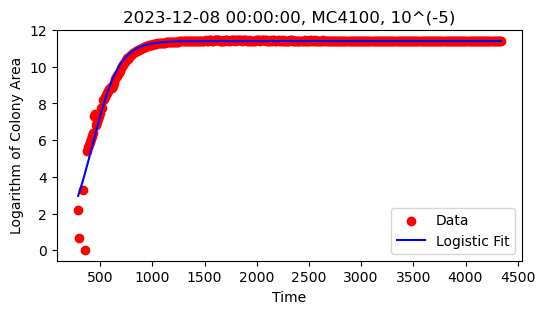

Fitted parameters [A, mu_m, lambda]: [1.14010501e+01 2.20412271e-02 1.65742059e+02], idxdf: 153. Area0: 9.0


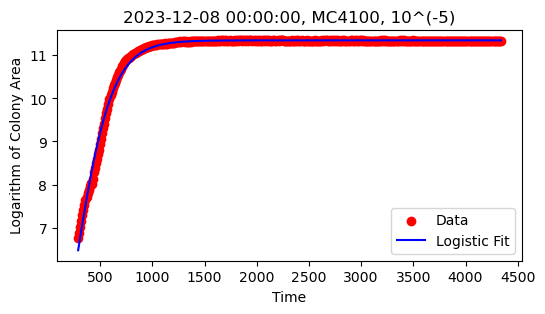

Fitted parameters [A, mu_m, lambda]: [ 1.13473638e+01  1.58006986e-02 -1.21235982e+02], idxdf: 154. Area0: 863.0


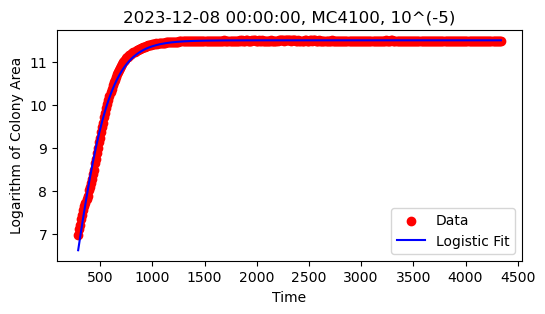

Fitted parameters [A, mu_m, lambda]: [ 1.14941995e+01  1.65855029e-02 -1.10015602e+02], idxdf: 155. Area0: 1061.0


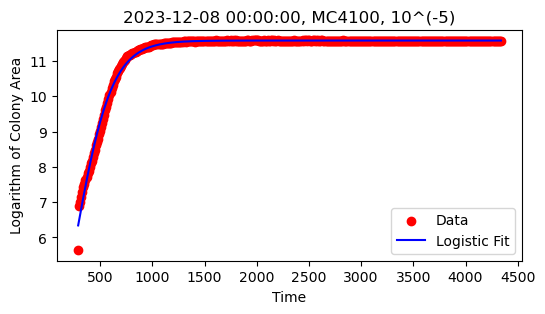

Fitted parameters [A, mu_m, lambda]: [ 1.15763707e+01  1.65004454e-02 -9.53941550e+01], idxdf: 156. Area0: 281.0


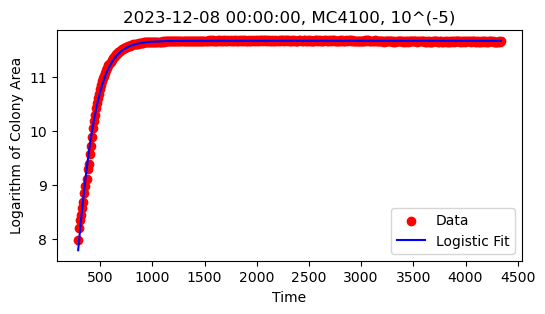

Fitted parameters [A, mu_m, lambda]: [ 1.16742807e+01  2.39850783e-02 -3.89164050e+01], idxdf: 157. Area0: 2907.0


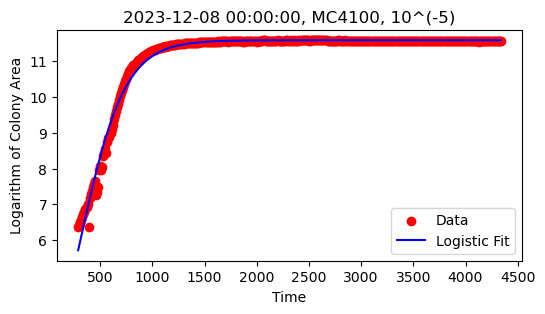

Fitted parameters [A, mu_m, lambda]: [ 1.15857077e+01  1.32452326e-02 -1.42820947e+02], idxdf: 158. Area0: 587.0


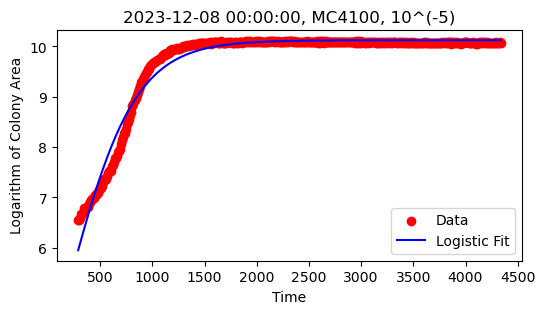

Fitted parameters [A, mu_m, lambda]: [ 1.01231485e+01  7.77460996e-03 -4.77894967e+02], idxdf: 159. Area0: 699.0


In [16]:
for i in df.index.values:
    # Fit the model
    incub_time_s = datetime.strptime(df.loc[i,'t_im'], '%H:%M:%S') - datetime.strptime(df.loc[i,'t_incub'], '%H:%M:%S')
    incub_time_n = incub_time_s.seconds / 60
    area = extract_array(df.loc[i,'area'])
    if area[0] <= 0:
        area[0] = 1
    time_points = np.arange(0, df.loc[i, 'exp length'])*10 + incub_time_n
    #area_end = int(df.loc[i, 'area'])
    
    # these params work with gompertzlog
    #p0=[area[0], area[-1], 1, incub_time_n]
    
    p0=[np.log(area[-1]), 0.1, incub_time_n]
    try:
        #params, cov = curve_fit(gompertzlog, time_points, np.log(area / area[0]), p0, bounds=([area[0], 0, 1e-2, 0], [np.inf, np.inf, np.inf, np.inf]))#, max_nfev=10000)
        params, cov = curve_fit(logistic, time_points, np.log(area), p0, maxfev=10000)#, bounds=([1, 0, 0], [np.inf, np.inf, np.inf]), max_nfev=10000)
    
    except:
        idx = np.where(np.isfinite(np.log(area)))[0]
        #params, cov = curve_fit(gompertzlog, time_points[idx], np.log(area / area[0])[idx], p0, bounds=([area[0], 0, 1e-2, 0], [np.inf, np.inf, np.inf, np.inf]))#, max_nfev=10000)
        params, cov = curve_fit(logistic, time_points[idx], np.log(area)[idx], p0, maxfev=10000)#, bounds=([1, 0, 0], [np.inf, np.inf, np.inf]), max_nfev=10000)
    # Plotting the data and the model to see the fit
    plt.figure(figsize=(6, 3))
    plt.scatter(time_points, np.log(area), color='red', label='Data')
    #plt.plot(time_points, gompertzlog(time_points, *params), label='Gompertz Fit', color='blue')
    plt.plot(time_points, logistic(time_points, *params), label='Logistic Fit', color='blue')
    plt.title(f"{df.loc[i,'Date']}, {df.loc[i,'Strain']}, {df.loc[i,'Dilution']}")
    plt.xlabel('Time')
    plt.ylabel('Logarithm of Colony Area')
    plt.legend()
    plt.show()
    #pars_dict = {'y0': params[0], 'ymax': params[1], 'mu_m': params[2], 'lambda': params[3]}
    pars_dict = {'A': params[0], 'mu_m': params[1], 'lambda': params[2]}
    df.at[i, 'logistic_params'] = json.dumps(pars_dict)
    # Print the fitted parameters
    print(f"Fitted parameters [A, mu_m, lambda]: {params}, idxdf: {i}. Area0: {area[0]}")

#### Inspect Logistic fitting

0 params: [11.291854811467543, 0.025384848369673158, 2.806286128000874]


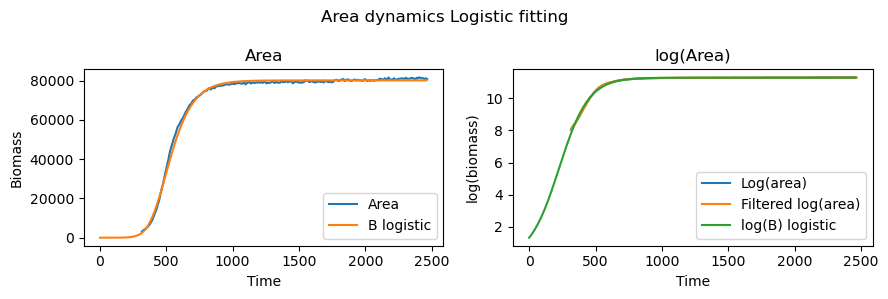

1 params: [11.649139256480966, 0.026836907946944592, -1.406587244663707]


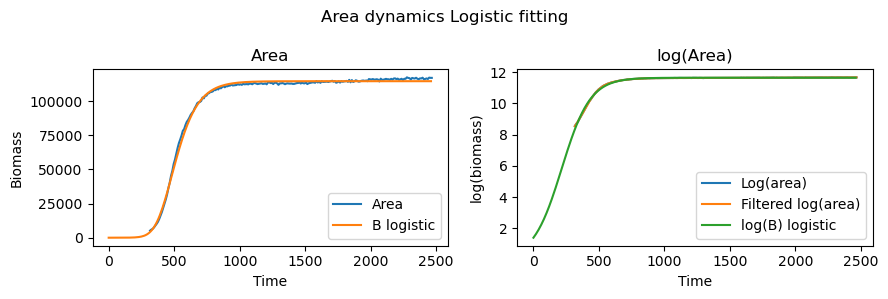

2 params: [11.578378488201757, 0.027017944055282742, -8.915374533416795]


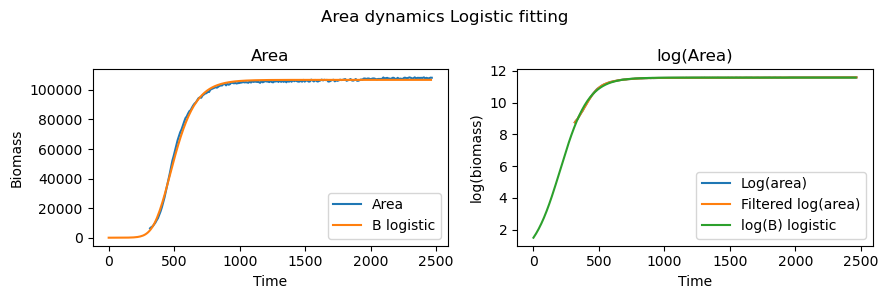

3 params: [11.261690794798985, 0.024723536552972592, -53.05982940116218]


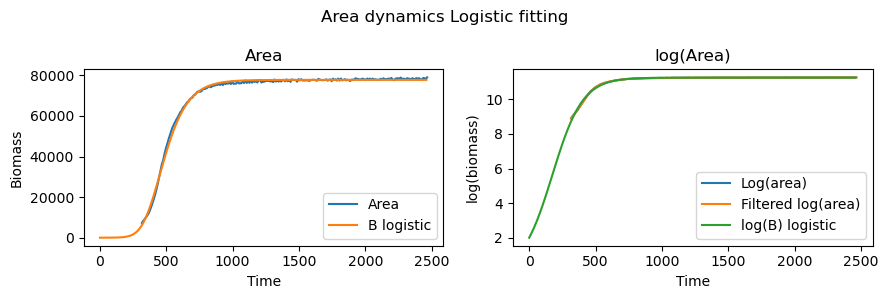

4 params: [11.526236072514887, 0.0275867338101212, 2.664818892536339]


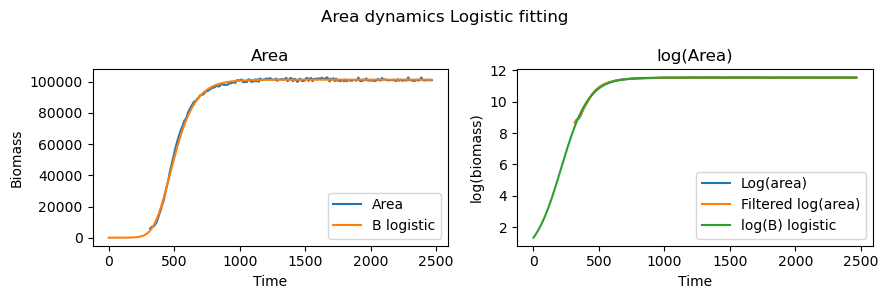

5 params: [11.298719676771755, 0.026436007204334474, 5.537965689818001]


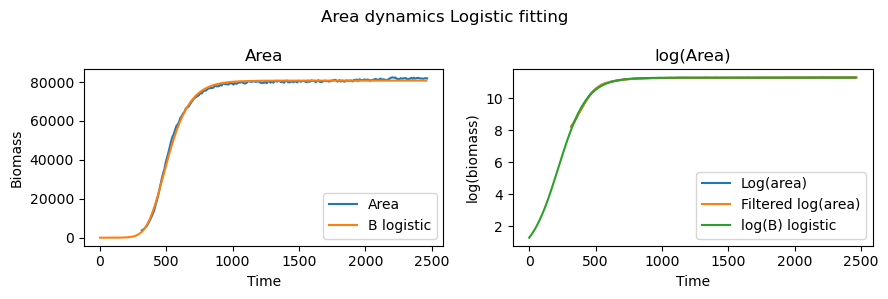

6 params: [10.661943868636204, 0.019602182320773143, -51.213732233193944]


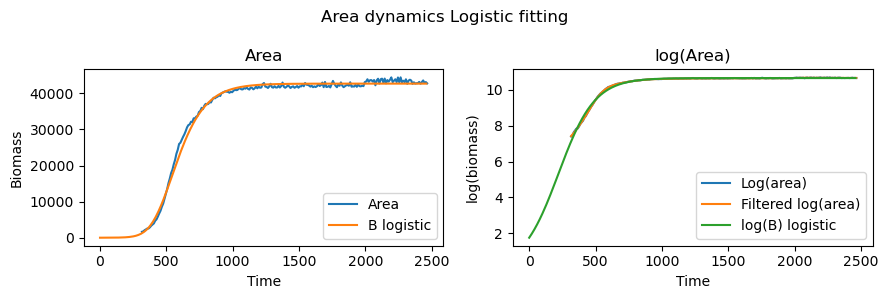

7 params: [10.19548889329514, 0.017262392470643317, -61.016326678182665]


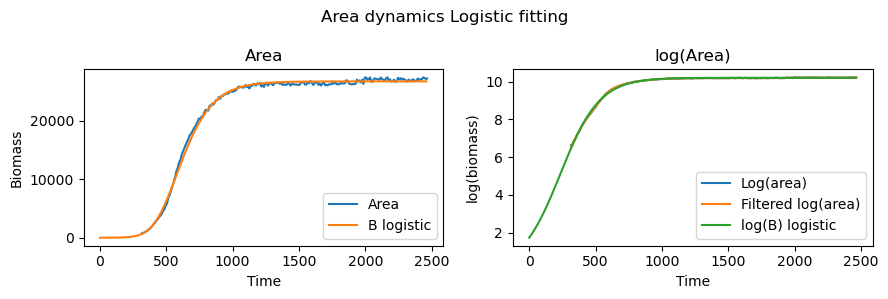

8 params: [11.630606753110914, 0.027308265177400377, 3.9466867342473058]


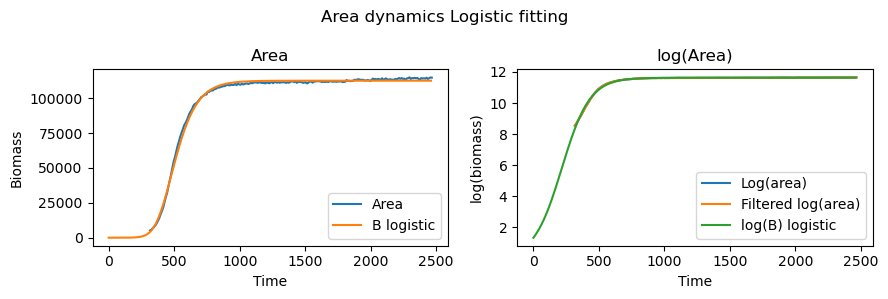

9 params: [13.01517306942499, 0.02186011416294319, -75.23772089796334]


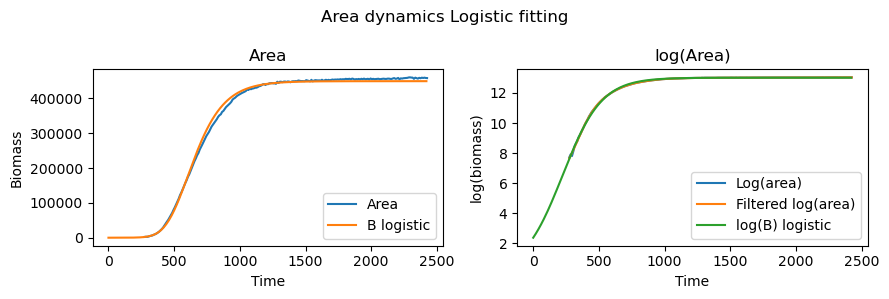

10 params: [12.843705914475668, 0.022671683866897115, -13.878804347807494]


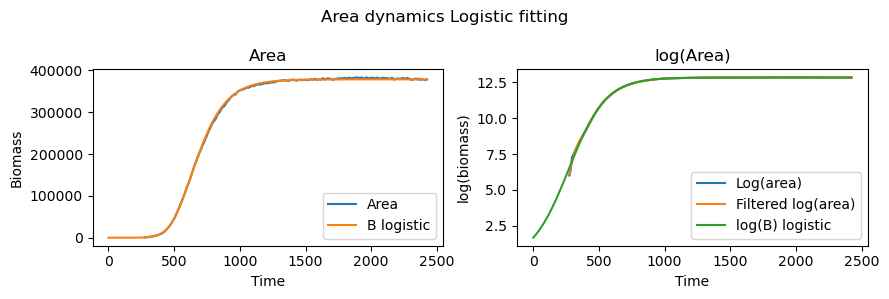

11 params: [12.45863373873703, 0.02125798886632276, -54.13150760318825]


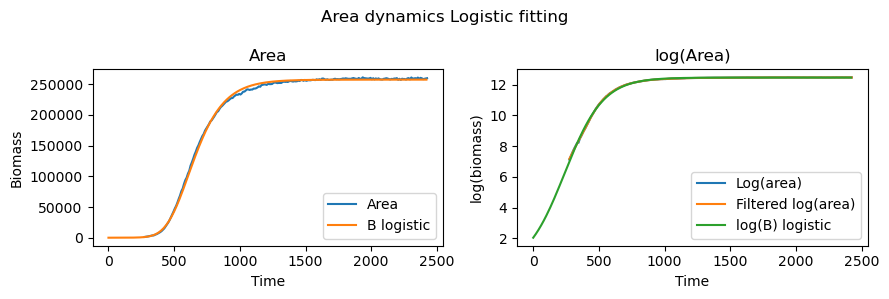

12 params: [12.299328432796369, 0.019463180139362393, -135.35396899887954]


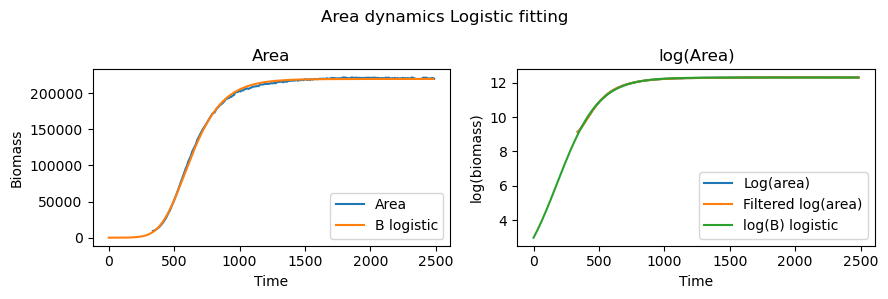

13 params: [12.570176543789994, 0.02165479697637475, -108.22430036414706]


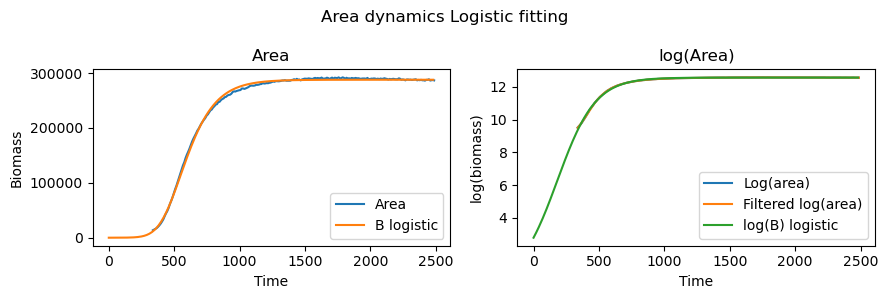

14 params: [12.701104319361956, 0.021703836323175404, -115.47968794315135]


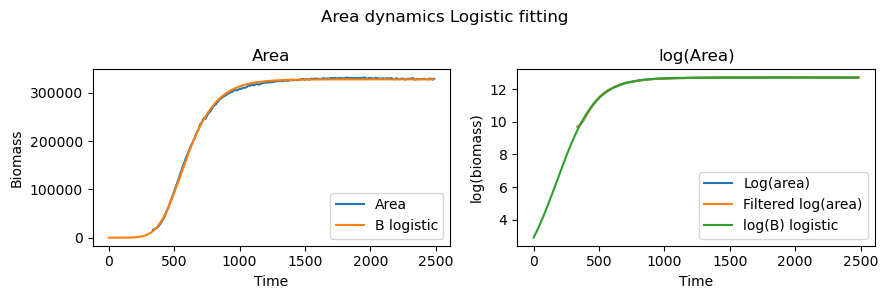

15 params: [12.492396084529142, 0.019734854021382156, -128.2411457973488]


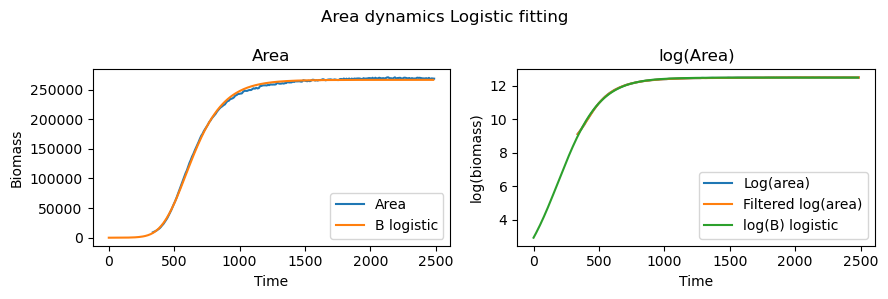

16 params: [12.518791937433146, 0.021688759422179384, -111.64282713117844]


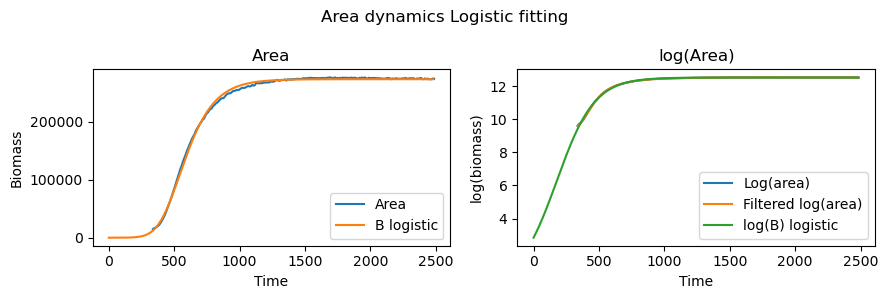

17 params: [12.596097008901333, 0.021260742678315004, -126.0478501850852]


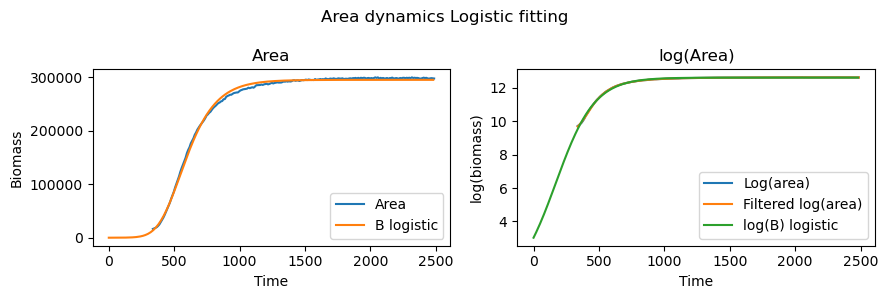

18 params: [13.125041315967616, 0.011353043342710444, -524.0985344046477]


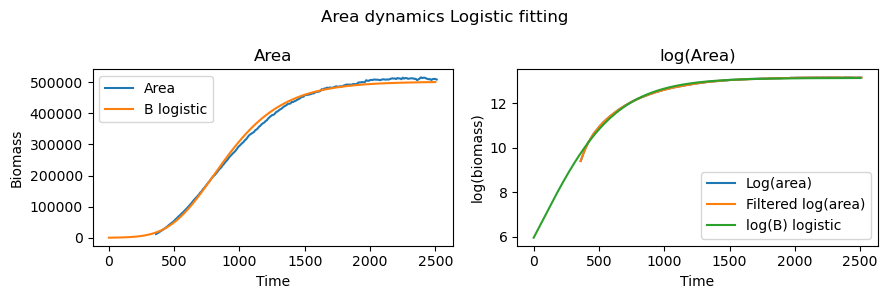

19 params: [12.827134785999307, 0.020955915020279867, -113.0179779370233]


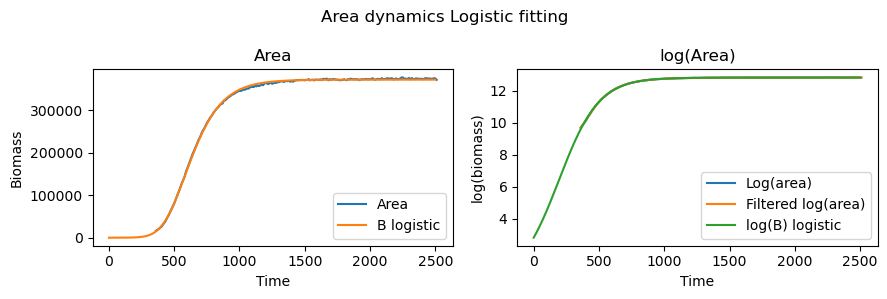

20 params: [13.292621826417054, 0.017259674200504848, -158.2742514496891]


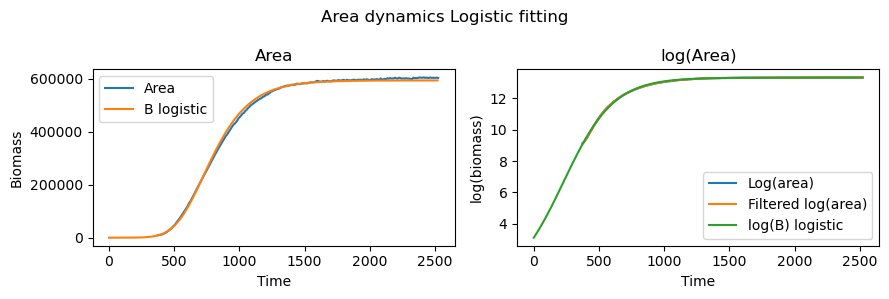

21 params: [13.607746691635604, 0.015075485880008692, -232.45802408218094]


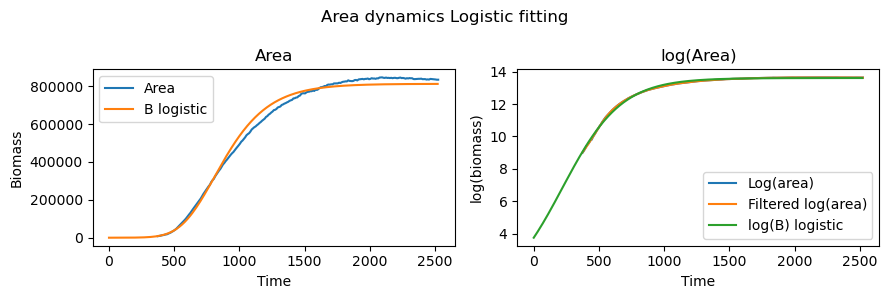

22 params: [13.519541327430463, 0.015313121186163745, -199.8063868633784]


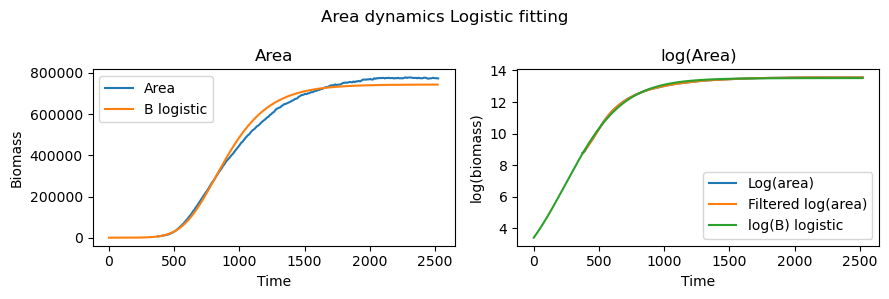

23 params: [11.971346657106377, 0.022463423773167825, 40.53043324495968]


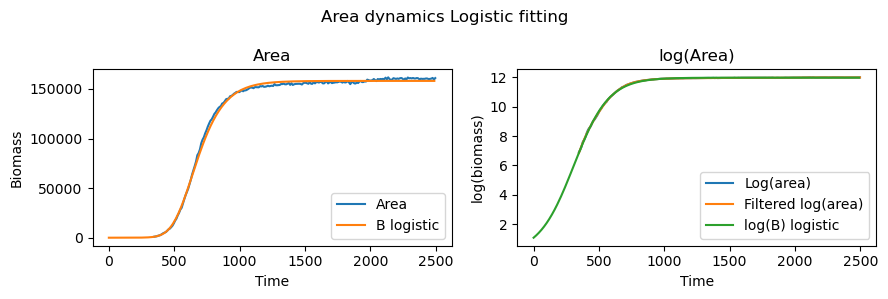

24 params: [11.98212233695737, 0.02277985484126869, 48.56660229143096]


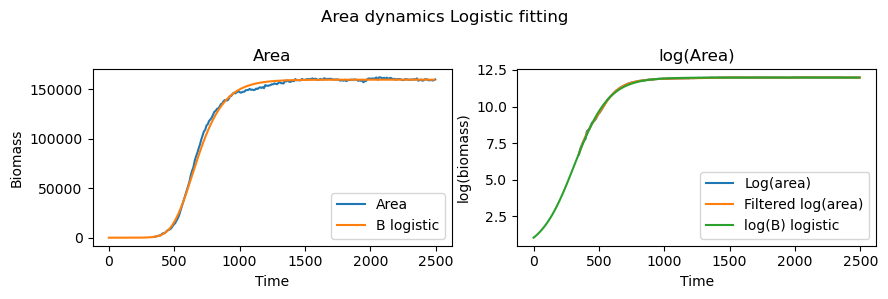

25 params: [12.020327902627931, 0.018593547045783178, -54.9459251092213]


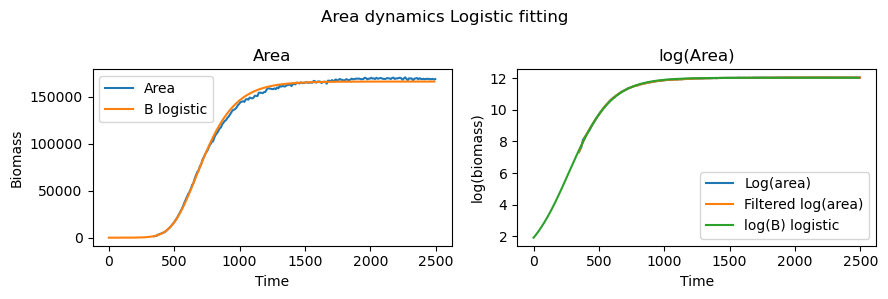

26 params: [12.022768317027326, 0.018041893912596127, -72.04409464451827]


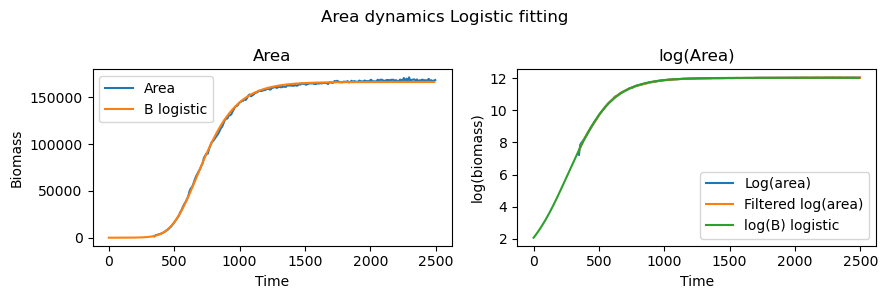

27 params: [12.097523223759474, 0.017232525192126227, -83.21813640773978]


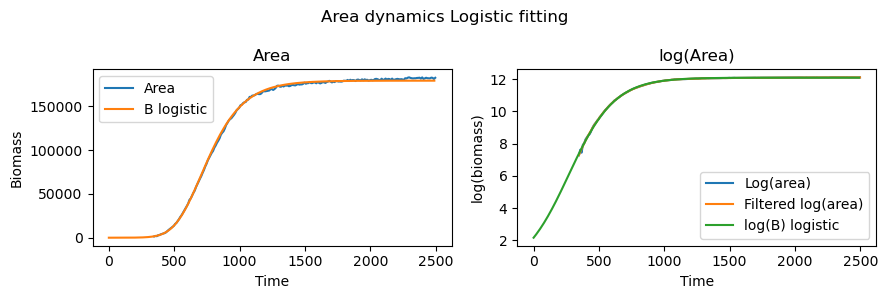

28 params: [12.459810252719173, 0.02128002314933228, -30.9340897476907]


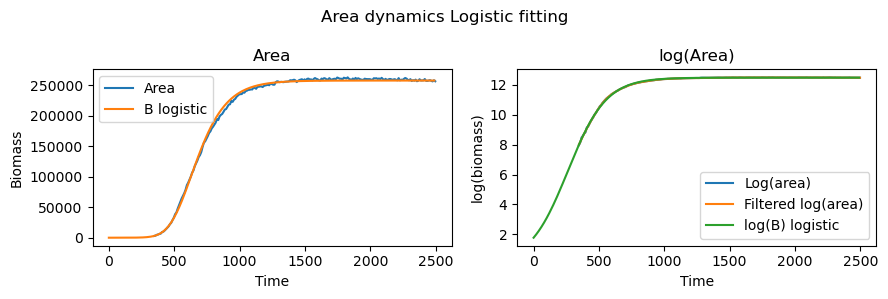

29 params: [12.834145330344956, 0.0205138226640697, -58.602006366157966]


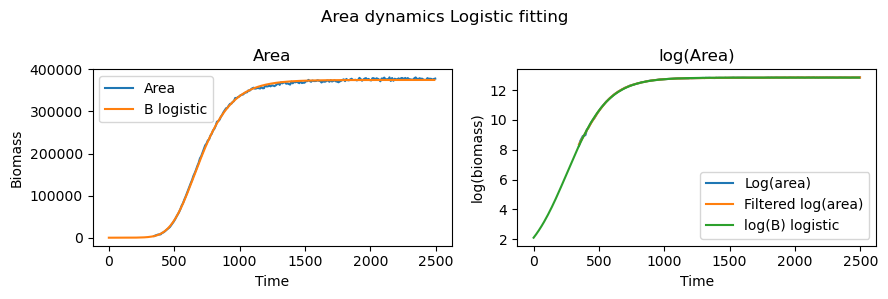

30 params: [11.987490575646845, 0.019046531251653374, -47.0812049634683]


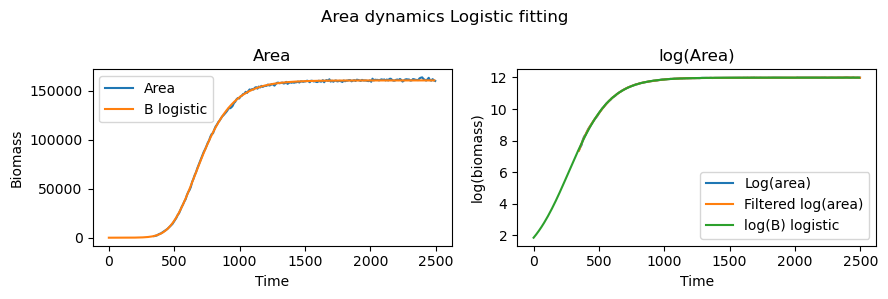

31 params: [12.029862888743782, 0.017420843819225984, -93.77341249351717]


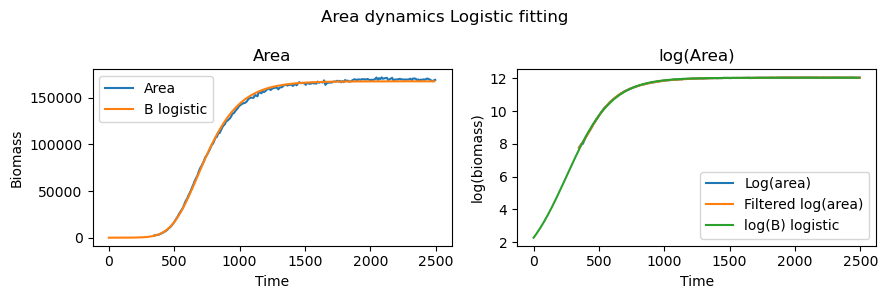

32 params: [12.637854875232351, 0.02167075789805096, -20.78057008312707]


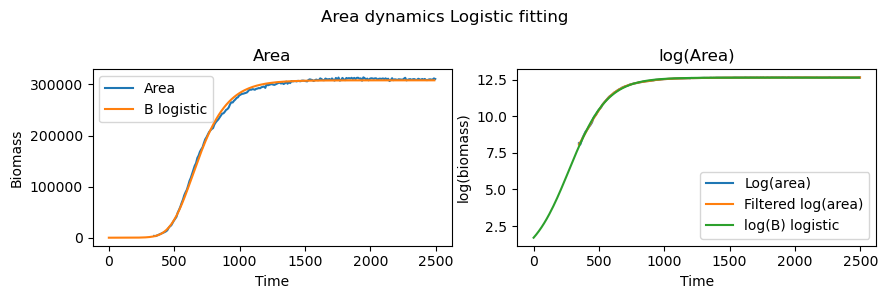

33 params: [11.906808919775195, 0.017306120592438887, -78.28764775238245]


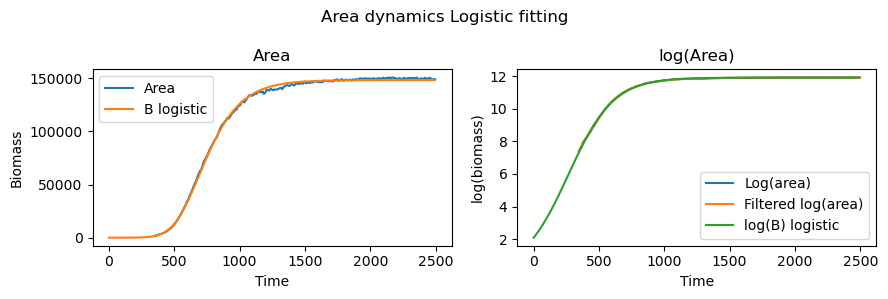

34 params: [13.4532636601978, 0.0197479170428465, -104.46519234119178]


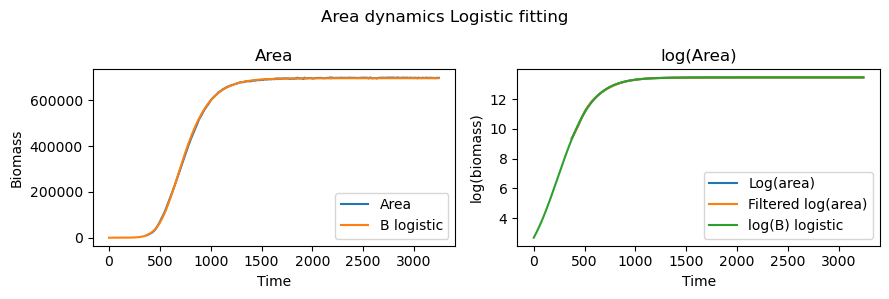

35 params: [13.123283601623239, 0.017869231813805377, -146.31814629083053]


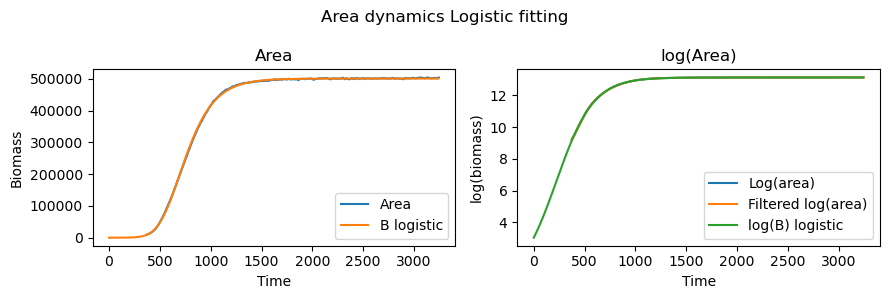

36 params: [13.255762857368266, 0.02359689658847532, 2.2902927594402707]


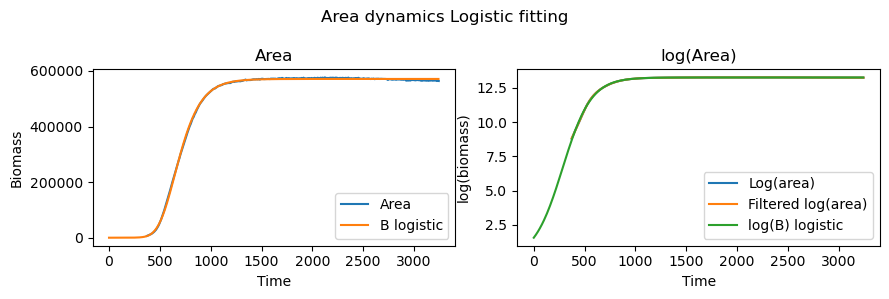

37 params: [13.251648841884723, 0.01805011204702535, -115.99544995007282]


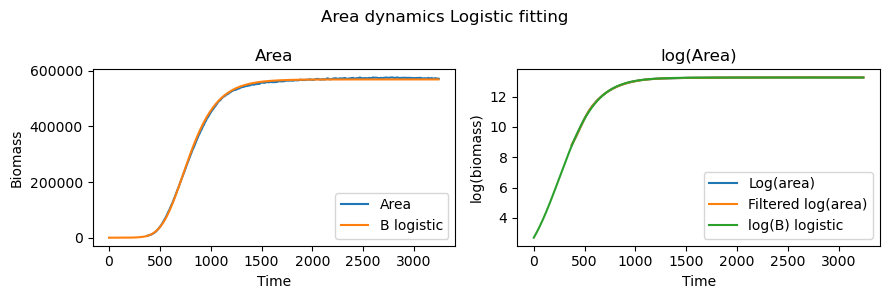

38 params: [12.694251311255993, 0.017692815994064432, -132.47549512410012]


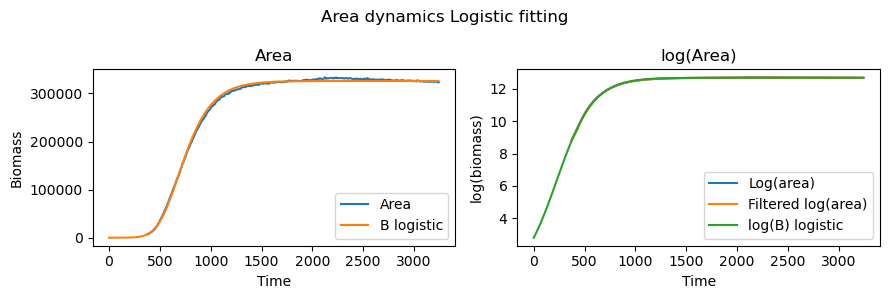

39 params: [13.107689090044127, 0.019646165237737236, -95.86924314756207]


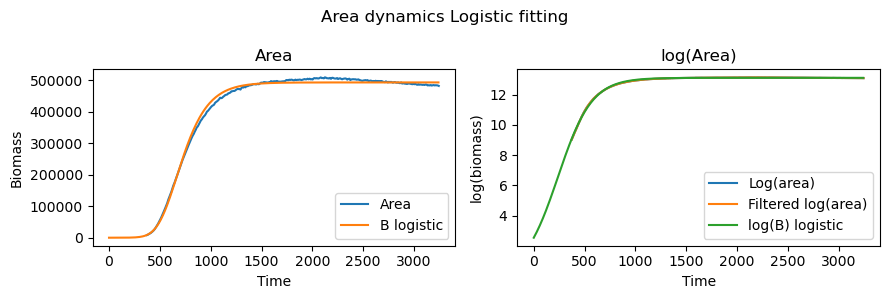

40 params: [13.384891383334612, 0.013428628110396799, -84.36604355463716]


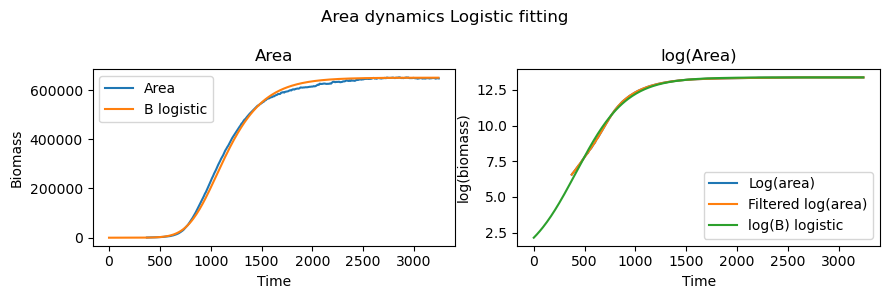

41 params: [11.235597663325715, 0.02482534708264974, 3.538731163109897]


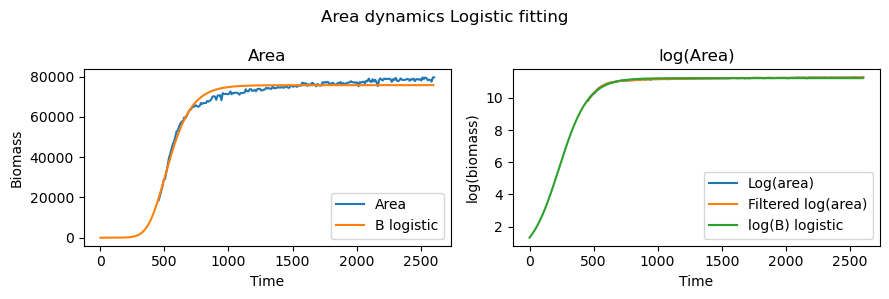

42 params: [11.364949138901626, 0.02570911423727819, 10.42070585368556]


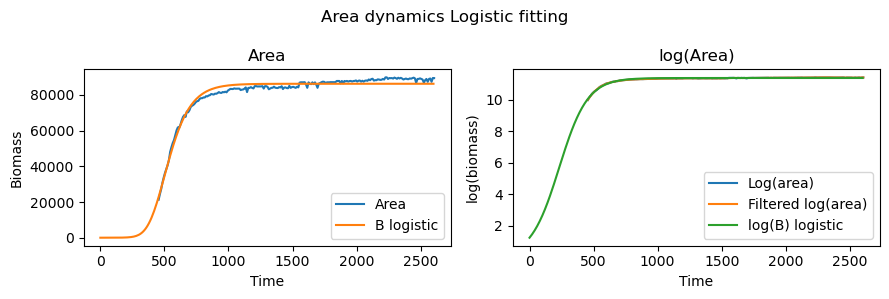

43 params: [10.897067299893418, 0.020767210632260086, -42.445213833388756]


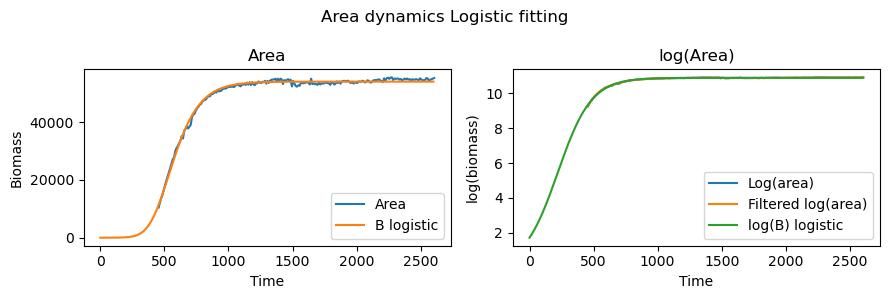

44 params: [10.808724895106952, 0.017317944523739512, -133.7534400452502]


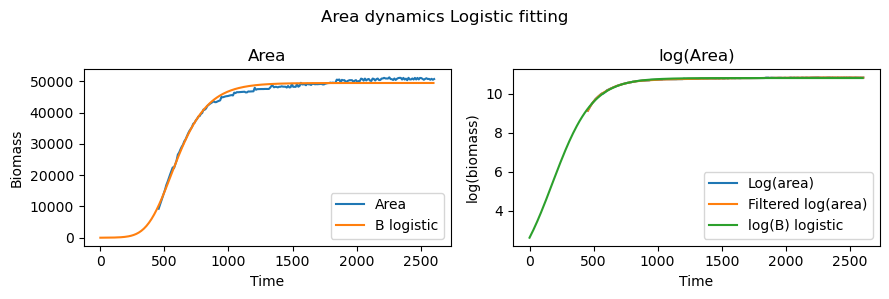

45 params: [10.723475394627037, 0.01942906230317999, -55.48889440971053]


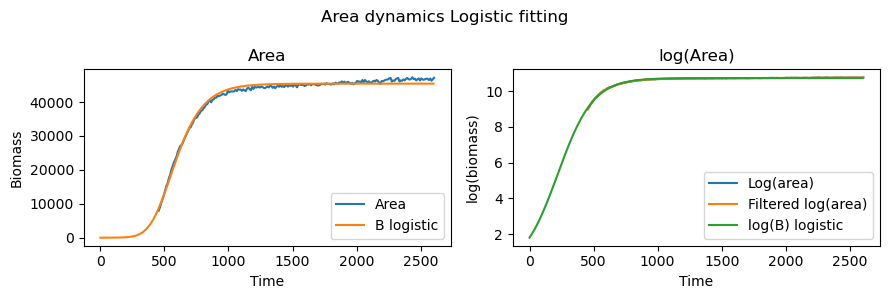

46 params: [10.761746440994186, 0.02051704108152017, -15.70210745972844]


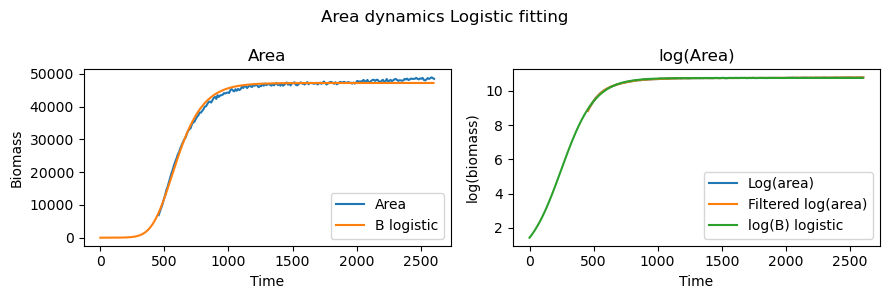

47 params: [10.811907465911762, 0.020142353975503118, -38.21856385459463]


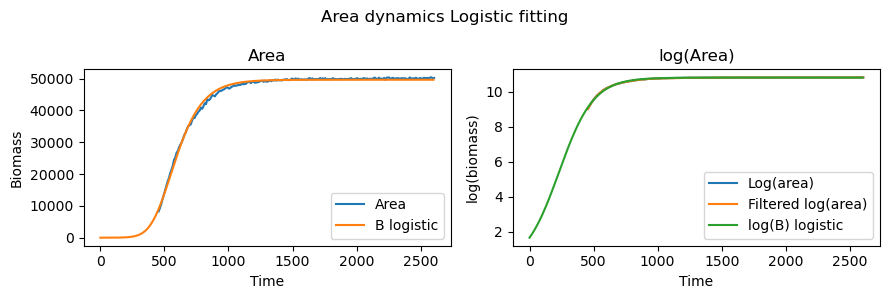

48 params: [10.972964369996136, 0.02655114677005191, 91.06856057134088]


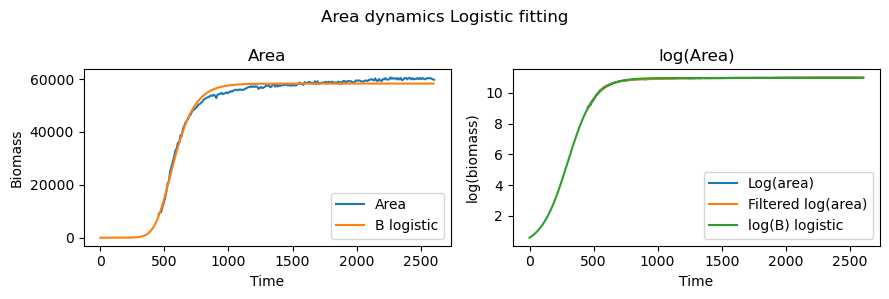

49 params: [11.223493403884712, 0.025518716032865218, 46.06871122175777]


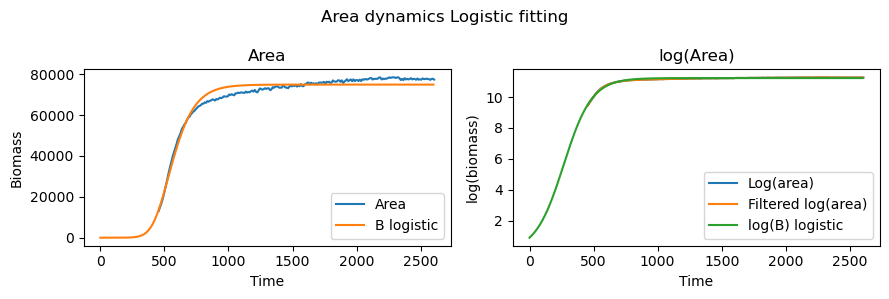

50 params: [11.240687022661694, 0.0289307272037272, 112.08872287153228]


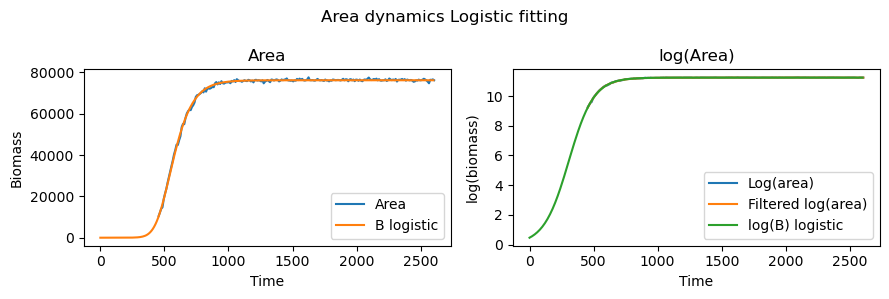

51 params: [11.36871048539643, 0.02541271526693484, 3.3527602523792566]


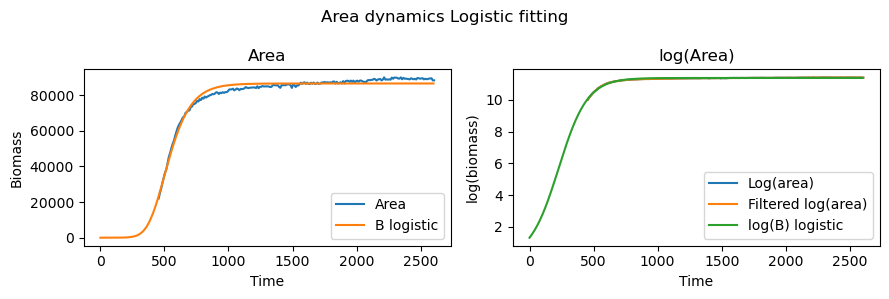

52 params: [10.134730382615267, 0.020882804637686048, 36.53100236586767]


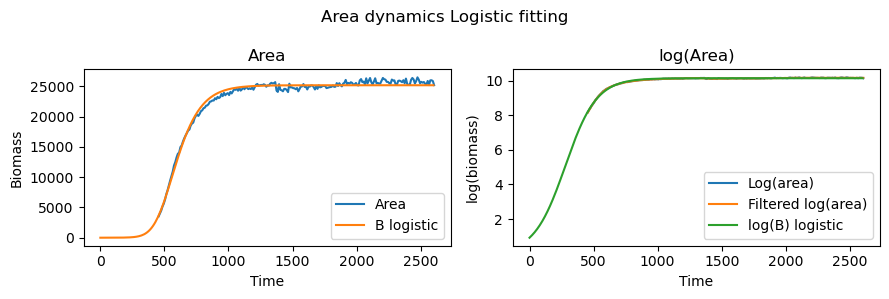

53 params: [10.935956663095174, 0.019679893976916742, -85.49079393048028]


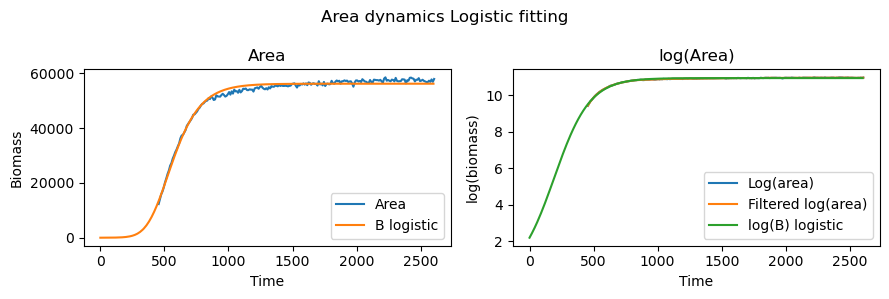

54 params: [10.810017781587248, 0.017409451778163363, -131.1392841087492]


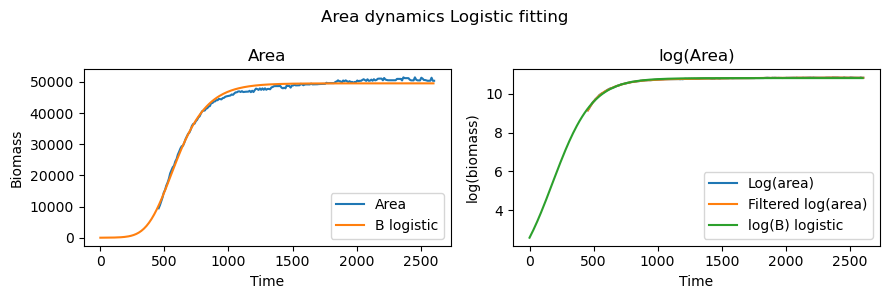

55 params: [10.316014386172856, 0.019151479878391463, -20.250765251958185]


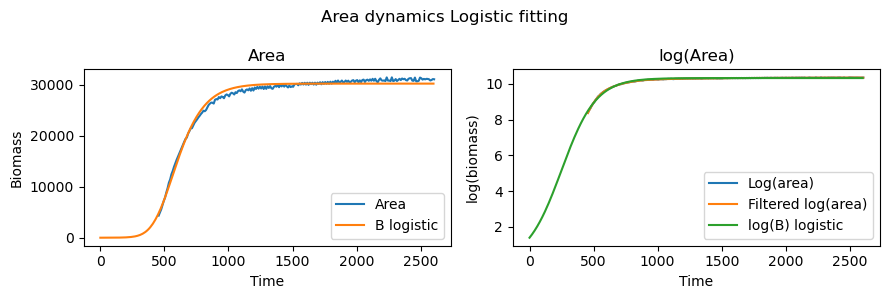

56 params: [12.422398090326942, 0.02340343863315792, 14.413765704624659]


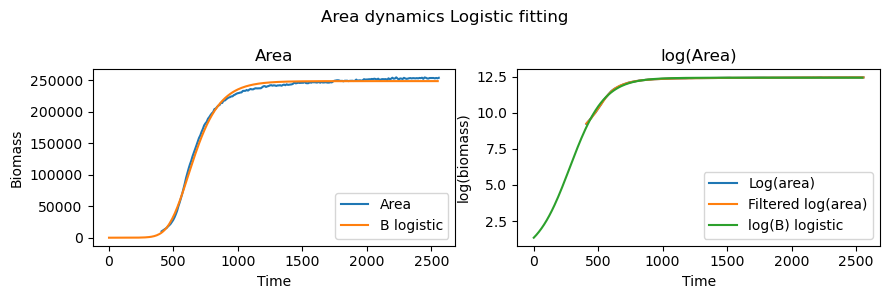

57 params: [12.634391696957515, 0.023138403367255443, -25.751965764216266]


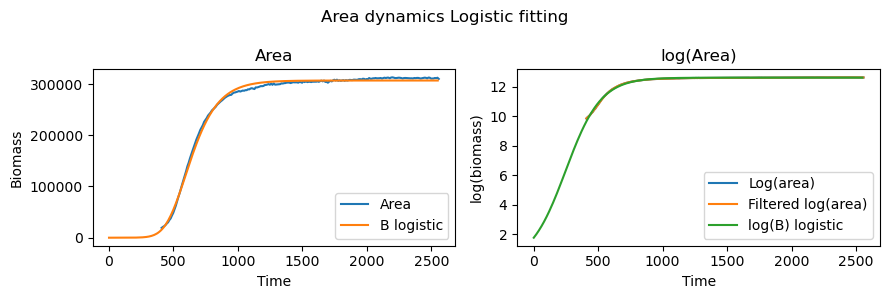

58 params: [12.153468676656106, 0.02326057842920485, 27.36608177250635]


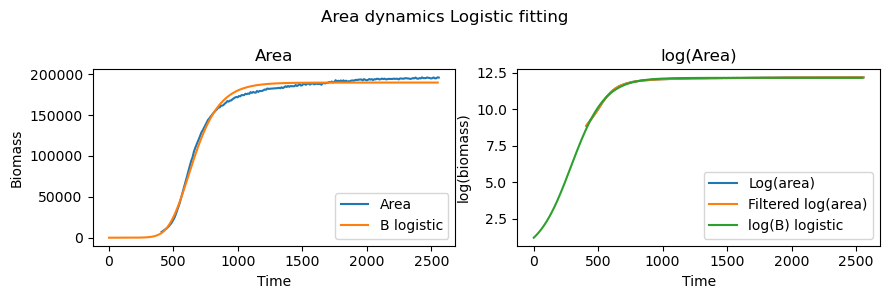

59 params: [12.855945895098506, 0.02563592086947793, 57.242890467969]


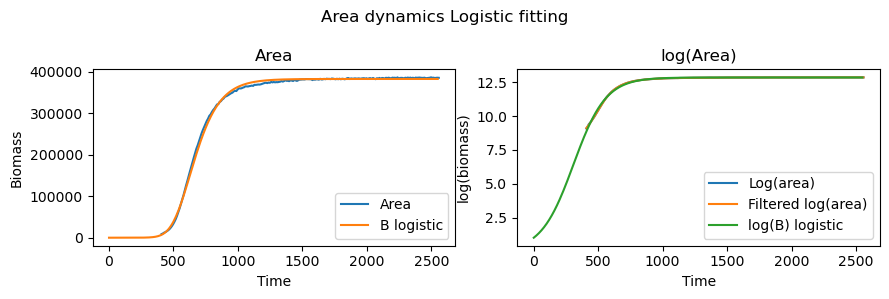

60 params: [12.50970537613161, 0.023237841249210505, 14.11611237919874]


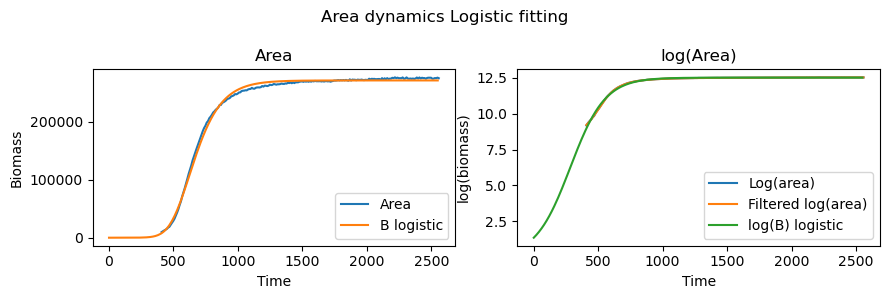

61 params: [12.318496465416104, 0.022291015194801953, -15.12051422520215]


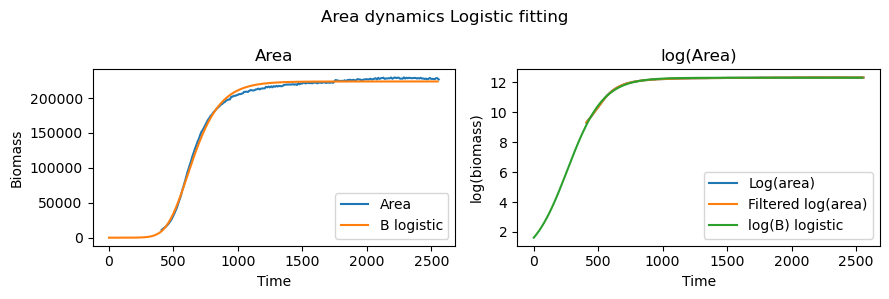

62 params: [12.3744113705664, 0.021069403404796763, -10.744258621600098]


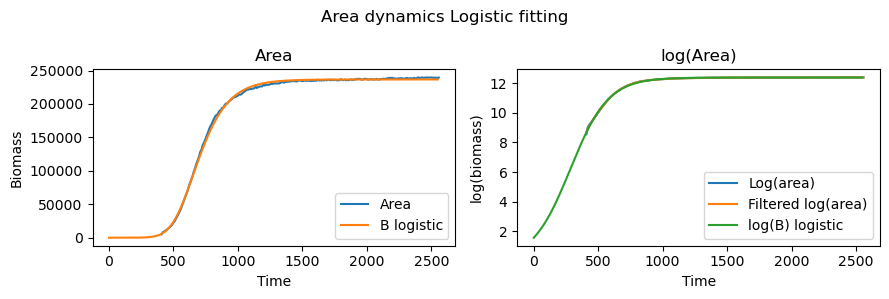

63 params: [12.176786147076372, 0.019969081355932856, -54.19177008007473]


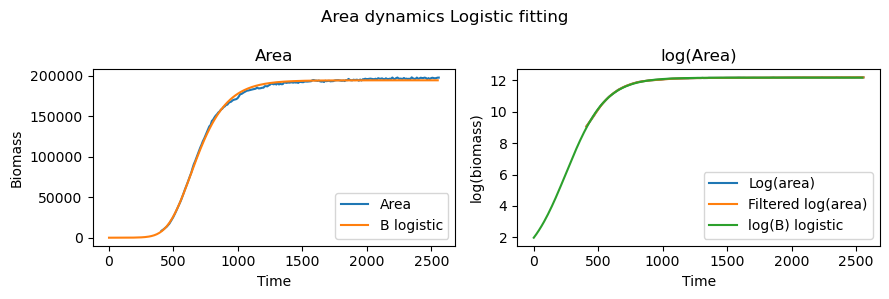

64 params: [12.35131299774589, 0.019588337643176745, -58.12351867621416]


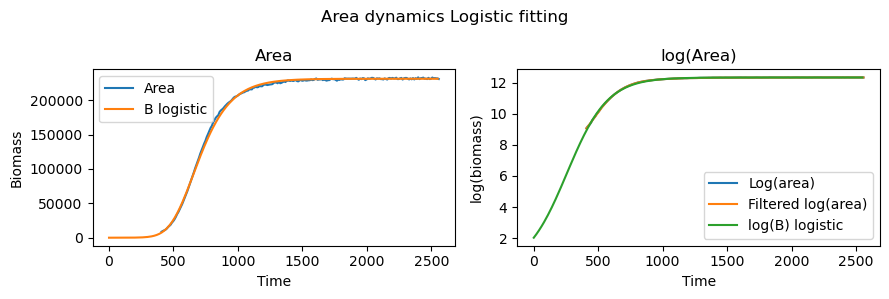

65 params: [12.5194815324133, 0.021286842436884054, -15.34011359709582]


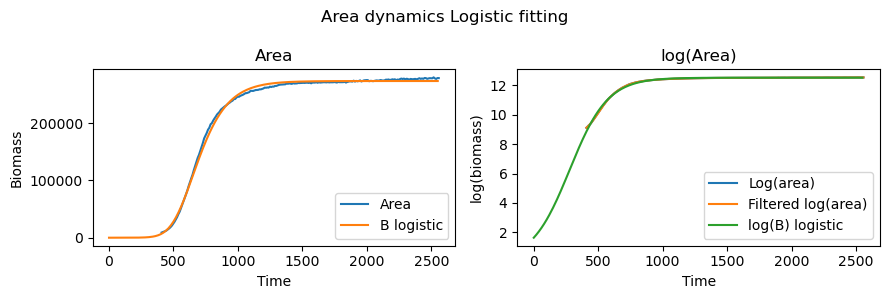

66 params: [12.370200080748505, 0.020763751383993573, -19.39729514210202]


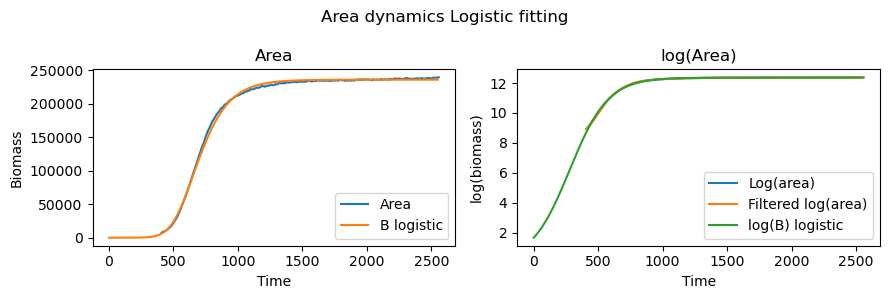

67 params: [12.730337609720658, 0.016651974399861616, -112.23009563909365]


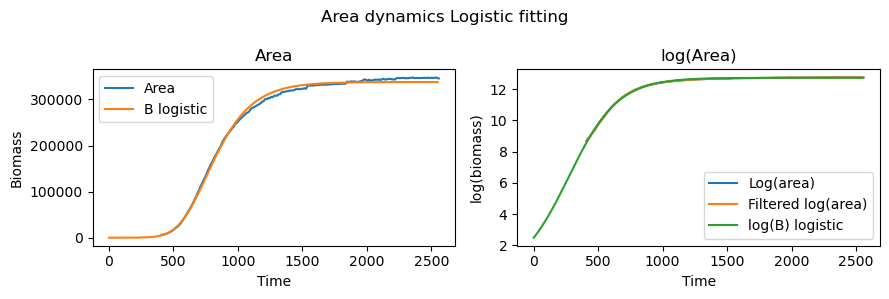

68 params: [12.410275592797298, 0.016497663658329657, -128.68723279441957]


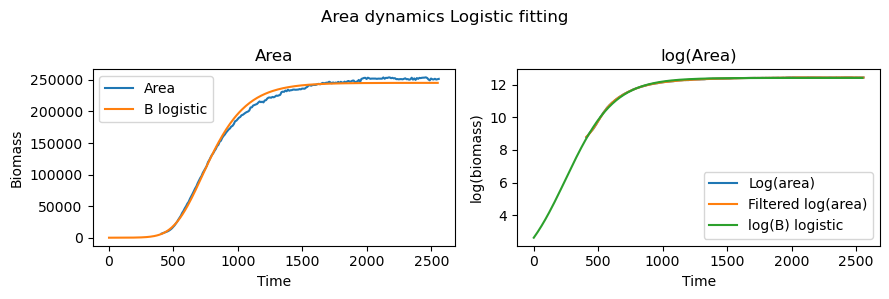

69 params: [12.561523692156308, 0.017020809623430878, -88.37691374957932]


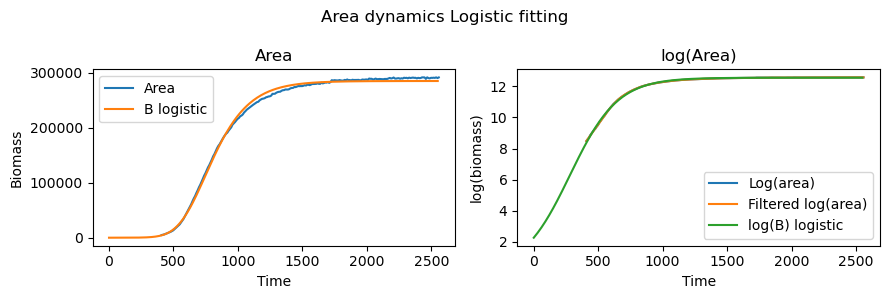

70 params: [12.59509616525908, 0.0171970223922109, -92.35830272401478]


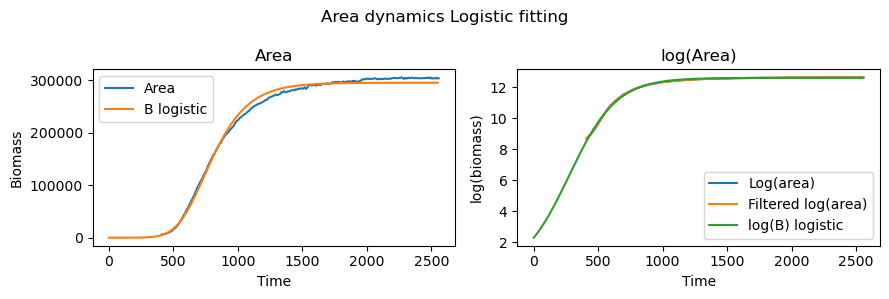

71 params: [11.659143845914958, 0.024202931372360414, 0.217419994731209]


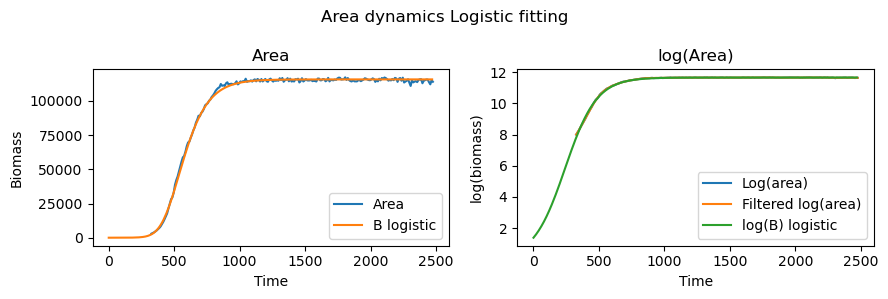

72 params: [11.643482633100312, 0.02349326648065565, -4.9138349524665585]


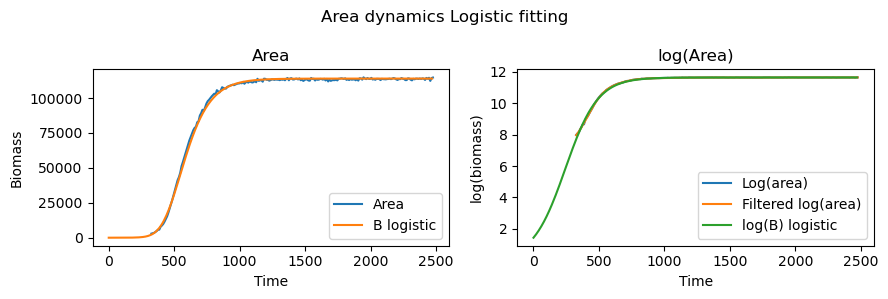

73 params: [11.901291703216895, 0.024196056787662866, 32.66872277182563]


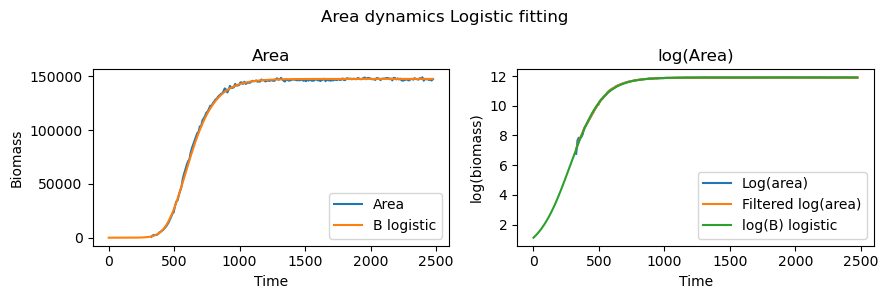

74 params: [11.850794963412408, 0.023949423264321975, 16.904406430787926]


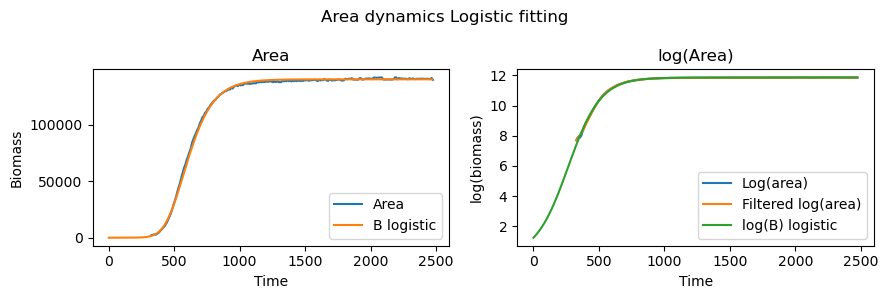

75 params: [12.111255282006086, 0.02494159510762695, 14.201295279414603]


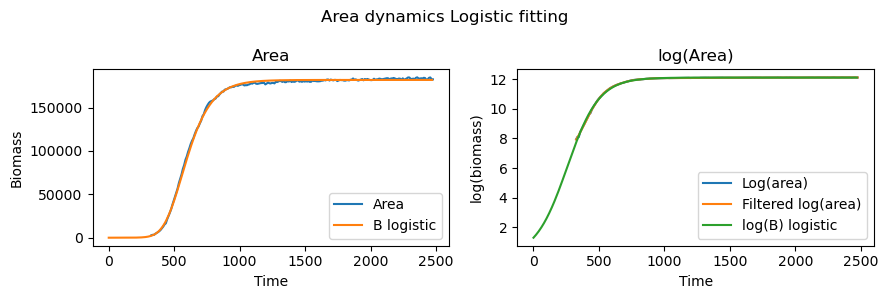

76 params: [12.223857250596671, 0.025115478774170905, 17.76097742368021]


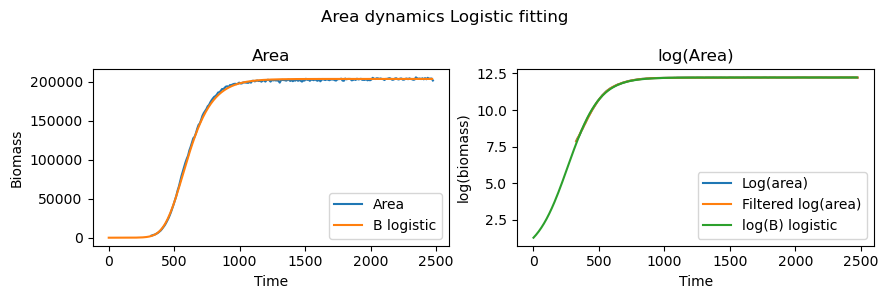

77 params: [11.5159868409948, 0.022666771647894778, -10.415429582348866]


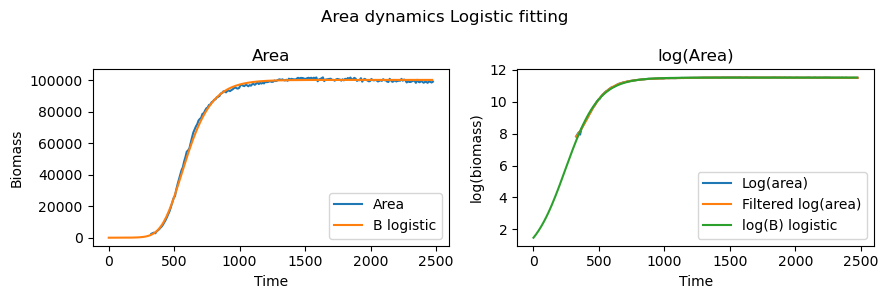

78 params: [11.363640202942117, 0.022393397773047302, -25.60684016495349]


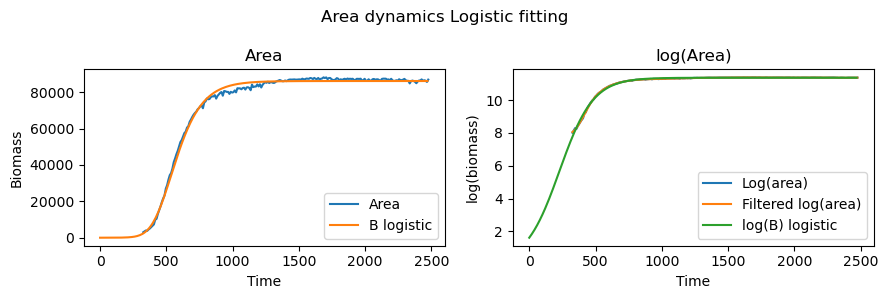

79 params: [11.4023920730984, 0.02228653375528777, -24.913717318083453]


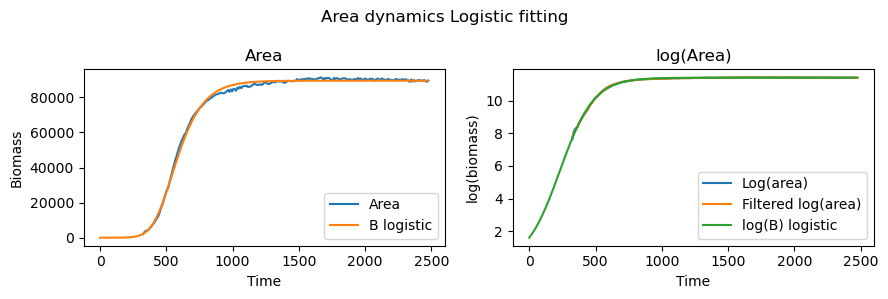

80 params: [11.587313484331283, 0.023216482423571, -9.344888586933326]


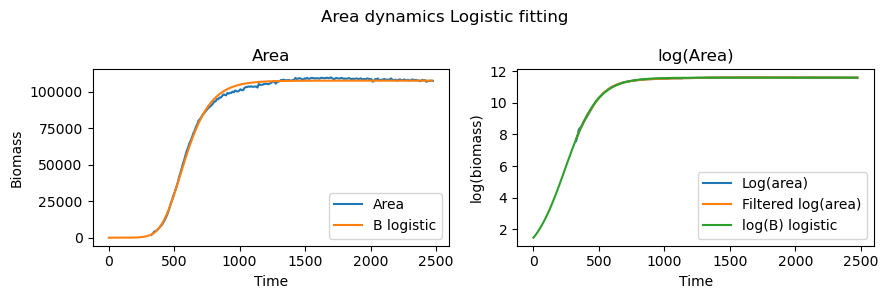

81 params: [11.590194052899013, 0.020724785765490132, -15.250853267368694]


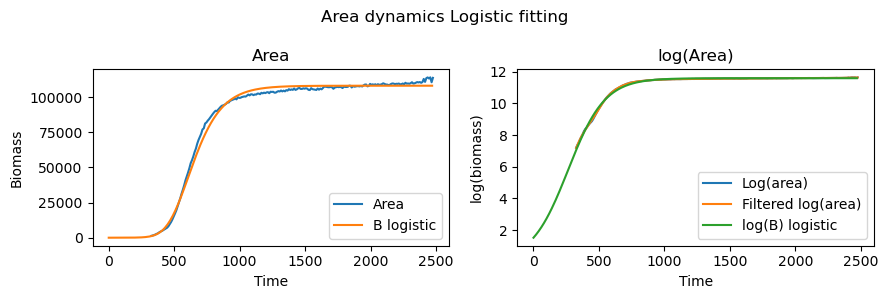

82 params: [11.44343933746101, 0.02109520143191252, -0.5297145918351005]


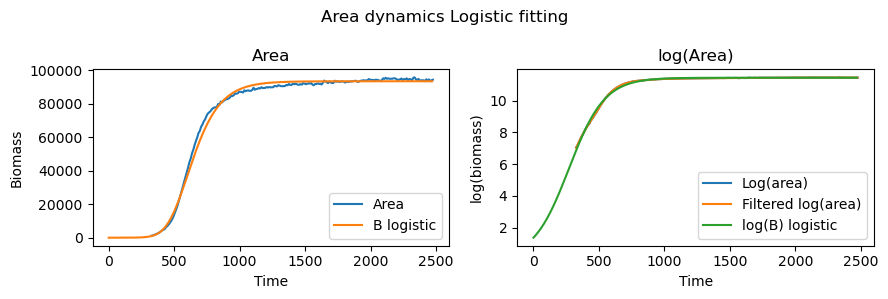

83 params: [11.565272945312389, 0.022683001172210882, 25.063927629551795]


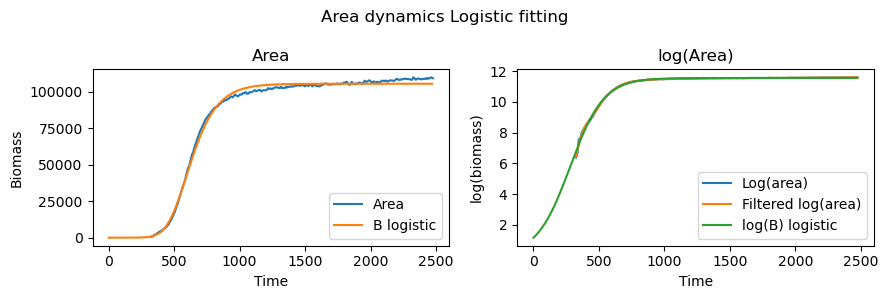

84 params: [11.739920052603091, 0.021979738190543555, 18.03552028377773]


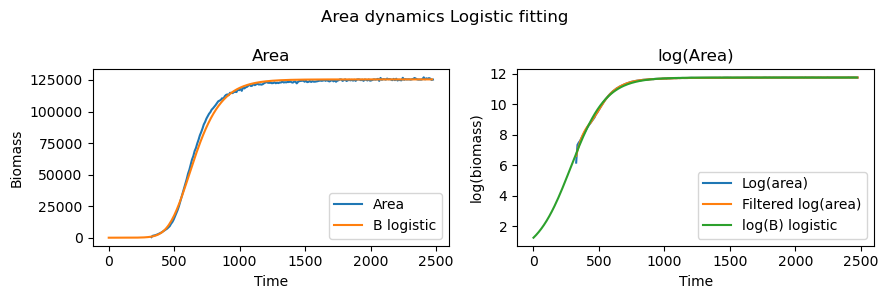

85 params: [11.905239387970077, 0.021190590857254245, 4.981884463115481]


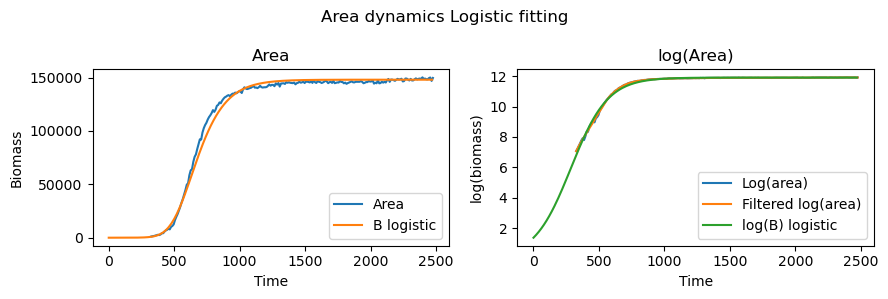

86 params: [12.068802003745203, 0.0236741626118099, 38.56529048355279]


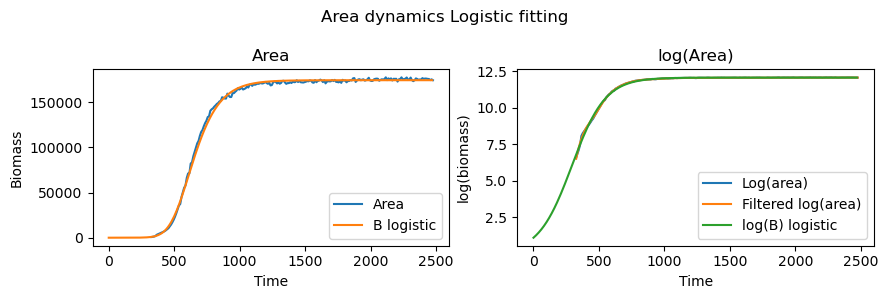

87 params: [11.817708502170438, 0.02109076338784671, 3.3570716247960797]


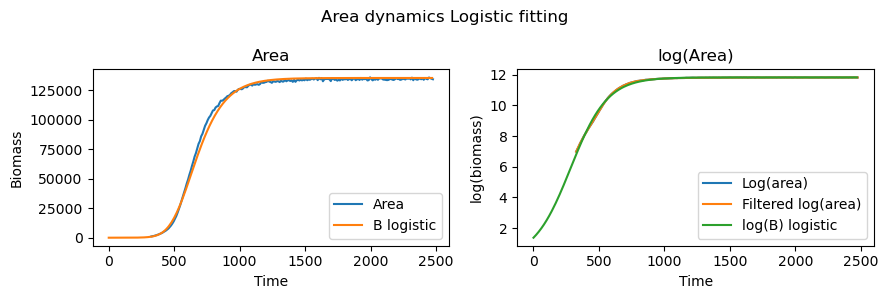

88 params: [11.798065404236757, 0.02149365836732217, -8.415919522794006]


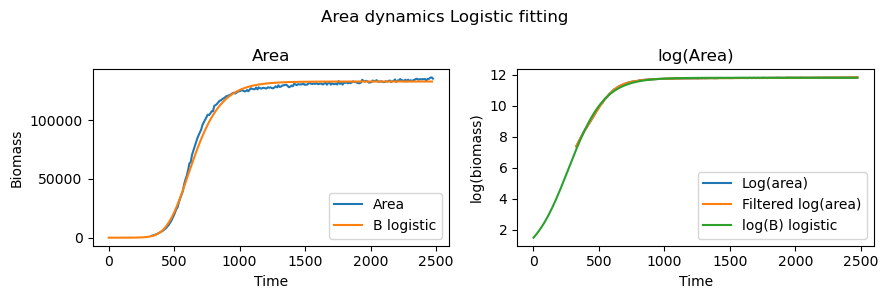

89 params: [11.776489401437653, 0.02432631292954845, 51.6427439113039]


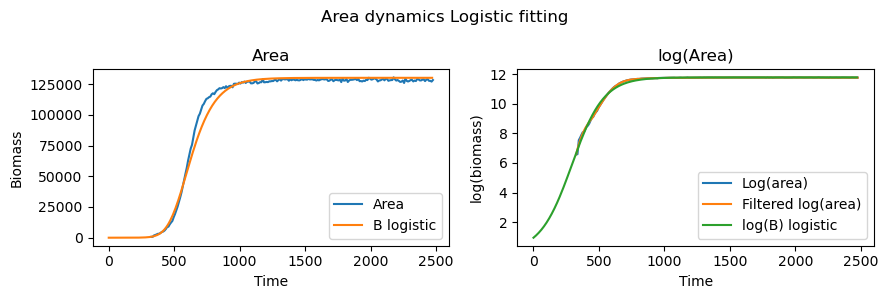

90 params: [11.47103142708478, 0.0242825943548324, 58.686222712889]


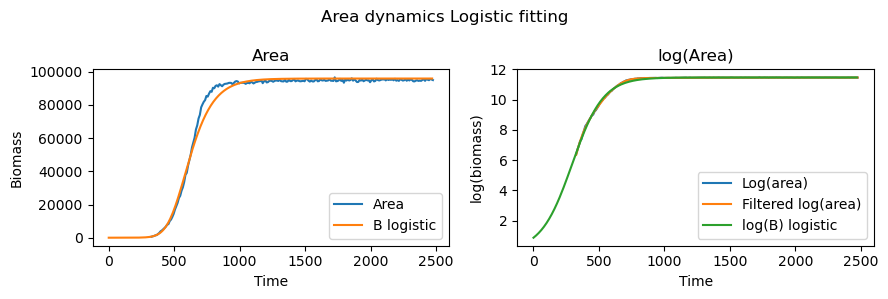

91 params: [11.625263870300254, 0.022299229666181114, 27.51989826599335]


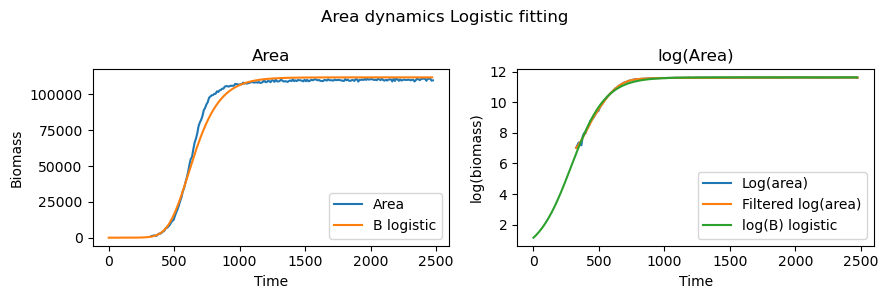

92 params: [11.101687641010175, 0.019342218780699375, -100.1954240167439]


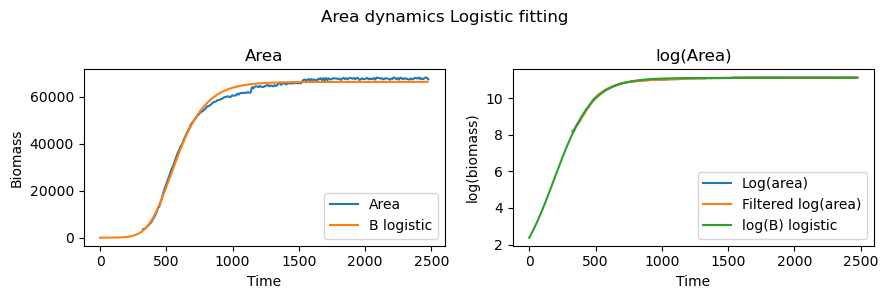

93 params: [11.430032932780472, 0.021267912133780403, 3.317413718401994]


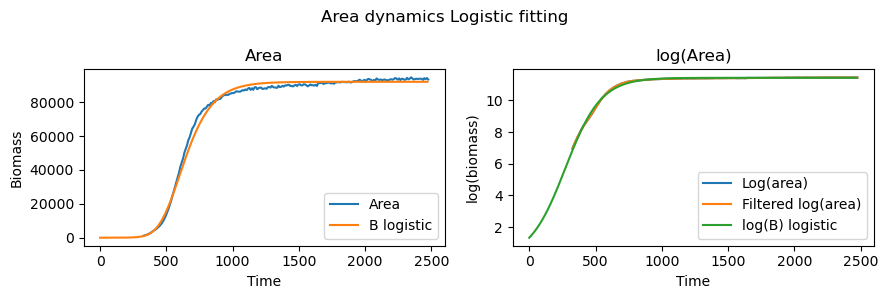

94 params: [11.355023602524858, 0.020911049955308934, -0.21215334194976312]


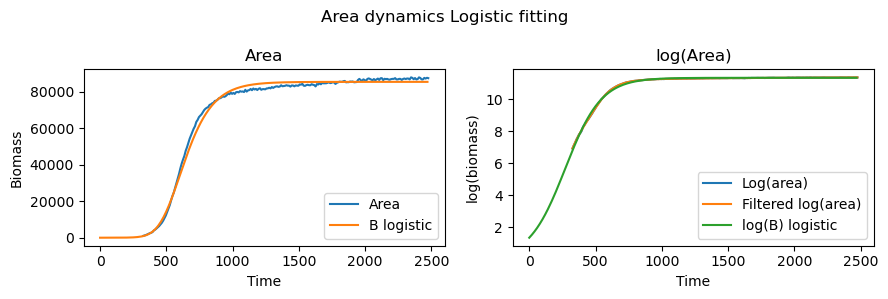

95 params: [11.576172419839027, 0.021626228157530812, 9.847742139438402]


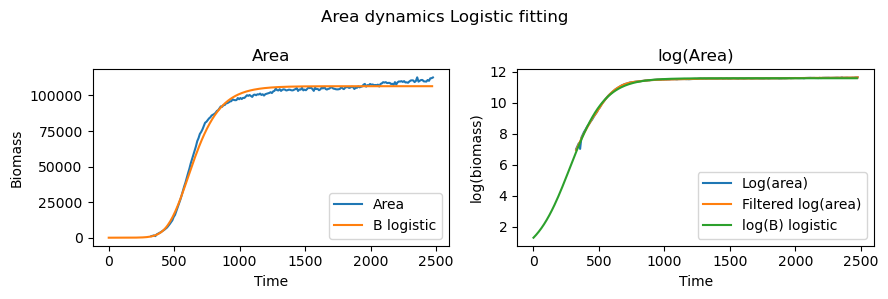

96 params: [12.62904318120163, 0.020688733551082382, -68.17771235774725]


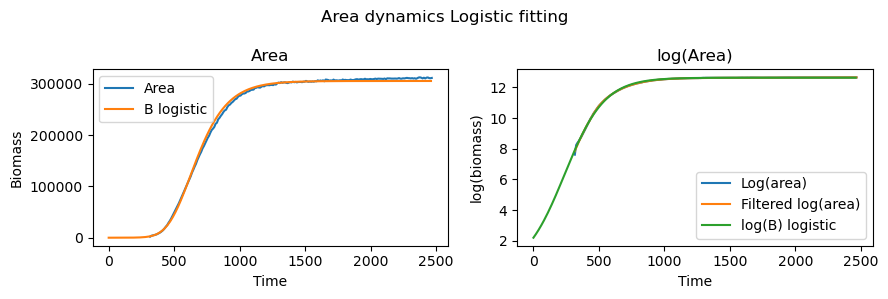

97 params: [12.418293193959945, 0.019697298219951566, -88.02557220918371]


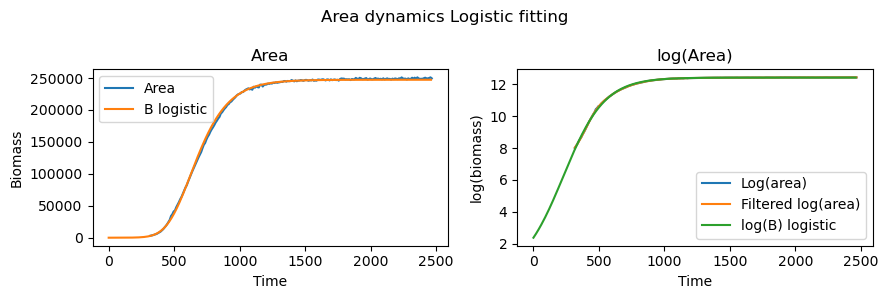

98 params: [12.11728827645177, 0.018668190120306363, -101.91743056725569]


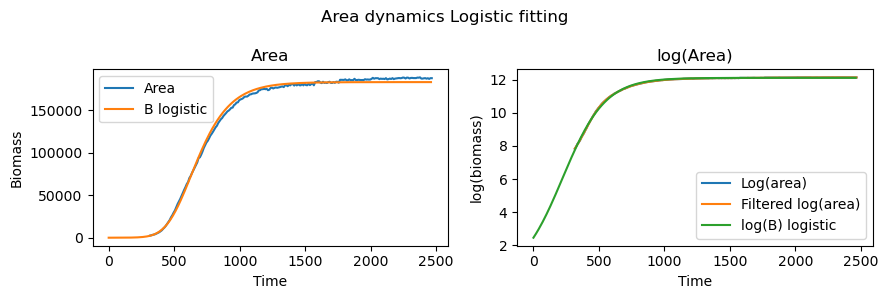

99 params: [12.31165203272307, 0.019183041003343424, -95.30647175052582]


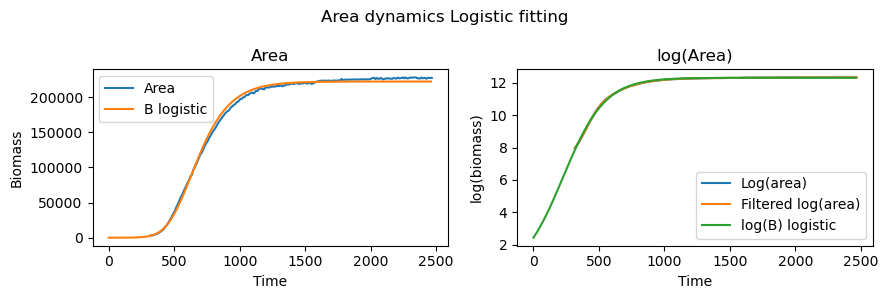

100 params: [12.110501768088069, 0.017518218316618917, -123.55379974265063]


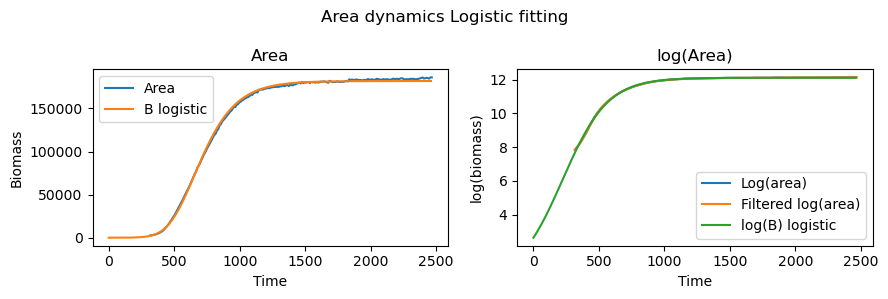

101 params: [12.15433127212536, 0.024737220970529033, 25.477430915109743]


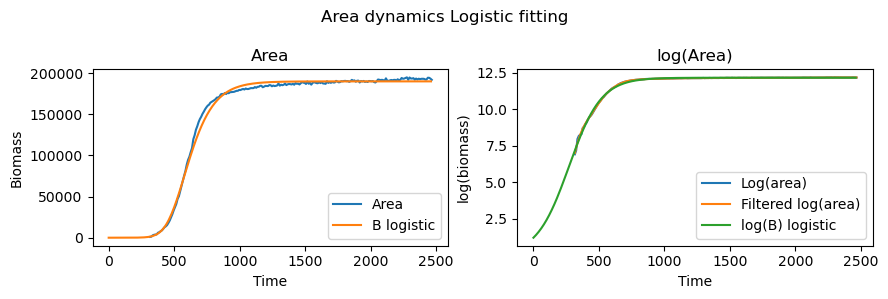

102 params: [11.817984379019528, 0.019451684703374484, -91.84502438478862]


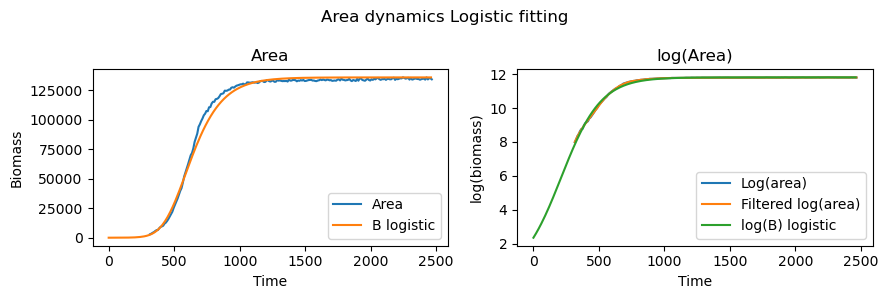

103 params: [11.815483485494791, 0.020939779914364322, -40.79841432677406]


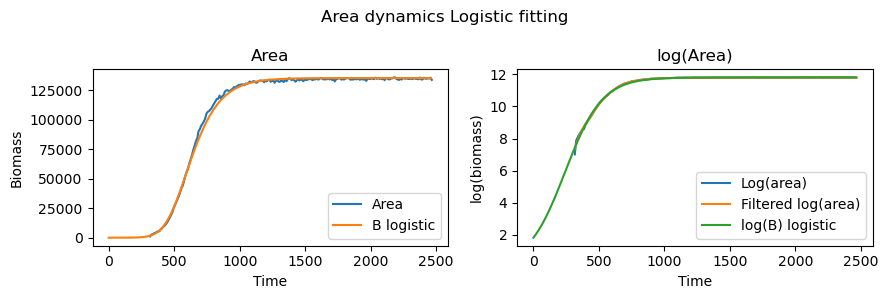

104 params: [11.813539214813655, 0.02001919118343915, -73.01216063634942]


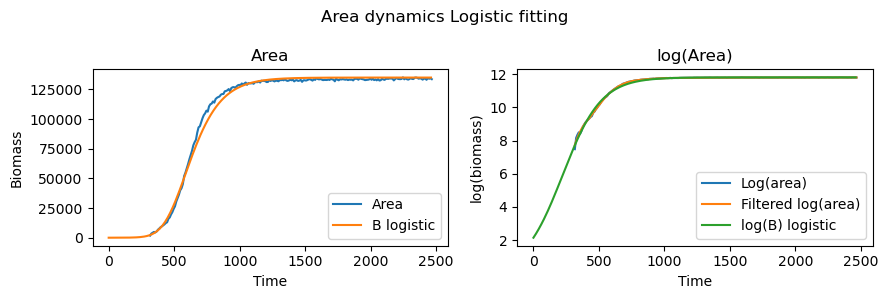

105 params: [11.568400511874973, 0.019553051885893655, -72.9268447665534]


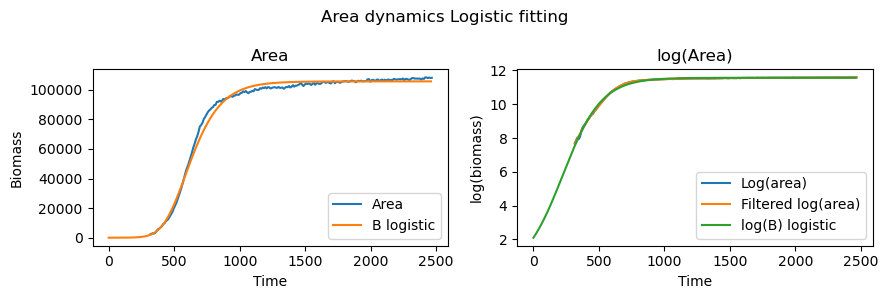

106 params: [11.359032517144865, 0.021570319881841705, -20.208622751743523]


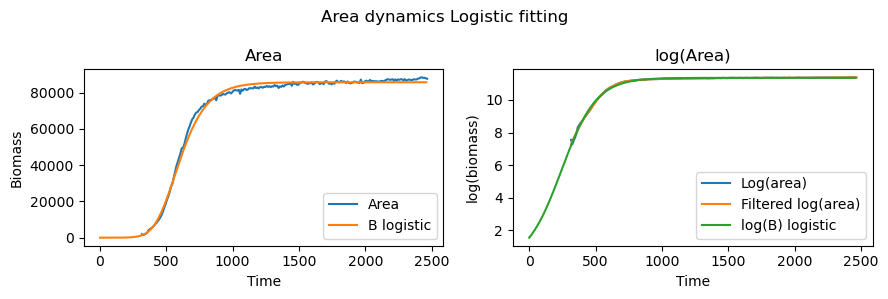

107 params: [11.4465851001667, 0.021372765882181417, -29.451094443904303]


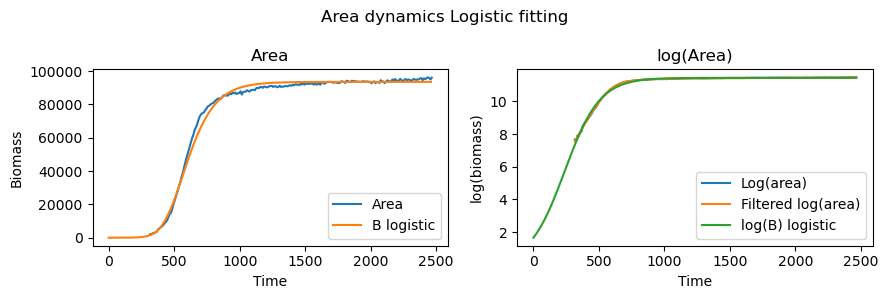

108 params: [12.207379854800761, 0.03029826728280036, 82.54265153280078]


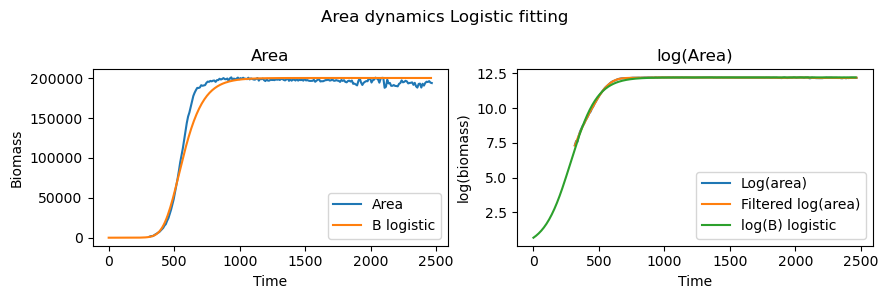

109 params: [11.47333972966948, 0.026097557959387504, 26.44797475875315]


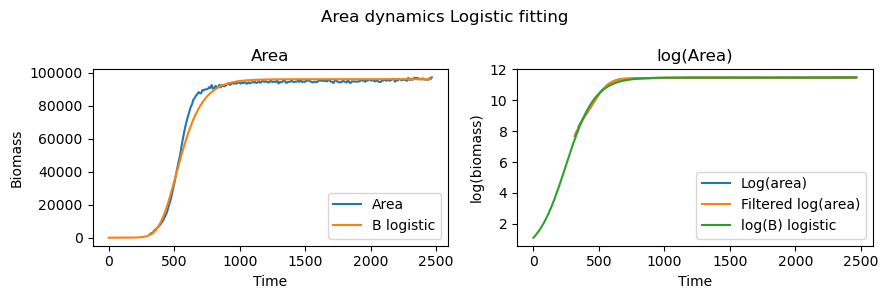

110 params: [11.493160855729306, 0.027364104558304805, 51.10876854067929]


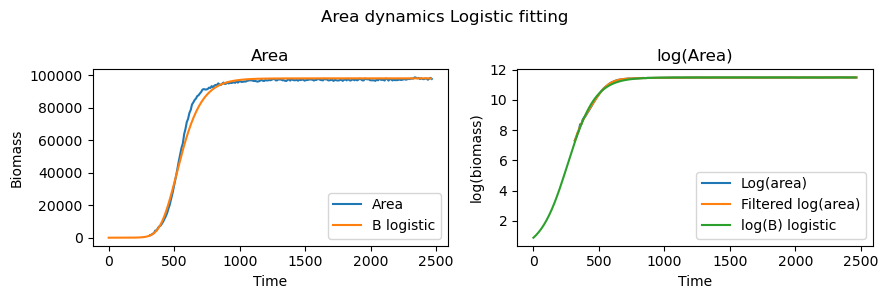

111 params: [11.59386011096647, 0.021655811771289987, -82.71721476200793]


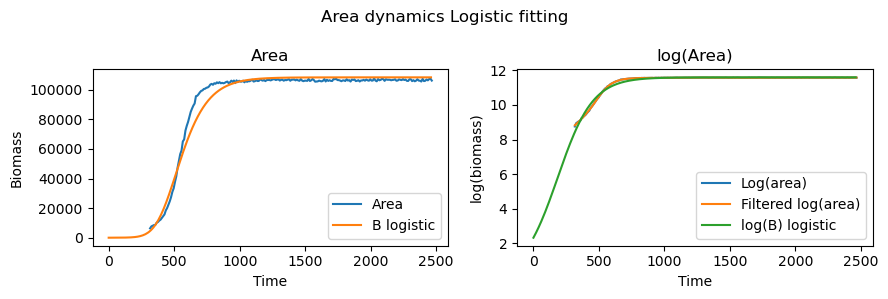

112 params: [12.086830827315195, 0.028676616718405823, 46.122083408420224]


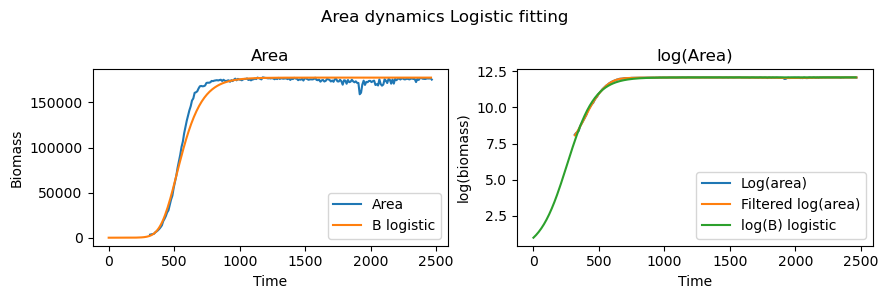

113 params: [11.771380191437848, 0.02845331335695427, 51.50386743232246]


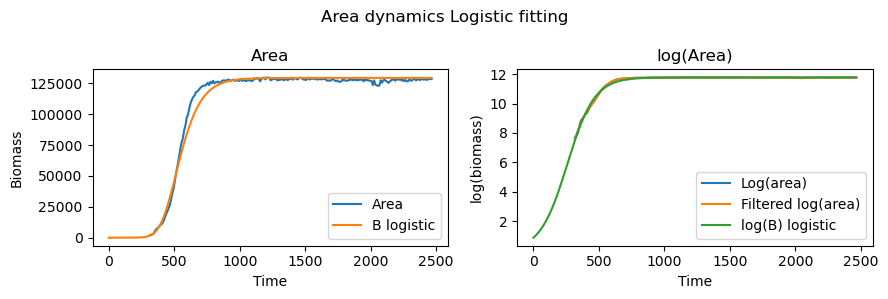

114 params: [11.81435913912203, 0.021449799900587388, -28.277829283420356]


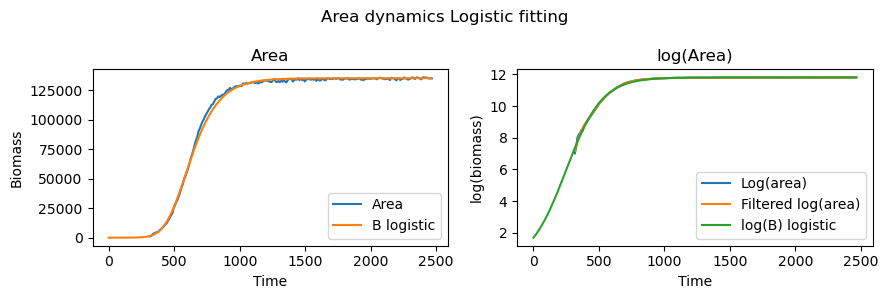

115 params: [11.194511997776267, 0.01953330288849691, -57.81799326117414]


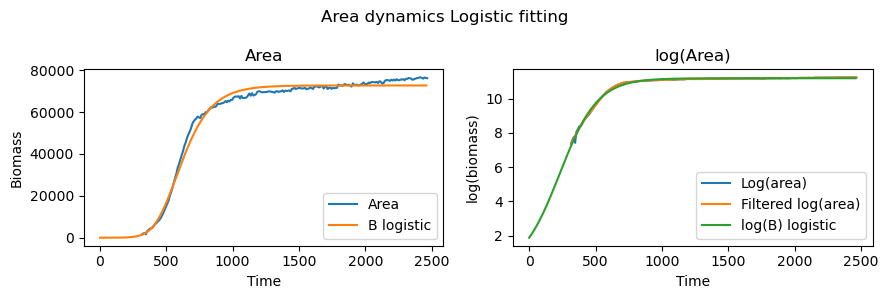

116 params: [12.038161484961615, 0.023590930599552837, 4.247250094525875]


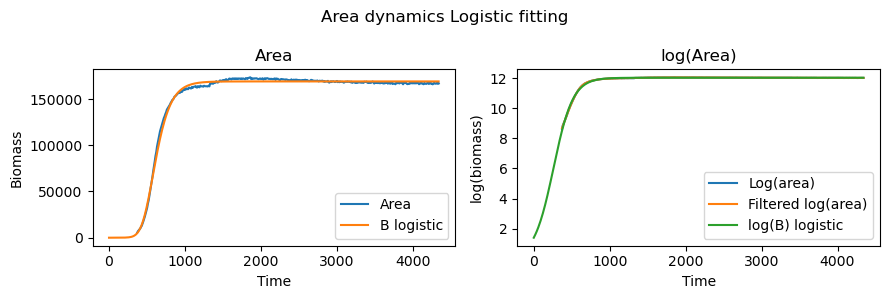

117 params: [12.104635247092402, 0.025232233628792698, 30.17114026597371]


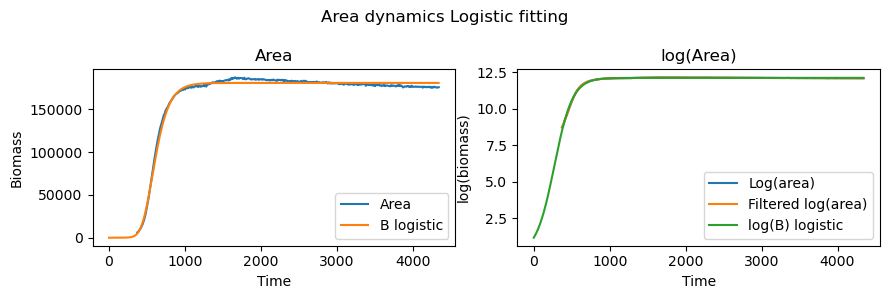

118 params: [12.197530621968346, 0.024585700186767007, 37.71171673086634]


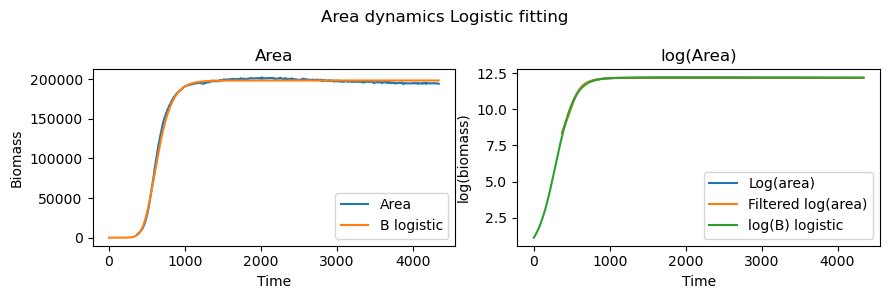

119 params: [11.968100615870231, 0.02536750599969389, 53.00787205808489]


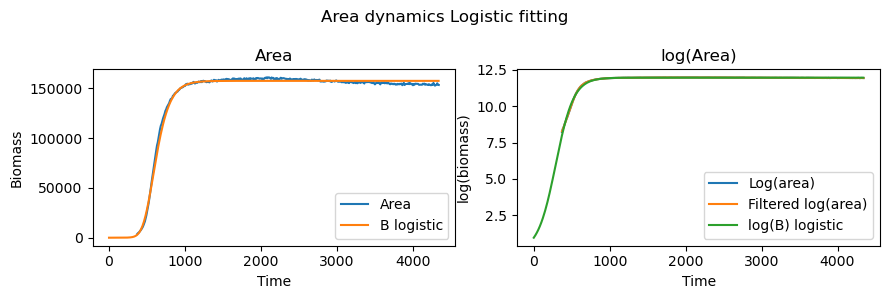

120 params: [11.77062787271596, 0.023097975158514736, 67.0965454908019]


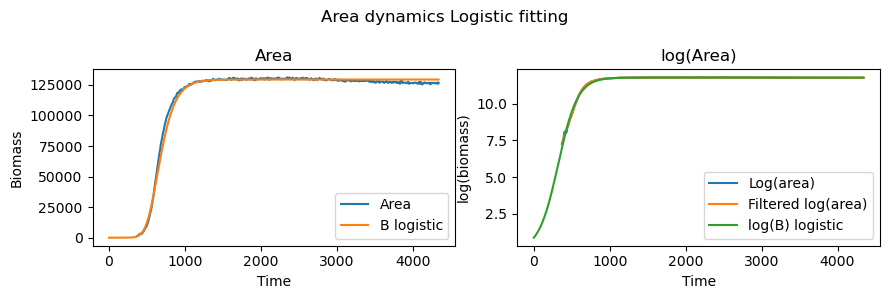

121 params: [12.210540337578529, 0.020206907421137628, -6.707088370491169]


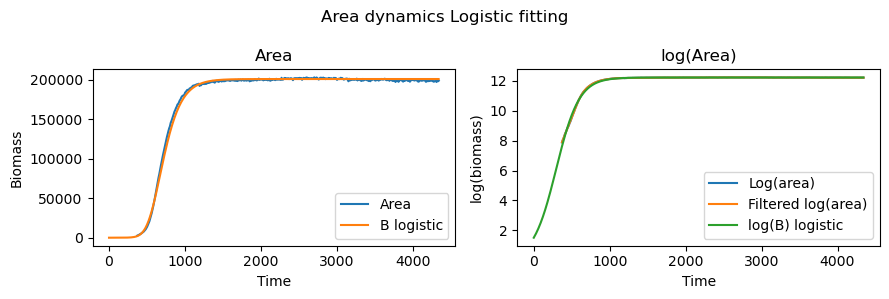

122 params: [12.411444538246355, 0.022331218548205262, -3.9940889828879675]


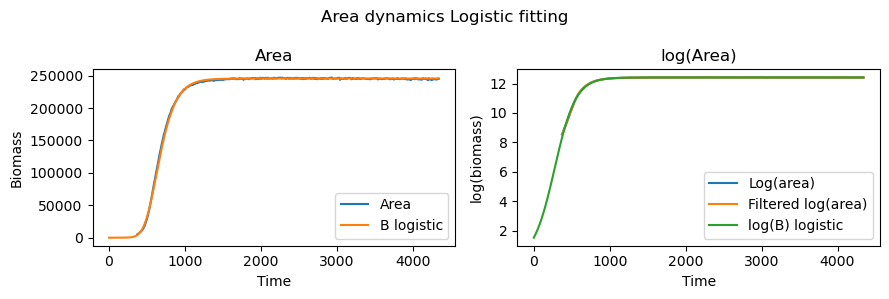

123 params: [12.543077090952437, 0.02357502649925525, 29.360171732626995]


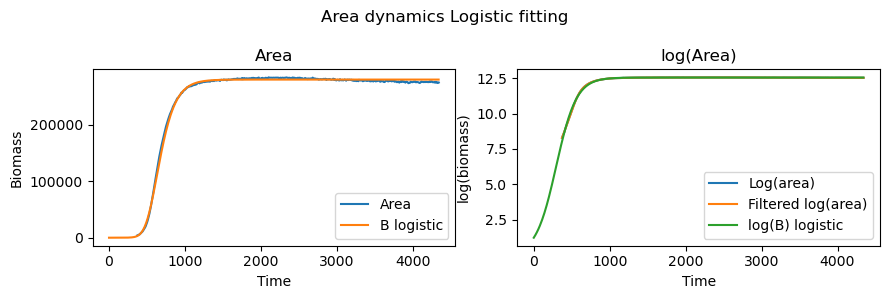

124 params: [12.4892521133542, 0.02370581578277924, 14.517685392119471]


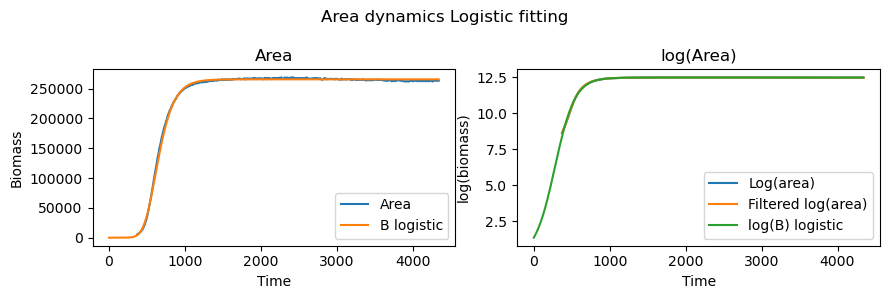

125 params: [11.385387910553574, 0.01239529514641728, -50.513988698212835]


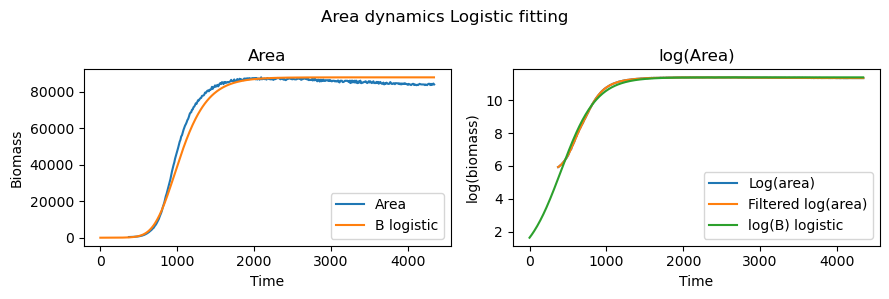

126 params: [11.794715713001677, 0.013668008104572726, -107.274602716101]


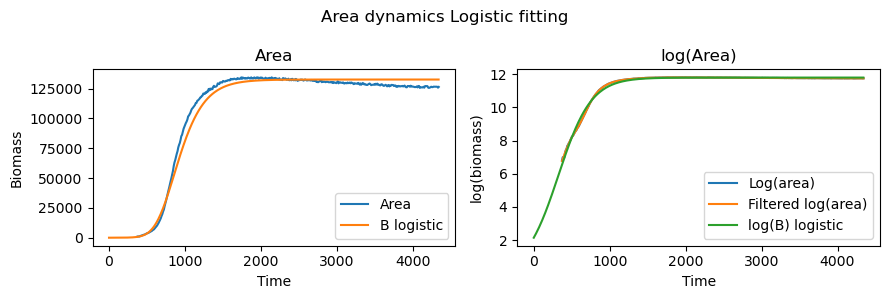

127 params: [11.96575377614205, 0.014634131635493293, -85.79361256476349]


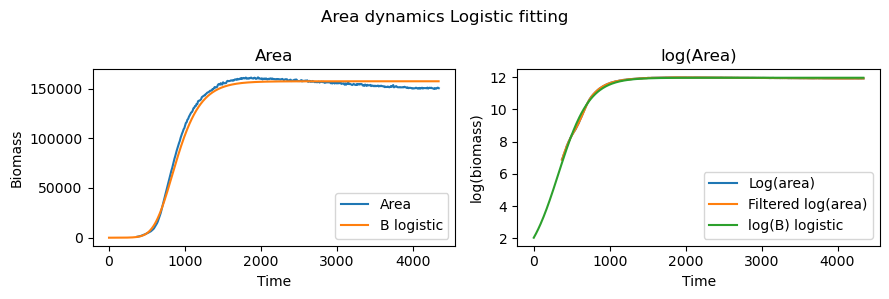

128 params: [11.99946567180799, 0.015459855418067178, -52.39442123806806]


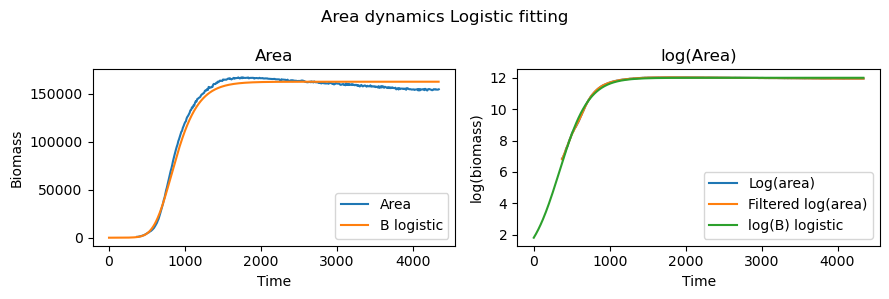

129 params: [12.759114660256667, 0.012243229938939658, -165.57472486590044]


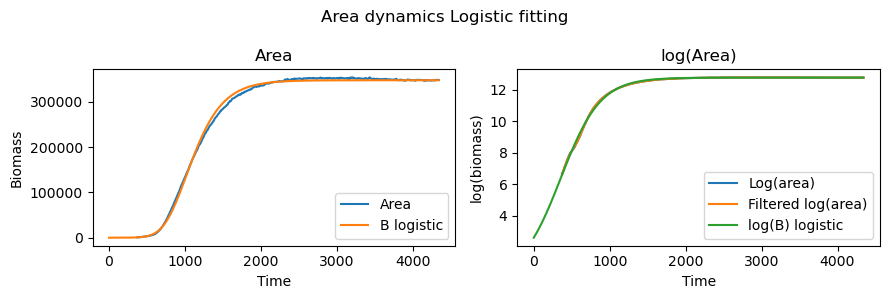

130 params: [12.44101898309336, 0.012941736969703667, -102.60798545149619]


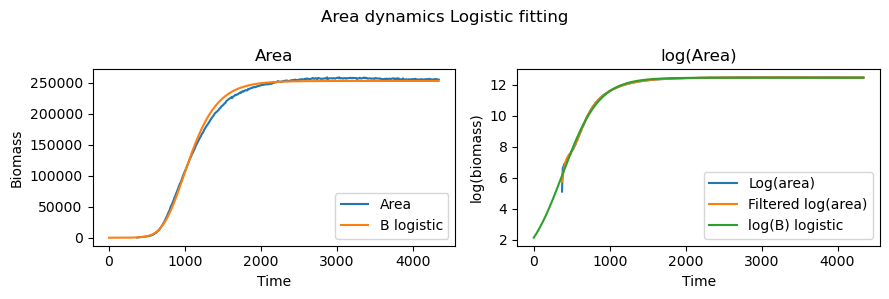

131 params: [12.436574091737986, 0.013063361637947694, -99.34486006941613]


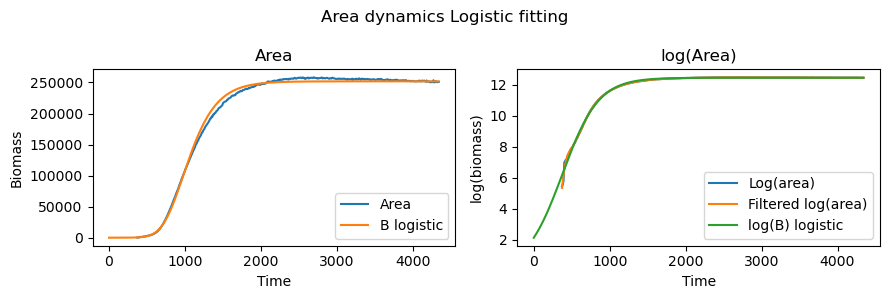

132 params: [12.598144196913026, 0.013509479662269175, -82.90455616789552]


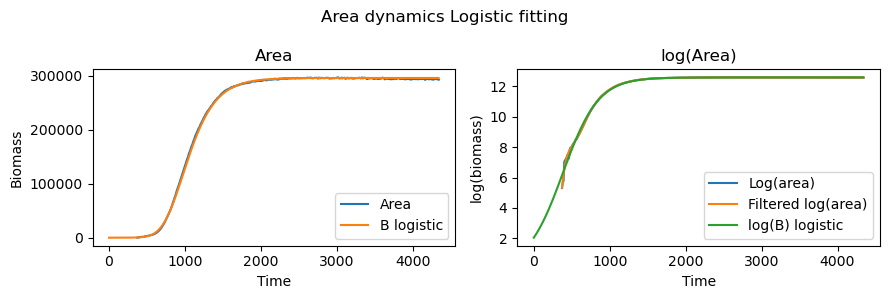

133 params: [12.956926009370038, 0.013121208016114383, -140.69081739396984]


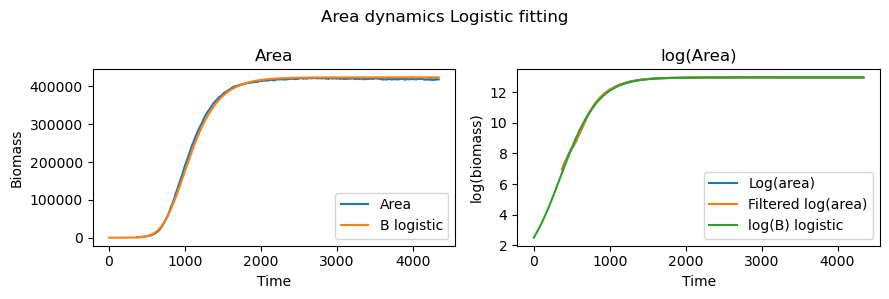

134 params: [12.96544171463044, 0.013696564473765827, -118.6882219325658]


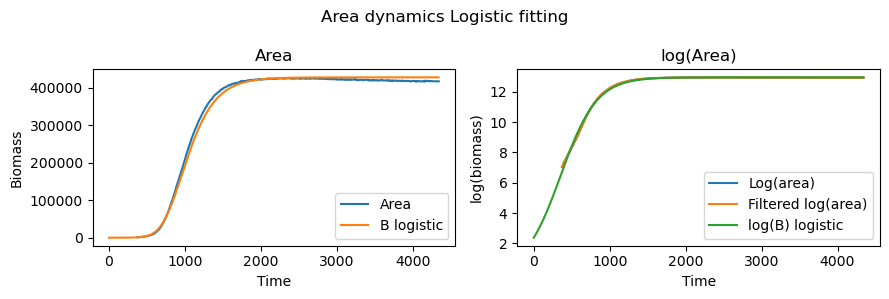

135 params: [12.130079039213166, 0.02543578893809975, 64.83125814596849]


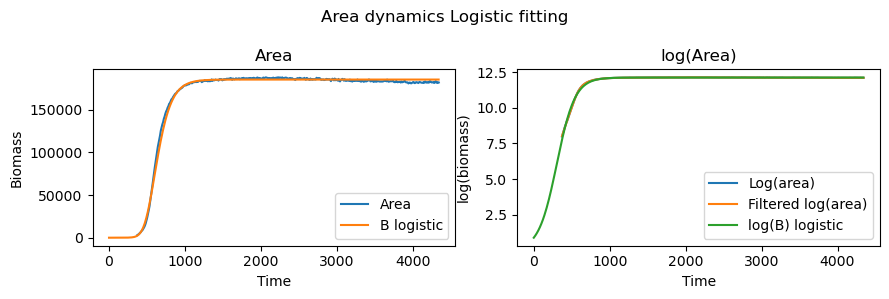

136 params: [11.614368434199124, 0.025737107634590427, -11.904650566697986]


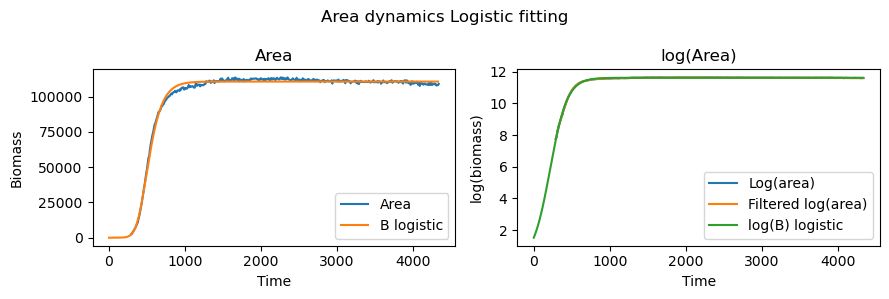

137 params: [11.520451233385753, 0.02262317440211235, -76.8896013848902]


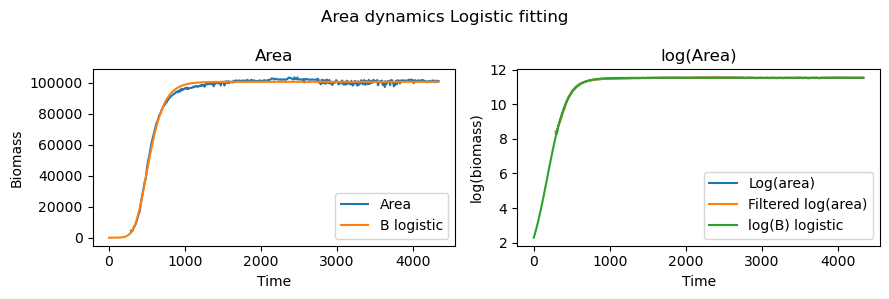

138 params: [11.686074459717076, 0.025488872206423464, -20.858174572066005]


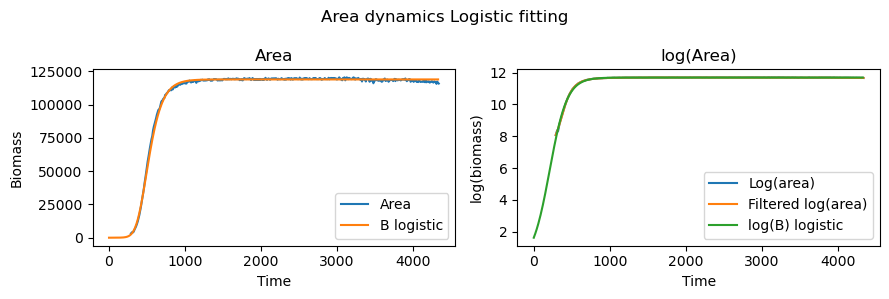

139 params: [11.78327264187707, 0.023826357443122746, -54.63996950054876]


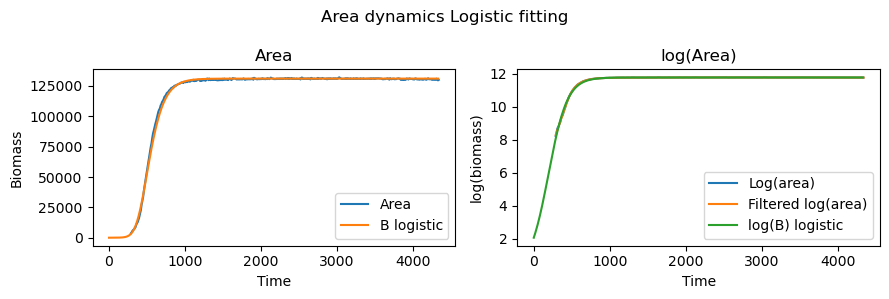

140 params: [11.564023094434331, 0.024082288631326512, -9.825291811487634]


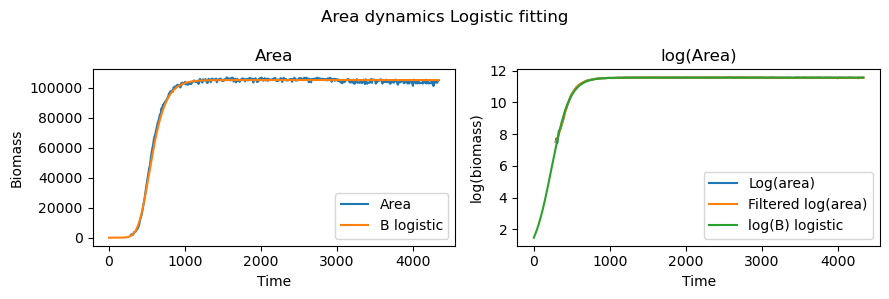

141 params: [11.573529271814985, 0.023697933406993898, -22.72045089974441]


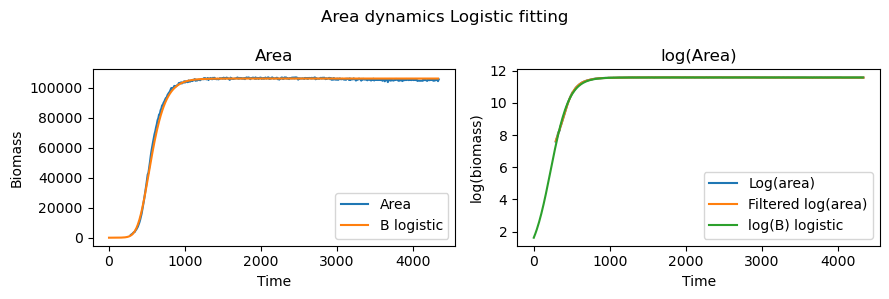

142 params: [12.281344854831419, 0.02994087277088418, 10.86579051749085]


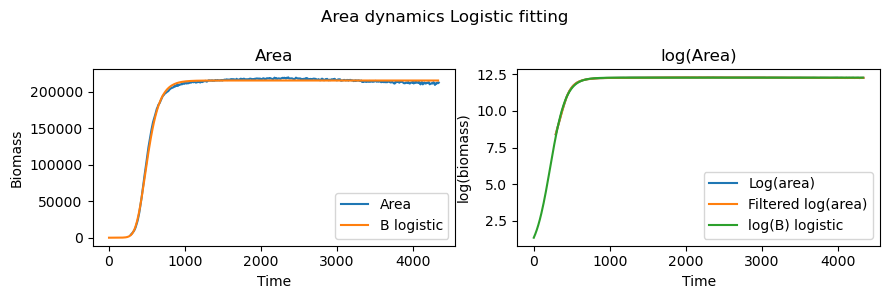

143 params: [12.088146235198375, 0.029873438792180063, 12.5520052803782]


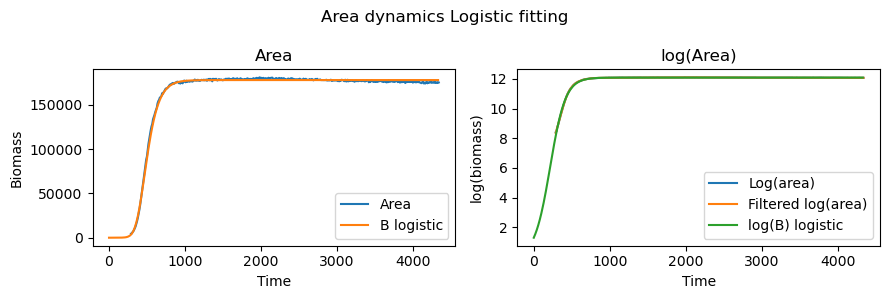

144 params: [11.822102472658633, 0.027172324310877526, 8.57235548727675]


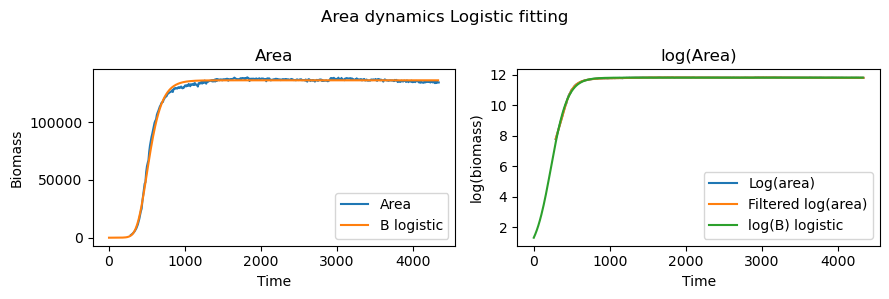

145 params: [12.107031978441729, 0.015335264430426961, -78.21499679513269]


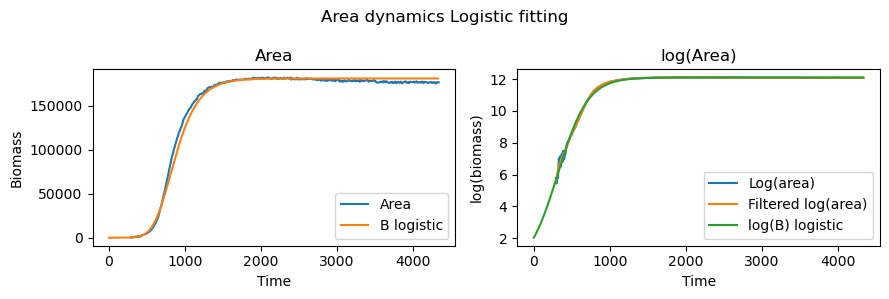

146 params: [11.276027094852022, 0.015161498906598942, -5.7449445009282885]


/tmp/ipykernel_1223843/351555560.py:25: RuntimeWarning: divide by zero encountered in log
  axes[1].plot(time_points, np.log(area), label='Log(area)')
/tmp/ipykernel_1223843/351555560.py:26: RuntimeWarning: divide by zero encountered in log
  axes[1].plot(time_points, savgol_filter(np.log(area), 21, 3), label='Filtered log(area)')


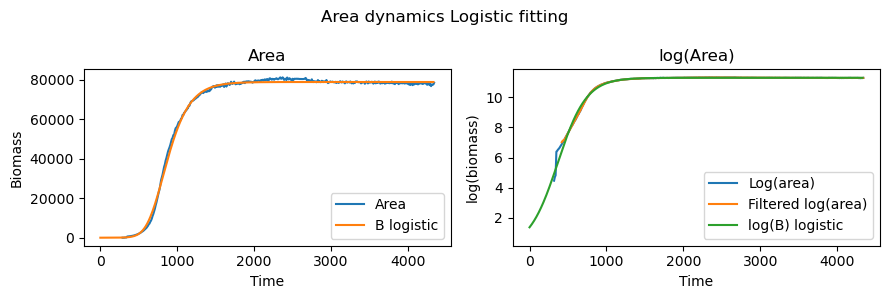

147 params: [10.921608377637947, 0.012970770609608315, -107.52274860073084]


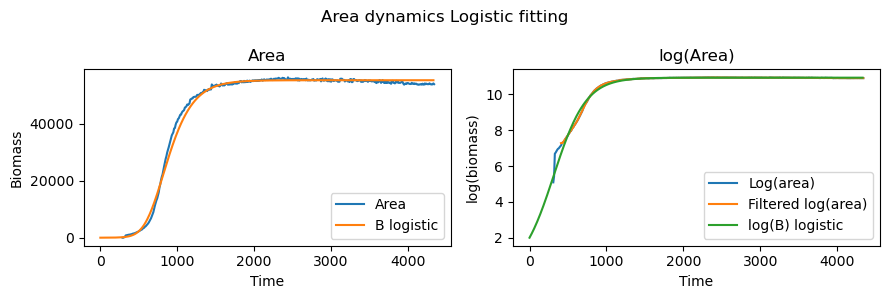

148 params: [10.992515460203482, 0.010471686589254047, -265.7667025339931]


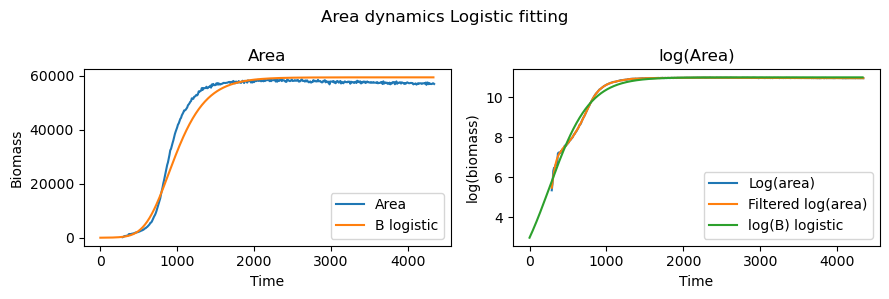

149 params: [11.19934495219456, 0.01794466603253439, 144.5662044974472]


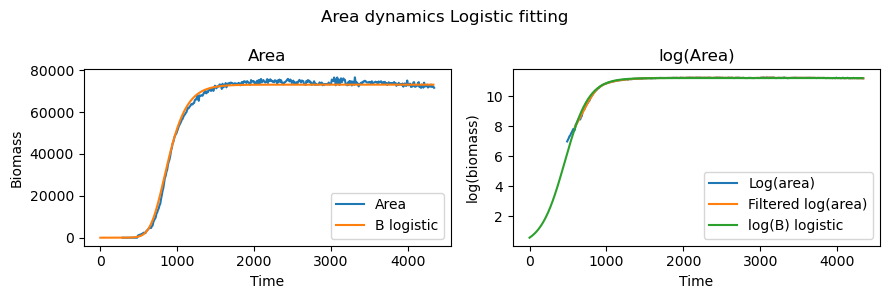

150 params: [11.365492945517866, 0.013120264947097938, -109.21636878634439]


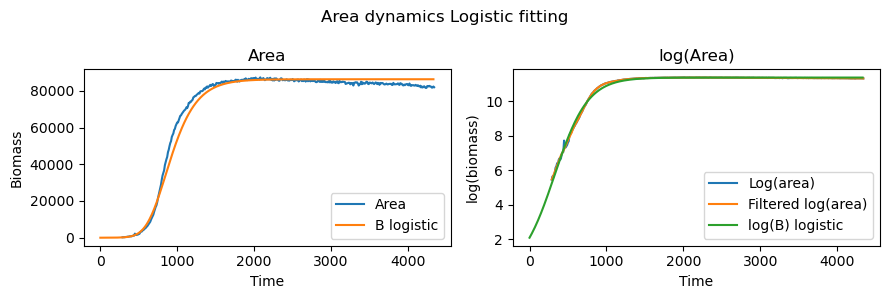

151 params: [11.706832150013055, 0.01538869273426973, -66.75306377266642]


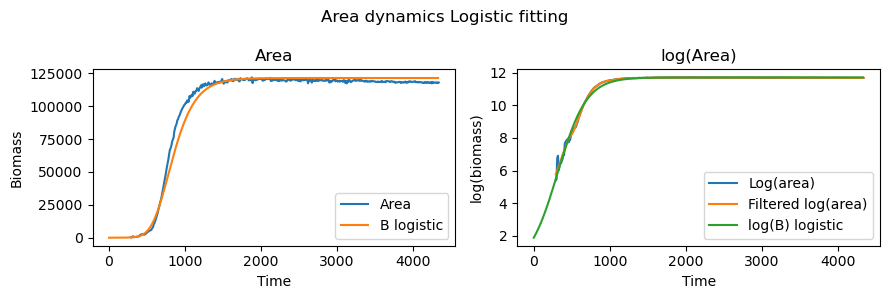

152 params: [11.474062974318793, 0.01579810012184229, -22.850424255074017]


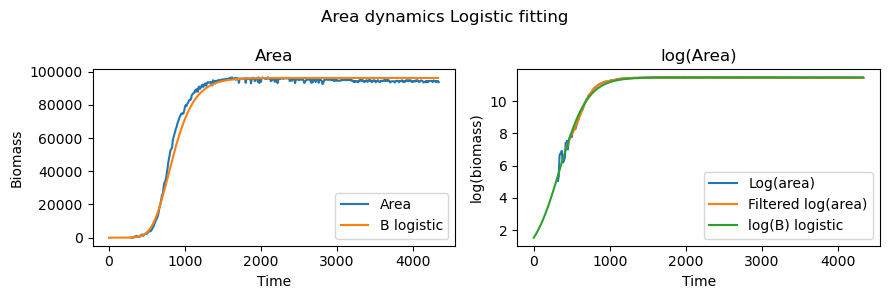

153 params: [11.401050132616742, 0.02204122710430719, 165.74205942366257]


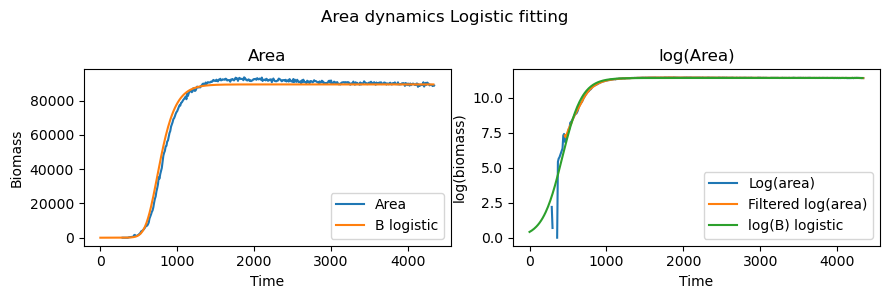

154 params: [11.347363806652911, 0.015800698598728923, -121.23598227274135]


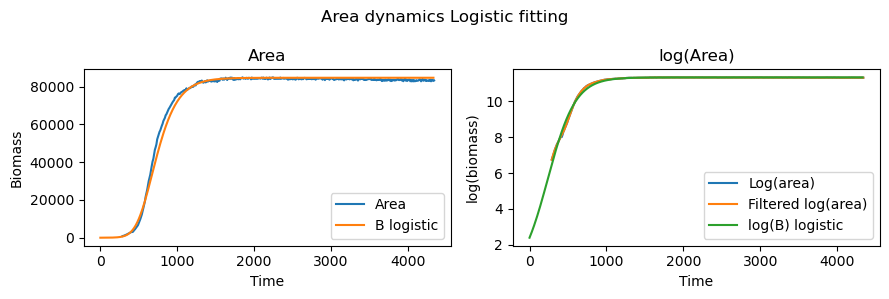

155 params: [11.494199501074085, 0.016585502874647443, -110.01560247691017]


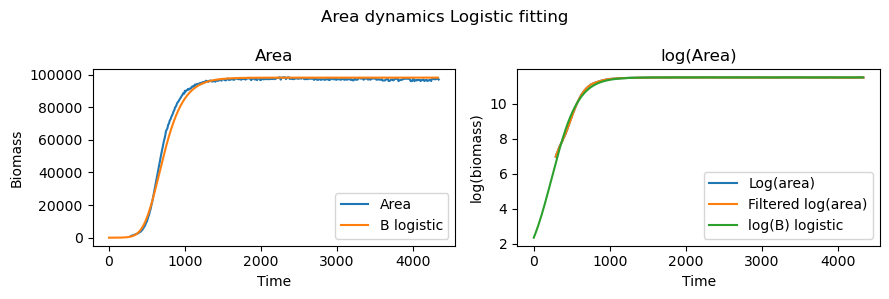

156 params: [11.576370672319893, 0.01650044544908823, -95.39415502675273]


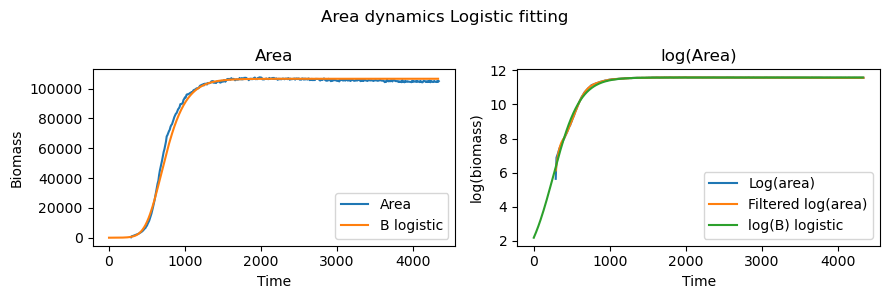

157 params: [11.674280653555156, 0.023985078326129686, -38.9164049582698]


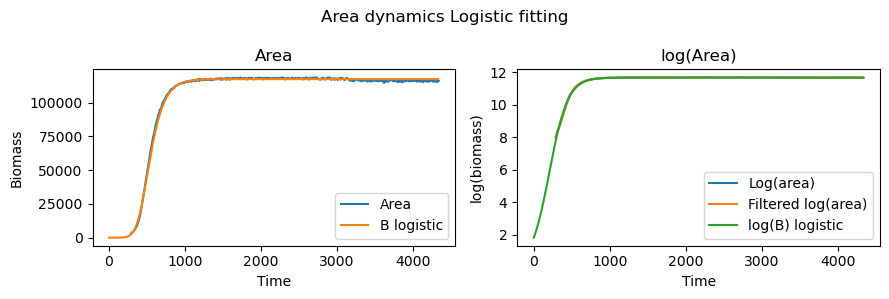

158 params: [11.585707675314604, 0.013245232609352961, -142.82094678354198]


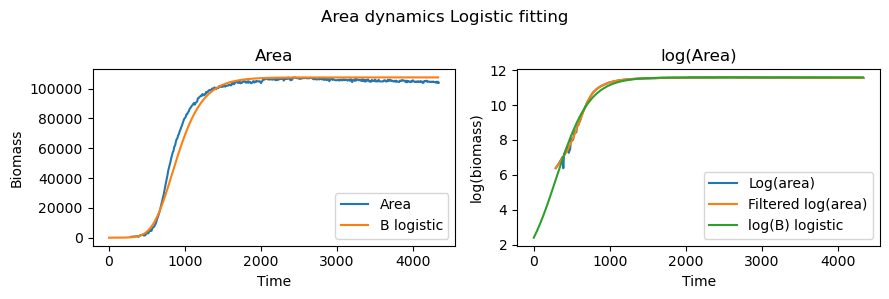

159 params: [10.12314848241439, 0.007774609964238476, -477.8949667956889]


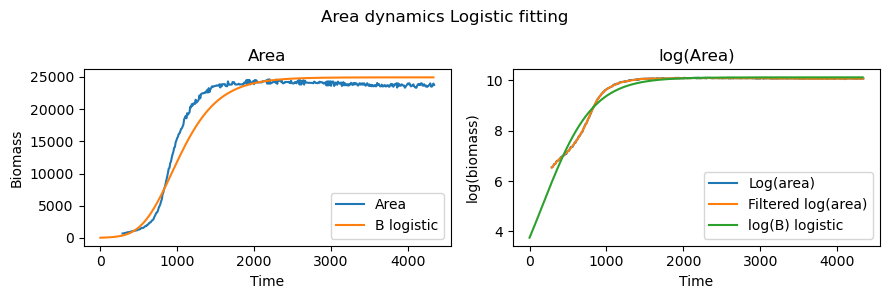

In [18]:
for i in df.index.values:
    incub_time_s = datetime.strptime(df.loc[i,'t_im'], '%H:%M:%S') - datetime.strptime(df.loc[i,'t_incub'], '%H:%M:%S')
    incub_time_n = incub_time_s.seconds / 60
    
    area = extract_array(df.loc[i,'area'])
    time_points = np.arange(0, df.loc[i, 'exp length'])*10 + incub_time_n
    time = np.arange(0, time_points[-1], 10, like=time_points)
    params = list(json.loads(df.loc[i,'logistic_params']).values())
    logisticg = logistic(time, *params)

    print(f"{i} params: {params}")
    # create subplots
    fig, axes = plt.subplots(1, 2, figsize=(9,3))

    # plot data
    axes[0].plot(time_points, area, label='Area')
    #axes[0].plot(time_points, savgol_filter(area, 21, 3), label='Filtered area')
    axes[0].plot(time, np.exp(logisticg), label='B logistic')
    axes[0].set_xlabel('Time')
    axes[0].set_ylabel('Biomass')
    axes[0].set_title('Area')
    axes[0].legend()

    # log area
    axes[1].plot(time_points, np.log(area), label='Log(area)')
    axes[1].plot(time_points, savgol_filter(np.log(area), 21, 3), label='Filtered log(area)')
    axes[1].plot(time, logisticg, label='log(B) logistic')
    axes[1].set_xlabel('Time')
    axes[1].set_ylabel('log(biomass)')
    axes[1].set_title('log(Area)')
    axes[1].legend()

    # growth rate
    """
    #axes[1].plot(time_points, np.log(area), label='Log(area)')
    axes[1].plot(time_points, savgol_filter(np.log(area), 21, 3, deriv=1), label='Growth rate area')
    axes[1].plot(time, savgol_filter(gomp, 21, 3, deriv=1), label='Growth rate B gompertz')
    axes[1].plot(time, gompertz_growth_rate(time, *params), label='Growth rate deriv')
    
    axes[1].set_xlabel('Time')
    axes[1].set_ylabel('Growth rate')
    axes[1].set_title('Growth rate')
    axes[1].legend()
    """
    
    plt.suptitle('Area dynamics Logistic fitting')
    plt.tight_layout()
    plt.show()

#### Computing t_m

In [19]:
for i in df.index.values:
    pars_gomp = json.loads(df.loc[i,'gomp_params'])
    t_m_gomp = tm_gomp(pars_gomp['A'], pars_gomp['mu_m'], pars_gomp['lambda'])
    pars_logistic = json.loads(df.loc[i,'logistic_params'])
    t_m_logistic = tm_logistic(pars_logistic['A'], pars_logistic['mu_m'], pars_logistic['lambda'])

    df.at[i, 't_m_gomp'] = t_m_gomp
    df.at[i, 't_m_logistic'] = t_m_logistic
    #print(f'Colony: {i}, tm_gomp: {t_m_gomp}, t_m_logistic: {t_m_logistic}')

In [20]:
df.to_excel('data_processed.xlsx', index=False)

#### Gompertz and logistic

0 params: [11.291854811467543, 0.025384848369673158, 2.806286128000874]


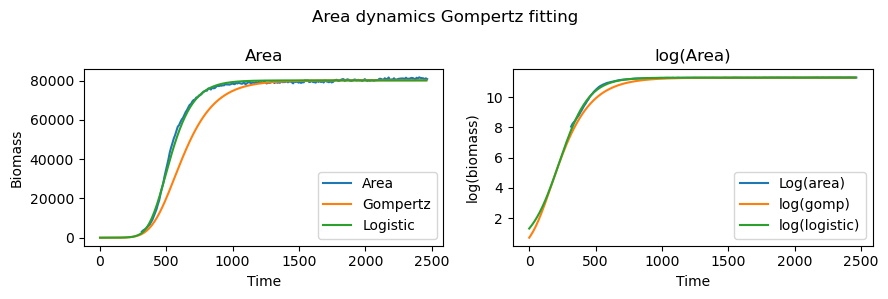

1 params: [11.649139256480966, 0.026836907946944592, -1.406587244663707]


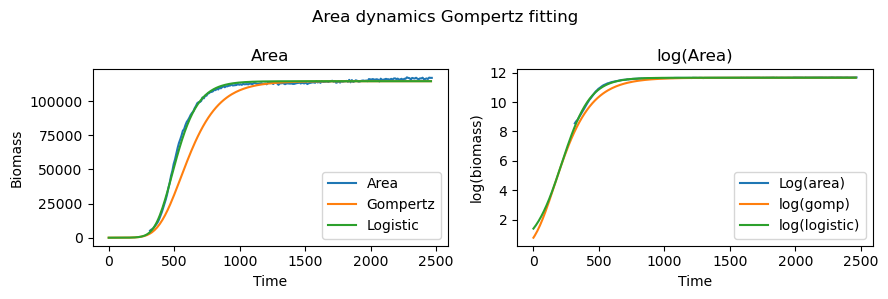

2 params: [11.578378488201757, 0.027017944055282742, -8.915374533416795]


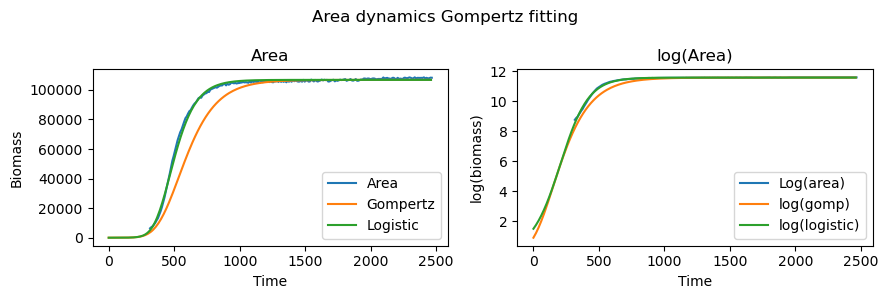

3 params: [11.261690794798985, 0.024723536552972592, -53.05982940116218]


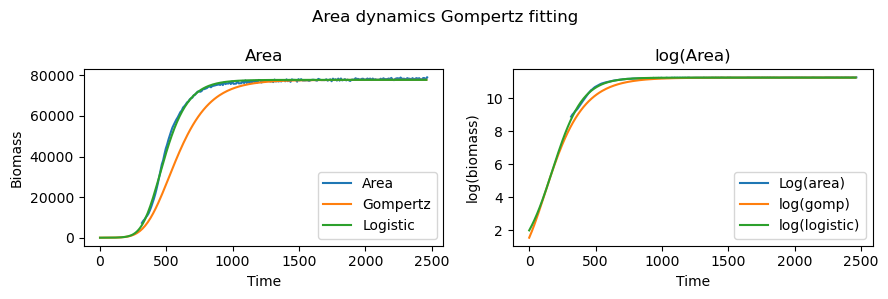

4 params: [11.526236072514887, 0.0275867338101212, 2.664818892536339]


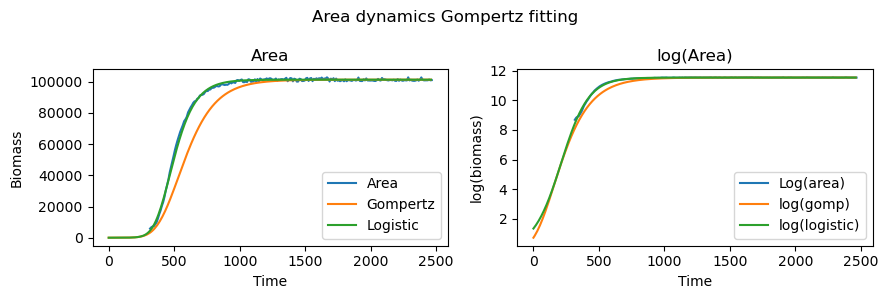

5 params: [11.298719676771755, 0.026436007204334474, 5.537965689818001]


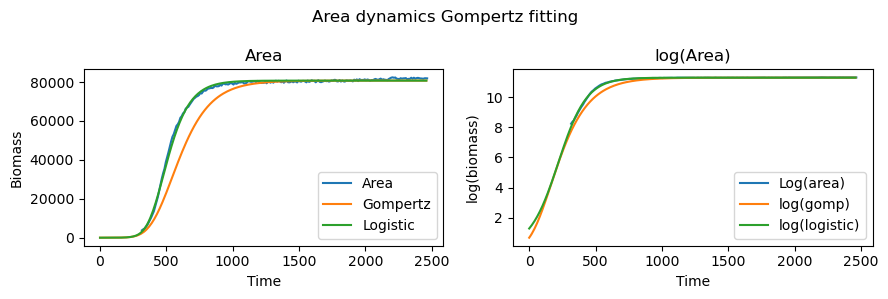

6 params: [10.661943868636204, 0.019602182320773143, -51.213732233193944]


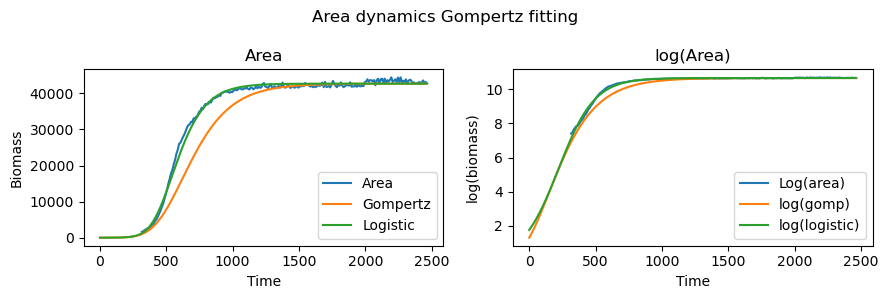

7 params: [10.19548889329514, 0.017262392470643317, -61.016326678182665]


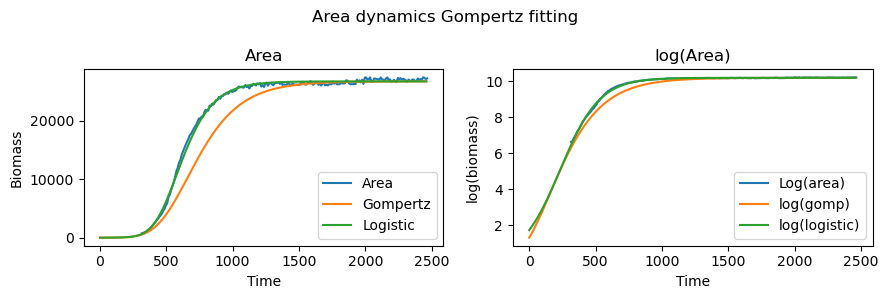

8 params: [11.630606753110914, 0.027308265177400377, 3.9466867342473058]


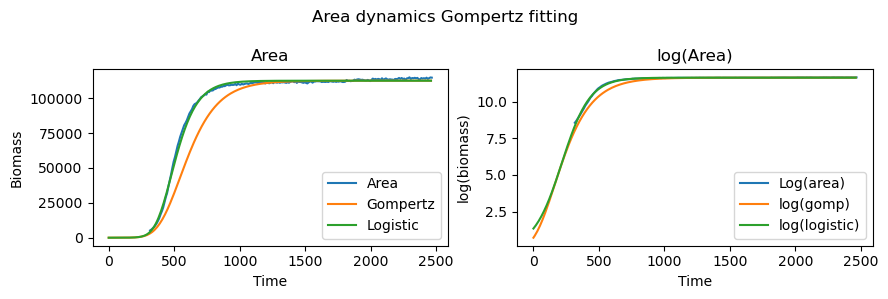

9 params: [13.01517306942499, 0.02186011416294319, -75.23772089796334]


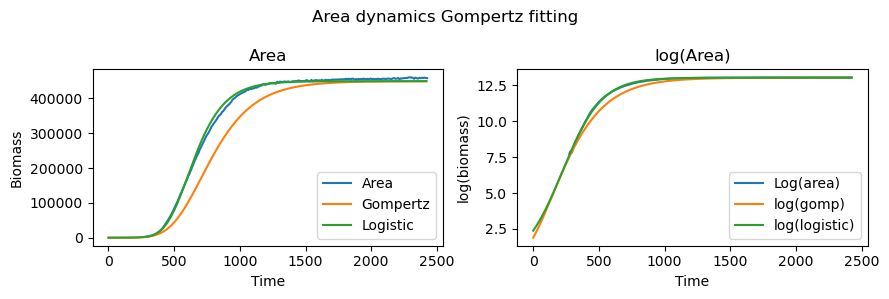

10 params: [12.843705914475668, 0.022671683866897115, -13.878804347807494]


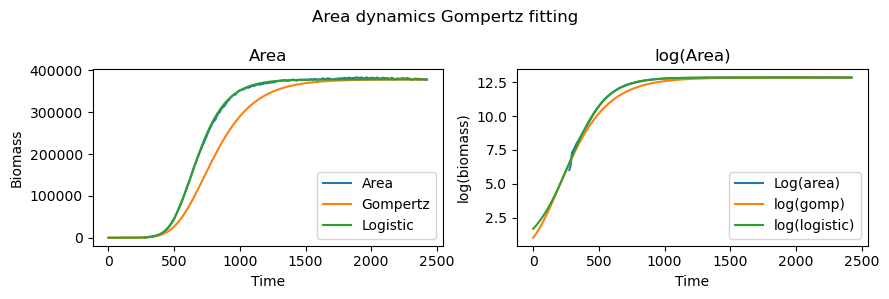

11 params: [12.45863373873703, 0.02125798886632276, -54.13150760318825]


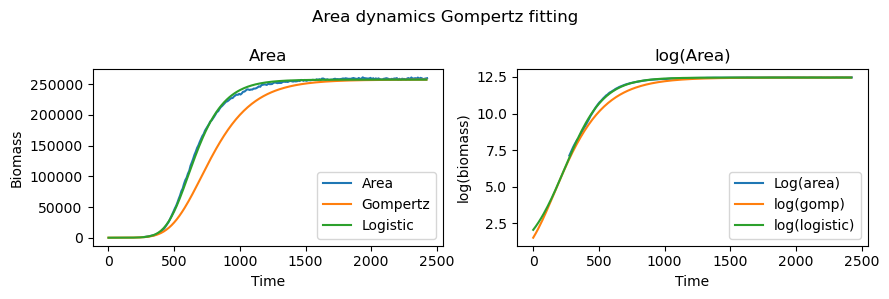

12 params: [12.299328432796369, 0.019463180139362393, -135.35396899887954]


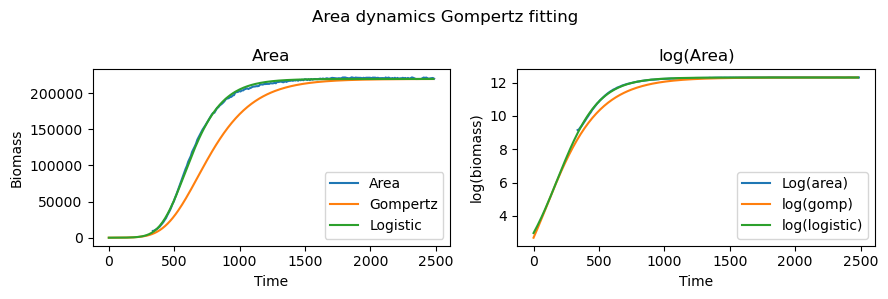

13 params: [12.570176543789994, 0.02165479697637475, -108.22430036414706]


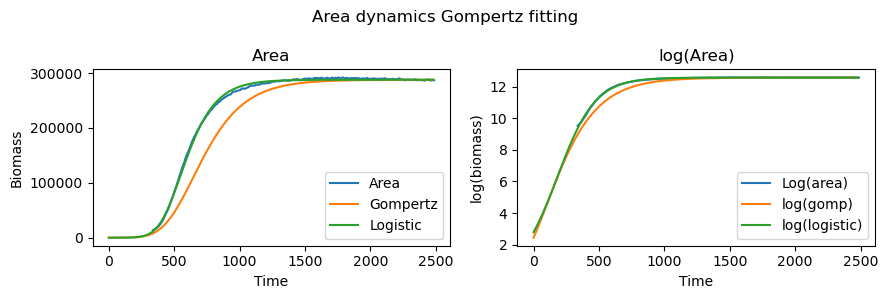

14 params: [12.701104319361956, 0.021703836323175404, -115.47968794315135]


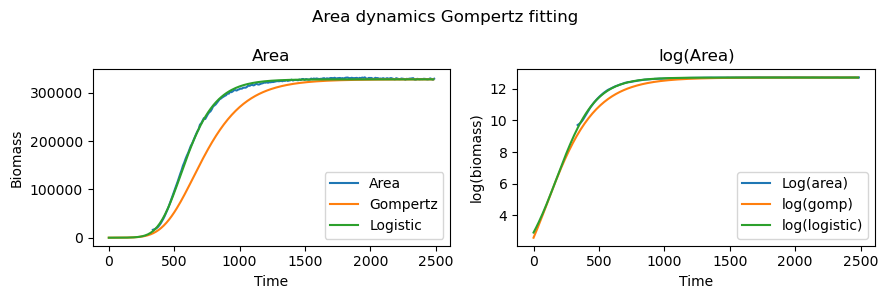

15 params: [12.492396084529142, 0.019734854021382156, -128.2411457973488]


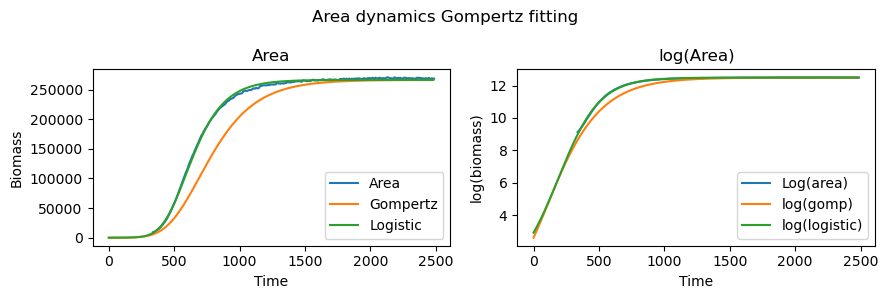

16 params: [12.518791937433146, 0.021688759422179384, -111.64282713117844]


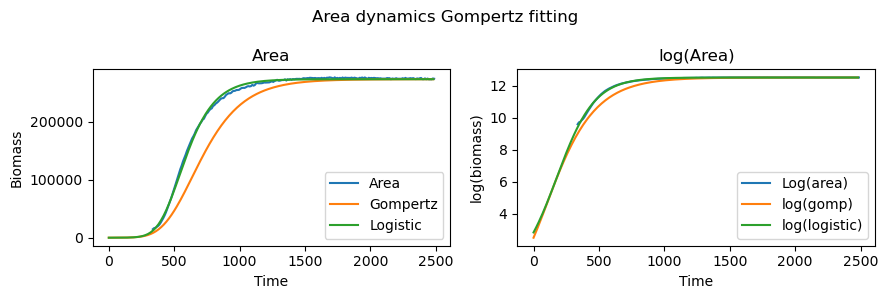

17 params: [12.596097008901333, 0.021260742678315004, -126.0478501850852]


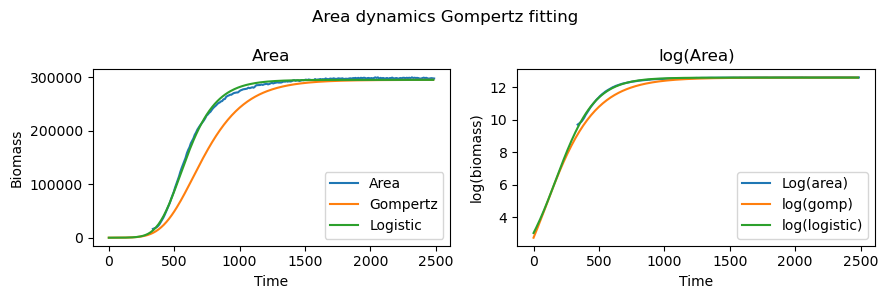

18 params: [13.125041315967616, 0.011353043342710444, -524.0985344046477]


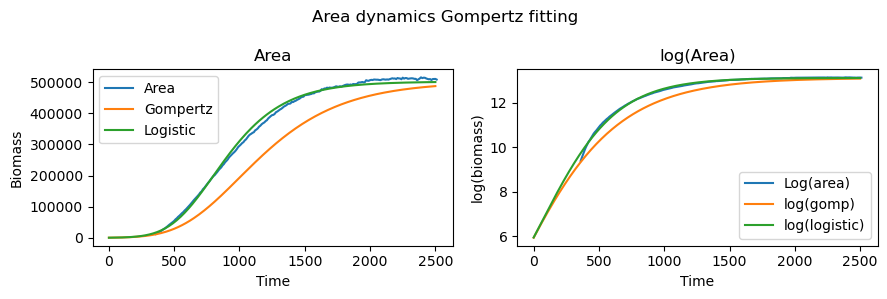

19 params: [12.827134785999307, 0.020955915020279867, -113.0179779370233]


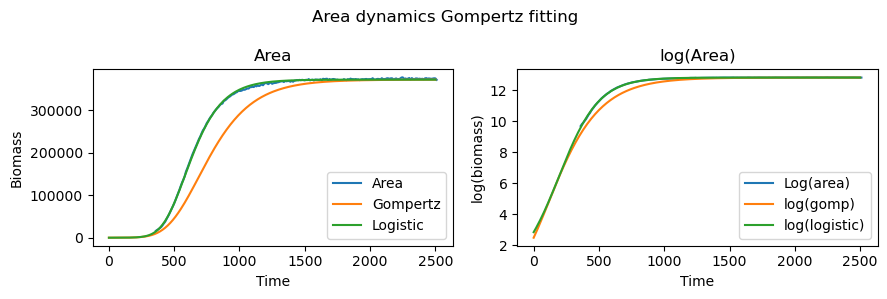

20 params: [13.292621826417054, 0.017259674200504848, -158.2742514496891]


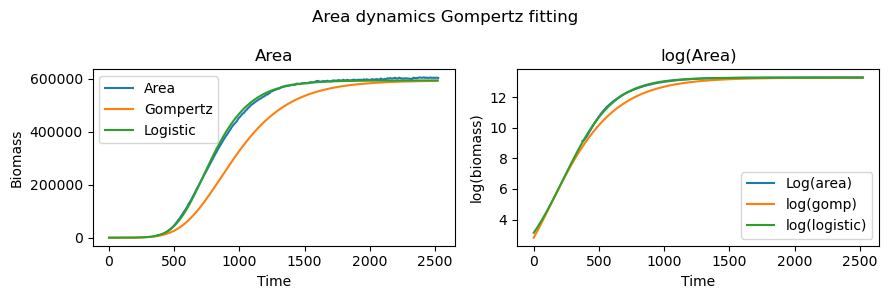

21 params: [13.607746691635604, 0.015075485880008692, -232.45802408218094]


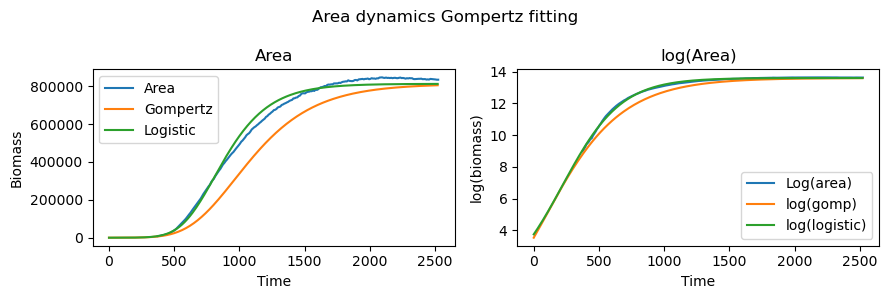

22 params: [13.519541327430463, 0.015313121186163745, -199.8063868633784]


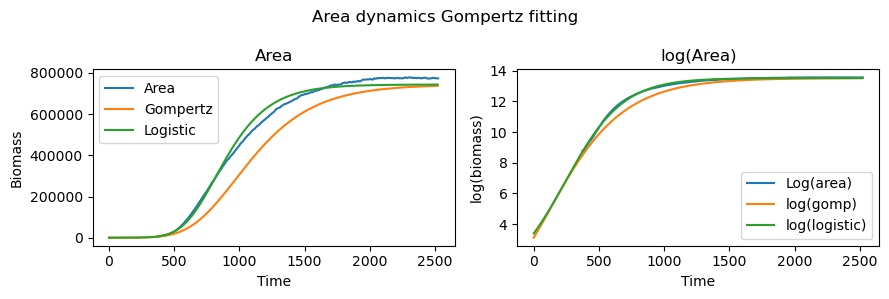

23 params: [11.971346657106377, 0.022463423773167825, 40.53043324495968]


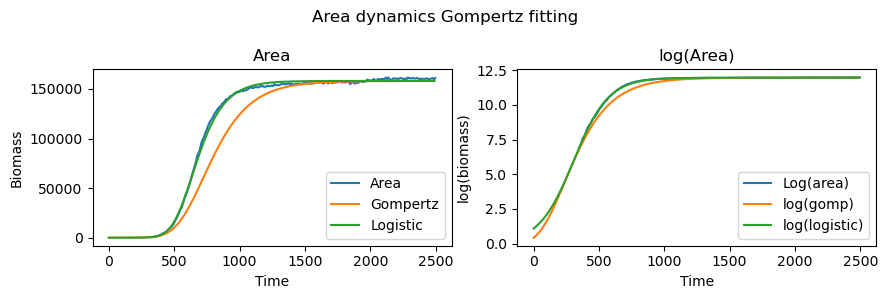

24 params: [11.98212233695737, 0.02277985484126869, 48.56660229143096]


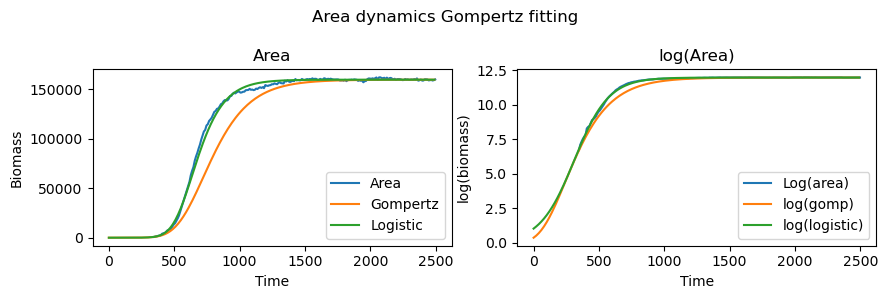

25 params: [12.020327902627931, 0.018593547045783178, -54.9459251092213]


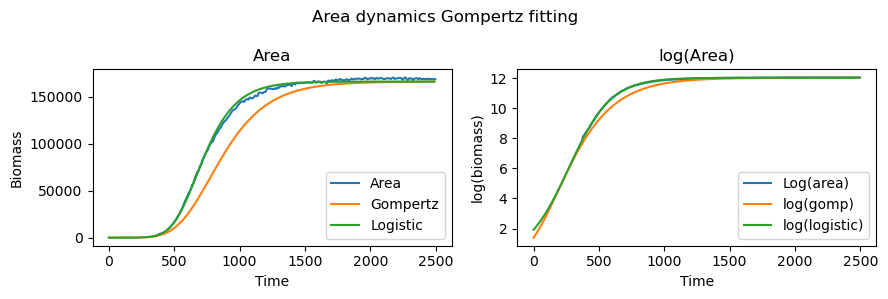

26 params: [12.022768317027326, 0.018041893912596127, -72.04409464451827]


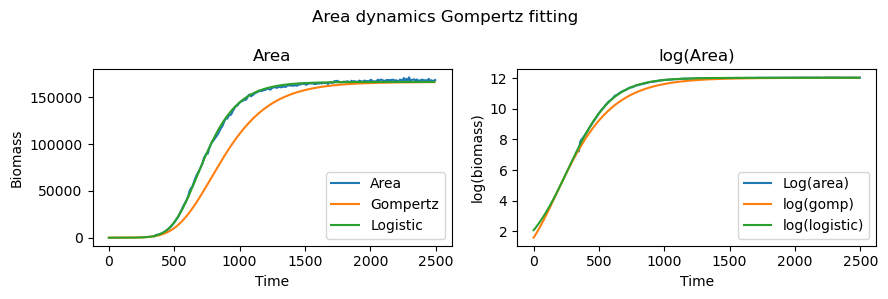

27 params: [12.097523223759474, 0.017232525192126227, -83.21813640773978]


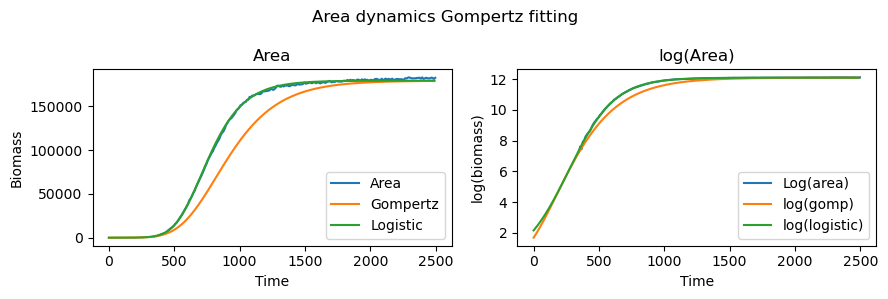

28 params: [12.459810252719173, 0.02128002314933228, -30.9340897476907]


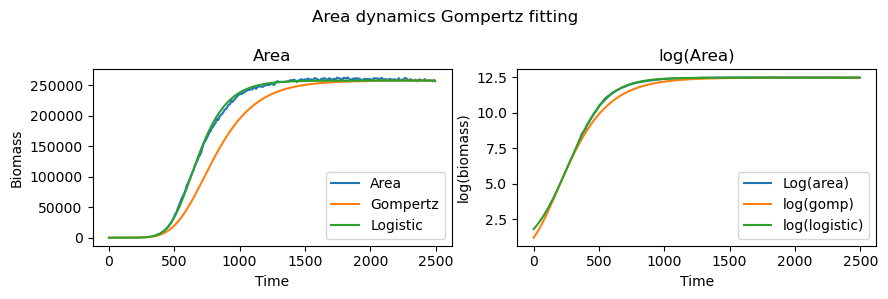

29 params: [12.834145330344956, 0.0205138226640697, -58.602006366157966]


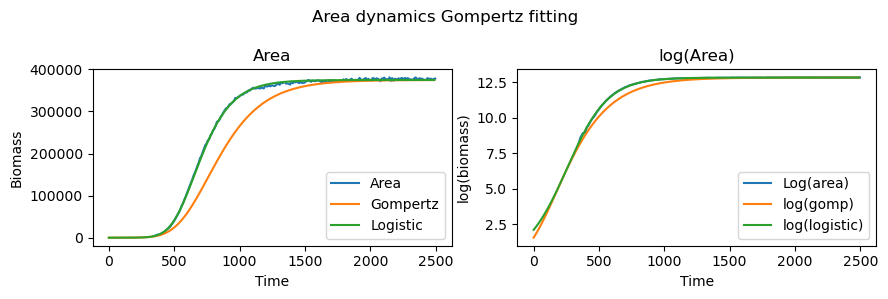

30 params: [11.987490575646845, 0.019046531251653374, -47.0812049634683]


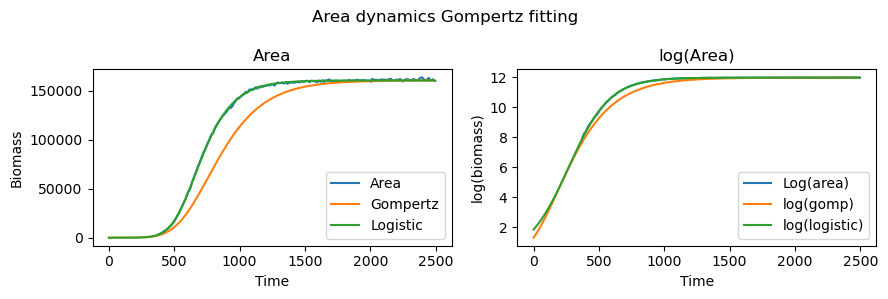

31 params: [12.029862888743782, 0.017420843819225984, -93.77341249351717]


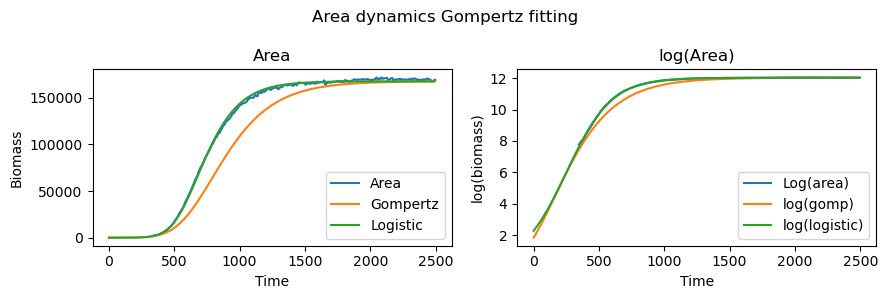

32 params: [12.637854875232351, 0.02167075789805096, -20.78057008312707]


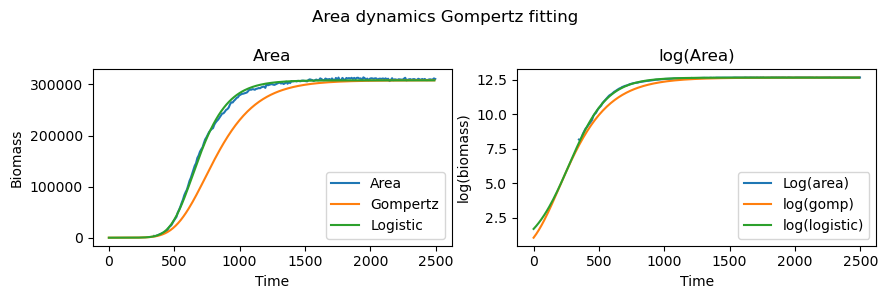

33 params: [11.906808919775195, 0.017306120592438887, -78.28764775238245]


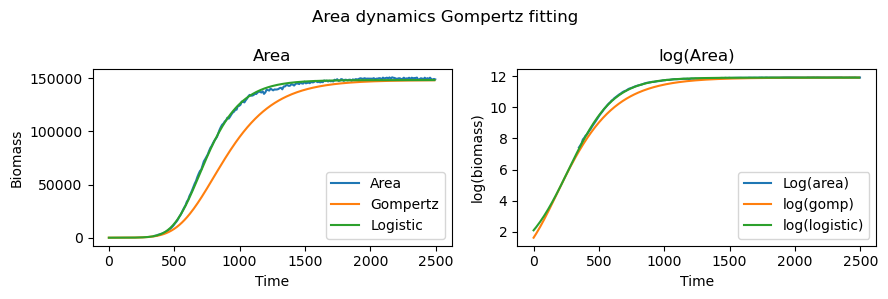

34 params: [13.4532636601978, 0.0197479170428465, -104.46519234119178]


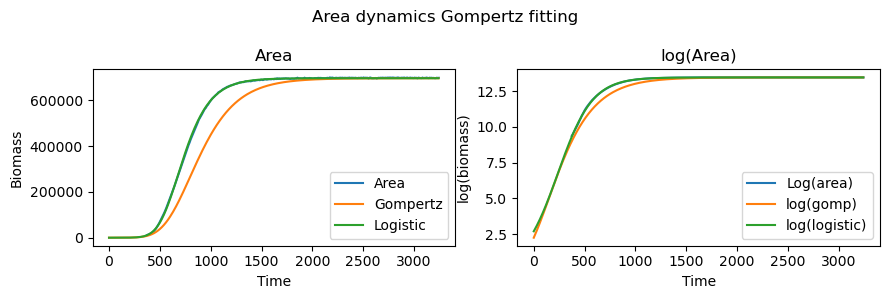

35 params: [13.123283601623239, 0.017869231813805377, -146.31814629083053]


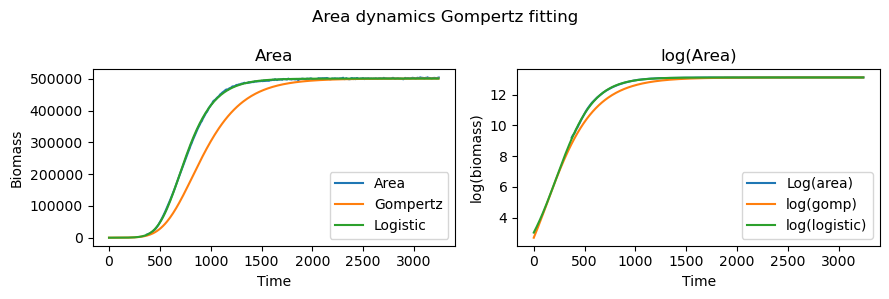

36 params: [13.255762857368266, 0.02359689658847532, 2.2902927594402707]


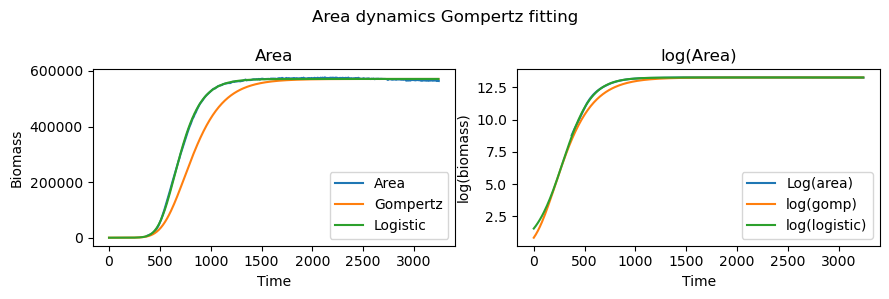

37 params: [13.251648841884723, 0.01805011204702535, -115.99544995007282]


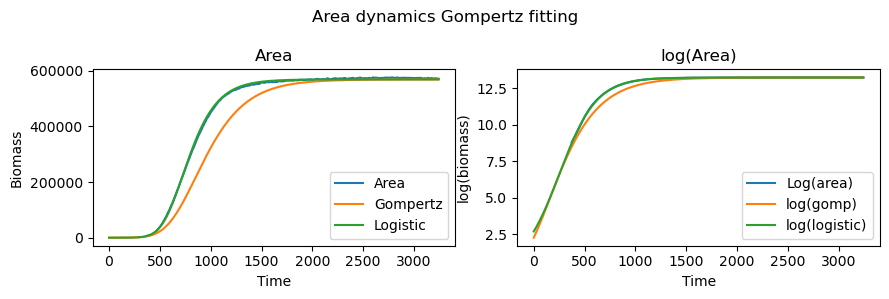

38 params: [12.694251311255993, 0.017692815994064432, -132.47549512410012]


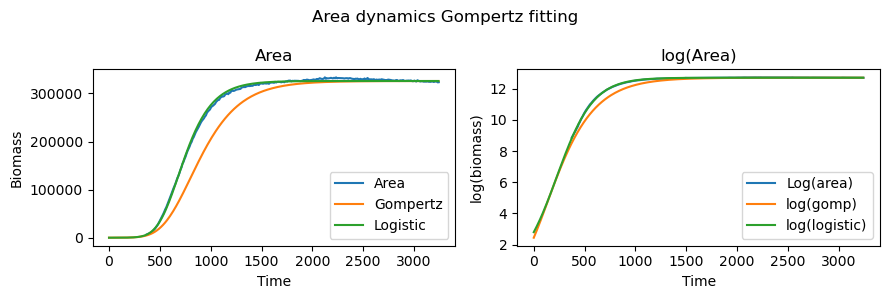

39 params: [13.107689090044127, 0.019646165237737236, -95.86924314756207]


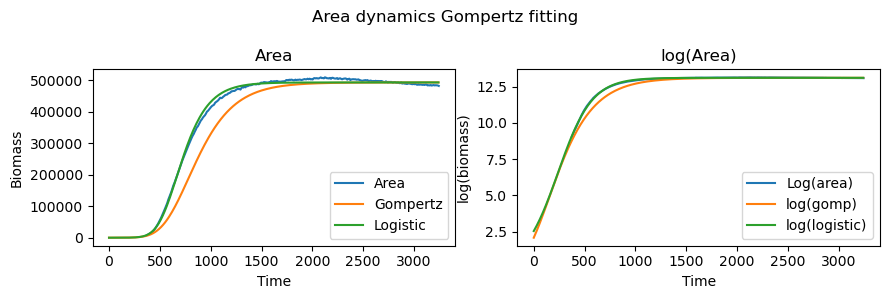

40 params: [13.384891383334612, 0.013428628110396799, -84.36604355463716]


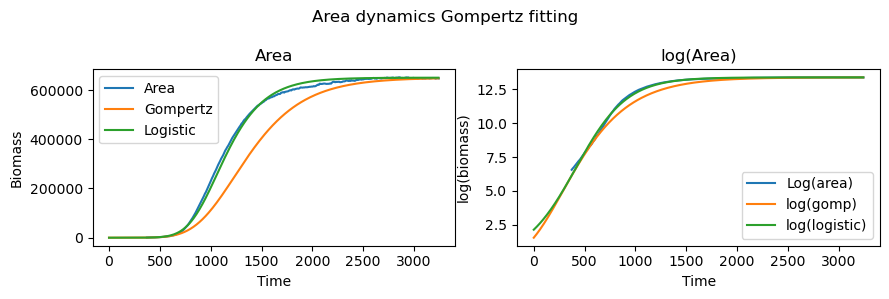

41 params: [11.235597663325715, 0.02482534708264974, 3.538731163109897]


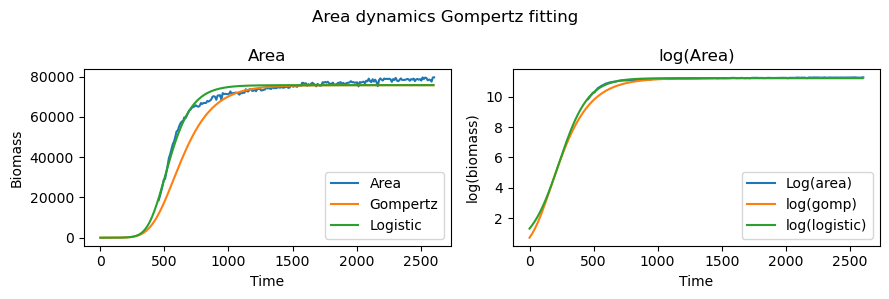

42 params: [11.364949138901626, 0.02570911423727819, 10.42070585368556]


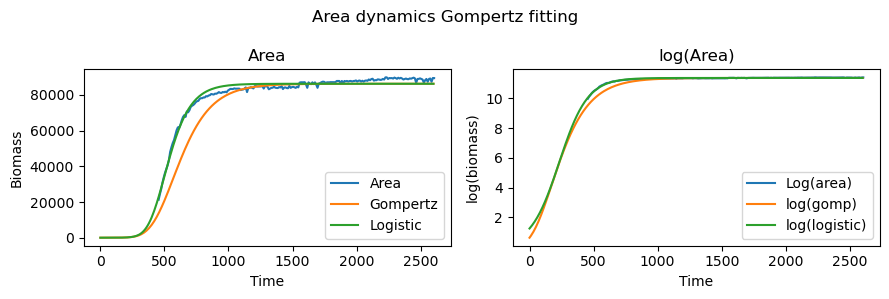

43 params: [10.897067299893418, 0.020767210632260086, -42.445213833388756]


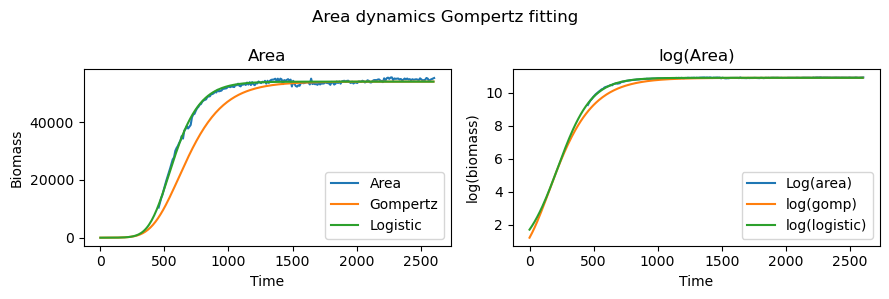

44 params: [10.808724895106952, 0.017317944523739512, -133.7534400452502]


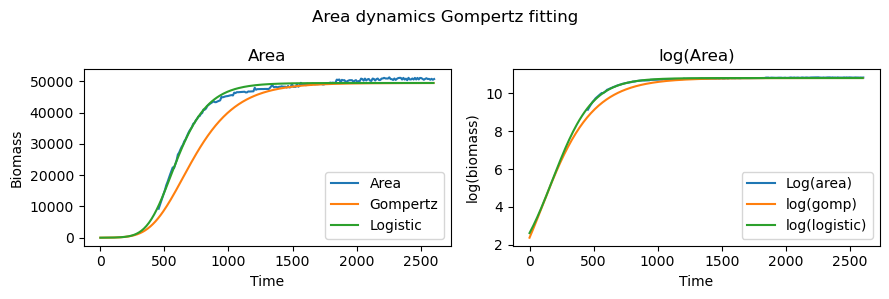

45 params: [10.723475394627037, 0.01942906230317999, -55.48889440971053]


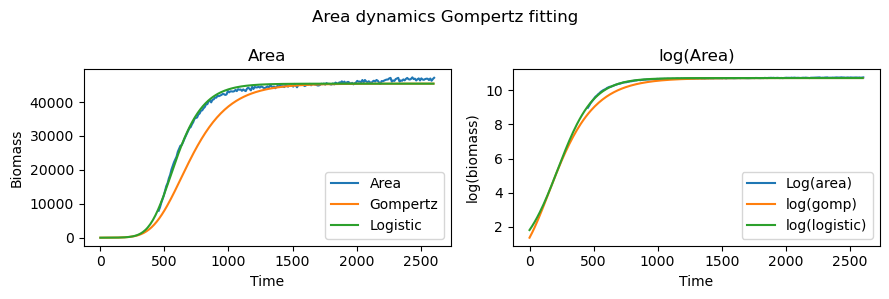

46 params: [10.761746440994186, 0.02051704108152017, -15.70210745972844]


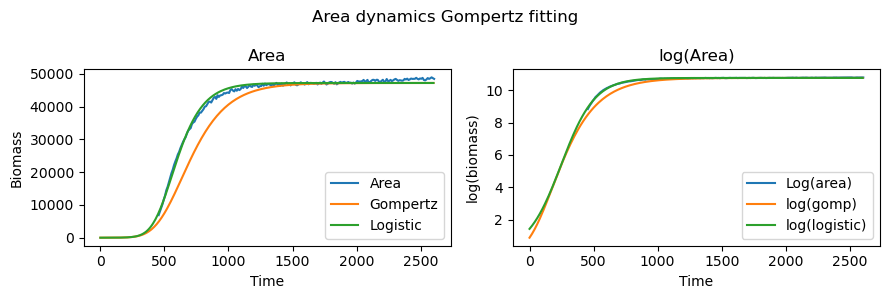

47 params: [10.811907465911762, 0.020142353975503118, -38.21856385459463]


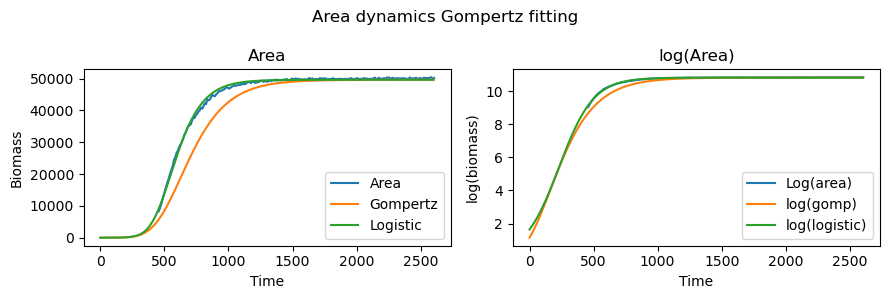

48 params: [10.972964369996136, 0.02655114677005191, 91.06856057134088]


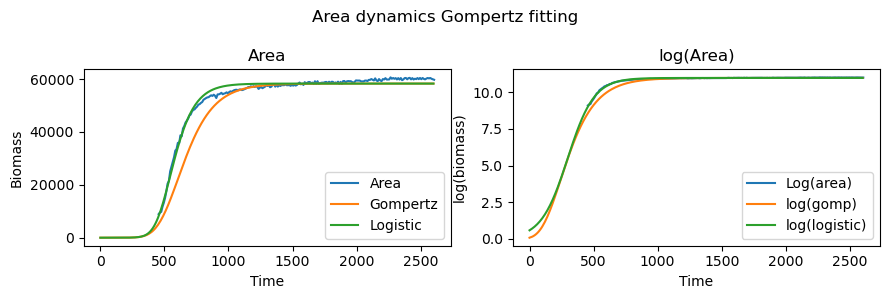

49 params: [11.223493403884712, 0.025518716032865218, 46.06871122175777]


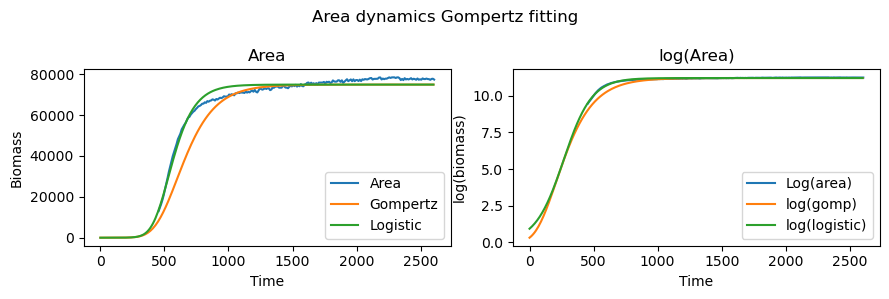

50 params: [11.240687022661694, 0.0289307272037272, 112.08872287153228]


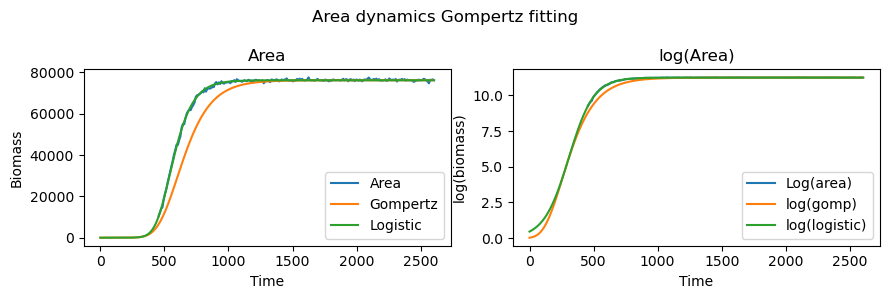

51 params: [11.36871048539643, 0.02541271526693484, 3.3527602523792566]


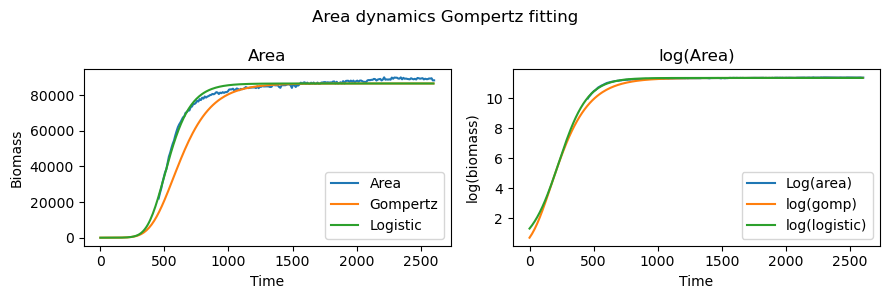

52 params: [10.134730382615267, 0.020882804637686048, 36.53100236586767]


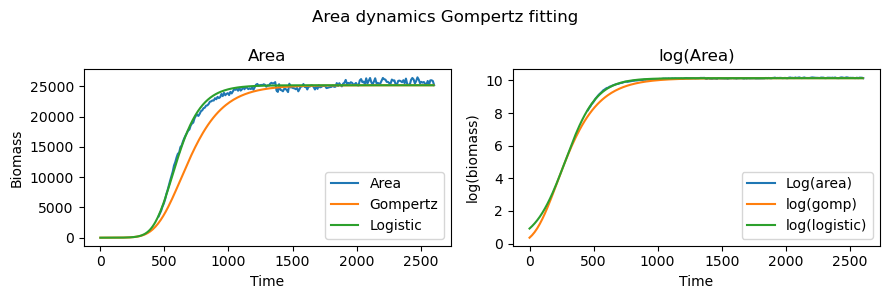

53 params: [10.935956663095174, 0.019679893976916742, -85.49079393048028]


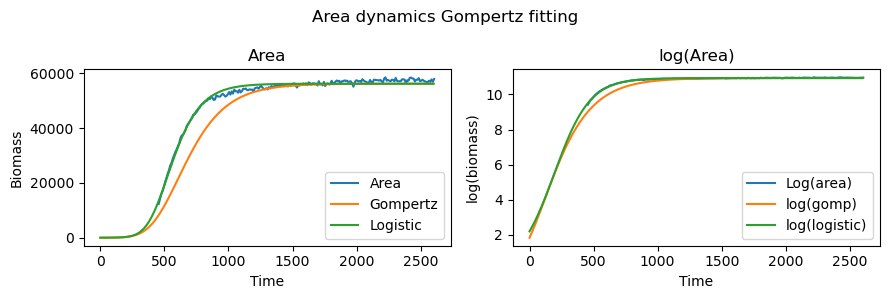

54 params: [10.810017781587248, 0.017409451778163363, -131.1392841087492]


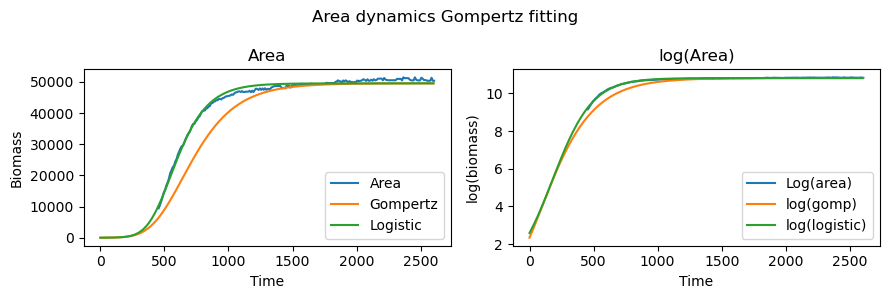

55 params: [10.316014386172856, 0.019151479878391463, -20.250765251958185]


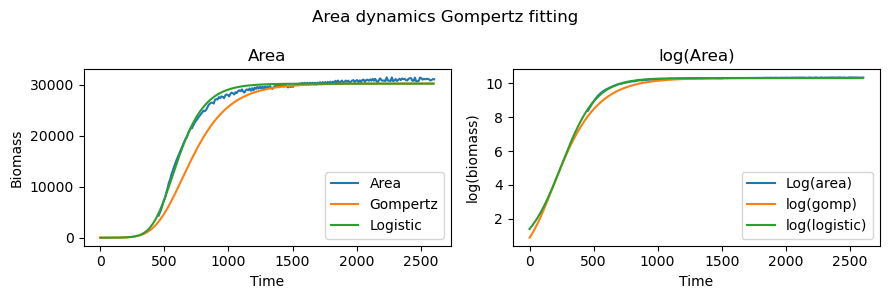

56 params: [12.422398090326942, 0.02340343863315792, 14.413765704624659]


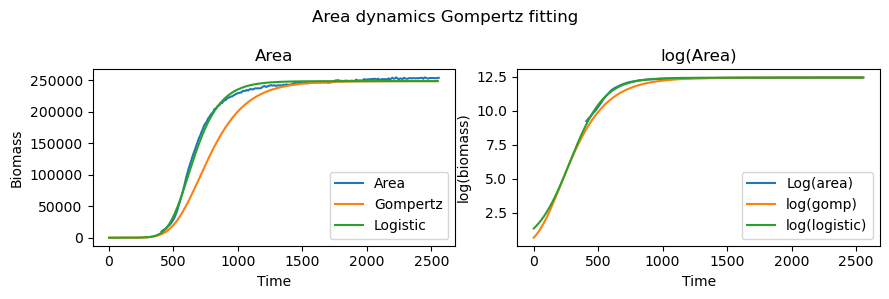

57 params: [12.634391696957515, 0.023138403367255443, -25.751965764216266]


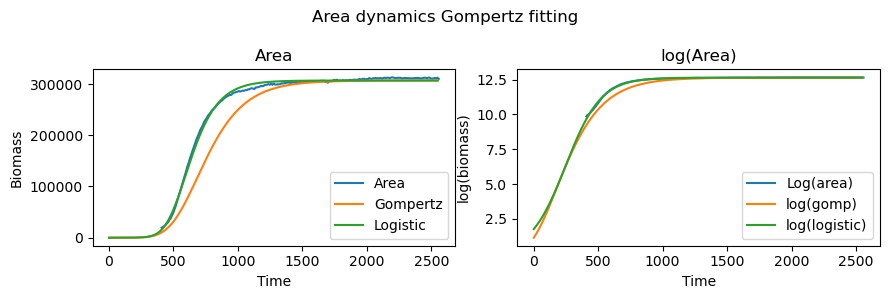

58 params: [12.153468676656106, 0.02326057842920485, 27.36608177250635]


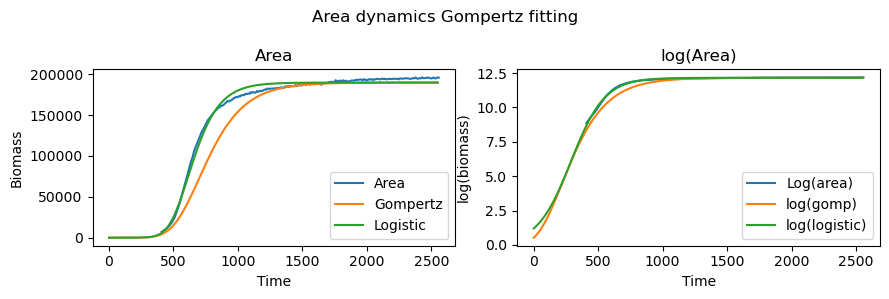

59 params: [12.855945895098506, 0.02563592086947793, 57.242890467969]


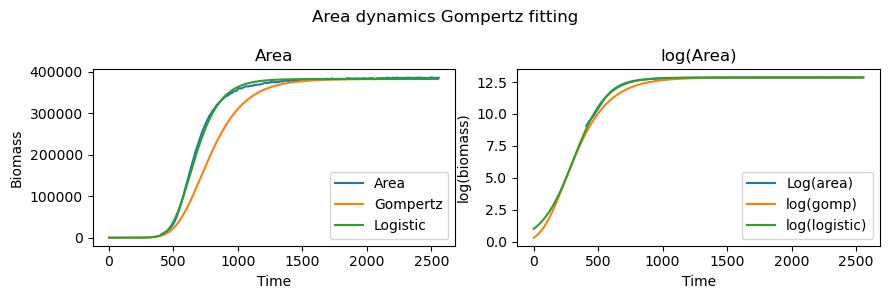

60 params: [12.50970537613161, 0.023237841249210505, 14.11611237919874]


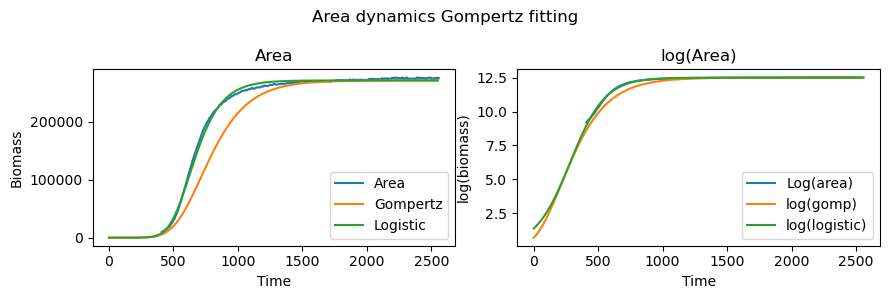

61 params: [12.318496465416104, 0.022291015194801953, -15.12051422520215]


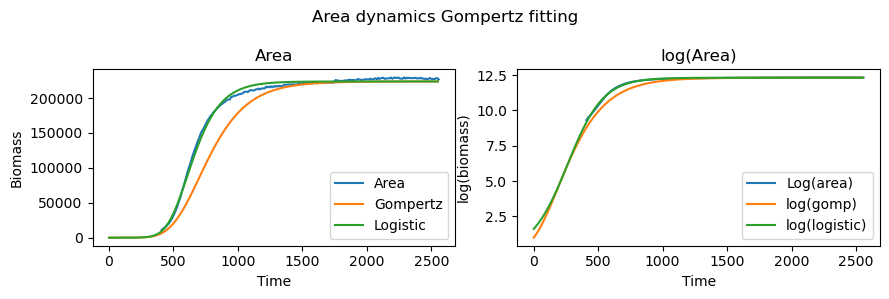

62 params: [12.3744113705664, 0.021069403404796763, -10.744258621600098]


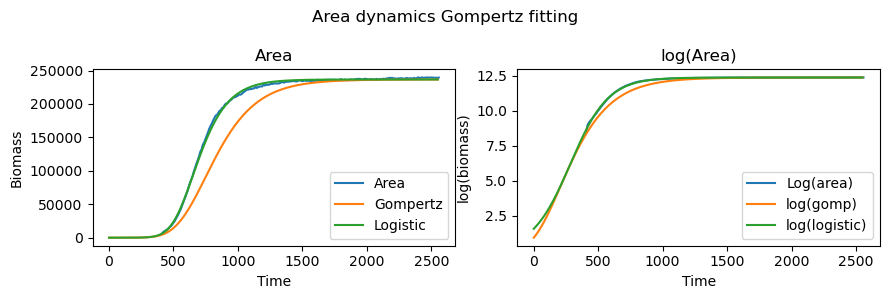

63 params: [12.176786147076372, 0.019969081355932856, -54.19177008007473]


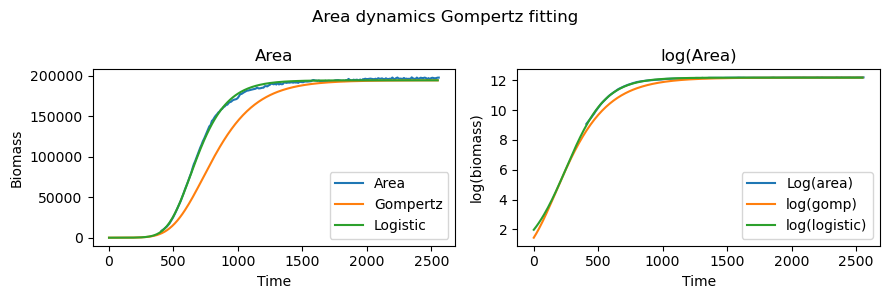

64 params: [12.35131299774589, 0.019588337643176745, -58.12351867621416]


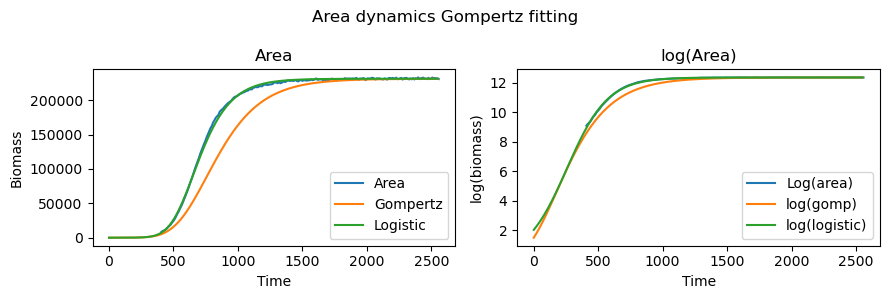

65 params: [12.5194815324133, 0.021286842436884054, -15.34011359709582]


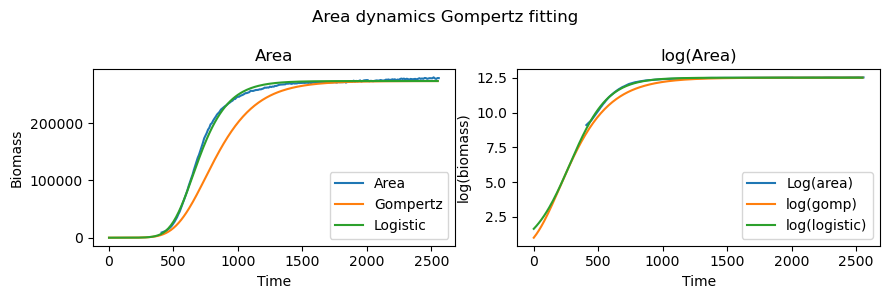

66 params: [12.370200080748505, 0.020763751383993573, -19.39729514210202]


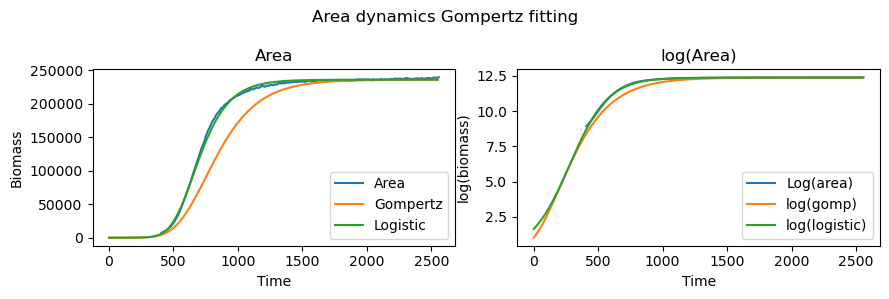

67 params: [12.730337609720658, 0.016651974399861616, -112.23009563909365]


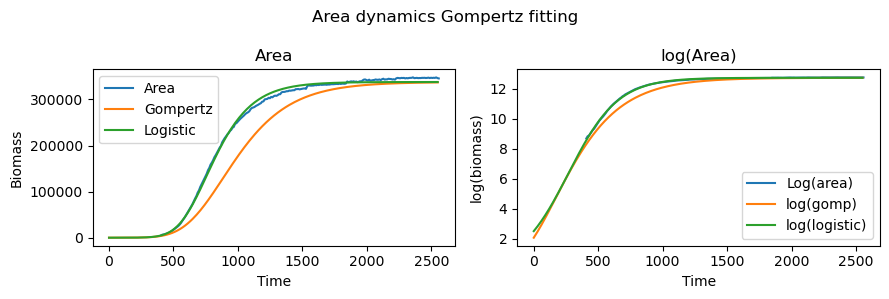

68 params: [12.410275592797298, 0.016497663658329657, -128.68723279441957]


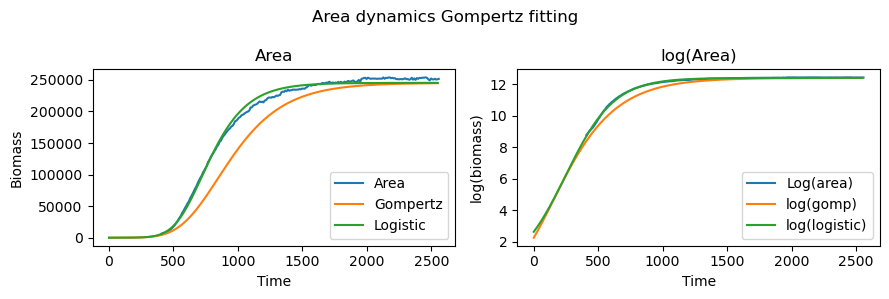

69 params: [12.561523692156308, 0.017020809623430878, -88.37691374957932]


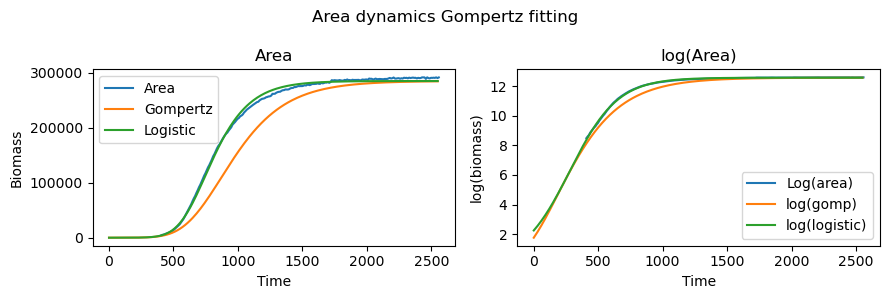

70 params: [12.59509616525908, 0.0171970223922109, -92.35830272401478]


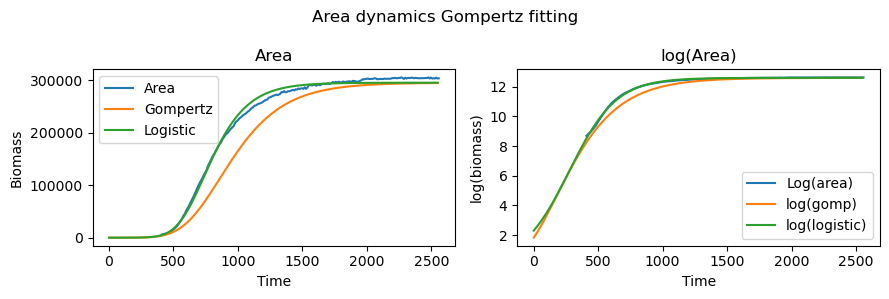

71 params: [11.659143845914958, 0.024202931372360414, 0.217419994731209]


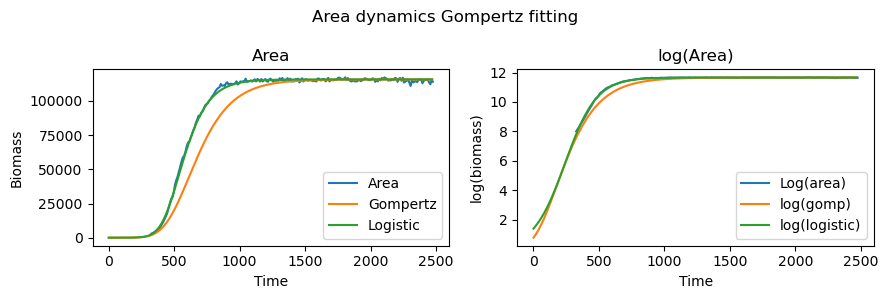

72 params: [11.643482633100312, 0.02349326648065565, -4.9138349524665585]


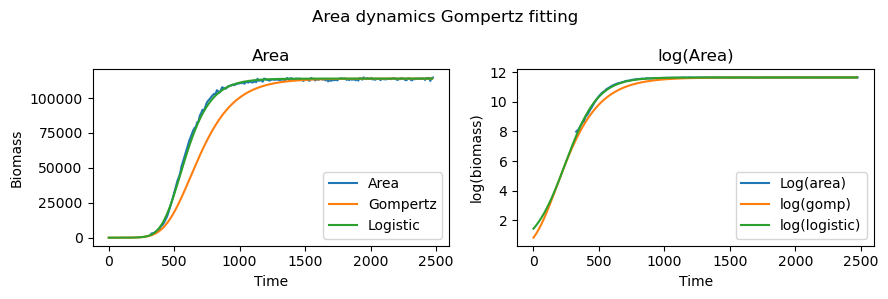

73 params: [11.901291703216895, 0.024196056787662866, 32.66872277182563]


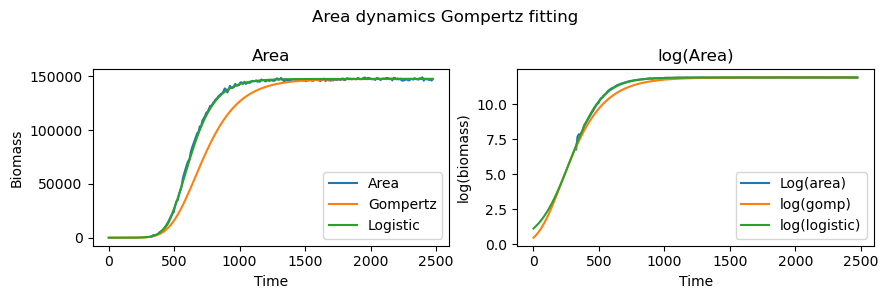

74 params: [11.850794963412408, 0.023949423264321975, 16.904406430787926]


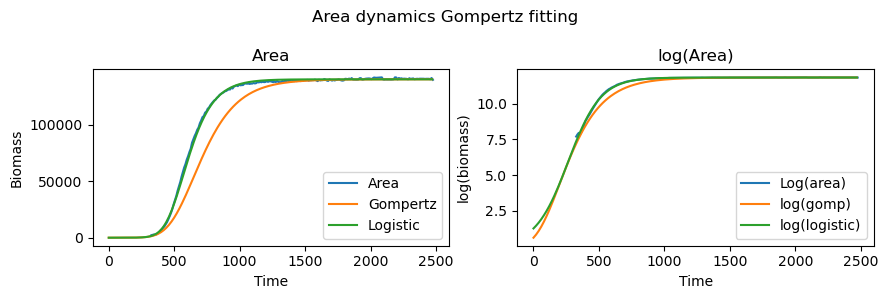

75 params: [12.111255282006086, 0.02494159510762695, 14.201295279414603]


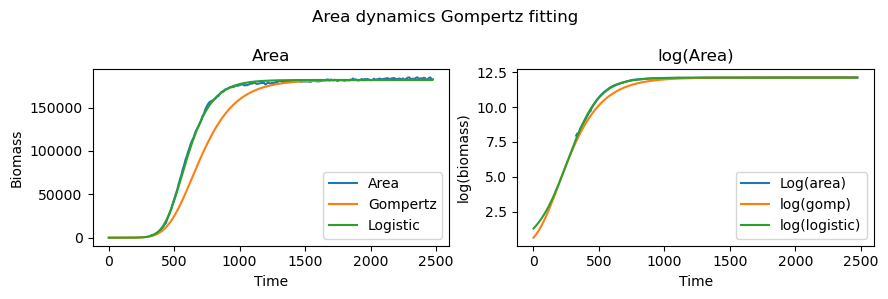

76 params: [12.223857250596671, 0.025115478774170905, 17.76097742368021]


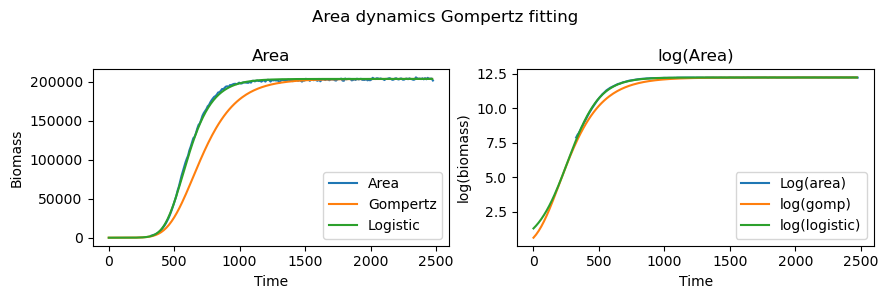

77 params: [11.5159868409948, 0.022666771647894778, -10.415429582348866]


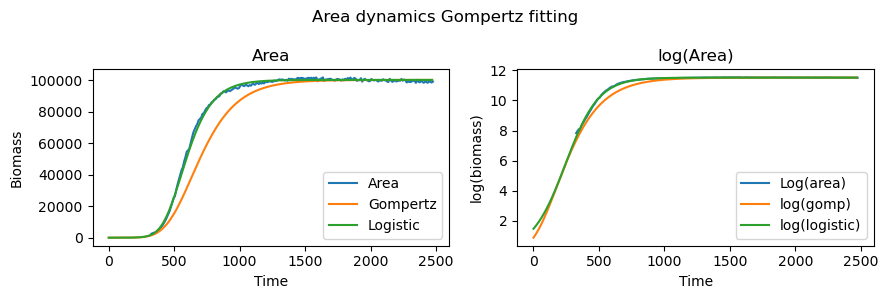

78 params: [11.363640202942117, 0.022393397773047302, -25.60684016495349]


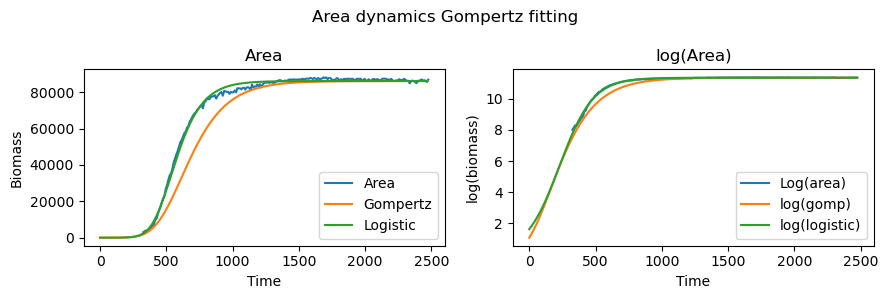

79 params: [11.4023920730984, 0.02228653375528777, -24.913717318083453]


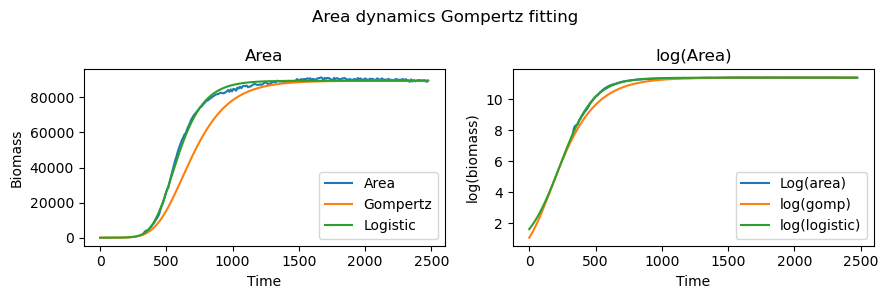

80 params: [11.587313484331283, 0.023216482423571, -9.344888586933326]


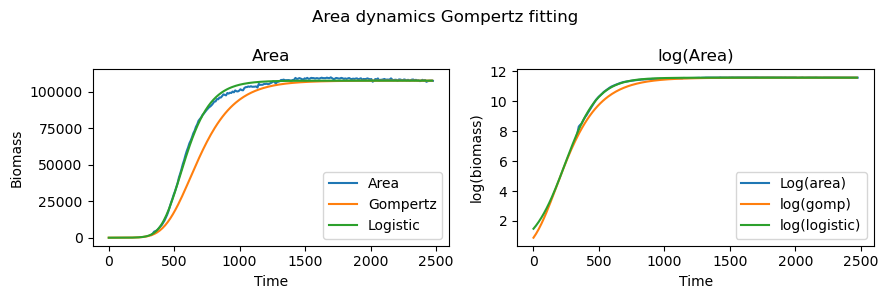

81 params: [11.590194052899013, 0.020724785765490132, -15.250853267368694]


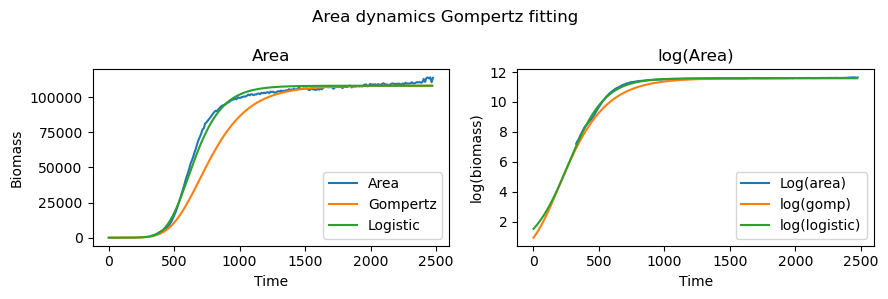

82 params: [11.44343933746101, 0.02109520143191252, -0.5297145918351005]


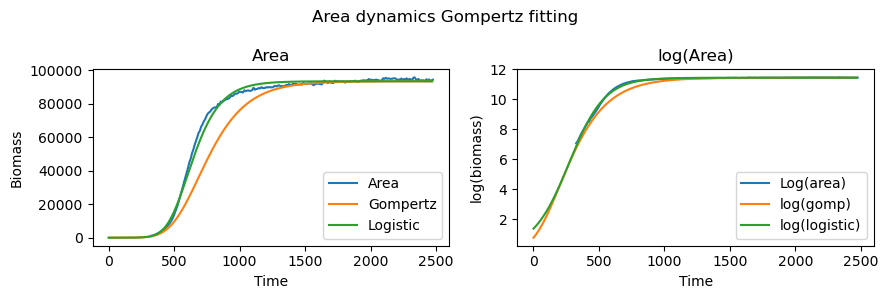

83 params: [11.565272945312389, 0.022683001172210882, 25.063927629551795]


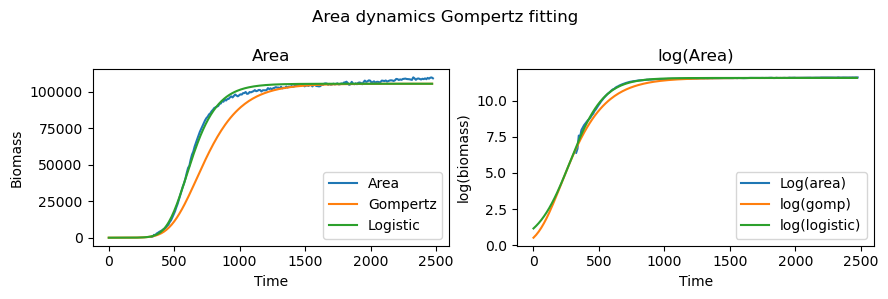

84 params: [11.739920052603091, 0.021979738190543555, 18.03552028377773]


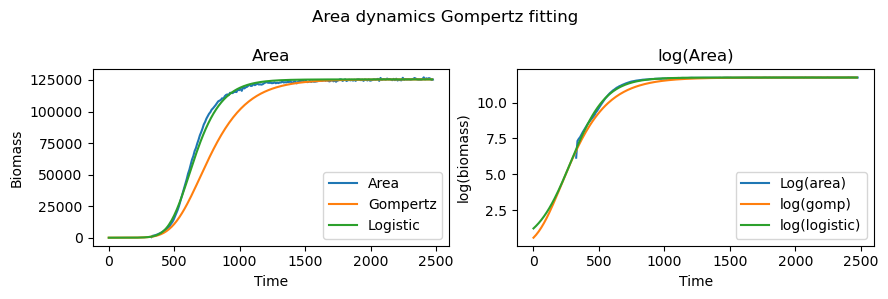

85 params: [11.905239387970077, 0.021190590857254245, 4.981884463115481]


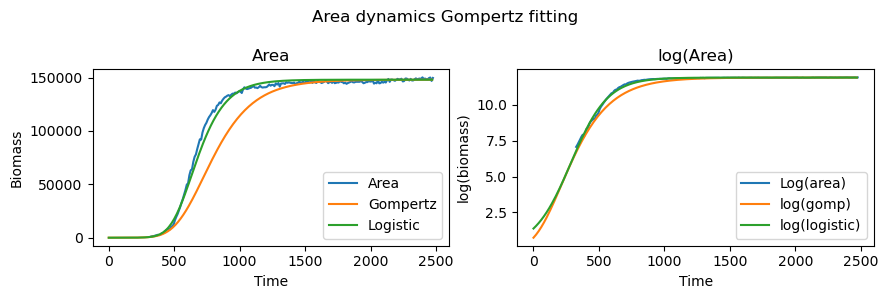

86 params: [12.068802003745203, 0.0236741626118099, 38.56529048355279]


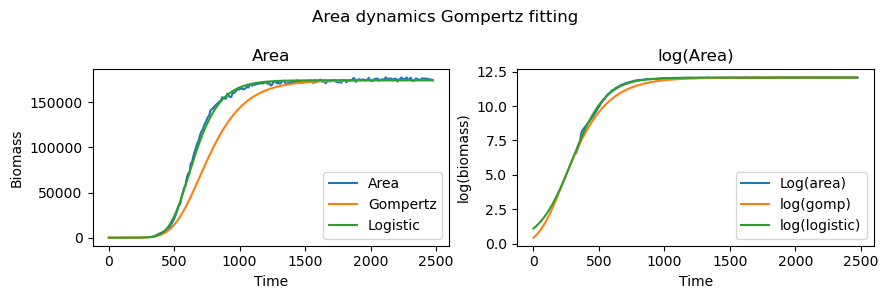

87 params: [11.817708502170438, 0.02109076338784671, 3.3570716247960797]


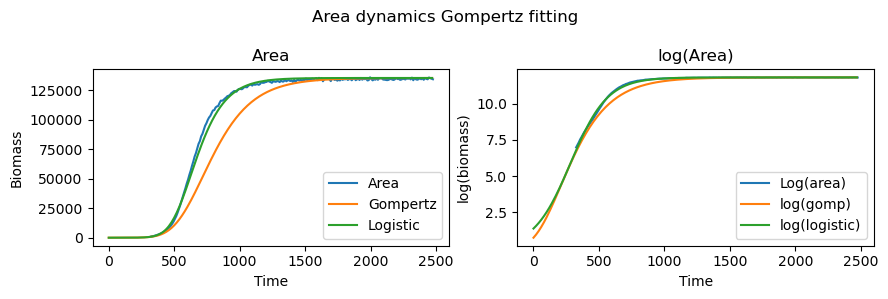

88 params: [11.798065404236757, 0.02149365836732217, -8.415919522794006]


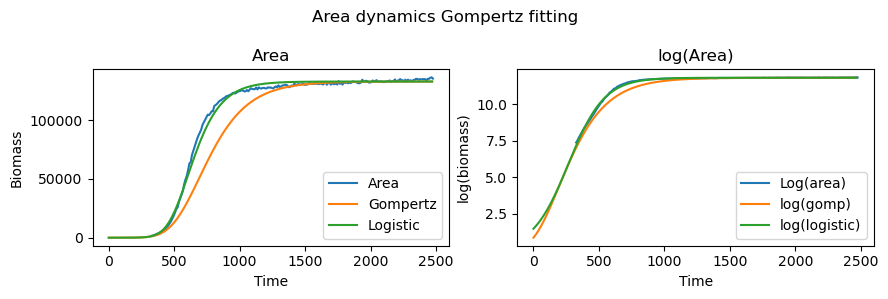

89 params: [11.776489401437653, 0.02432631292954845, 51.6427439113039]


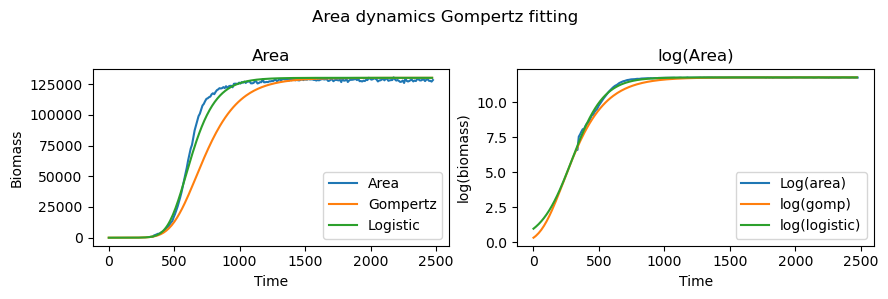

90 params: [11.47103142708478, 0.0242825943548324, 58.686222712889]


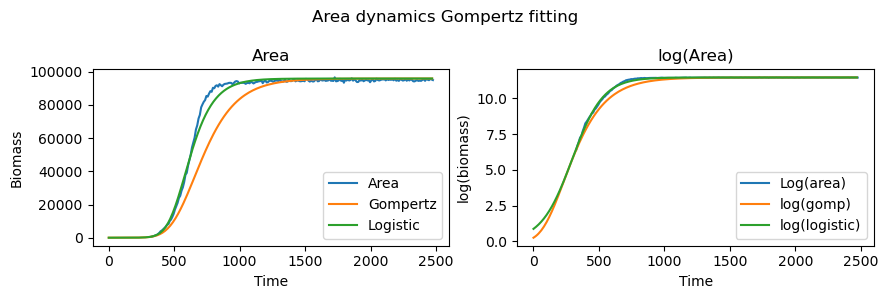

91 params: [11.625263870300254, 0.022299229666181114, 27.51989826599335]


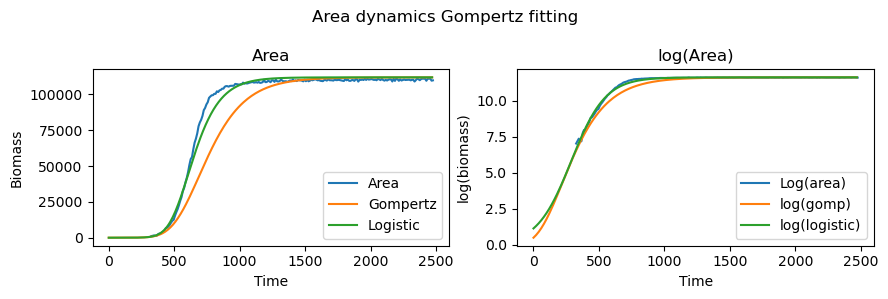

92 params: [11.101687641010175, 0.019342218780699375, -100.1954240167439]


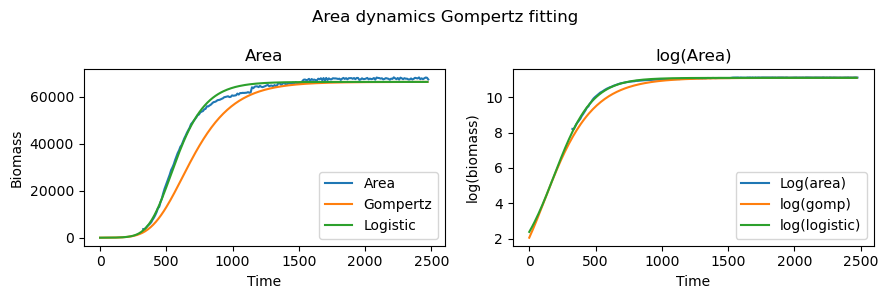

93 params: [11.430032932780472, 0.021267912133780403, 3.317413718401994]


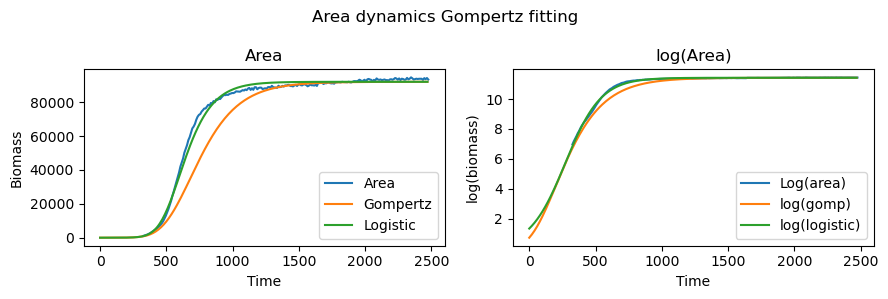

94 params: [11.355023602524858, 0.020911049955308934, -0.21215334194976312]


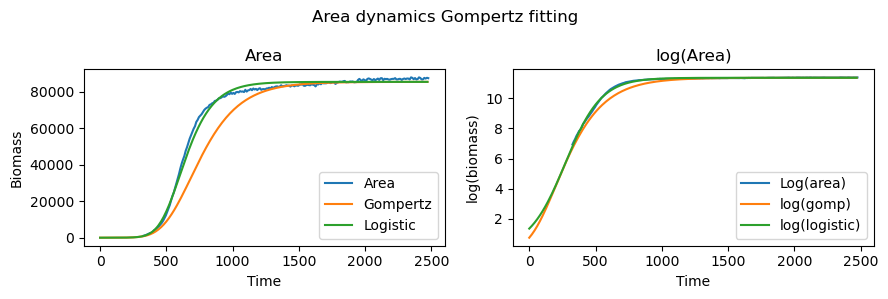

95 params: [11.576172419839027, 0.021626228157530812, 9.847742139438402]


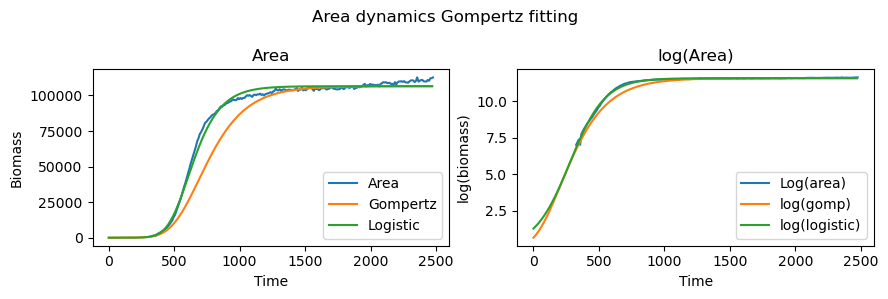

96 params: [12.62904318120163, 0.020688733551082382, -68.17771235774725]


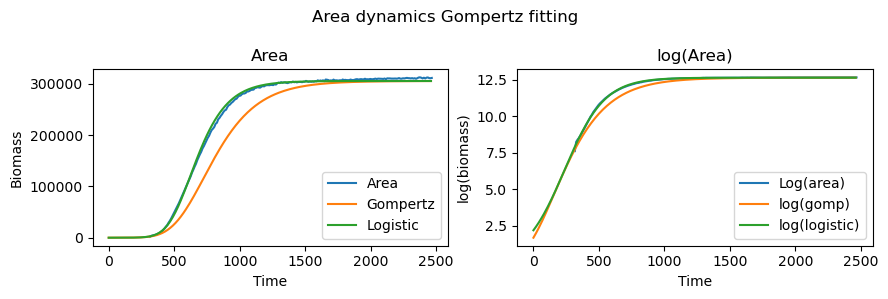

97 params: [12.418293193959945, 0.019697298219951566, -88.02557220918371]


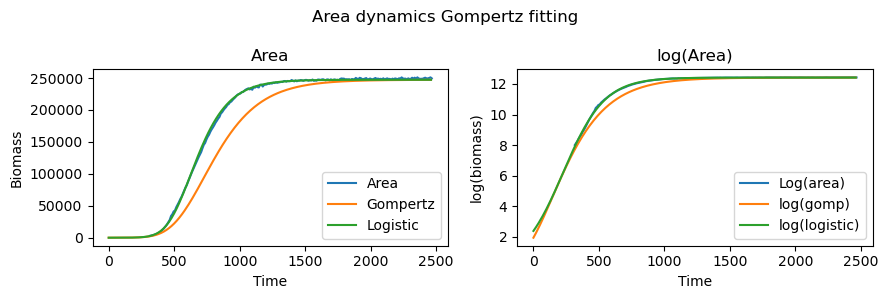

98 params: [12.11728827645177, 0.018668190120306363, -101.91743056725569]


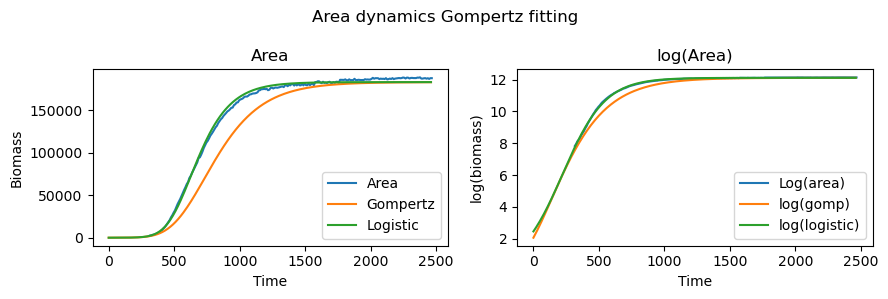

99 params: [12.31165203272307, 0.019183041003343424, -95.30647175052582]


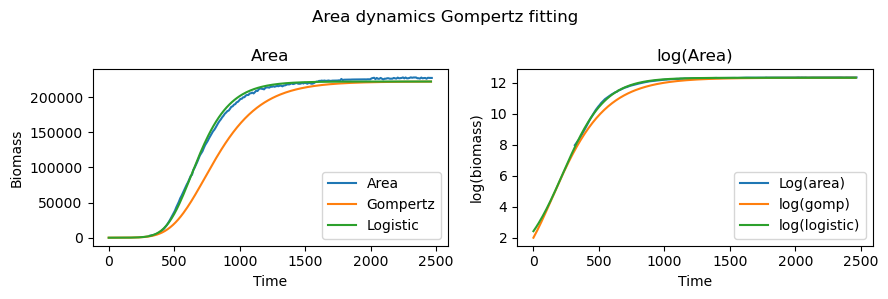

100 params: [12.110501768088069, 0.017518218316618917, -123.55379974265063]


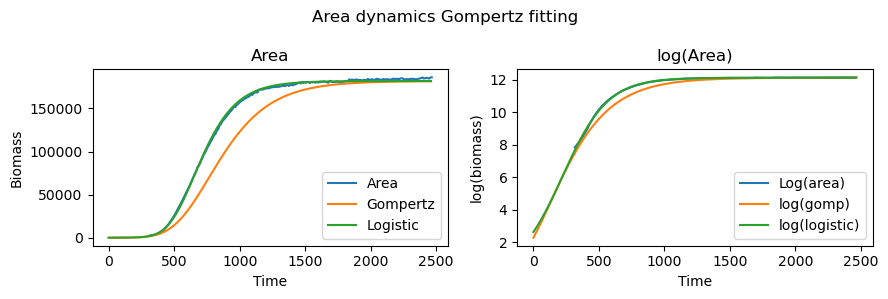

101 params: [12.15433127212536, 0.024737220970529033, 25.477430915109743]


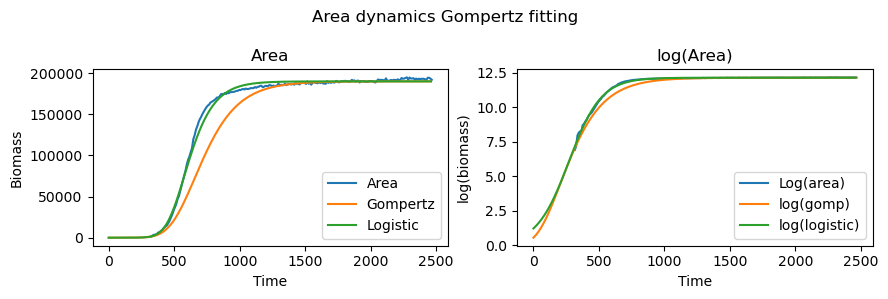

102 params: [11.817984379019528, 0.019451684703374484, -91.84502438478862]


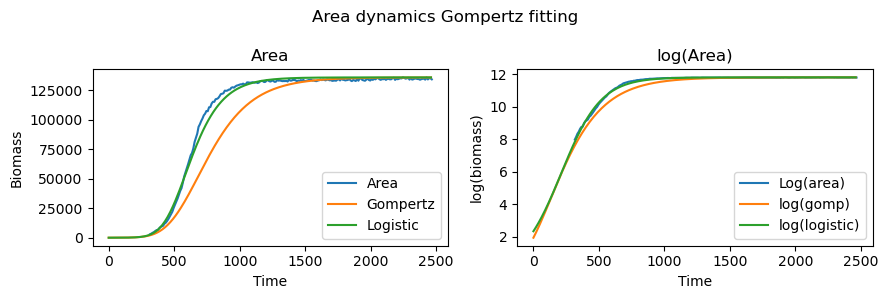

103 params: [11.815483485494791, 0.020939779914364322, -40.79841432677406]


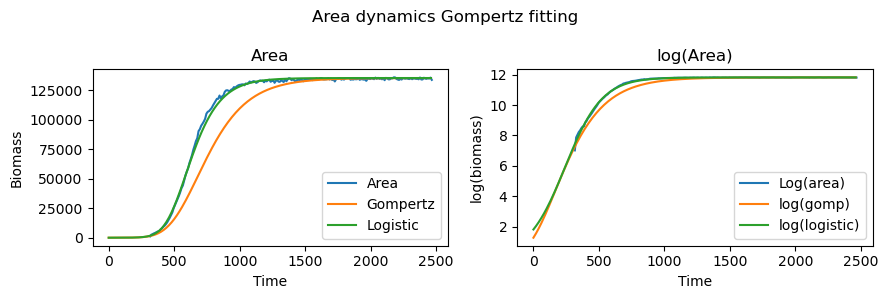

104 params: [11.813539214813655, 0.02001919118343915, -73.01216063634942]


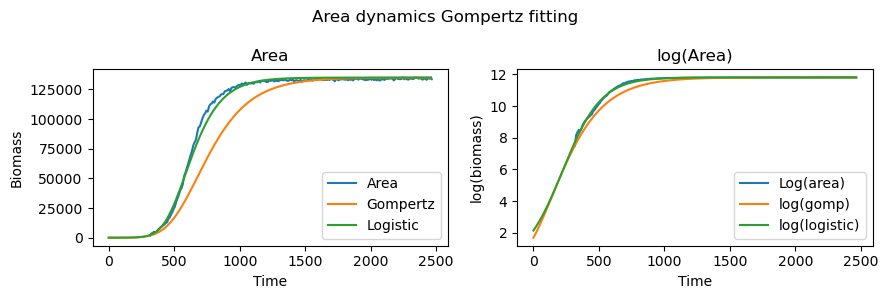

105 params: [11.568400511874973, 0.019553051885893655, -72.9268447665534]


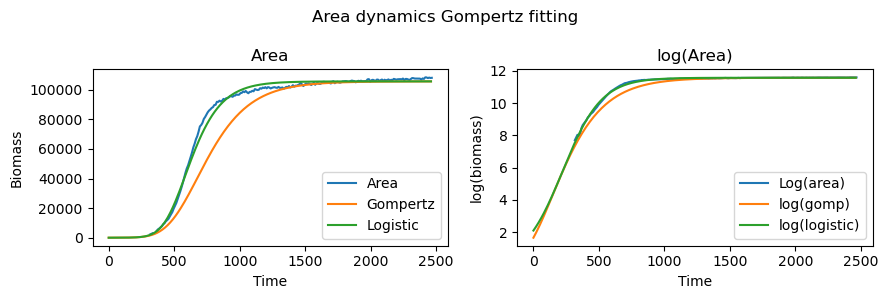

106 params: [11.359032517144865, 0.021570319881841705, -20.208622751743523]


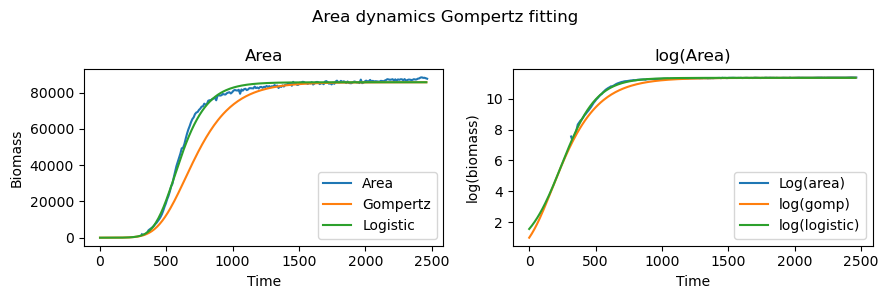

107 params: [11.4465851001667, 0.021372765882181417, -29.451094443904303]


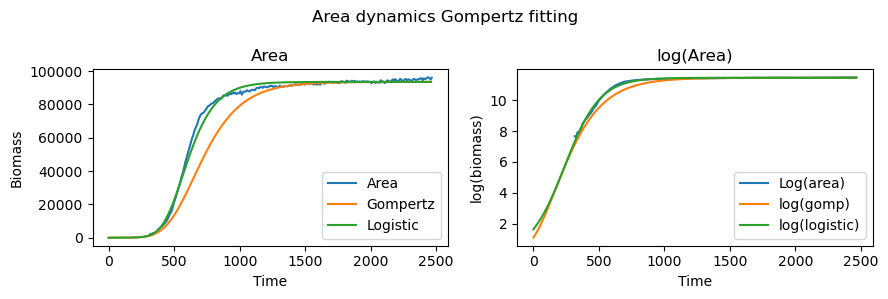

108 params: [12.207379854800761, 0.03029826728280036, 82.54265153280078]


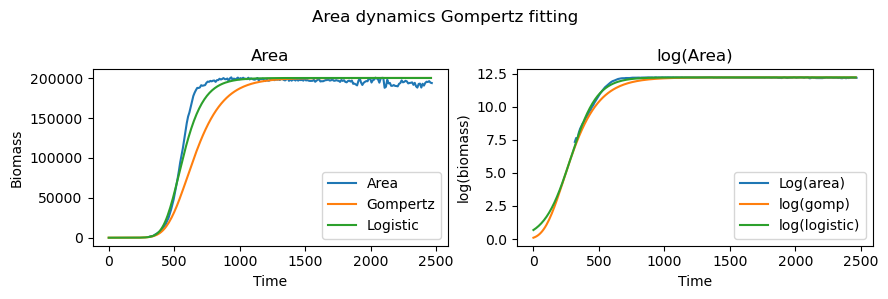

109 params: [11.47333972966948, 0.026097557959387504, 26.44797475875315]


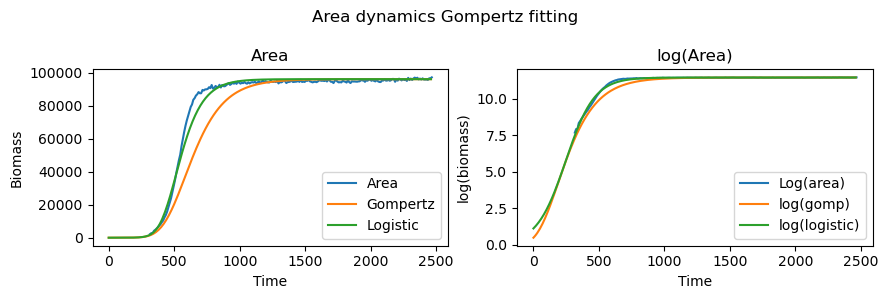

110 params: [11.493160855729306, 0.027364104558304805, 51.10876854067929]


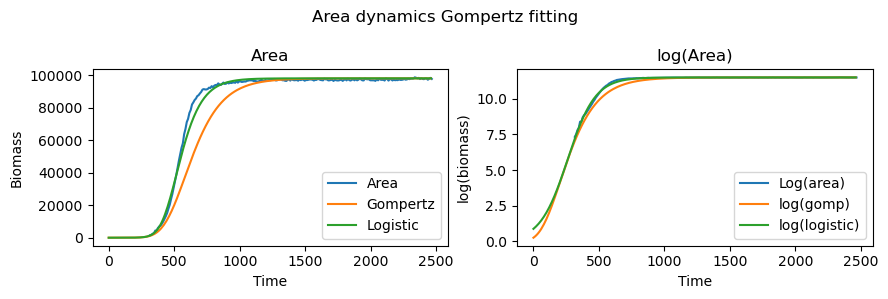

111 params: [11.59386011096647, 0.021655811771289987, -82.71721476200793]


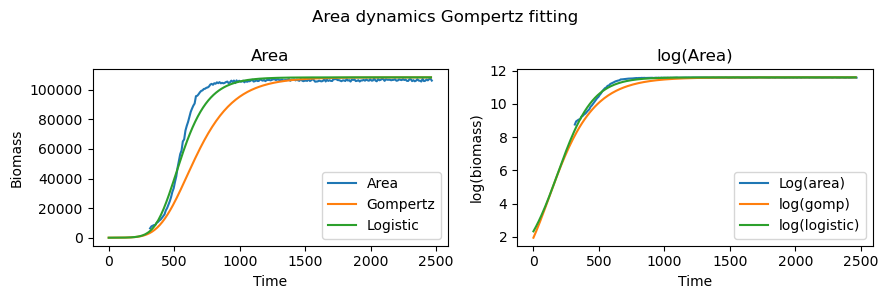

112 params: [12.086830827315195, 0.028676616718405823, 46.122083408420224]


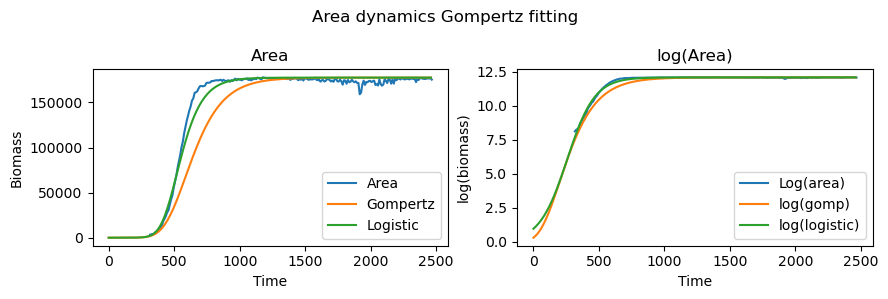

113 params: [11.771380191437848, 0.02845331335695427, 51.50386743232246]


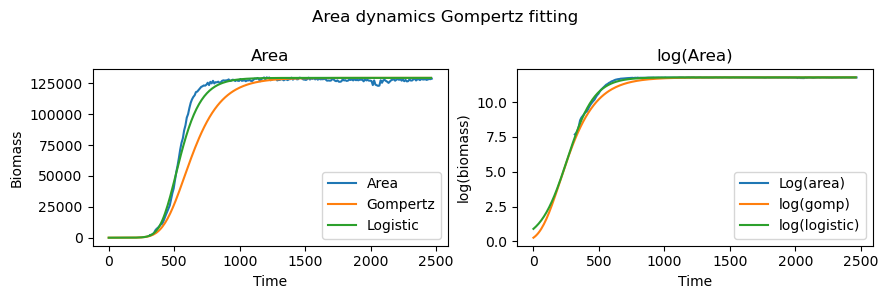

114 params: [11.81435913912203, 0.021449799900587388, -28.277829283420356]


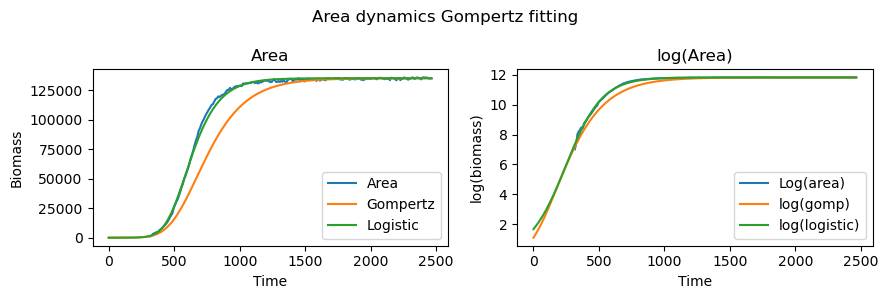

115 params: [11.194511997776267, 0.01953330288849691, -57.81799326117414]


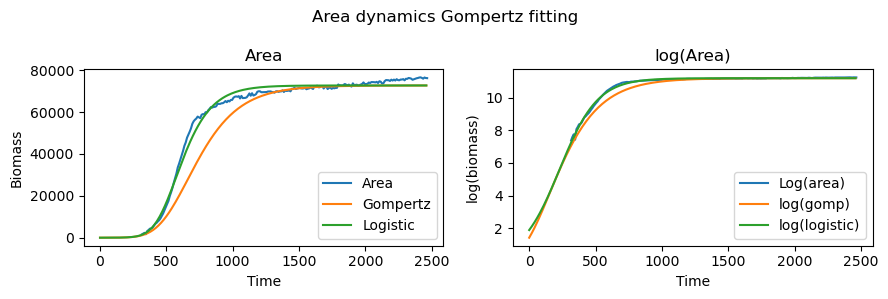

116 params: [12.038161484961615, 0.023590930599552837, 4.247250094525875]


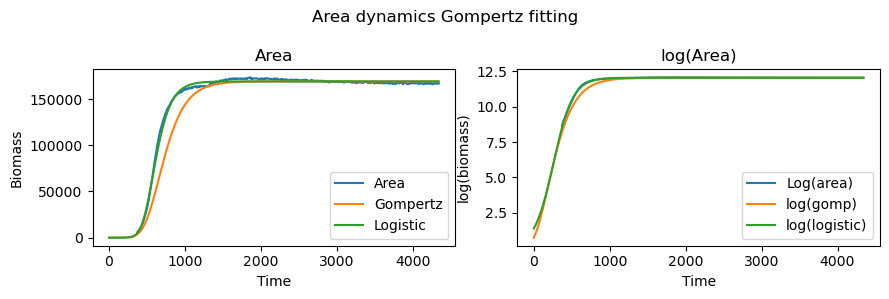

117 params: [12.104635247092402, 0.025232233628792698, 30.17114026597371]


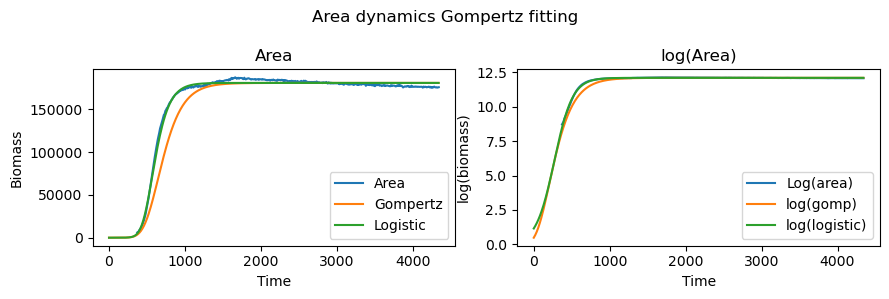

118 params: [12.197530621968346, 0.024585700186767007, 37.71171673086634]


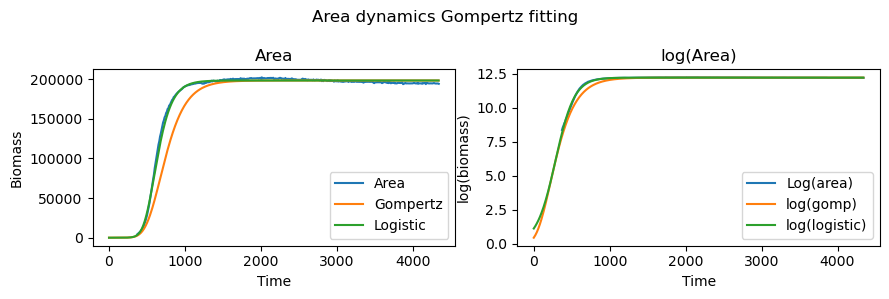

119 params: [11.968100615870231, 0.02536750599969389, 53.00787205808489]


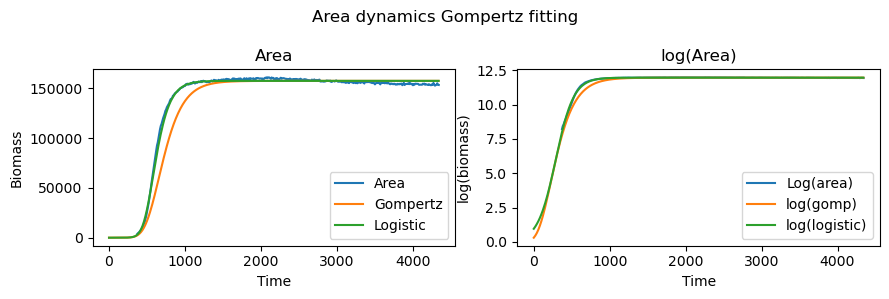

120 params: [11.77062787271596, 0.023097975158514736, 67.0965454908019]


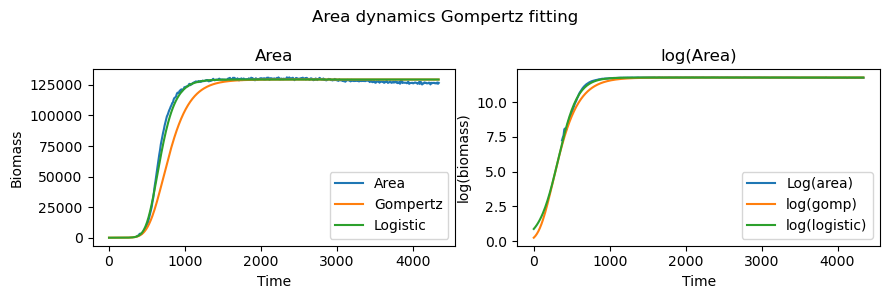

121 params: [12.210540337578529, 0.020206907421137628, -6.707088370491169]


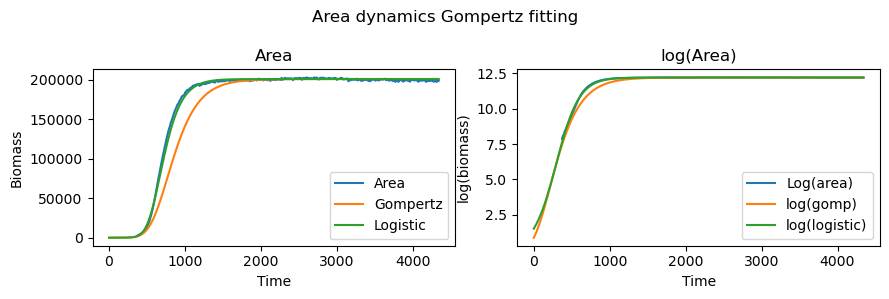

122 params: [12.411444538246355, 0.022331218548205262, -3.9940889828879675]


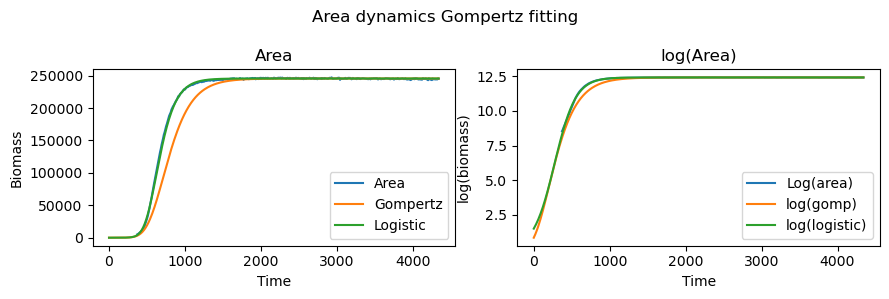

123 params: [12.543077090952437, 0.02357502649925525, 29.360171732626995]


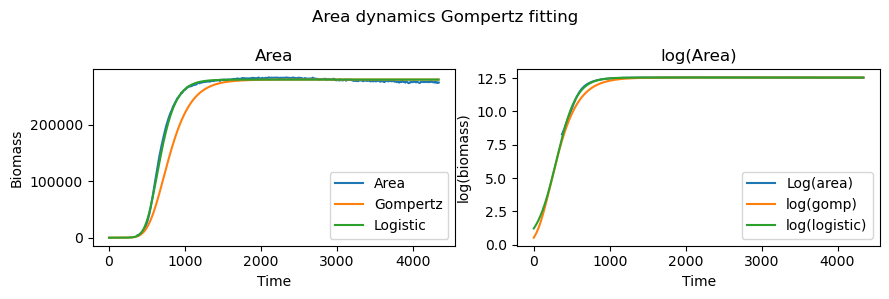

124 params: [12.4892521133542, 0.02370581578277924, 14.517685392119471]


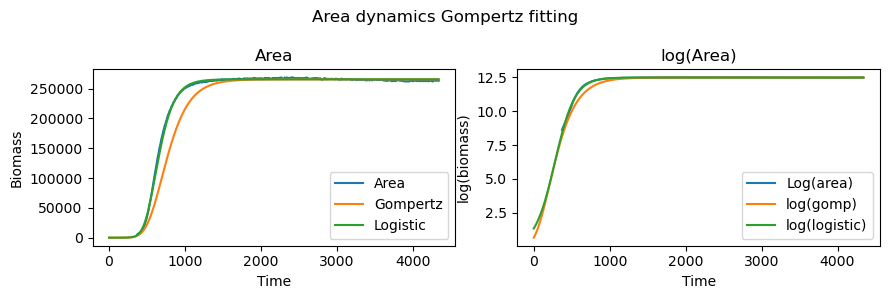

125 params: [11.385387910553574, 0.01239529514641728, -50.513988698212835]


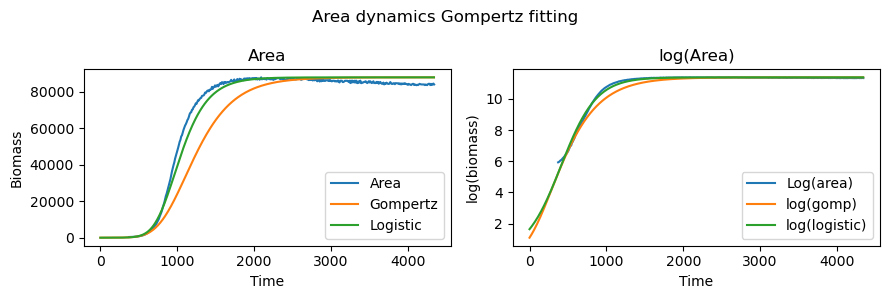

126 params: [11.794715713001677, 0.013668008104572726, -107.274602716101]


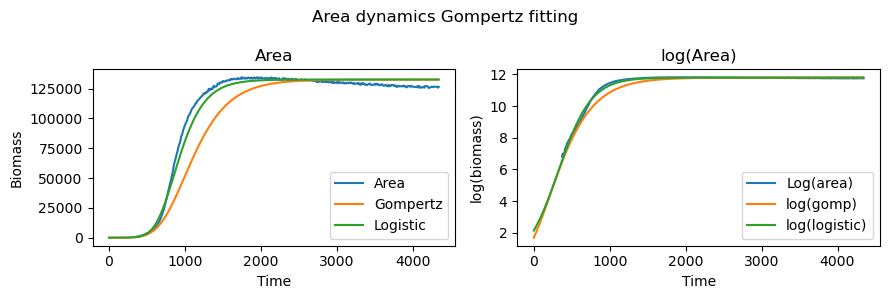

127 params: [11.96575377614205, 0.014634131635493293, -85.79361256476349]


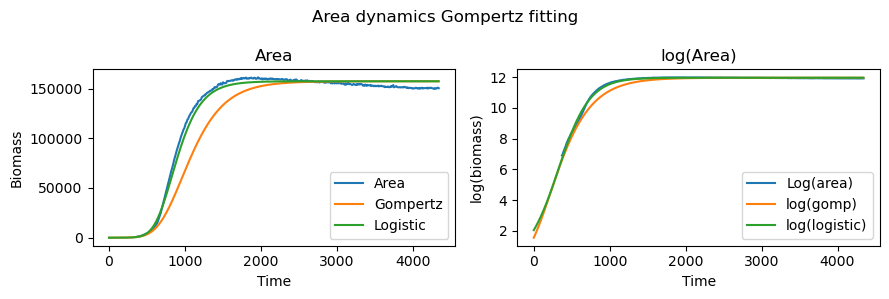

128 params: [11.99946567180799, 0.015459855418067178, -52.39442123806806]


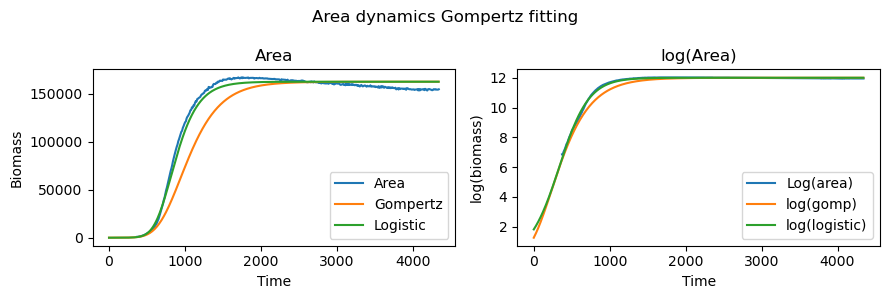

129 params: [12.759114660256667, 0.012243229938939658, -165.57472486590044]


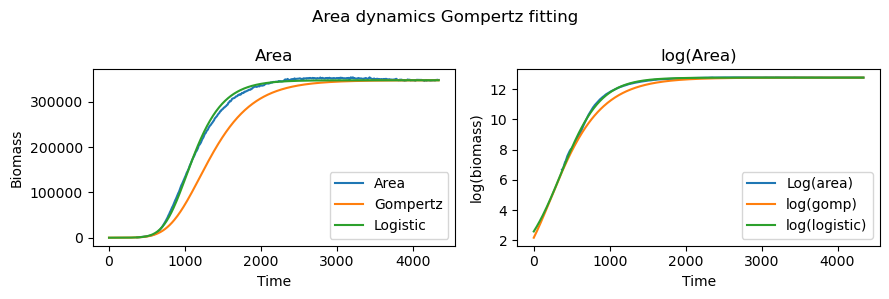

130 params: [12.44101898309336, 0.012941736969703667, -102.60798545149619]


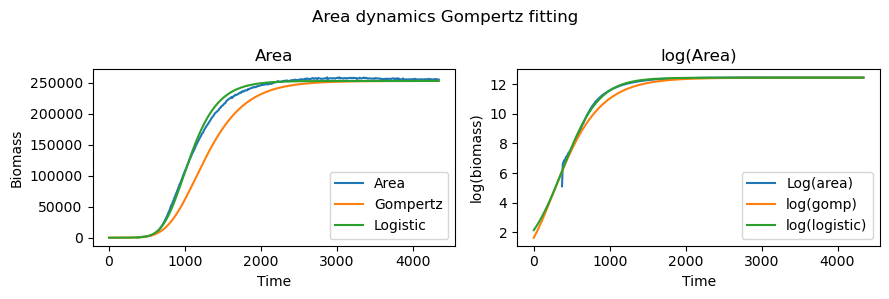

131 params: [12.436574091737986, 0.013063361637947694, -99.34486006941613]


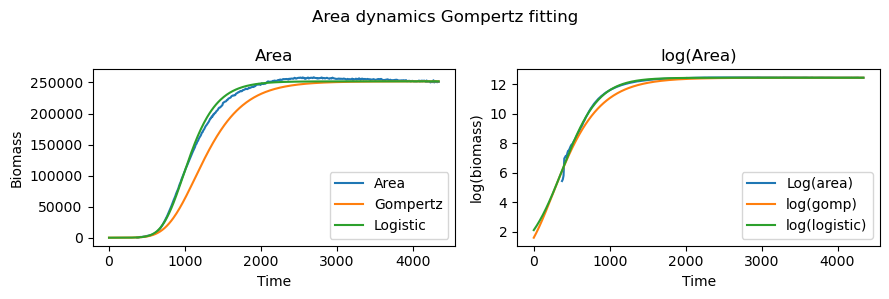

132 params: [12.598144196913026, 0.013509479662269175, -82.90455616789552]


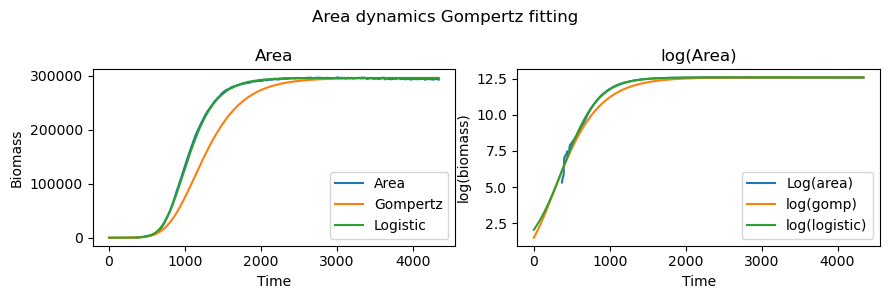

133 params: [12.956926009370038, 0.013121208016114383, -140.69081739396984]


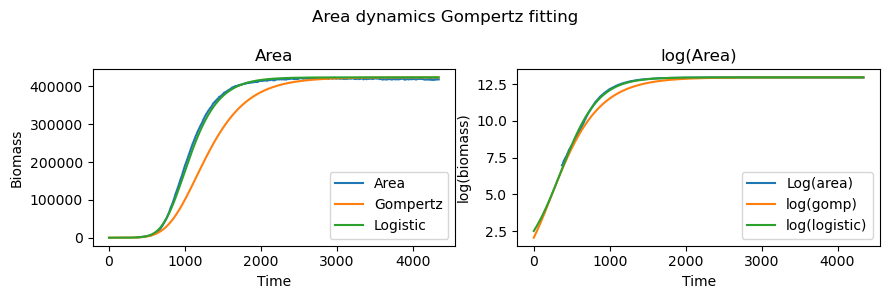

134 params: [12.96544171463044, 0.013696564473765827, -118.6882219325658]


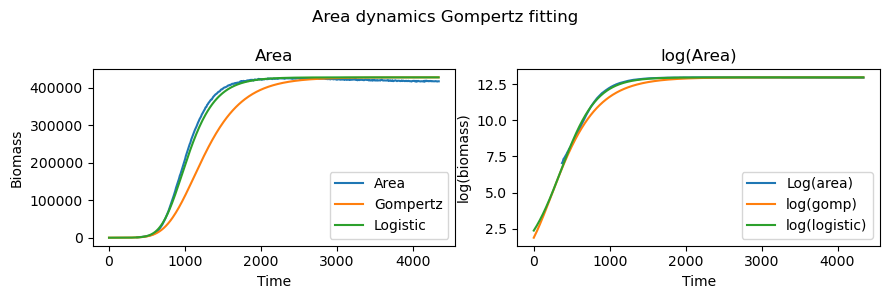

135 params: [12.130079039213166, 0.02543578893809975, 64.83125814596849]


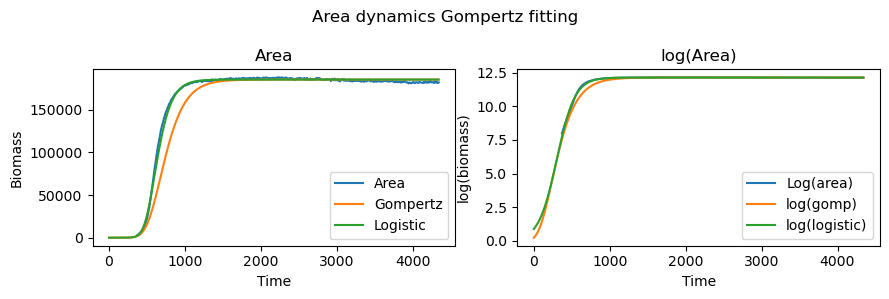

136 params: [11.614368434199124, 0.025737107634590427, -11.904650566697986]


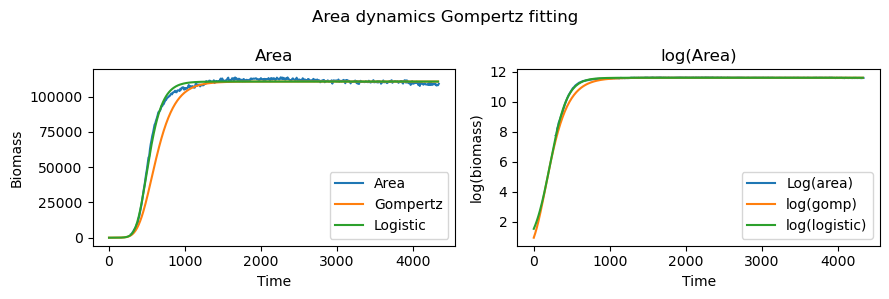

137 params: [11.520451233385753, 0.02262317440211235, -76.8896013848902]


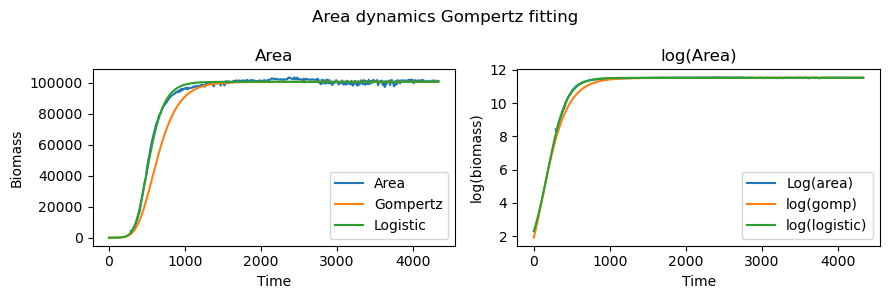

138 params: [11.686074459717076, 0.025488872206423464, -20.858174572066005]


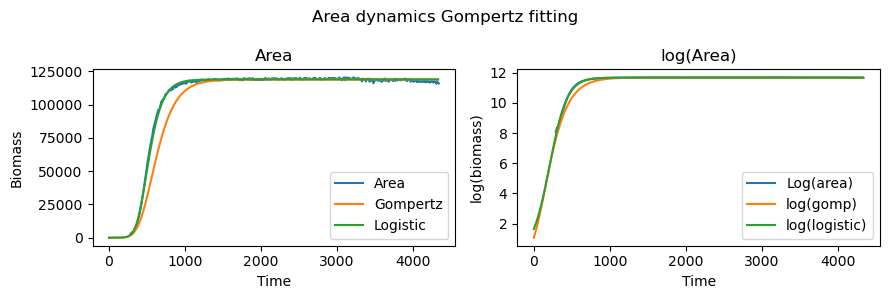

139 params: [11.78327264187707, 0.023826357443122746, -54.63996950054876]


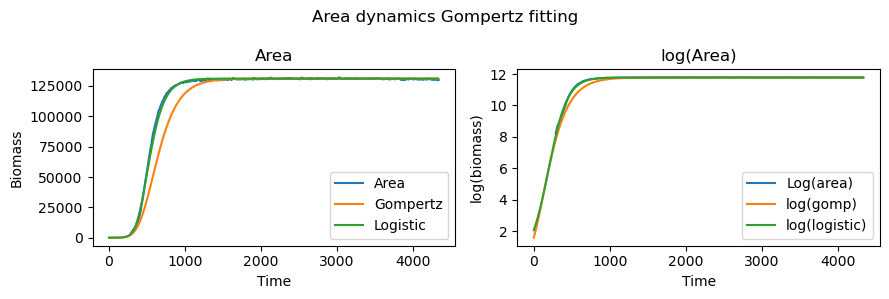

140 params: [11.564023094434331, 0.024082288631326512, -9.825291811487634]


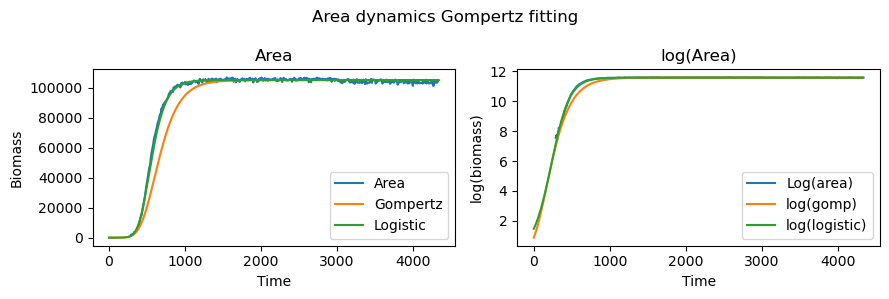

141 params: [11.573529271814985, 0.023697933406993898, -22.72045089974441]


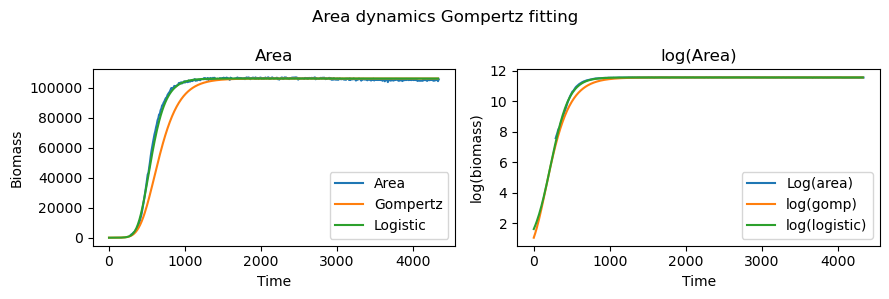

142 params: [12.281344854831419, 0.02994087277088418, 10.86579051749085]


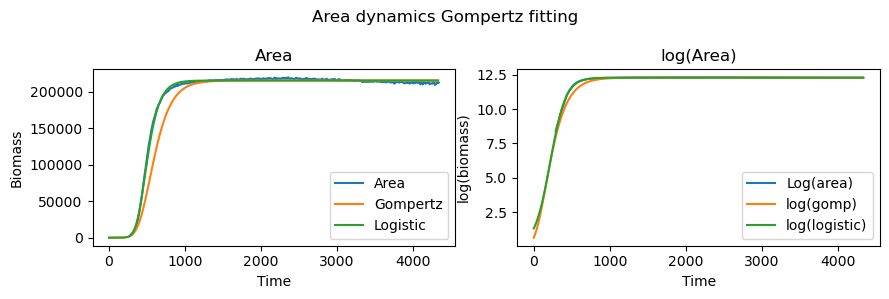

143 params: [12.088146235198375, 0.029873438792180063, 12.5520052803782]


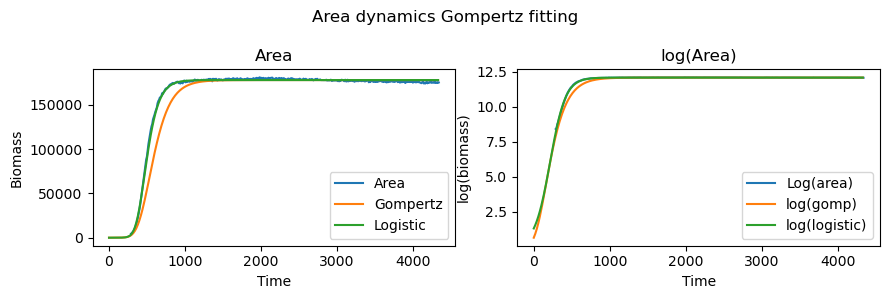

144 params: [11.822102472658633, 0.027172324310877526, 8.57235548727675]


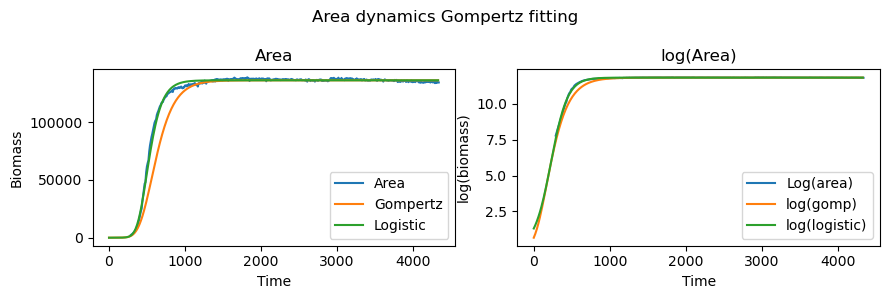

145 params: [12.107031978441729, 0.015335264430426961, -78.21499679513269]


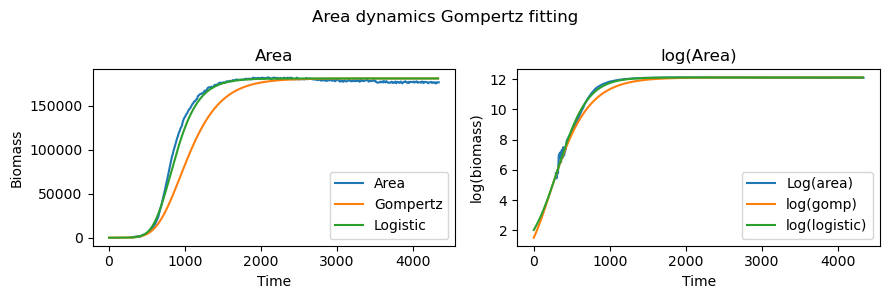

146 params: [11.276027094852022, 0.015161498906598942, -5.7449445009282885]


/tmp/ipykernel_1223843/3617836837.py:27: RuntimeWarning: divide by zero encountered in log
  axes[1].plot(time_points, np.log(area), label='Log(area)')


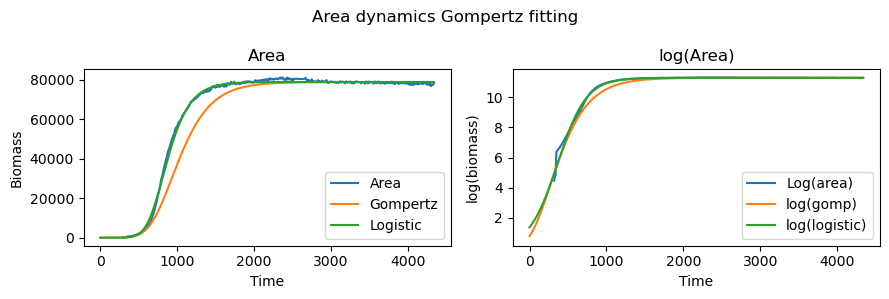

147 params: [10.921608377637947, 0.012970770609608315, -107.52274860073084]


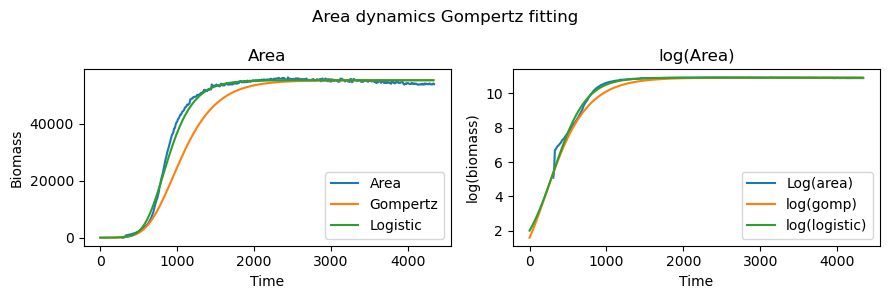

148 params: [10.992515460203482, 0.010471686589254047, -265.7667025339931]


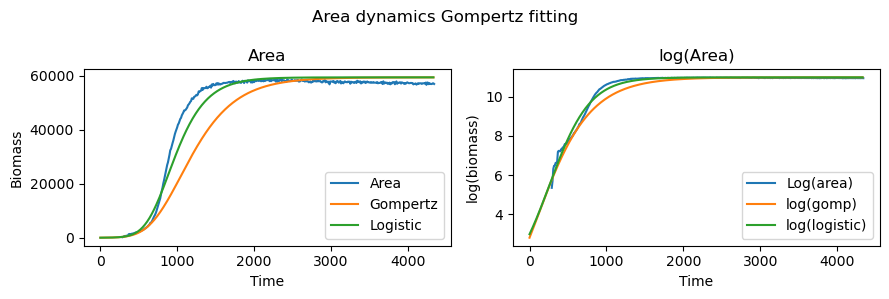

149 params: [11.19934495219456, 0.01794466603253439, 144.5662044974472]


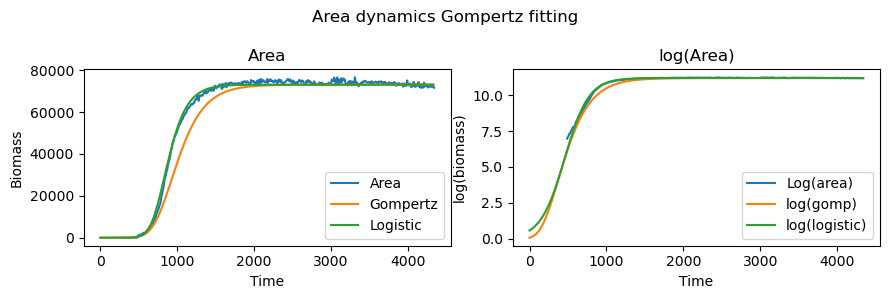

150 params: [11.365492945517866, 0.013120264947097938, -109.21636878634439]


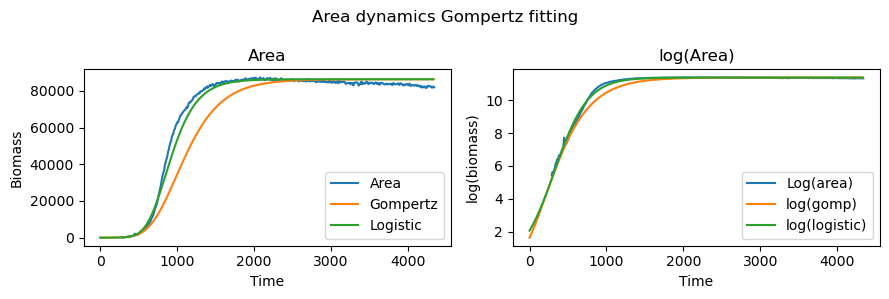

151 params: [11.706832150013055, 0.01538869273426973, -66.75306377266642]


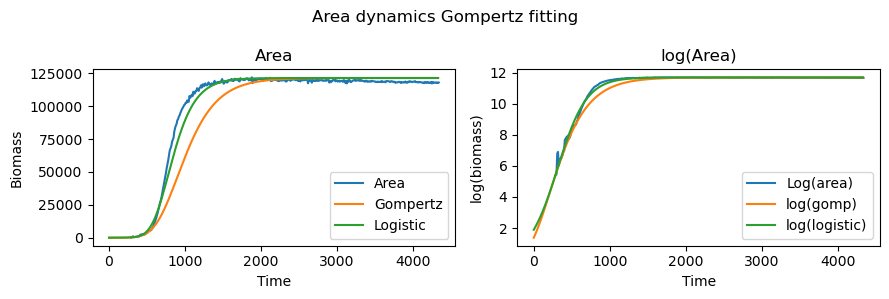

152 params: [11.474062974318793, 0.01579810012184229, -22.850424255074017]


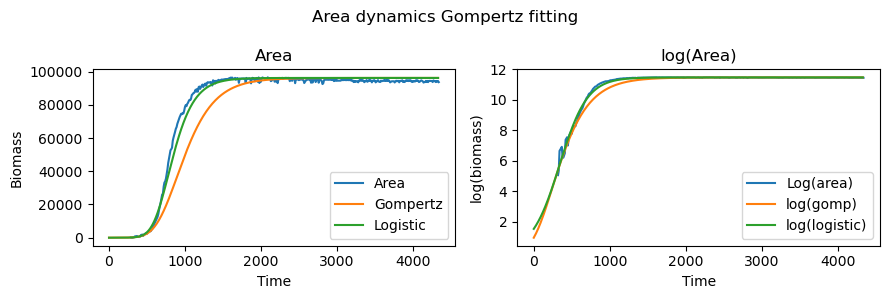

153 params: [11.401050132616742, 0.02204122710430719, 165.74205942366257]


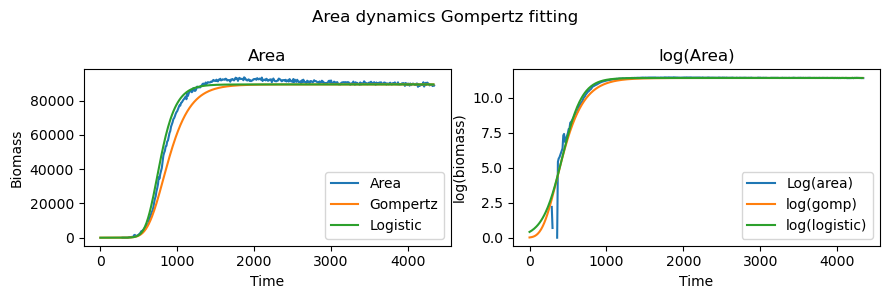

154 params: [11.347363806652911, 0.015800698598728923, -121.23598227274135]


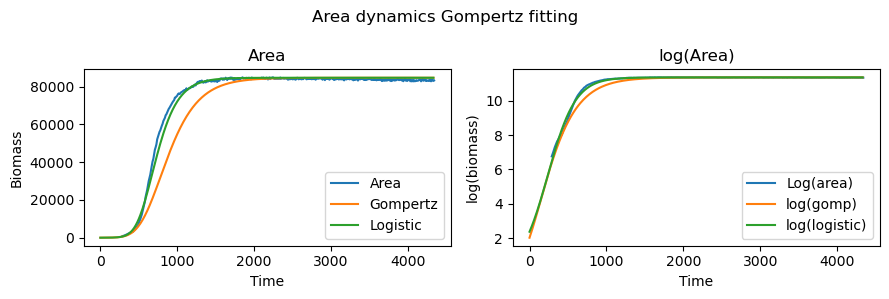

155 params: [11.494199501074085, 0.016585502874647443, -110.01560247691017]


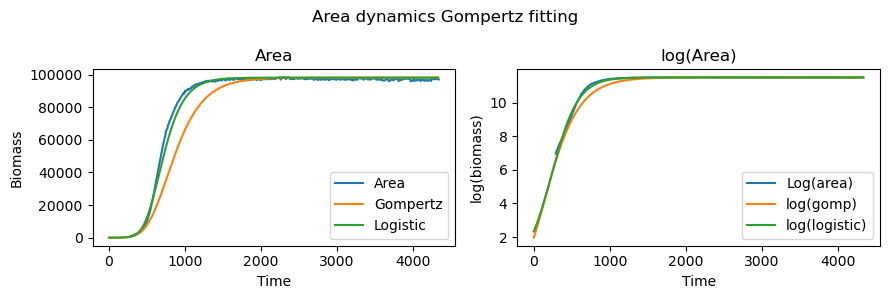

156 params: [11.576370672319893, 0.01650044544908823, -95.39415502675273]


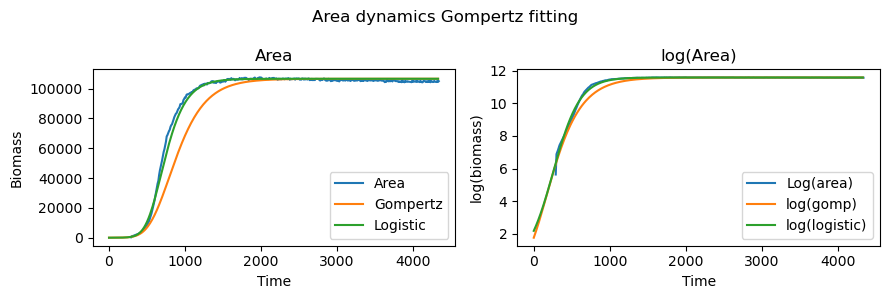

157 params: [11.674280653555156, 0.023985078326129686, -38.9164049582698]


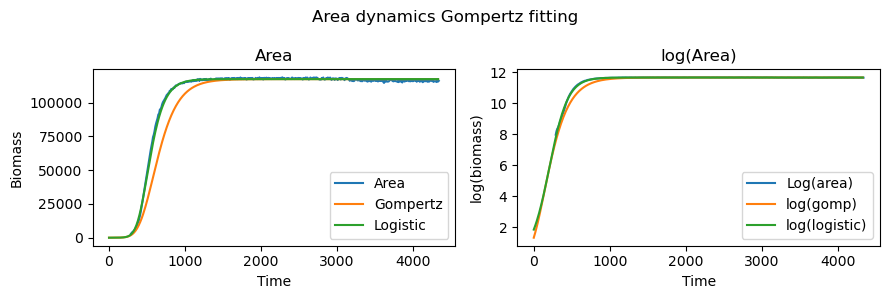

158 params: [11.585707675314604, 0.013245232609352961, -142.82094678354198]


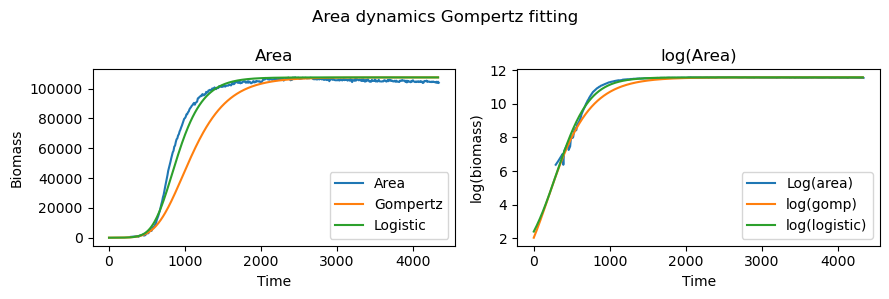

159 params: [10.12314848241439, 0.007774609964238476, -477.8949667956889]


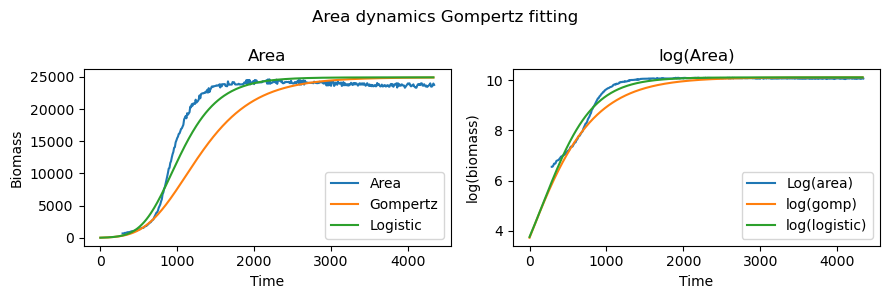

In [21]:
for i in df.index.values:
    incub_time_s = datetime.strptime(df.loc[i,'t_im'], '%H:%M:%S') - datetime.strptime(df.loc[i,'t_incub'], '%H:%M:%S')
    incub_time_n = incub_time_s.seconds / 60
    
    area = extract_array(df.loc[i,'area'])
    time_points = np.arange(0, df.loc[i, 'exp length'])*10 + incub_time_n
    time = np.arange(0, time_points[-1], 10, like=time_points)
    params = list(json.loads(df.loc[i,'logistic_params']).values())
    params_gomp = list(json.loads(df.loc[i,'gomp_params']).values())
    logisticg = logistic(time, *params)
    gomp = gompertz(time, *params)

    print(f"{i} params: {params}")
    # create subplots
    fig, axes = plt.subplots(1, 2, figsize=(9,3))

    # plot data
    axes[0].plot(time_points, area, label='Area')
    axes[0].plot(time, np.exp(gomp), label='Gompertz')
    axes[0].plot(time, np.exp(logisticg), label='Logistic')
    axes[0].set_xlabel('Time')
    axes[0].set_ylabel('Biomass')
    axes[0].set_title('Area')
    axes[0].legend()

    # log area
    axes[1].plot(time_points, np.log(area), label='Log(area)')
    axes[1].plot(time, gomp, label='log(gomp)')
    axes[1].plot(time, logisticg, label='log(logistic)')
    axes[1].set_xlabel('Time')
    axes[1].set_ylabel('log(biomass)')
    axes[1].set_title('log(Area)')
    axes[1].legend()

    # growth rate
    """
    #axes[1].plot(time_points, np.log(area), label='Log(area)')
    axes[1].plot(time_points, savgol_filter(np.log(area), 21, 3, deriv=1), label='Growth rate area')
    axes[1].plot(time, savgol_filter(gomp, 21, 3, deriv=1), label='Growth rate B gompertz')
    axes[1].plot(time, gompertz_growth_rate(time, *params), label='Growth rate deriv')
    
    axes[1].set_xlabel('Time')
    axes[1].set_ylabel('Growth rate')
    axes[1].set_title('Growth rate')
    axes[1].legend()
    """
    
    plt.suptitle('Area dynamics Gompertz fitting')
    plt.tight_layout()
    plt.show()

#### Average parameters